## Natural Language Understanding (NLU)
* NLU is an AI subfielf to interpret text and unstructured data
* Applciations: Siri, Alex, Google Assistant

[Reference: Stanford NLU](http://web.stanford.edu/class/cs224u/materials/cs224u-2020-intro-handout.pdf)



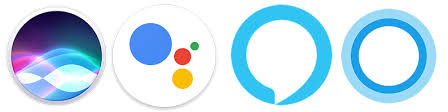

![alt text](https://encrypted-tbn0.gstatic.com/images?q=tbn%3AANd9GcR-WiigLm2AB6pCcPjko2-EdhYrtiSdgDFtYQ&usqp=CAU)

### Overview of Chat Bot and Language Assistant

![alt text](https://miro.medium.com/max/2560/1*pbuIMJNy5gqnbHBoUaRsVQ.jpeg)

## Name Entity Recognition (NER)
* Labels sequences of words in a text which are the names of things, such as person and company names, or gene and protein names
[References: NER](https://nlp.stanford.edu/software/CRF-NER.html)

![alt text](https://miro.medium.com/max/2972/1*7DkqpU3E-E9yknyw9c7vCQ.png)

## Bidirectional-LSTM-CRF model
![alt text](https://raw.githubusercontent.com/scofield7419/sequence-labeling-BiLSTM-CRF/master/snapshot/BiLSTM_CRF.png)

**Composed of:**
* [Word Embedding](https://lilianweng.github.io/lil-log/2017/10/15/learning-word-embedding.html)
* [Bidirection Long-Short-Term-Memory](https://machinelearningmastery.com/develop-bidirectional-lstm-sequence-classification-python-keras/)
* [Conditional Random Field](https://people.cs.umass.edu/~mccallum/papers/crf-tutorial.pdf)

[Reference: Bidirectional LSTM for Sequence Tagging](https://arxiv.org/abs/1508.01991)

### Import dependenceis

In [1]:
import pandas as pd
import numpy as np
import os
import tensorflow as tf
import tensorflow_addons
from sklearn.utils import shuffle
from tensorflow.keras.utils import Sequence, to_categorical
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [2]:
tf.keras.backend.clear_session

<function tensorflow.python.keras.backend.clear_session()>

In [3]:
!git clone https://github.com/DSC-UTDallas/explore-ml.git -b advanced
!mv explore-ml explore_ml
!mv explore_ml/BiLSTM-CRF explore_ml/BiLSTM_CRF

Cloning into 'explore-ml'...
remote: Enumerating objects: 191, done.
remote: Counting objects: 100% (191/191), done.
remote: Compressing objects: 100% (155/155), done.
remote: Total 463 (delta 92), reused 89 (delta 35), pack-reused 272
Receiving objects: 100% (463/463), 35.93 MiB | 15.07 MiB/s, done.
Resolving deltas: 100% (189/189), done.


In [4]:
from lib.utils import SentenceGetter
from lib.model import  BiLSTM_CRF, CRF

### Download data

In [ ]:
!wget https://github.com/DSC-UTDallas/explore-ml/raw/master/name-entity-recognition-corpus.zip
!unzip name-entity-recognition-corpus.zip

--2020-09-10 00:21:22--  https://github.com/DSC-UTDallas/explore-ml/raw/master/name-entity-recognition-corpus.zip
Resolving github.com (github.com)... 192.30.255.113
Connecting to github.com (github.com)|192.30.255.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/DSC-UTDallas/explore-ml/master/name-entity-recognition-corpus.zip [following]
--2020-09-10 00:21:22--  https://raw.githubusercontent.com/DSC-UTDallas/explore-ml/master/name-entity-recognition-corpus.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 27703149 (26M) [application/zip]
Saving to: ‘name-entity-recognition-corpus.zip.1’

name-entity-recogni 100%[===================>]  26.42M  54.9MB/s    in 0.5s    

2020-09-10 00:21:23 (54.9

### Import corpus

In [5]:
data = pd.read_csv('ner_dataset.csv', encoding = 'latin1')
data = data.fillna(method="ffill")

In [6]:
data.head()

,Sentence #,Word,POS,Tag
0,Sentence: 1,Thousands,NNS,O
1,Sentence: 1,of,IN,O
2,Sentence: 1,demonstrators,NNS,O
3,Sentence: 1,have,VBP,O
4,Sentence: 1,marched,VBN,O


#### Build Dictionary of Words and Tags

###### Build list of distinct words

In [7]:
# build list of distinct words
words = list(set(data["Word"].values))
words.append("ENDPAD")
n_words = len(words); n_words 

35179

###### Build list of distinct tags

In [8]:
# build list of distinct tags
tags = list(set(data["Tag"].values))
n_tags = len(tags);
print("Tags: ", tags)

Tags:  ['B-eve', 'B-art', 'I-gpe', 'B-nat', 'I-per', 'I-nat', 'I-tim', 'B-org', 'O', 'B-geo', 'B-per', 'B-tim', 'I-geo', 'I-eve', 'I-art', 'B-gpe', 'I-org']


###### Build dictionary of words and tags

In [9]:
# build dictionary of words and tags
max_len = 75
word2dix = {w : i + 1 for i, w in enumerate(words)}
tag2dix = {t : i for i, t in enumerate(tags)}

In [10]:
word2dix['Obama']

17262

In [11]:
tag2dix['O']

8

### Generate Sentence Getter

In [12]:
batch_size = 32
getter = SentenceGetter(data = data, words = words, tags = tags, maxlen = max_len, batch_size = batch_size)

     Sentence #           Word  POS    Tag
0   Sentence: 1      Thousands  NNS      O
1   Sentence: 1             of   IN      O
2   Sentence: 1  demonstrators  NNS      O
3   Sentence: 1           have  VBP      O
4   Sentence: 1        marched  VBN      O
5   Sentence: 1        through   IN      O
6   Sentence: 1         London  NNP  B-geo
7   Sentence: 1             to   TO      O
8   Sentence: 1        protest   VB      O
9   Sentence: 1            the   DT      O
10  Sentence: 1            war   NN      O
11  Sentence: 1             in   IN      O
12  Sentence: 1           Iraq  NNP  B-geo
13  Sentence: 1            and   CC      O
14  Sentence: 1         demand   VB      O
15  Sentence: 1            the   DT      O
16  Sentence: 1     withdrawal   NN      O
17  Sentence: 1             of   IN      O
18  Sentence: 1        British   JJ  B-gpe
19  Sentence: 1         troops  NNS      O
20  Sentence: 1           from   IN      O
21  Sentence: 1           that   DT      O
22  Sentenc

220081  Sentence: 10075            .    .      O
             Sentence #           Word   POS    Tag
220082  Sentence: 10076          Lucia   NNP  B-per
220083  Sentence: 10076        Hiriart   NNP  I-per
220084  Sentence: 10076            and    CC      O
220085  Sentence: 10076            her  PRP$      O
220086  Sentence: 10076       children   NNS      O
220087  Sentence: 10076           were   VBD      O
220088  Sentence: 10076       arrested   VBN      O
220089  Sentence: 10076         Monday   NNP  B-tim
220090  Sentence: 10076             as    IN      O
220091  Sentence: 10076           part    NN      O
220092  Sentence: 10076             of    IN      O
220093  Sentence: 10076             an    DT      O
220094  Sentence: 10076  investigation    NN      O
220095  Sentence: 10076           into    IN      O
220096  Sentence: 10076       millions   NNS      O
220097  Sentence: 10076             of    IN      O
220098  Sentence: 10076        dollars   NNS      O
220099  Sentenc

22397  Sentence: 1015           .     .      O
             Sentence #          Word  POS    Tag
221743  Sentence: 10150         Ruled  VBN      O
221744  Sentence: 10150            by   IN      O
221745  Sentence: 10150           the   DT      O
221746  Sentence: 10150            Al  NNP  B-org
221747  Sentence: 10150         Thani  NNP  I-org
221748  Sentence: 10150        family   NN      O
221749  Sentence: 10150         since   IN      O
221750  Sentence: 10150           the   DT      O
221751  Sentence: 10150     mid-1800s  NNS  B-tim
221752  Sentence: 10150             ,    ,      O
221753  Sentence: 10150         Qatar  NNP  B-gpe
221754  Sentence: 10150   transformed  VBD      O
221755  Sentence: 10150        itself  PRP      O
221756  Sentence: 10150          from   IN      O
221757  Sentence: 10150             a   DT      O
221758  Sentence: 10150          poor   JJ      O
221759  Sentence: 10150       British   JJ  B-gpe
221760  Sentence: 10150  protectorate   NN      O
221

223492  Sentence: 10226             .    .      O
             Sentence #        Word   POS    Tag
223493  Sentence: 10227         The    DT      O
223494  Sentence: 10227      Senate   NNP  B-org
223495  Sentence: 10227     Foreign   NNP  I-org
223496  Sentence: 10227   Relations   NNP  I-org
223497  Sentence: 10227   Committee   NNP  I-org
223498  Sentence: 10227          is   VBZ      O
223499  Sentence: 10227    expected   VBN      O
223500  Sentence: 10227          to    TO      O
223501  Sentence: 10227    question    VB      O
223502  Sentence: 10227         Ms.   NNP  B-per
223503  Sentence: 10227        Rice   NNP  I-per
223504  Sentence: 10227         for    IN      O
223505  Sentence: 10227     several    JJ      O
223506  Sentence: 10227        more   JJR      O
223507  Sentence: 10227       hours   NNS      O
223508  Sentence: 10227   Wednesday   NNP  B-tim
223509  Sentence: 10227      before    IN      O
223510  Sentence: 10227      voting   VBG      O
223511  Sentence: 1

225134  Sentence: 10304            .    .      O
             Sentence #         Word  POS    Tag
225135  Sentence: 10305       Moscow  NNP  B-geo
225136  Sentence: 10305   recognized  VBD      O
225137  Sentence: 10305          the   DT      O
225138  Sentence: 10305          two   CD      O
225139  Sentence: 10305      regions  NNS      O
225140  Sentence: 10305           as   IN      O
225141  Sentence: 10305  independent   JJ      O
225142  Sentence: 10305    countries  NNS      O
225143  Sentence: 10305           in   IN      O
225144  Sentence: 10305       August  NNP  B-tim
225145  Sentence: 10305            ,    ,      O
225146  Sentence: 10305      shortly   RB      O
225147  Sentence: 10305        after   IN      O
225148  Sentence: 10305      Russian   JJ  B-gpe
225149  Sentence: 10305       forces  NNS      O
225150  Sentence: 10305        swept  VBD      O
225151  Sentence: 10305         into   IN      O
225152  Sentence: 10305      Georgia  NNP  B-geo
225153  Sentence: 10

226637  Sentence: 10375           .    .      O
             Sentence #       Word  POS    Tag
226638  Sentence: 10376        The   DT      O
226639  Sentence: 10376     bikers  NNS      O
226640  Sentence: 10376        are  VBP      O
226641  Sentence: 10376   visiting  VBG      O
226642  Sentence: 10376        the   DT      O
226643  Sentence: 10376    Vietnam  NNP  B-org
226644  Sentence: 10376   Veterans  NNP      O
226645  Sentence: 10376   memorial   JJ      O
226646  Sentence: 10376     Sunday  NNP  B-tim
226647  Sentence: 10376        and   CC      O
226648  Sentence: 10376        are  VBP      O
226649  Sentence: 10376       then   RB      O
226650  Sentence: 10376  gathering  VBG      O
226651  Sentence: 10376         at   IN      O
226652  Sentence: 10376        the   DT      O
226653  Sentence: 10376    Lincoln  NNP  B-geo
226654  Sentence: 10376   memorial   NN      O
226655  Sentence: 10376      where  WRB      O
226656  Sentence: 10376      there   EX      O
226657  Sent

228319  Sentence: 10446             .    .      O
             Sentence #       Word  POS    Tag
228320  Sentence: 10447         It  PRP      O
228321  Sentence: 10447       says  VBZ      O
228322  Sentence: 10447          a   DT      O
228323  Sentence: 10447    similar   JJ      O
228324  Sentence: 10447  situation   NN      O
228325  Sentence: 10447     exists  VBZ      O
228326  Sentence: 10447         in   IN      O
228327  Sentence: 10447   Malaysia  NNP  B-geo
228328  Sentence: 10447        and   CC      O
228329  Sentence: 10447    Vietnam  NNP  B-geo
228330  Sentence: 10447          .    .      O
             Sentence #          Word  POS    Tag
228331  Sentence: 10448           The   DT      O
228332  Sentence: 10448      warnings  NNS      O
228333  Sentence: 10448          came  VBD      O
228334  Sentence: 10448            in   IN      O
228335  Sentence: 10448             a   DT      O
228336  Sentence: 10448     statement   NN      O
228337  Sentence: 10448       Tuesda

229855  Sentence: 10525           .    .      O
             Sentence #       Word  POS    Tag
229856  Sentence: 10526         At   IN      O
229857  Sentence: 10526      least  JJS      O
229858  Sentence: 10526        one   CD      O
229859  Sentence: 10526    soldier   NN      O
229860  Sentence: 10526        and   CC      O
229861  Sentence: 10526          a   DT      O
229862  Sentence: 10526   civilian   NN      O
229863  Sentence: 10526       also   RB      O
229864  Sentence: 10526       were  VBD      O
229865  Sentence: 10526     killed  VBN      O
229866  Sentence: 10526         in   IN      O
229867  Sentence: 10526   fighting  VBG      O
229868  Sentence: 10526       that   IN      O
229869  Sentence: 10526      began  VBD      O
229870  Sentence: 10526       late   RB      O
229871  Sentence: 10526     Friday  NNP  B-tim
229872  Sentence: 10526         in   IN      O
229873  Sentence: 10526          a   DT      O
229874  Sentence: 10526    village   NN      O
229875  Sent

231538  Sentence: 10599              .     .      O
         Sentence #       Word  POS Tag
2395  Sentence: 106        The   DT   O
2396  Sentence: 106        six   CD   O
2397  Sentence: 106       were  VBD   O
2398  Sentence: 106  kidnapped  VBN   O
2399  Sentence: 106          a   DT   O
2400  Sentence: 106        few   JJ   O
2401  Sentence: 106       days  NNS   O
2402  Sentence: 106        ago   RB   O
2403  Sentence: 106          .    .   O
           Sentence #        Word   POS    Tag
23407  Sentence: 1060           A    DT      O
23408  Sentence: 1060       White   NNP  B-org
23409  Sentence: 1060       House   NNP  I-org
23410  Sentence: 1060   spokesman    NN      O
23411  Sentence: 1060        said   VBD      O
23412  Sentence: 1060   Wednesday   NNP  B-tim
23413  Sentence: 1060        that    IN      O
23414  Sentence: 1060         Mr.   NNP  B-per
23415  Sentence: 1060        Bush   NNP  I-per
23416  Sentence: 1060    believes   VBZ      O
23417  Sentence: 1060         t

233216  Sentence: 10676            .    .      O
             Sentence #          Word  POS    Tag
233217  Sentence: 10677            As   IN      O
233218  Sentence: 10677           one   CD      O
233219  Sentence: 10677            of   IN      O
233220  Sentence: 10677          five   CD      O
233221  Sentence: 10677     permanent   JJ      O
233222  Sentence: 10677       members  NNS      O
233223  Sentence: 10677            of   IN      O
233224  Sentence: 10677           the   DT      O
233225  Sentence: 10677            UN  NNP  B-org
233226  Sentence: 10677      Security  NNP  I-org
233227  Sentence: 10677       Council  NNP  I-org
233228  Sentence: 10677             ,    ,      O
233229  Sentence: 10677             a   DT      O
233230  Sentence: 10677      founding   NN      O
233231  Sentence: 10677        member   NN      O
233232  Sentence: 10677            of   IN      O
233233  Sentence: 10677          NATO  NNP  B-org
233234  Sentence: 10677             ,    ,      O
2

23790  Sentence: 1075           .    .      O
             Sentence #               Word  POS    Tag
234813  Sentence: 10750                 At   IN      O
234814  Sentence: 10750              least  JJS      O
234815  Sentence: 10750               five   CD      O
234816  Sentence: 10750          policemen  NNS      O
234817  Sentence: 10750               have  VBP      O
234818  Sentence: 10750               been  VBN      O
234819  Sentence: 10750             killed  VBN      O
234820  Sentence: 10750                 in   IN      O
234821  Sentence: 10750                  a   DT      O
234822  Sentence: 10750           militant   JJ      O
234823  Sentence: 10750             attack   NN      O
234824  Sentence: 10750                 on   IN      O
234825  Sentence: 10750                  a   DT      O
234826  Sentence: 10750           security   NN      O
234827  Sentence: 10750               camp   NN      O
234828  Sentence: 10750                 in   IN      O
234829  Sentence: 1

236437  Sentence: 10827           .    .      O
             Sentence #               Word  POS    Tag
236438  Sentence: 10828        Authorities  NNS      O
236439  Sentence: 10828                say  VBP      O
236440  Sentence: 10828                the   DT      O
236441  Sentence: 10828          suspected   JJ      O
236442  Sentence: 10828          militants  NNS      O
236443  Sentence: 10828               were  VBD      O
236444  Sentence: 10828             trying  VBG      O
236445  Sentence: 10828                 to   TO      O
236446  Sentence: 10828              sneak   VB      O
236447  Sentence: 10828               into   IN      O
236448  Sentence: 10828                the   DT      O
236449  Sentence: 10828  Indian-controlled   JJ      O
236450  Sentence: 10828            portion   NN      O
236451  Sentence: 10828                 of   IN      O
236452  Sentence: 10828            Kashmir  NNP  B-geo
236453  Sentence: 10828               when  WRB      O
236454  Sentence:

238124  Sentence: 10905                .    .      O
             Sentence #       Word  POS    Tag
238125  Sentence: 10906        The   DT      O
238126  Sentence: 10906   European  NNP  B-org
238127  Sentence: 10906      Union  NNP  I-org
238128  Sentence: 10906        has  VBZ      O
238129  Sentence: 10906       also   RB      O
238130  Sentence: 10906  condemned  VBN      O
238131  Sentence: 10906        the   DT      O
238132  Sentence: 10906  satellite   NN      O
238133  Sentence: 10906    jamming   NN      O
238134  Sentence: 10906          .    .      O
             Sentence #         Word  POS    Tag
238135  Sentence: 10907          The   DT      O
238136  Sentence: 10907         U.N.  NNP  B-org
238137  Sentence: 10907       agency   NN      O
238138  Sentence: 10907         does  VBZ      O
238139  Sentence: 10907          not   RB      O
238140  Sentence: 10907         have   VB      O
238141  Sentence: 10907            a   DT      O
238142  Sentence: 10907        means  

239896  Sentence: 10985             .     .      O
             Sentence #           Word   POS    Tag
239897  Sentence: 10986             In    IN      O
239898  Sentence: 10986            its  PRP$      O
239899  Sentence: 10986         annual    JJ      O
239900  Sentence: 10986         report    NN      O
239901  Sentence: 10986             on    IN      O
239902  Sentence: 10986  proliferation    NN      O
239903  Sentence: 10986        threats   NNS      O
239904  Sentence: 10986       released   VBN      O
239905  Sentence: 10986             to    TO      O
239906  Sentence: 10986      lawmakers   NNS      O
239907  Sentence: 10986        Tuesday   NNP  B-tim
239908  Sentence: 10986              ,     ,      O
239909  Sentence: 10986            the    DT      O
239910  Sentence: 10986            CIA   NNP  B-org
239911  Sentence: 10986           said   VBD      O
239912  Sentence: 10986       al-Qaida   NNP  B-org
239913  Sentence: 10986             's   POS      O
239914  Sente

241474  Sentence: 11062          .     .      O
             Sentence #        Word  POS    Tag
241475  Sentence: 11063        U.S.  NNP  B-geo
241476  Sentence: 11063   officials  NNS      O
241477  Sentence: 11063         say  VBP      O
241478  Sentence: 11063         the   DT      O
241479  Sentence: 11063       Saudi   JJ      O
241480  Sentence: 11063  government   NN      O
241481  Sentence: 11063         has  VBZ      O
241482  Sentence: 11063        been  VBN      O
241483  Sentence: 11063           a   DT      O
241484  Sentence: 11063      strong   JJ      O
241485  Sentence: 11063        ally   NN      O
241486  Sentence: 11063          in   IN      O
241487  Sentence: 11063         the   DT      O
241488  Sentence: 11063      region   NN      O
241489  Sentence: 11063           .    .      O
             Sentence #                 Word  POS    Tag
241490  Sentence: 11064                  The   DT      O
241491  Sentence: 11064                 vice   NN  B-per
241492  Sente

243156  Sentence: 11141        .    .      O
             Sentence #        Word  POS    Tag
243157  Sentence: 11142      Rebels  NNS      O
243158  Sentence: 11142       still   RB      O
243159  Sentence: 11142        hold  VBP      O
243160  Sentence: 11142        huge   JJ      O
243161  Sentence: 11142      swaths  NNS      O
243162  Sentence: 11142          of   IN      O
243163  Sentence: 11142   territory   NN      O
243164  Sentence: 11142          in   IN      O
243165  Sentence: 11142    northern   JJ      O
243166  Sentence: 11142         and   CC      O
243167  Sentence: 11142     western   JJ      O
243168  Sentence: 11142       Ivory  NNP  B-geo
243169  Sentence: 11142       Coast  NNP  I-geo
243170  Sentence: 11142           ,    ,      O
243171  Sentence: 11142        with   IN      O
243172  Sentence: 11142         the   DT      O
243173  Sentence: 11142  government   NN      O
243174  Sentence: 11142      firmly   RB      O
243175  Sentence: 11142          in   IN   

244850  Sentence: 11220            .     .      O
             Sentence #          Word  POS    Tag
244851  Sentence: 11221            In   IN      O
244852  Sentence: 11221             a   DT      O
244853  Sentence: 11221  hypothetical   JJ      O
244854  Sentence: 11221       general   JJ      O
244855  Sentence: 11221      election   NN      O
244856  Sentence: 11221      match-up   NN      O
244857  Sentence: 11221             ,    ,      O
244858  Sentence: 11221    Democratic   JJ  B-org
244859  Sentence: 11221         Party  NNP  I-org
244860  Sentence: 11221     candidate   NN  I-org
244861  Sentence: 11221       Senator  NNP  B-per
244862  Sentence: 11221        Barack  NNP  B-org
244863  Sentence: 11221         Obama  NNP  B-per
244864  Sentence: 11221         leads  VBZ      O
244865  Sentence: 11221      presumed   JJ      O
244866  Sentence: 11221    Republican   JJ      O
244867  Sentence: 11221       nominee   NN      O
244868  Sentence: 11221          John  NNP  B-per


246806  Sentence: 11295               .    .      O
             Sentence #         Word  POS    Tag
246807  Sentence: 11296          FDI  NNP  B-org
246808  Sentence: 11296           is  VBZ      O
246809  Sentence: 11296        among   IN      O
246810  Sentence: 11296          the   DT      O
246811  Sentence: 11296       lowest  JJS      O
246812  Sentence: 11296           in   IN      O
246813  Sentence: 11296          the   DT      O
246814  Sentence: 11296       region   NN      O
246815  Sentence: 11296            ,    ,      O
246816  Sentence: 11296          but   CC      O
246817  Sentence: 11296          the   DT      O
246818  Sentence: 11296   government   NN      O
246819  Sentence: 11296          has  VBZ      O
246820  Sentence: 11296     embarked  VBN      O
246821  Sentence: 11296           on   IN      O
246822  Sentence: 11296           an   DT      O
246823  Sentence: 11296    ambitious   JJ      O
246824  Sentence: 11296      program   NN      O
246825  Sentence:

25090  Sentence: 1137             .    .      O
             Sentence #      Word  POS    Tag
248533  Sentence: 11370   Armenia  NNP  B-geo
248534  Sentence: 11370       has  VBZ      O
248535  Sentence: 11370  launched  VBN      O
248536  Sentence: 11370        an   DT      O
248537  Sentence: 11370    aerial   JJ      O
248538  Sentence: 11370   tramway   NN      O
248539  Sentence: 11370      line   NN      O
248540  Sentence: 11370      that   IN      O
248541  Sentence: 11370        it  PRP      O
248542  Sentence: 11370      says  VBZ      O
248543  Sentence: 11370        is  VBZ      O
248544  Sentence: 11370       the   DT      O
248545  Sentence: 11370     world   NN      O
248546  Sentence: 11370        's  POS      O
248547  Sentence: 11370   longest  JJS      O
248548  Sentence: 11370         .    .      O
             Sentence #       Word  POS    Tag
248549  Sentence: 11371  President  NNP  B-per
248550  Sentence: 11371      Serzh  NNP  I-per
248551  Sentence: 11371  Sark

250259  Sentence: 11448         .    .      O
             Sentence #        Word  POS    Tag
250260  Sentence: 11449          In   IN      O
250261  Sentence: 11449         May  NNP  B-tim
250262  Sentence: 11449           ,    ,      O
250263  Sentence: 11449           a   DT      O
250264  Sentence: 11449       plane   NN      O
250265  Sentence: 11449     crashed  VBN      O
250266  Sentence: 11449          in   IN      O
250267  Sentence: 11449           a   DT      O
250268  Sentence: 11449      remote   JJ      O
250269  Sentence: 11449        area   NN      O
250270  Sentence: 11449          of   IN      O
250271  Sentence: 11449    southern   JJ      O
250272  Sentence: 11449       Sudan  NNP  B-gpe
250273  Sentence: 11449           ,    ,      O
250274  Sentence: 11449     killing  VBG      O
250275  Sentence: 11449          23   CD      O
250276  Sentence: 11449      people  NNS      O
250277  Sentence: 11449           ,    ,      O
250278  Sentence: 11449   including  VBG  

251899  Sentence: 11516            .    .      O
             Sentence #        Word  POS    Tag
251900  Sentence: 11517          He  PRP      O
251901  Sentence: 11517         has  VBZ      O
251902  Sentence: 11517        said  VBN      O
251903  Sentence: 11517      Israel  NNP  B-geo
251904  Sentence: 11517        will   MD      O
251905  Sentence: 11517         not   RB      O
251906  Sentence: 11517        work   VB      O
251907  Sentence: 11517        with   IN      O
251908  Sentence: 11517           a   DT      O
251909  Sentence: 11517   Hamas-led   JJ      O
251910  Sentence: 11517  government   NN      O
251911  Sentence: 11517           .    .      O
             Sentence #               Word  POS    Tag
251912  Sentence: 11518               U.N.  NNP  B-org
251913  Sentence: 11518  Secretary-General  NNP  I-org
251914  Sentence: 11518               Kofi  NNP  B-per
251915  Sentence: 11518              Annan  NNP  I-per
251916  Sentence: 11518               says  VBZ     

253462  Sentence: 11592              .     .      O
             Sentence #         Word  POS    Tag
253463  Sentence: 11593          The   DT      O
253464  Sentence: 11593      Israeli   JJ  B-gpe
253465  Sentence: 11593     military   NN      O
253466  Sentence: 11593         says  VBZ      O
253467  Sentence: 11593           it  PRP      O
253468  Sentence: 11593          has  VBZ      O
253469  Sentence: 11593     arrested  VBN      O
253470  Sentence: 11593            a   DT      O
253471  Sentence: 11593       senior   JJ      O
253472  Sentence: 11593    commander   NN      O
253473  Sentence: 11593           of   IN      O
253474  Sentence: 11593          the   DT      O
253475  Sentence: 11593  Palestinian   JJ  B-gpe
253476  Sentence: 11593      faction   NN      O
253477  Sentence: 11593        Hamas  NNP  B-org
253478  Sentence: 11593        after   IN      O
253479  Sentence: 11593           he  PRP      O
253480  Sentence: 11593        spent  VBD      O
253481  Sentence:

255140  Sentence: 11670              .    .      O
             Sentence #       Word  POS    Tag
255141  Sentence: 11671  Meanwhile   RB      O
255142  Sentence: 11671          ,    ,      O
255143  Sentence: 11671   Lebanese   JJ  B-gpe
255144  Sentence: 11671  officials  NNS      O
255145  Sentence: 11671        say  VBP      O
255146  Sentence: 11671       they  PRP      O
255147  Sentence: 11671        are  VBP      O
255148  Sentence: 11671  searching  VBG      O
255149  Sentence: 11671        for   IN      O
255150  Sentence: 11671    several   JJ      O
255151  Sentence: 11671        men  NNS      O
255152  Sentence: 11671        who   WP      O
255153  Sentence: 11671       flew  VBD      O
255154  Sentence: 11671       from   IN      O
255155  Sentence: 11671     Beirut  NNP  B-geo
255156  Sentence: 11671         to   TO      O
255157  Sentence: 11671  Australia  NNP  B-geo
255158  Sentence: 11671    shortly   RB      O
255159  Sentence: 11671      after   IN      O
255160  S

26078  Sentence: 1175           .     .      O
             Sentence #        Word  POS    Tag
256898  Sentence: 11750      Downer  NNP  B-per
256899  Sentence: 11750        said  VBD      O
256900  Sentence: 11750          he  PRP      O
256901  Sentence: 11750        also   RB      O
256902  Sentence: 11750   addressed  VBD      O
256903  Sentence: 11750  corruption   NN      O
256904  Sentence: 11750      issues  NNS      O
256905  Sentence: 11750        with   IN      O
256906  Sentence: 11750         Mr.  NNP  B-per
256907  Sentence: 11750        Rini  NNP  I-per
256908  Sentence: 11750           .    .      O
             Sentence #       Word  POS    Tag
256909  Sentence: 11751      Riots  NNS      O
256910  Sentence: 11751    erupted  VBD      O
256911  Sentence: 11751    Tuesday  NNP  B-tim
256912  Sentence: 11751         in   IN      O
256913  Sentence: 11751    Honiara  NNP  B-geo
256914  Sentence: 11751      after   IN      O
256915  Sentence: 11751        Mr.  NNP  B-per
2

258543  Sentence: 11828            .    .      O
             Sentence #          Word  POS    Tag
258544  Sentence: 11829           The   DT      O
258545  Sentence: 11829         World  NNP  B-org
258546  Sentence: 11829        Health  NNP  I-org
258547  Sentence: 11829  Organization  NNP  I-org
258548  Sentence: 11829           and   CC  I-org
258549  Sentence: 11829     Cambodian   JJ  B-gpe
258550  Sentence: 11829        Health  NNP  B-org
258551  Sentence: 11829      Ministry  NNP  I-org
258552  Sentence: 11829          have  VBP      O
258553  Sentence: 11829     confirmed  VBN      O
258554  Sentence: 11829          that   IN      O
258555  Sentence: 11829           the   DT      O
258556  Sentence: 11829          girl   NN      O
258557  Sentence: 11829           was  VBD      O
258558  Sentence: 11829      infected  VBN      O
258559  Sentence: 11829          with   IN      O
258560  Sentence: 11829           the   DT      O
258561  Sentence: 11829          H5N1  NNP      O
2

260304  Sentence: 11909      .    .      O
           Sentence #        Word  POS Tag
26441  Sentence: 1191         The   DT   O
26442  Sentence: 1191       force   NN   O
26443  Sentence: 1191          is  VBZ   O
26444  Sentence: 1191    expected  VBN   O
26445  Sentence: 1191          to   TO   O
26446  Sentence: 1191      number   VB   O
26447  Sentence: 1191        more  JJR   O
26448  Sentence: 1191        than   IN   O
26449  Sentence: 1191       7,000   CD   O
26450  Sentence: 1191        when  WRB   O
26451  Sentence: 1191         the   DT   O
26452  Sentence: 1191  deployment   NN   O
26453  Sentence: 1191          is  VBZ   O
26454  Sentence: 1191   completed  VBN   O
26455  Sentence: 1191           .    .   O
             Sentence #         Word  POS    Tag
260305  Sentence: 11910    Pakistani   JJ  B-gpe
260306  Sentence: 11910    officials  NNS      O
260307  Sentence: 11910          say  VBP      O
260308  Sentence: 11910    militants  NNS      O
260309  Sentence: 11910 

26630  Sentence: 1199           .    .      O
             Sentence #         Word   POS    Tag
262129  Sentence: 11990          The    DT      O
262130  Sentence: 11990   government    NN      O
262131  Sentence: 11990           is   VBZ      O
262132  Sentence: 11990   attempting   VBG      O
262133  Sentence: 11990           to    TO      O
262134  Sentence: 11990    diversify    VB      O
262135  Sentence: 11990          its  PRP$      O
262136  Sentence: 11990     industry    NN      O
262137  Sentence: 11990          and    CC      O
262138  Sentence: 11990        trade    NN      O
262139  Sentence: 11990          and    CC      O
262140  Sentence: 11990          has   VBZ      O
262141  Sentence: 11990       signed   VBN      O
262142  Sentence: 11990           an    DT      O
262143  Sentence: 11990  Association   NNP  B-org
262144  Sentence: 11990    Agreement    NN  I-org
262145  Sentence: 11990         with    IN      O
262146  Sentence: 11990          the    DT      O
2621

263760  Sentence: 12067             .    .      O
             Sentence #         Word  POS    Tag
263761  Sentence: 12068         They  PRP      O
263762  Sentence: 12068          are  VBP      O
263763  Sentence: 12068    demanding  VBG      O
263764  Sentence: 12068       Israel  NNP  B-org
263765  Sentence: 12068         stop   VB      O
263766  Sentence: 12068     building  VBG      O
263767  Sentence: 12068  settlements  NNS      O
263768  Sentence: 12068           in   IN      O
263769  Sentence: 12068        these   DT      O
263770  Sentence: 12068        areas  NNS      O
263771  Sentence: 12068            .    .      O
             Sentence #         Word  POS    Tag
263772  Sentence: 12069          Mr.  NNP  B-per
263773  Sentence: 12069    Netanyahu  NNP  I-per
263774  Sentence: 12069          has  VBZ      O
263775  Sentence: 12069     accepted  VBN      O
263776  Sentence: 12069          the   DT      O
263777  Sentence: 12069         idea   NN      O
263778  Sentence: 1

265455  Sentence: 12146              .     .      O
             Sentence #            Word  POS    Tag
265456  Sentence: 12147     Palestinian   JJ  B-gpe
265457  Sentence: 12147        security   NN      O
265458  Sentence: 12147         sources  NNS      O
265459  Sentence: 12147             say  VBP      O
265460  Sentence: 12147          Israel  NNP  B-geo
265461  Sentence: 12147          troops  NNS      O
265462  Sentence: 12147             are  VBP      O
265463  Sentence: 12147     withdrawing  VBG      O
265464  Sentence: 12147            from   IN      O
265465  Sentence: 12147             the   DT      O
265466  Sentence: 12147            West  NNP  B-org
265467  Sentence: 12147            Bank  NNP  I-org
265468  Sentence: 12147            city   NN      O
265469  Sentence: 12147              of   IN      O
265470  Sentence: 12147          Nablus  NNP  B-geo
265471  Sentence: 12147           after   IN      O
265472  Sentence: 12147             two   CD  B-tim
265473  Sent

267153  Sentence: 12225              .     .      O
             Sentence #         Word  POS Tag
267154  Sentence: 12226            A   DT   O
267155  Sentence: 12226          new   JJ   O
267156  Sentence: 12226      medical   JJ   O
267157  Sentence: 12226       report   NN   O
267158  Sentence: 12226         says  VBZ   O
267159  Sentence: 12226   secondhand   JJ   O
267160  Sentence: 12226        smoke   NN   O
267161  Sentence: 12226          can   MD   O
267162  Sentence: 12226           be   VB   O
267163  Sentence: 12226         just   RB   O
267164  Sentence: 12226           as   RB   O
267165  Sentence: 12226      harmful   JJ   O
267166  Sentence: 12226           as   IN   O
267167  Sentence: 12226      smoking   NN   O
267168  Sentence: 12226            ,    ,   O
267169  Sentence: 12226          and   CC   O
267170  Sentence: 12226     separate   JJ   O
267171  Sentence: 12226     sections  NNS   O
267172  Sentence: 12226          for   IN   O
267173  Sentence: 12226     

268706  Sentence: 12305      .    .   O
             Sentence #      Word  POS    Tag
268707  Sentence: 12306  Tensions  NNS      O
268708  Sentence: 12306   between   IN      O
268709  Sentence: 12306     Fatah  NNP  B-geo
268710  Sentence: 12306       and   CC      O
268711  Sentence: 12306     Hamas  NNP  B-org
268712  Sentence: 12306      have  VBP      O
268713  Sentence: 12306      been  VBN      O
268714  Sentence: 12306      high   JJ      O
268715  Sentence: 12306       for   IN      O
268716  Sentence: 12306    months  NNS      O
268717  Sentence: 12306         .    .      O
             Sentence #     Word  POS    Tag
268718  Sentence: 12307     Last   JJ      O
268719  Sentence: 12307    month   NN      O
268720  Sentence: 12307        ,    ,      O
268721  Sentence: 12307   forces  NNS      O
268722  Sentence: 12307     from   IN      O
268723  Sentence: 12307     each   DT      O
268724  Sentence: 12307     side   NN      O
268725  Sentence: 12307   fought  VBD      O
268

270489  Sentence: 12386            .    .      O
             Sentence #          Word  POS    Tag
270490  Sentence: 12387      Militant   JJ      O
270491  Sentence: 12387        groups  NNS      O
270492  Sentence: 12387          have  VBP      O
270493  Sentence: 12387      launched  VBN      O
270494  Sentence: 12387             a   DT      O
270495  Sentence: 12387        rising  VBG      O
270496  Sentence: 12387        number   NN      O
270497  Sentence: 12387            of   IN      O
270498  Sentence: 12387       attacks  NNS      O
270499  Sentence: 12387            on   IN      O
270500  Sentence: 12387     Pakistani   JJ  B-gpe
270501  Sentence: 12387      security   NN      O
270502  Sentence: 12387        forces  NNS      O
270503  Sentence: 12387           and   CC      O
270504  Sentence: 12387  intelligence   NN      O
270505  Sentence: 12387     personnel  NNS      O
270506  Sentence: 12387            in   IN      O
270507  Sentence: 12387        recent   JJ  B-tim
2

272325  Sentence: 12464              .     .      O
             Sentence #        Word  POS    Tag
272326  Sentence: 12465      Vanunu  NNP  B-geo
272327  Sentence: 12465         was  VBD      O
272328  Sentence: 12465       freed  VBN      O
272329  Sentence: 12465        from   IN      O
272330  Sentence: 12465          an   DT      O
272331  Sentence: 12465     Israeli   JJ  B-gpe
272332  Sentence: 12465        jail   NN      O
272333  Sentence: 12465        last   JJ      O
272334  Sentence: 12465        year   NN      O
272335  Sentence: 12465       after   IN      O
272336  Sentence: 12465     serving  VBG      O
272337  Sentence: 12465          an   DT      O
272338  Sentence: 12465     18-year   JJ      O
272339  Sentence: 12465    sentence   NN      O
272340  Sentence: 12465         for   IN      O
272341  Sentence: 12465   revealing   JJ      O
272342  Sentence: 12465     secrets  NNS      O
272343  Sentence: 12465          of   IN      O
272344  Sentence: 12465      Israel 

273974  Sentence: 12544            .    .      O
             Sentence #       Word  POS    Tag
273975  Sentence: 12545        Mr.  NNP  B-per
273976  Sentence: 12545   Almallah  NNP  B-org
273977  Sentence: 12545      Dabas  NNP  I-org
273978  Sentence: 12545         is  VBZ      O
273979  Sentence: 12545     wanted  VBN      O
273980  Sentence: 12545        for   IN      O
273981  Sentence: 12545    alleged   JJ      O
273982  Sentence: 12545  terrorist   JJ      O
273983  Sentence: 12545   offenses  NNS      O
273984  Sentence: 12545     linked  VBN      O
273985  Sentence: 12545         to   TO      O
273986  Sentence: 12545        the   DT      O
273987  Sentence: 12545     Madrid  NNP  B-geo
273988  Sentence: 12545      train   NN      O
273989  Sentence: 12545   bombings  NNS      O
273990  Sentence: 12545          .    .      O
             Sentence #        Word  POS    Tag
273991  Sentence: 12546          He  PRP      O
273992  Sentence: 12546          is  VBZ      O
273993  

275847  Sentence: 12622            .     .      O
             Sentence #           Word  POS    Tag
275848  Sentence: 12623            The   DT      O
275849  Sentence: 12623            MDC  NNP  B-org
275850  Sentence: 12623      suspended  VBD      O
275851  Sentence: 12623  participation   NN      O
275852  Sentence: 12623             in   IN      O
275853  Sentence: 12623            all   DT      O
275854  Sentence: 12623      elections  NNS      O
275855  Sentence: 12623           five   CD  B-tim
275856  Sentence: 12623         months  NNS      O
275857  Sentence: 12623            ago   RB      O
275858  Sentence: 12623        because   IN      O
275859  Sentence: 12623             it  PRP      O
275860  Sentence: 12623           said  VBD      O
275861  Sentence: 12623            the   DT      O
275862  Sentence: 12623      electoral   JJ      O
275863  Sentence: 12623        playing   NN      O
275864  Sentence: 12623          field   NN      O
275865  Sentence: 12623         

277523  Sentence: 12701             .    .      O
             Sentence #       Word  POS    Tag
277524  Sentence: 12702        The   DT      O
277525  Sentence: 12702     agency   NN      O
277526  Sentence: 12702      feeds  VBZ      O
277527  Sentence: 12702    another   DT      O
277528  Sentence: 12702   5,00,000   CD      O
277529  Sentence: 12702  displaced   JJ      O
277530  Sentence: 12702   Sudanese   NN      O
277531  Sentence: 12702         in   IN      O
277532  Sentence: 12702     Darfur  NNP  B-geo
277533  Sentence: 12702     itself  PRP      O
277534  Sentence: 12702          .    .      O
             Sentence #          Word   POS    Tag
277535  Sentence: 12703        Police   NNS      O
277536  Sentence: 12703            in    IN      O
277537  Sentence: 12703           the    DT      O
277538  Sentence: 12703  northeastern    JJ      O
277539  Sentence: 12703          U.S.   NNP  B-geo
277540  Sentence: 12703         state    NN      O
277541  Sentence: 12703      

279218  Sentence: 12780             .    .      O
             Sentence #       Word  POS    Tag
279219  Sentence: 12781         EU  NNP  B-org
279220  Sentence: 12781  ministers  NNS      O
279221  Sentence: 12781       have  VBP      O
279222  Sentence: 12781       been  VBN      O
279223  Sentence: 12781   pressing  VBG      O
279224  Sentence: 12781     Turkey  NNP  B-geo
279225  Sentence: 12781         to   TO      O
279226  Sentence: 12781  normalize   VB      O
279227  Sentence: 12781  relations  NNS      O
279228  Sentence: 12781       with   IN      O
279229  Sentence: 12781        all   DT      O
279230  Sentence: 12781         EU  NNP  B-org
279231  Sentence: 12781    members  NNS      O
279232  Sentence: 12781          ,    ,      O
279233  Sentence: 12781  including  VBG      O
279234  Sentence: 12781     Cyprus  NNP  B-org
279235  Sentence: 12781          .    .      O
             Sentence #        Word  POS    Tag
279236  Sentence: 12782      Turkey  NNP  B-geo
279237  

280858  Sentence: 12861         .    .   O
             Sentence #           Word  POS    Tag
280859  Sentence: 12862        Several   JJ      O
280860  Sentence: 12862          other   JJ      O
280861  Sentence: 12862   Palestinians  NNS  B-gpe
280862  Sentence: 12862        charged  VBN      O
280863  Sentence: 12862           with   IN      O
280864  Sentence: 12862  collaborating  VBG      O
280865  Sentence: 12862           with   IN      O
280866  Sentence: 12862         Israel  NNP  B-geo
280867  Sentence: 12862            are  VBP      O
280868  Sentence: 12862      currently   RB      O
280869  Sentence: 12862             on   IN      O
280870  Sentence: 12862          death   NN      O
280871  Sentence: 12862            row   NN      O
280872  Sentence: 12862              .    .      O
             Sentence #        Word   POS    Tag
280873  Sentence: 12863         The    DT      O
280874  Sentence: 12863      Arabic    JJ      O
280875  Sentence: 12863  television    NN    

282616  Sentence: 12942             .     .      O
             Sentence #       Word  POS    Tag
282617  Sentence: 12943      Iraqi   JJ  B-gpe
282618  Sentence: 12943  officials  NNS      O
282619  Sentence: 12943        say  VBP      O
282620  Sentence: 12943          a   DT      O
282621  Sentence: 12943     senior   JJ      O
282622  Sentence: 12943   Interior  NNP  B-org
282623  Sentence: 12943   Ministry  NNP  I-org
282624  Sentence: 12943   official   NN      O
282625  Sentence: 12943        has  VBZ      O
282626  Sentence: 12943       been  VBN      O
282627  Sentence: 12943       shot  VBN      O
282628  Sentence: 12943        and   CC      O
282629  Sentence: 12943     killed  VBN      O
282630  Sentence: 12943         in   IN      O
282631  Sentence: 12943    Baghdad  NNP  B-geo
282632  Sentence: 12943          .    .      O
             Sentence #           Word  POS    Tag
282633  Sentence: 12944            The   DT      O
282634  Sentence: 12944  assassination   NN     

284336  Sentence: 13019           .    .   O
           Sentence #         Word  POS    Tag
29051  Sentence: 1302  Afghanistan  NNP  B-geo
29052  Sentence: 1302           's  POS      O
29053  Sentence: 1302   government   NN      O
29054  Sentence: 1302         says  VBZ      O
29055  Sentence: 1302       Afghan   JJ  B-gpe
29056  Sentence: 1302          and   CC      O
29057  Sentence: 1302     U.S.-led   JJ      O
29058  Sentence: 1302       troops  NNS      O
29059  Sentence: 1302         have  VBP      O
29060  Sentence: 1302       killed  VBN      O
29061  Sentence: 1302         five   CD      O
29062  Sentence: 1302      Taleban  NNP  B-org
29063  Sentence: 1302   insurgents  NNS      O
29064  Sentence: 1302           in   IN      O
29065  Sentence: 1302          the   DT      O
29066  Sentence: 1302         east   NN      O
29067  Sentence: 1302           of   IN      O
29068  Sentence: 1302          the   DT      O
29069  Sentence: 1302      country   NN      O
29070  Sentence

286135  Sentence: 13099              .     .      O
         Sentence #       Word  POS    Tag
2916  Sentence: 131        The   DT      O
2917  Sentence: 131    African  NNP  B-org
2918  Sentence: 131      Union  NNP  I-org
2919  Sentence: 131        has  VBZ      O
2920  Sentence: 131   deployed  VBN      O
2921  Sentence: 131     troops  NNS      O
2922  Sentence: 131         to   TO      O
2923  Sentence: 131    Somalia  NNP  B-geo
2924  Sentence: 131         to   TO      O
2925  Sentence: 131    replace   VB      O
2926  Sentence: 131        the   DT      O
2927  Sentence: 131  Ethiopian   JJ  B-gpe
2928  Sentence: 131     forces  NNS      O
2929  Sentence: 131          ,    ,      O
2930  Sentence: 131      which  WDT      O
2931  Sentence: 131      Addis  NNP  B-gpe
2932  Sentence: 131      Ababa  NNP  I-gpe
2933  Sentence: 131      plans  VBZ      O
2934  Sentence: 131         to   TO      O
2935  Sentence: 131   withdraw   VB      O
2936  Sentence: 131          .    .      O
  

287833  Sentence: 13179          .     .      O
           Sentence #         Word  POS    Tag
29400  Sentence: 1318          The   DT      O
29401  Sentence: 1318          NLD  NNP  B-org
29402  Sentence: 1318          won  VBD      O
29403  Sentence: 1318            a   DT      O
29404  Sentence: 1318    landslide   NN      O
29405  Sentence: 1318      victory   NN      O
29406  Sentence: 1318           in   IN      O
29407  Sentence: 1318         1990   CD  B-tim
29408  Sentence: 1318    elections  NNS      O
29409  Sentence: 1318            ,    ,      O
29410  Sentence: 1318          but   CC      O
29411  Sentence: 1318          the   DT      O
29412  Sentence: 1318     military   NN      O
29413  Sentence: 1318      refused  VBD      O
29414  Sentence: 1318           to   TO      O
29415  Sentence: 1318  acknowledge   VB      O
29416  Sentence: 1318          the   DT      O
29417  Sentence: 1318          win   NN      O
29418  Sentence: 1318            .    .      O
            

289475  Sentence: 13258              .    .      O
             Sentence #         Word  POS    Tag
289476  Sentence: 13259      Lynndie  NNP  B-per
289477  Sentence: 13259      England  NNP  I-per
289478  Sentence: 13259      arrives  VBZ      O
289479  Sentence: 13259          for   IN      O
289480  Sentence: 13259            a   DT      O
289481  Sentence: 13259     pretrial   JJ      O
289482  Sentence: 13259      hearing   NN      O
289483  Sentence: 13259           at   IN      O
289484  Sentence: 13259         Fort  NNP  B-geo
289485  Sentence: 13259         Hood  NNP  I-geo
289486  Sentence: 13259            ,    ,      O
289487  Sentence: 13259        Texas  NNP  B-geo
289488  Sentence: 13259          One   CD      O
289489  Sentence: 13259           of   IN      O
289490  Sentence: 13259          the   DT      O
289491  Sentence: 13259         U.S.  NNP  B-org
289492  Sentence: 13259         Army  NNP  I-org
289493  Sentence: 13259     soldiers  NNS      O
289494  Sentence: 

291247  Sentence: 13337           .    .      O
             Sentence #         Word  POS Tag
291248  Sentence: 13338  Authorities  NNS   O
291249  Sentence: 13338          say  VBP   O
291250  Sentence: 13338            a   DT   O
291251  Sentence: 13338      quarter   NN   O
291252  Sentence: 13338           of   IN   O
291253  Sentence: 13338          the   DT   O
291254  Sentence: 13338      forests  NNS   O
291255  Sentence: 13338           on   IN   O
291256  Sentence: 13338         both   DT   O
291257  Sentence: 13338      islands  NNS   O
291258  Sentence: 13338         have  VBP   O
291259  Sentence: 13338         been  VBN   O
291260  Sentence: 13338  incinerated  VBN   O
291261  Sentence: 13338            ,    ,   O
291262  Sentence: 13338        along   IN   O
291263  Sentence: 13338         with   IN   O
291264  Sentence: 13338     habitats  NNS   O
291265  Sentence: 13338           of   IN   O
291266  Sentence: 13338         rare   JJ   O
291267  Sentence: 13338       pl

293005  Sentence: 13416                  .    .      O
             Sentence #        Word  POS    Tag
293006  Sentence: 13417          On   IN      O
293007  Sentence: 13417     another   DT      O
293008  Sentence: 13417       issue   NN      O
293009  Sentence: 13417           ,    ,      O
293010  Sentence: 13417         the   DT      O
293011  Sentence: 13417         HRW  NNP  B-org
293012  Sentence: 13417      report   NN      O
293013  Sentence: 13417        says  VBZ      O
293014  Sentence: 13417         the   DT      O
293015  Sentence: 13417       abuse   NN      O
293016  Sentence: 13417          of   IN      O
293017  Sentence: 13417   prisoners  NNS      O
293018  Sentence: 13417          by   IN      O
293019  Sentence: 13417        U.S.  NNP  B-geo
293020  Sentence: 13417    soldiers  NNS      O
293021  Sentence: 13417          at   IN      O
293022  Sentence: 13417         Abu  NNP  B-geo
293023  Sentence: 13417      Ghraib  NNP  I-geo
293024  Sentence: 13417      pris

294698  Sentence: 13494            .    .      O
             Sentence #        Word  POS Tag
294699  Sentence: 13495        They  PRP   O
294700  Sentence: 13495        have  VBP   O
294701  Sentence: 13495        also   RB   O
294702  Sentence: 13495  criticized  VBN   O
294703  Sentence: 13495    previous   JJ   O
294704  Sentence: 13495    prisoner   NN   O
294705  Sentence: 13495    releases  NNS   O
294706  Sentence: 13495          as   IN   O
294707  Sentence: 13495  inadequate   JJ   O
294708  Sentence: 13495           .    .   O
             Sentence #               Word  POS    Tag
294709  Sentence: 13496                The   DT      O
294710  Sentence: 13496               U.S.  NNP  B-geo
294711  Sentence: 13496          secretary   NN      O
294712  Sentence: 13496                 of   IN      O
294713  Sentence: 13496                the   DT      O
294714  Sentence: 13496           interior   NN      O
294715  Sentence: 13496               said  VBD      O
294716  Sentence

296476  Sentence: 13576          .    .      O
             Sentence #        Word  POS    Tag
296477  Sentence: 13577     Service   NN      O
296478  Sentence: 13577     resumed  VBD      O
296479  Sentence: 13577          at   IN      O
296480  Sentence: 13577      Ronald  NNP  B-per
296481  Sentence: 13577      Reagan  NNP  I-per
296482  Sentence: 13577    National  NNP      O
296483  Sentence: 13577     airport   NN      O
296484  Sentence: 13577          in   IN      O
296485  Sentence: 13577  Washington  NNP  B-geo
296486  Sentence: 13577           ,    ,      O
296487  Sentence: 13577       which  WDT      O
296488  Sentence: 13577         had  VBD      O
296489  Sentence: 13577      closed  VBN      O
296490  Sentence: 13577     earlier  RBR      O
296491  Sentence: 13577          in   IN  B-tim
296492  Sentence: 13577         the   DT      O
296493  Sentence: 13577         day   NN  B-tim
296494  Sentence: 13577           .    .      O
             Sentence #         Word  POS

298196  Sentence: 13655           .    .      O
             Sentence #       Word  POS    Tag
298197  Sentence: 13656     Public  NNP      O
298198  Sentence: 13656   Security  NNP      O
298199  Sentence: 13656   Minister  NNP  B-per
298200  Sentence: 13656        Avi  NNP  I-per
298201  Sentence: 13656    Dichter  NNP  I-per
298202  Sentence: 13656       told  VBD      O
298203  Sentence: 13656    Israeli   JJ  B-gpe
298204  Sentence: 13656       Army  NNP  B-org
298205  Sentence: 13656      Radio  NNP  I-org
298206  Sentence: 13656     Monday  NNP  B-tim
298207  Sentence: 13656       that   IN      O
298208  Sentence: 13656      Hamas  NNP  B-org
298209  Sentence: 13656  commander   NN      O
298210  Sentence: 13656    Mhawesh  NNP  B-geo
298211  Sentence: 13656    al-Qadi  NNP  I-geo
298212  Sentence: 13656      might   MD      O
298213  Sentence: 13656         be   VB      O
298214  Sentence: 13656  exchanged  VBN      O
298215  Sentence: 13656        for   IN      O
298216  Sent

299740  Sentence: 13733                 .    .      O
             Sentence #         Word  POS Tag
299741  Sentence: 13734  Authorities  NNS   O
299742  Sentence: 13734          say  VBP   O
299743  Sentence: 13734          the   DT   O
299744  Sentence: 13734       convoy   NN   O
299745  Sentence: 13734          was  VBD   O
299746  Sentence: 13734     carrying  VBG   O
299747  Sentence: 13734     supplies  NNS   O
299748  Sentence: 13734            ,    ,   O
299749  Sentence: 13734    including  VBG   O
299750  Sentence: 13734        water   NN   O
299751  Sentence: 13734            ,    ,   O
299752  Sentence: 13734           to   TO   O
299753  Sentence: 13734     military   JJ   O
299754  Sentence: 13734        bases  NNS   O
299755  Sentence: 13734           in   IN   O
299756  Sentence: 13734          the   DT   O
299757  Sentence: 13734         area   NN   O
299758  Sentence: 13734            .    .   O
             Sentence #          Word  POS    Tag
299759  Sentence: 1373

301460  Sentence: 13812          .    .   O
             Sentence #        Word   POS    Tag
301461  Sentence: 13813         The    DT      O
301462  Sentence: 13813  government    NN      O
301463  Sentence: 13813          in    IN      O
301464  Sentence: 13813        2008    CD  B-tim
301465  Sentence: 13813   resettled   VBD      O
301466  Sentence: 13813        tens   NNS      O
301467  Sentence: 13813          of    IN      O
301468  Sentence: 13813   thousands   NNS      O
301469  Sentence: 13813          of    IN      O
301470  Sentence: 13813          an    DT      O
301471  Sentence: 13813   estimated   VBN      O
301472  Sentence: 13813    1,00,000    CD      O
301473  Sentence: 13813  internally    RB      O
301474  Sentence: 13813   displaced    JJ      O
301475  Sentence: 13813     persons   NNS      O
301476  Sentence: 13813           (   LRB      O
301477  Sentence: 13813        IDPs   NNP  B-org
301478  Sentence: 13813           )   RRB      O
301479  Sentence: 13813  

303094  Sentence: 13891            .    .      O
             Sentence #                   Word  POS    Tag
303095  Sentence: 13892                    The   DT      O
303096  Sentence: 13892                measure   NN      O
303097  Sentence: 13892                     is  VBZ      O
303098  Sentence: 13892               expected  VBN      O
303099  Sentence: 13892                     to   TO      O
303100  Sentence: 13892                   pass   VB      O
303101  Sentence: 13892               Thursday  NNP  B-tim
303102  Sentence: 13892                     in   IN      O
303103  Sentence: 13892                    the   DT      O
303104  Sentence: 13892  Democratic-controlled   JJ      O
303105  Sentence: 13892                 Senate  NNP  B-org
303106  Sentence: 13892                      .    .      O
             Sentence #         Word  POS    Tag
303107  Sentence: 13893          The   DT      O
303108  Sentence: 13893  legislation   NN      O
303109  Sentence: 13893         sets 

304820  Sentence: 13969              .    .      O
           Sentence #        Word  POS    Tag
31187  Sentence: 1397           A   DT      O
31188  Sentence: 1397  laboratory   NN      O
31189  Sentence: 1397          in   IN      O
31190  Sentence: 1397        Hong  NNP  B-geo
31191  Sentence: 1397        Kong  NNP  I-geo
31192  Sentence: 1397         has  VBZ      O
31193  Sentence: 1397   confirmed  VBN      O
31194  Sentence: 1397          it  PRP      O
31195  Sentence: 1397         was  VBD      O
31196  Sentence: 1397         the   DT      O
31197  Sentence: 1397      deadly   JJ      O
31198  Sentence: 1397        H5N1  NNP      O
31199  Sentence: 1397      strain   NN      O
31200  Sentence: 1397          of   IN      O
31201  Sentence: 1397        bird   NN      O
31202  Sentence: 1397         flu   NN      O
31203  Sentence: 1397        that  WDT      O
31204  Sentence: 1397      killed  VBD      O
31205  Sentence: 1397         two   CD      O
31206  Sentence: 1397  Indone

306582  Sentence: 14049             .     .      O
           Sentence #        Word  POS Tag
31351  Sentence: 1405          In   IN   O
31352  Sentence: 1405          an   DT   O
31353  Sentence: 1405     attempt   NN   O
31354  Sentence: 1405          to   TO   O
31355  Sentence: 1405     control   VB   O
31356  Sentence: 1405         the   DT   O
31357  Sentence: 1405    outbreak   NN   O
31358  Sentence: 1405           ,    ,   O
31359  Sentence: 1405         the   DT   O
31360  Sentence: 1405  government   NN   O
31361  Sentence: 1405         has  VBZ   O
31362  Sentence: 1405      banned  VBN   O
31363  Sentence: 1405         the   DT   O
31364  Sentence: 1405        sale   NN   O
31365  Sentence: 1405          of   IN   O
31366  Sentence: 1405       water   NN   O
31367  Sentence: 1405          at   IN   O
31368  Sentence: 1405     markets  NNS   O
31369  Sentence: 1405           .    .   O
             Sentence #            Word  POS    Tag
306583  Sentence: 14050            Ir

308325  Sentence: 14129          .    .      O
           Sentence #      Word  POS    Tag
31500  Sentence: 1413  Analysts  NNS      O
31501  Sentence: 1413       say  VBP      O
31502  Sentence: 1413       the   DT      O
31503  Sentence: 1413    ruling   NN      O
31504  Sentence: 1413     could   MD      O
31505  Sentence: 1413     force   VB      O
31506  Sentence: 1413      many   JJ      O
31507  Sentence: 1413    German   JJ  B-gpe
31508  Sentence: 1413    states  NNS      O
31509  Sentence: 1413        to   TO      O
31510  Sentence: 1413    revise   VB      O
31511  Sentence: 1413      laws  NNS      O
31512  Sentence: 1413        on   IN      O
31513  Sentence: 1413    random   JJ      O
31514  Sentence: 1413  searches  NNS      O
31515  Sentence: 1413         .    .      O
             Sentence #          Word  POS    Tag
308326  Sentence: 14130           The   DT      O
308327  Sentence: 14130        strike   NN      O
308328  Sentence: 14130         began  VBD      O
30832

310123  Sentence: 14205         .    .      O
             Sentence #         Word   POS    Tag
310124  Sentence: 14206           In    IN      O
310125  Sentence: 14206           it   PRP      O
310126  Sentence: 14206            ,     ,      O
310127  Sentence: 14206           he   PRP      O
310128  Sentence: 14206         says   VBZ      O
310129  Sentence: 14206  Afghanistan   NNP  B-geo
310130  Sentence: 14206          has   VBZ      O
310131  Sentence: 14206            a    DT      O
310132  Sentence: 14206      history    NN      O
310133  Sentence: 14206           of    IN      O
310134  Sentence: 14206    expelling   VBG      O
310135  Sentence: 14206          its  PRP$      O
310136  Sentence: 14206      enemies   NNS      O
310137  Sentence: 14206           by    IN      O
310138  Sentence: 14206        force    NN      O
310139  Sentence: 14206          and    CC      O
310140  Sentence: 14206         that    IN      O
310141  Sentence: 14206           no    DT      O
3101

311756  Sentence: 14287             .    .   O
             Sentence #        Word  POS    Tag
311757  Sentence: 14288  Kempthorne  NNP  B-org
311758  Sentence: 14288        said  VBD      O
311759  Sentence: 14288         the   DT      O
311760  Sentence: 14288       water   NN      O
311761  Sentence: 14288          is  VBZ      O
311762  Sentence: 14288       being  VBG      O
311763  Sentence: 14288    released  VBN      O
311764  Sentence: 14288          at   IN      O
311765  Sentence: 14288           a   DT      O
311766  Sentence: 14288        rate   NN      O
311767  Sentence: 14288        that  WDT      O
311768  Sentence: 14288       would   MD      O
311769  Sentence: 14288        fill   VB      O
311770  Sentence: 14288         the   DT      O
311771  Sentence: 14288      Empire  NNP  B-org
311772  Sentence: 14288       State  NNP  I-org
311773  Sentence: 14288    Building  NNP  I-org
311774  Sentence: 14288           -   IN  I-org
311775  Sentence: 14288         New  NNP 

313484  Sentence: 14364           .    .      O
             Sentence #       Word  POS Tag
313485  Sentence: 14365         He  PRP   O
313486  Sentence: 14365         is  VBZ   O
313487  Sentence: 14365     tasked  VBN   O
313488  Sentence: 14365       with   IN   O
313489  Sentence: 14365   ensuring  VBG   O
313490  Sentence: 14365        the   DT   O
313491  Sentence: 14365  elections  NNS   O
313492  Sentence: 14365        are  VBP   O
313493  Sentence: 14365       open   JJ   O
313494  Sentence: 14365          ,    ,   O
313495  Sentence: 14365       free   JJ   O
313496  Sentence: 14365        and   CC   O
313497  Sentence: 14365       fair   JJ   O
313498  Sentence: 14365          .    .   O
             Sentence #       Word  POS    Tag
313499  Sentence: 14366       Last   JJ      O
313500  Sentence: 14366      month   NN      O
313501  Sentence: 14366          ,    ,      O
313502  Sentence: 14366      Ivory  NNP  B-org
313503  Sentence: 14366      Coast  NNP  I-org
313504  Se

315402  Sentence: 14439         -    :   O
           Sentence #         Word   POS    Tag
32210  Sentence: 1444           In    IN      O
32211  Sentence: 1444            a    DT      O
32212  Sentence: 1444       speech    NN      O
32213  Sentence: 1444           on    IN      O
32214  Sentence: 1444       Monday   NNP  B-tim
32215  Sentence: 1444            ,     ,      O
32216  Sentence: 1444         Luiz   NNP  B-per
32217  Sentence: 1444       Inacio   NNP  I-per
32218  Sentence: 1444         Lula   NNP  I-per
32219  Sentence: 1444           da   NNP  I-per
32220  Sentence: 1444        Silva   NNP  I-per
32221  Sentence: 1444         said   VBD      O
32222  Sentence: 1444          the    DT      O
32223  Sentence: 1444        state    NN      O
32224  Sentence: 1444       should    MD      O
32225  Sentence: 1444         meet    VB      O
32226  Sentence: 1444          its  PRP$      O
32227  Sentence: 1444  obligations   NNS      O
32228  Sentence: 1444           to    TO     

317015  Sentence: 14512         .    .      O
             Sentence #       Word  POS    Tag
317016  Sentence: 14513        The   DT      O
317017  Sentence: 14513   Nigerian   JJ  B-gpe
317018  Sentence: 14513   military   NN      O
317019  Sentence: 14513        has  VBZ      O
317020  Sentence: 14513      fired  VBN      O
317021  Sentence: 14513         on   IN      O
317022  Sentence: 14513    several   JJ      O
317023  Sentence: 14513     barges  NNS      O
317024  Sentence: 14513         it  PRP      O
317025  Sentence: 14513       says  VBZ      O
317026  Sentence: 14513       were  VBD      O
317027  Sentence: 14513      being  VBG      O
317028  Sentence: 14513       used  VBN      O
317029  Sentence: 14513         by   IN      O
317030  Sentence: 14513        oil   NN      O
317031  Sentence: 14513  smugglers  NNS      O
317032  Sentence: 14513         in   IN      O
317033  Sentence: 14513        the   DT      O
317034  Sentence: 14513      Niger  NNP  B-geo
317035  Senten

318683  Sentence: 14590           .    .      O
             Sentence #         Word  POS    Tag
318684  Sentence: 14591        Yahoo  NNP  B-org
318685  Sentence: 14591  spokeswoman   NN      O
318686  Sentence: 14591         Mary  NNP  B-per
318687  Sentence: 14591        Osako  NNP  I-per
318688  Sentence: 14591         says  VBZ      O
318689  Sentence: 14591         that   IN      O
318690  Sentence: 14591         when  WRB      O
318691  Sentence: 14591          the   DT      O
318692  Sentence: 14591      company   NN      O
318693  Sentence: 14591     receives  VBZ      O
318694  Sentence: 14591    subpoenas  NNS      O
318695  Sentence: 14591           it  PRP      O
318696  Sentence: 14591           is  VBZ      O
318697  Sentence: 14591          not   RB      O
318698  Sentence: 14591      usually   RB      O
318699  Sentence: 14591         told  VBD      O
318700  Sentence: 14591          how  WRB      O
318701  Sentence: 14591          the   DT      O
318702  Sentence: 145

320356  Sentence: 14669                   .    .      O
           Sentence #       Word   POS    Tag
32716  Sentence: 1467      Among    IN      O
32717  Sentence: 1467    changes   NNS      O
32718  Sentence: 1467        Mr.   NNP  B-per
32719  Sentence: 1467      Annan   NNP  I-per
32720  Sentence: 1467       will    MD      O
32721  Sentence: 1467       call    VB      O
32722  Sentence: 1467        for    IN      O
32723  Sentence: 1467     during    IN      O
32724  Sentence: 1467          a    DT      O
32725  Sentence: 1467     speech    NN      O
32726  Sentence: 1467         to    TO      O
32727  Sentence: 1467        the    DT      O
32728  Sentence: 1467    General   NNP  B-org
32729  Sentence: 1467   Assembly   NNP  I-org
32730  Sentence: 1467         is   VBZ      O
32731  Sentence: 1467  expanding   VBG      O
32732  Sentence: 1467        the    DT      O
32733  Sentence: 1467   Security   NNP  B-org
32734  Sentence: 1467    Council   NNP  I-org
32735  Sentence: 1467   

321910  Sentence: 14746           .    .   O
             Sentence #       Word  POS Tag
321911  Sentence: 14747         It  PRP   O
321912  Sentence: 14747       also   RB   O
321913  Sentence: 14747    doubled  VBD   O
321914  Sentence: 14747        the   DT   O
321915  Sentence: 14747      quota   NN   O
321916  Sentence: 14747         of   IN   O
321917  Sentence: 14747      women  NNS   O
321918  Sentence: 14747  lawmakers  NNS   O
321919  Sentence: 14747         to   TO   O
321920  Sentence: 14747         12   CD   O
321921  Sentence: 14747          .    .   O
             Sentence #             Word  POS    Tag
321922  Sentence: 14748           Jordan  NNP  B-gpe
321923  Sentence: 14748               's  POS      O
321924  Sentence: 14748             King  NNP  B-per
321925  Sentence: 14748         Abdullah  NNP  I-per
321926  Sentence: 14748        dissolved  VBD      O
321927  Sentence: 14748       parliament   NN      O
321928  Sentence: 14748             last   JJ      O
321

323736  Sentence: 14823         .    .      O
             Sentence #           Word  POS    Tag
323737  Sentence: 14824            The   DT      O
323738  Sentence: 14824       European  NNP  B-org
323739  Sentence: 14824          Union  NNP  I-org
323740  Sentence: 14824            has  VBZ      O
323741  Sentence: 14824       extended  VBN      O
323742  Sentence: 14824      sanctions  NNS      O
323743  Sentence: 14824        against   IN      O
323744  Sentence: 14824          Burma  NNP  B-geo
323745  Sentence: 14824             's  POS      O
323746  Sentence: 14824       military   JJ      O
323747  Sentence: 14824     government   NN      O
323748  Sentence: 14824            and   CC      O
323749  Sentence: 14824            has  VBZ      O
323750  Sentence: 14824         called  VBN      O
323751  Sentence: 14824            for   IN      O
323752  Sentence: 14824             an   DT      O
323753  Sentence: 14824  international   JJ      O
323754  Sentence: 14824           ar

325375  Sentence: 14900             .    .      O
             Sentence #        Word  POS    Tag
325376  Sentence: 14901  Television   NN      O
325377  Sentence: 14901     footage   NN      O
325378  Sentence: 14901      showed  VBD      O
325379  Sentence: 14901   lawmakers  NNS      O
325380  Sentence: 14901     beating  VBG      O
325381  Sentence: 14901        each   DT      O
325382  Sentence: 14901       other   NN      O
325383  Sentence: 14901        with   IN      O
325384  Sentence: 14901     walking  VBG      O
325385  Sentence: 14901      sticks  NNS      O
325386  Sentence: 14901         and   CC      O
325387  Sentence: 14901    throwing  VBG      O
325388  Sentence: 14901      chairs  NNS      O
325389  Sentence: 14901         and   CC      O
325390  Sentence: 14901       books  NNS      O
325391  Sentence: 14901          at   IN      O
325392  Sentence: 14901        each   DT      O
325393  Sentence: 14901       other   NN      O
325394  Sentence: 14901          at   

327168  Sentence: 14979         .    .      O
           Sentence #     Word  POS    Tag
33385  Sentence: 1498      Mr.  NNP  B-per
33386  Sentence: 1498  Jackson  NNP  I-per
33387  Sentence: 1498      has  VBZ      O
33388  Sentence: 1498   denied  VBN      O
33389  Sentence: 1498      all  PDT      O
33390  Sentence: 1498      the   DT      O
33391  Sentence: 1498  charges  NNS      O
33392  Sentence: 1498  against   IN      O
33393  Sentence: 1498      him  PRP      O
33394  Sentence: 1498        .    .      O
             Sentence #          Word   POS    Tag
327169  Sentence: 14980           The    DT      O
327170  Sentence: 14980         buyer    NN      O
327171  Sentence: 14980           for    IN      O
327172  Sentence: 14980           the    DT      O
327173  Sentence: 14980       diamond    NN      O
327174  Sentence: 14980            is   VBZ      O
327175  Sentence: 14980    Moussaieff   NNP  B-org
327176  Sentence: 14980      Jewelers  NNPS  I-org
327177  Sentence: 1498

328958  Sentence: 15054               .    .      O
             Sentence #            Word   POS    Tag
328959  Sentence: 15055             Mr.   NNP  B-per
328960  Sentence: 15055           Putin   NNP  I-per
328961  Sentence: 15055            said   VBD      O
328962  Sentence: 15055          during    IN      O
328963  Sentence: 15055               a    DT      O
328964  Sentence: 15055           visit    NN      O
328965  Sentence: 15055              to    TO      O
328966  Sentence: 15055          Jordan   NNP  B-gpe
328967  Sentence: 15055         Tuesday   NNP  B-tim
328968  Sentence: 15055            that    IN      O
328969  Sentence: 15055             the    DT      O
328970  Sentence: 15055  administration    NN      O
328971  Sentence: 15055             has   VBZ      O
328972  Sentence: 15055            used   VBN      O
328973  Sentence: 15055             the    DT      O
328974  Sentence: 15055               "    ``      O
328975  Sentence: 15055         Russian    JJ  

330640  Sentence: 15131              .    .      O
             Sentence #           Word  POS    Tag
330641  Sentence: 15132     Separatist  NNP      O
330642  Sentence: 15132    politicians  NNS      O
330643  Sentence: 15132           from   IN      O
330644  Sentence: 15132         Indian   JJ  B-gpe
330645  Sentence: 15132        Kashmir  NNP  B-geo
330646  Sentence: 15132            are  VBP      O
330647  Sentence: 15132         making  VBG      O
330648  Sentence: 15132             an   DT      O
330649  Sentence: 15132  unprecedented   JJ      O
330650  Sentence: 15132           trip   NN      O
330651  Sentence: 15132             to   TO      O
330652  Sentence: 15132      Pakistani   JJ  B-gpe
330653  Sentence: 15132        Kashmir  NNP  B-geo
330654  Sentence: 15132            for   IN      O
330655  Sentence: 15132          talks  NNS      O
330656  Sentence: 15132             on   IN      O
330657  Sentence: 15132            the   DT      O
330658  Sentence: 15132       d

33938  Sentence: 1521              .     .      O
             Sentence #    Word  POS    Tag
332354  Sentence: 15210      He  PRP      O
332355  Sentence: 15210   moved  VBD      O
332356  Sentence: 15210      to   TO      O
332357  Sentence: 15210  Jordan  NNP  B-geo
332358  Sentence: 15210      in   IN      O
332359  Sentence: 15210    2004   CD  B-tim
332360  Sentence: 15210       .    .      O
             Sentence #            Word  POS    Tag
332361  Sentence: 15211             The   DT      O
332362  Sentence: 15211           World  NNP  B-org
332363  Sentence: 15211          Health  NNP  I-org
332364  Sentence: 15211    Organization  NNP  I-org
332365  Sentence: 15211       estimates  VBZ      O
332366  Sentence: 15211            that   IN      O
332367  Sentence: 15211              at   IN      O
332368  Sentence: 15211           least  JJS      O
332369  Sentence: 15211              17   CD      O
332370  Sentence: 15211         million   CD      O
332371  Sentence: 15211   

334019  Sentence: 15288           .    .      O
             Sentence #         Word  POS    Tag
334020  Sentence: 15289    Officials  NNS      O
334021  Sentence: 15289       Friday  NNP  B-tim
334022  Sentence: 15289         also   RB      O
334023  Sentence: 15289    announced  VBD      O
334024  Sentence: 15289          the   DT      O
334025  Sentence: 15289  appointment   NN      O
334026  Sentence: 15289           of   IN      O
334027  Sentence: 15289            a   DT      O
334028  Sentence: 15289       number   NN      O
334029  Sentence: 15289           of   IN      O
334030  Sentence: 15289      bishops  NNS      O
334031  Sentence: 15289          and   CC      O
334032  Sentence: 15289        other   JJ      O
334033  Sentence: 15289       church   NN      O
334034  Sentence: 15289    officials  NNS      O
334035  Sentence: 15289            .    .      O
           Sentence #        Word  POS    Tag
34101  Sentence: 1529          If   IN      O
34102  Sentence: 1529   nom

335783  Sentence: 15367                 .    .      O
             Sentence #         Word  POS    Tag
335784  Sentence: 15368  Authorities  NNS      O
335785  Sentence: 15368          say  VBP      O
335786  Sentence: 15368          the   DT      O
335787  Sentence: 15368    employees  NNS      O
335788  Sentence: 15368           of   IN      O
335789  Sentence: 15368         Bank  NNP  B-org
335790  Sentence: 15368     Hapoalim  NNP  I-org
335791  Sentence: 15368       helped  VBD      O
335792  Sentence: 15368    customers  NNS      O
335793  Sentence: 15368     transfer   VB      O
335794  Sentence: 15368     hundreds  NNS      O
335795  Sentence: 15368           of   IN      O
335796  Sentence: 15368     millions  NNS      O
335797  Sentence: 15368           of   IN      O
335798  Sentence: 15368      dollars  NNS      O
335799  Sentence: 15368      without   IN      O
335800  Sentence: 15368       filing  VBG      O
335801  Sentence: 15368          the   DT      O
335802  Sentenc

337525  Sentence: 15444           .     .      O
             Sentence #       Word  POS    Tag
337526  Sentence: 15445       Late   RB      O
337527  Sentence: 15445    Tuesday  NNP  B-tim
337528  Sentence: 15445          ,    ,      O
337529  Sentence: 15445  lawmakers  NNS      O
337530  Sentence: 15445      voted  VBD      O
337531  Sentence: 15445    against   IN      O
337532  Sentence: 15445        the   DT      O
337533  Sentence: 15445   proposed  VBN      O
337534  Sentence: 15445    inquiry   NN      O
337535  Sentence: 15445        298   CD      O
337536  Sentence: 15445         to   TO      O
337537  Sentence: 15445        273   CD      O
337538  Sentence: 15445          ,    ,      O
337539  Sentence: 15445       with   IN      O
337540  Sentence: 15445         12   CD      O
337541  Sentence: 15445    members  NNS      O
337542  Sentence: 15445         of   IN      O
337543  Sentence: 15445        Mr.  NNP  B-per
337544  Sentence: 15445      Blair  NNP  I-per
337545  Sen

34558  Sentence: 1552           .    .      O
             Sentence #        Word   POS    Tag
339238  Sentence: 15520      France   NNP  B-geo
339239  Sentence: 15520           ,     ,      O
339240  Sentence: 15520     Germany   NNP  B-geo
339241  Sentence: 15520         and    CC      O
339242  Sentence: 15520     Britain   NNP  B-geo
339243  Sentence: 15520           ,     ,      O
339244  Sentence: 15520        with    IN      O
339245  Sentence: 15520        U.S.   NNP  B-geo
339246  Sentence: 15520     support    NN      O
339247  Sentence: 15520           ,     ,      O
339248  Sentence: 15520         are   VBP      O
339249  Sentence: 15520    offering   VBG      O
339250  Sentence: 15520        Iran   NNP  B-geo
339251  Sentence: 15520    economic    JJ      O
339252  Sentence: 15520  incentives   NNS      O
339253  Sentence: 15520          in    IN      O
339254  Sentence: 15520    exchange    NN      O
339255  Sentence: 15520         for    IN      O
339256  Sentence: 15520

340951  Sentence: 15599            .    .      O
         Sentence #        Word   POS    Tag
3484  Sentence: 156         The    DT      O
3485  Sentence: 156   countries   NNS      O
3486  Sentence: 156      agreed   VBD      O
3487  Sentence: 156          to    TO      O
3488  Sentence: 156      reopen    VB      O
3489  Sentence: 156       their  PRP$      O
3490  Sentence: 156  consulates   NNS      O
3491  Sentence: 156           ,     ,      O
3492  Sentence: 156   following   VBG      O
3493  Sentence: 156           a    DT      O
3494  Sentence: 156     meeting    NN      O
3495  Sentence: 156      Friday   NNP  B-tim
3496  Sentence: 156     between    IN      O
3497  Sentence: 156  Panamanian    JJ  B-gpe
3498  Sentence: 156   President   NNP  B-per
3499  Sentence: 156      Martin   NNP  I-per
3500  Sentence: 156    Torrijos   NNP  I-per
3501  Sentence: 156         and    CC      O
3502  Sentence: 156       Cuban    JJ  B-gpe
3503  Sentence: 156        Vice   NNP  B-per
3504  

342722  Sentence: 15673       .    .      O
             Sentence #           Word  POS    Tag
342723  Sentence: 15674        Senegal  NNP  B-geo
342724  Sentence: 15674         joined  VBD      O
342725  Sentence: 15674           with   IN      O
342726  Sentence: 15674            The   DT      O
342727  Sentence: 15674         Gambia  NNP      O
342728  Sentence: 15674             to   TO      O
342729  Sentence: 15674           form   VB      O
342730  Sentence: 15674            the   DT      O
342731  Sentence: 15674        nominal   JJ      O
342732  Sentence: 15674  confederation   NN      O
342733  Sentence: 15674             of   IN      O
342734  Sentence: 15674     Senegambia  NNP  B-geo
342735  Sentence: 15674             in   IN      O
342736  Sentence: 15674           1982   CD  B-tim
342737  Sentence: 15674              .    .      O
             Sentence #         Word  POS    Tag
342738  Sentence: 15675          The   DT      O
342739  Sentence: 15675    envisaged   JJ 

344337  Sentence: 15750          .    .      O
             Sentence #        Word   POS Tag
344338  Sentence: 15751   Officials   NNS   O
344339  Sentence: 15751         say   VBP   O
344340  Sentence: 15751      police   NNS   O
344341  Sentence: 15751       tried   VBD   O
344342  Sentence: 15751          to    TO   O
344343  Sentence: 15751        stop    VB   O
344344  Sentence: 15751         the    DT   O
344345  Sentence: 15751      bomber    NN   O
344346  Sentence: 15751          at    IN   O
344347  Sentence: 15751           a    DT   O
344348  Sentence: 15751       point    NN   O
344349  Sentence: 15751      before    IN   O
344350  Sentence: 15751          he   PRP   O
344351  Sentence: 15751   detonated   VBD   O
344352  Sentence: 15751         his  PRP$   O
344353  Sentence: 15751  explosives   NNS   O
344354  Sentence: 15751           .     .   O
             Sentence #     Word  POS Tag
344355  Sentence: 15752       It  PRP   O
344356  Sentence: 15752       is  VBZ   O

346039  Sentence: 15830           .    .      O
             Sentence #         Word  POS    Tag
346040  Sentence: 15831         NATO  NNP  B-org
346041  Sentence: 15831           's  POS      O
346042  Sentence: 15831    Assistant  NNP      O
346043  Sentence: 15831    Secretary  NNP      O
346044  Sentence: 15831      General  NNP  B-per
346045  Sentence: 15831          for   IN      O
346046  Sentence: 15831      Defense  NNP  B-org
346047  Sentence: 15831   Investment  NNP  I-org
346048  Sentence: 15831            ,    ,      O
346049  Sentence: 15831     Marshall  NNP  B-per
346050  Sentence: 15831  Billingslea  NNP  I-per
346051  Sentence: 15831            ,    ,      O
346052  Sentence: 15831    Wednesday  NNP  B-tim
346053  Sentence: 15831        urged  VBD      O
346054  Sentence: 15831    officials  NNS      O
346055  Sentence: 15831           to   TO      O
346056  Sentence: 15831     consider   VB      O
346057  Sentence: 15831         ways  NNS      O
346058  Sentence: 158

347802  Sentence: 15908           .    .      O
             Sentence #          Word  POS    Tag
347803  Sentence: 15909           The   DT      O
347804  Sentence: 15909          U.S.  NNP  B-geo
347805  Sentence: 15909      military   NN      O
347806  Sentence: 15909          says  VBZ      O
347807  Sentence: 15909          more  JJR      O
347808  Sentence: 15909          than   IN      O
347809  Sentence: 15909           900   CD      O
347810  Sentence: 15909     displaced  VBN      O
347811  Sentence: 15909     residents  NNS      O
347812  Sentence: 15909      returned  VBD      O
347813  Sentence: 15909            to   TO      O
347814  Sentence: 15909      Fallujah  NNP  B-geo
347815  Sentence: 15909           for   IN      O
347816  Sentence: 15909           the   DT      O
347817  Sentence: 15909         first   JJ  B-tim
347818  Sentence: 15909          time   NN  I-tim
347819  Sentence: 15909      Thursday  NNP  I-tim
347820  Sentence: 15909             ,    ,      O
34

349631  Sentence: 15988           .    .      O
             Sentence #              Word  POS    Tag
349632  Sentence: 15989               New   JJ      O
349633  Sentence: 15989  malaria-fighting   JJ      O
349634  Sentence: 15989             drugs  NNS      O
349635  Sentence: 15989                 ,    ,      O
349636  Sentence: 15989           derived  VBN      O
349637  Sentence: 15989              from   IN      O
349638  Sentence: 15989                 a   DT      O
349639  Sentence: 15989             plant   NN      O
349640  Sentence: 15989             known  VBN      O
349641  Sentence: 15989                as   IN      O
349642  Sentence: 15989         Artemisia  NNP  B-geo
349643  Sentence: 15989                 ,    ,      O
349644  Sentence: 15989              have  VBP      O
349645  Sentence: 15989              been  VBN      O
349646  Sentence: 15989         developed  VBN      O
349647  Sentence: 15989                in   IN      O
349648  Sentence: 15989          r

351245  Sentence: 16067            .    .      O
             Sentence #          Word  POS    Tag
351246  Sentence: 16068           The   DT      O
351247  Sentence: 16068        Senate  NNP  B-org
351248  Sentence: 16068       measure   NN      O
351249  Sentence: 16068        passed  VBN      O
351250  Sentence: 16068      Thursday  NNP  B-tim
351251  Sentence: 16068          also   RB      O
351252  Sentence: 16068       commits  VBZ      O
351253  Sentence: 16068         money   NN      O
351254  Sentence: 16068            to   TO      O
351255  Sentence: 16068      increase   VB      O
351256  Sentence: 16068        global   JJ      O
351257  Sentence: 16068  surveillance   NN      O
351258  Sentence: 16068            of   IN      O
351259  Sentence: 16068           the   DT      O
351260  Sentence: 16068       disease   NN      O
351261  Sentence: 16068             .    .      O
             Sentence #             Word  POS    Tag
351262  Sentence: 16069              The   DT   

353006  Sentence: 16146                .    .      O
             Sentence #       Word   POS    Tag
353007  Sentence: 16147        Mr.   NNP  B-per
353008  Sentence: 16147  Schelling   NNP  I-per
353009  Sentence: 16147        and    CC      O
353010  Sentence: 16147        Mr.   NNP  B-per
353011  Sentence: 16147     Aumann   NNP  I-per
353012  Sentence: 16147       were   VBD      O
353013  Sentence: 16147    honored   VBN      O
353014  Sentence: 16147        for    IN      O
353015  Sentence: 16147      their  PRP$      O
353016  Sentence: 16147   separate    JJ      O
353017  Sentence: 16147       work    NN      O
353018  Sentence: 16147         on    IN      O
353019  Sentence: 16147          "    ``      O
353020  Sentence: 16147       game    NN      O
353021  Sentence: 16147     theory    NN      O
353022  Sentence: 16147          .     .      O
353023  Sentence: 16147          "    ``      O
             Sentence #                  Word  POS Tag
353024  Sentence: 16148     

354580  Sentence: 16227            .    .      O
             Sentence #         Word  POS    Tag
354581  Sentence: 16228          The   DT      O
354582  Sentence: 16228    militants  NNS      O
354583  Sentence: 16228         have  VBP      O
354584  Sentence: 16228      already   RB      O
354585  Sentence: 16228     executed  VBN      O
354586  Sentence: 16228          two   CD      O
354587  Sentence: 16228         male   JJ      O
354588  Sentence: 16228     hostages  NNS      O
354589  Sentence: 16228          and   CC      O
354590  Sentence: 16228          are  VBP      O
354591  Sentence: 16228  threatening  VBG      O
354592  Sentence: 16228           to   TO      O
354593  Sentence: 16228         kill   VB      O
354594  Sentence: 16228          the   DT      O
354595  Sentence: 16228         rest   NN      O
354596  Sentence: 16228           if   IN      O
354597  Sentence: 16228          the   DT      O
354598  Sentence: 16228       Afghan   JJ  B-gpe
354599  Sentence: 16

356385  Sentence: 16308          .    .   O
             Sentence #           Word  POS Tag
356386  Sentence: 16309  Manufacturing  NNP   O
356387  Sentence: 16309         output   NN   O
356388  Sentence: 16309            and   CC   O
356389  Sentence: 16309        exports  NNS   O
356390  Sentence: 16309        consist  VBP   O
356391  Sentence: 16309         mainly   RB   O
356392  Sentence: 16309             of   IN   O
356393  Sentence: 16309       perfumes  NNS   O
356394  Sentence: 16309            and   CC   O
356395  Sentence: 16309       cosmetic   JJ   O
356396  Sentence: 16309       products  NNS   O
356397  Sentence: 16309              ,    ,   O
356398  Sentence: 16309       products  NNS   O
356399  Sentence: 16309             of   IN   O
356400  Sentence: 16309            the   DT   O
356401  Sentence: 16309       printing   NN   O
356402  Sentence: 16309       industry   NN   O
356403  Sentence: 16309              ,    ,   O
356404  Sentence: 16309     electrical   JJ 

358135  Sentence: 16387             .    .      O
             Sentence #          Word   POS    Tag
358136  Sentence: 16388       Manfred   NNP  B-per
358137  Sentence: 16388         Nowak   NNP  I-per
358138  Sentence: 16388          said   VBD      O
358139  Sentence: 16388     Wednesday   NNP  B-tim
358140  Sentence: 16388            he   PRP      O
358141  Sentence: 16388           was   VBD      O
358142  Sentence: 16388  disappointed   VBN      O
358143  Sentence: 16388          when   WRB      O
358144  Sentence: 16388          Cuba   NNP  B-geo
358145  Sentence: 16388      informed   VBD      O
358146  Sentence: 16388           him   PRP      O
358147  Sentence: 16388          they   PRP      O
358148  Sentence: 16388         would    MD      O
358149  Sentence: 16388            be    VB      O
358150  Sentence: 16388        unable    JJ      O
358151  Sentence: 16388            to    TO      O
358152  Sentence: 16388   accommodate    VB      O
358153  Sentence: 16388         

359826  Sentence: 16464          .    .      O
             Sentence #      Word  POS Tag
359827  Sentence: 16465        No   DT   O
359828  Sentence: 16465  injuries  NNS   O
359829  Sentence: 16465      were  VBD   O
359830  Sentence: 16465  reported  VBN   O
359831  Sentence: 16465         .    .   O
             Sentence #            Word  POS    Tag
359832  Sentence: 16466           Prime  NNP  B-per
359833  Sentence: 16466        Minister  NNP  I-per
359834  Sentence: 16466       Dominique  NNP  I-per
359835  Sentence: 16466              de  NNP  I-per
359836  Sentence: 16466        Villepin  NNP  I-per
359837  Sentence: 16466         Tuesday  NNP  B-tim
359838  Sentence: 16466       announced  VBD      O
359839  Sentence: 16466               a   DT      O
359840  Sentence: 16466          number   NN      O
359841  Sentence: 16466              of   IN      O
359842  Sentence: 16466        measures  NNS      O
359843  Sentence: 16466              to   TO      O
359844  Sentence: 1

361644  Sentence: 16542            .     .      O
             Sentence #        Word   POS    Tag
361645  Sentence: 16543        Last    JJ      O
361646  Sentence: 16543        week    NN      O
361647  Sentence: 16543           ,     ,      O
361648  Sentence: 16543   Venezuela   NNP  B-geo
361649  Sentence: 16543       froze   VBD      O
361650  Sentence: 16543       trade    NN      O
361651  Sentence: 16543   relations   NNS      O
361652  Sentence: 16543        with    IN      O
361653  Sentence: 16543    Colombia   NNP  B-geo
361654  Sentence: 16543         and    CC      O
361655  Sentence: 16543    recalled   VBD      O
361656  Sentence: 16543         its  PRP$      O
361657  Sentence: 16543  ambassador    NN      O
361658  Sentence: 16543        from    IN      O
361659  Sentence: 16543      Bogota   NNP  B-geo
361660  Sentence: 16543           .     .      O
             Sentence #        Word  POS    Tag
361661  Sentence: 16544         The   DT      O
361662  Sentence: 165

363315  Sentence: 16622           .    .   O
             Sentence #           Word  POS    Tag
363316  Sentence: 16623            The   DT      O
363317  Sentence: 16623    pro-Russian   JJ      O
363318  Sentence: 16623          party   NN      O
363319  Sentence: 16623            has  VBZ      O
363320  Sentence: 16623           been  VBN      O
363321  Sentence: 16623       blocking  VBG      O
363322  Sentence: 16623  parliamentary   JJ      O
363323  Sentence: 16623    proceedings  NNS      O
363324  Sentence: 16623            for   IN      O
363325  Sentence: 16623            the   DT      O
363326  Sentence: 16623           past   JJ  B-tim
363327  Sentence: 16623           week   NN      O
363328  Sentence: 16623             by   IN      O
363329  Sentence: 16623        barring  VBG      O
363330  Sentence: 16623         access   NN      O
363331  Sentence: 16623             to   TO      O
363332  Sentence: 16623            the   DT      O
363333  Sentence: 16623         podiu

37135  Sentence: 1670         .    .   O
             Sentence #           Word   POS    Tag
365094  Sentence: 16700            One    CD      O
365095  Sentence: 16700             of    IN      O
365096  Sentence: 16700            the    DT      O
365097  Sentence: 16700  highest-rated    JJ      O
365098  Sentence: 16700          shows   NNS      O
365099  Sentence: 16700             on    IN      O
365100  Sentence: 16700           U.S.   NNP  B-geo
365101  Sentence: 16700     television    NN      O
365102  Sentence: 16700              ,     ,      O
365103  Sentence: 16700        Dancing   VBG      O
365104  Sentence: 16700           With    IN      O
365105  Sentence: 16700            The    DT      O
365106  Sentence: 16700          Stars   NNP      O
365107  Sentence: 16700         begins   VBZ      O
365108  Sentence: 16700            its  PRP$      O
365109  Sentence: 16700         fourth    JJ      O
365110  Sentence: 16700         season    NN      O
365111  Sentence: 16700

366853  Sentence: 16779       .    .   O
           Sentence #      Word  POS    Tag
37337  Sentence: 1678       Mr.  NNP  B-per
37338  Sentence: 1678     Abbas  NNP  I-per
37339  Sentence: 1678       and   CC      O
37340  Sentence: 1678       Mr.  NNP  B-per
37341  Sentence: 1678    Olmert  NNP  I-per
37342  Sentence: 1678      have  VBP      O
37343  Sentence: 1678      held  VBN      O
37344  Sentence: 1678  periodic   JJ      O
37345  Sentence: 1678  meetings  NNS      O
37346  Sentence: 1678        in   IN      O
37347  Sentence: 1678    recent   JJ      O
37348  Sentence: 1678    months  NNS      O
37349  Sentence: 1678         .    .      O
             Sentence #         Word  POS    Tag
366854  Sentence: 16780      Earlier  RBR      O
366855  Sentence: 16780         this   DT      O
366856  Sentence: 16780         year   NN      O
366857  Sentence: 16780            ,    ,      O
366858  Sentence: 16780      Gazprom  NNP  B-org
366859  Sentence: 16780  temporarily   RB      O


368524  Sentence: 16859             .    .   O
           Sentence #         Word  POS    Tag
37502  Sentence: 1686          Mr.  NNP  B-per
37503  Sentence: 1686    Mwanawasa  NNP  I-per
37504  Sentence: 1686         also   RB      O
37505  Sentence: 1686           is  VBZ      O
37506  Sentence: 1686          the   DT      O
37507  Sentence: 1686       leader   NN      O
37508  Sentence: 1686           of   IN      O
37509  Sentence: 1686          the   DT      O
37510  Sentence: 1686     Southern   JJ  B-org
37511  Sentence: 1686      African  NNP  I-org
37512  Sentence: 1686  Development  NNP  I-org
37513  Sentence: 1686    Community  NNP  I-org
37514  Sentence: 1686            .    .      O
             Sentence #          Word  POS Tag
368525  Sentence: 16860          With   IN   O
368526  Sentence: 16860       limited   JJ   O
368527  Sentence: 16860         fresh   JJ   O
368528  Sentence: 16860         water   NN   O
368529  Sentence: 16860     resources  NNS   O
368530  Sente

370226  Sentence: 16937               .    .      O
             Sentence #      Word  POS    Tag
370227  Sentence: 16938         A   DT      O
370228  Sentence: 16938       new   JJ      O
370229  Sentence: 16938    report   NN      O
370230  Sentence: 16938        by   IN      O
370231  Sentence: 16938       the   DT      O
370232  Sentence: 16938    United  NNP  B-org
370233  Sentence: 16938   Nations  NNP  I-org
370234  Sentence: 16938  Children  NNP  I-org
370235  Sentence: 16938        's  POS  I-org
370236  Sentence: 16938      Fund  NNP  I-org
370237  Sentence: 16938         (  LRB      O
370238  Sentence: 16938    UNICEF  NNP  B-org
370239  Sentence: 16938         )  RRB      O
370240  Sentence: 16938      says  VBZ      O
370241  Sentence: 16938  millions  NNS      O
370242  Sentence: 16938        of   IN      O
370243  Sentence: 16938  children  NNS      O
370244  Sentence: 16938        in   IN      O
370245  Sentence: 16938   Eastern  NNP  B-geo
370246  Sentence: 16938    E

371918  Sentence: 17016             .    .      O
             Sentence #         Word  POS    Tag
371919  Sentence: 17017        China  NNP  B-geo
371920  Sentence: 17017           's  POS      O
371921  Sentence: 17017       Health  NNP  B-org
371922  Sentence: 17017     Ministry  NNP  I-org
371923  Sentence: 17017    confirmed  VBD      O
371924  Sentence: 17017       Monday  NNP  B-tim
371925  Sentence: 17017         that   IN      O
371926  Sentence: 17017          the   DT      O
371927  Sentence: 17017  29-year-old   JJ      O
371928  Sentence: 17017        woman   NN      O
371929  Sentence: 17017          was  VBD      O
371930  Sentence: 17017          the   DT      O
371931  Sentence: 17017      seventh   JJ      O
371932  Sentence: 17017       person   NN      O
371933  Sentence: 17017           to   TO      O
371934  Sentence: 17017      succumb   VB      O
371935  Sentence: 17017           to   TO      O
371936  Sentence: 17017          the   DT      O
371937  Sentence: 1

373629  Sentence: 17097             .     .      O
             Sentence #         Word  POS    Tag
373630  Sentence: 17098          The   DT      O
373631  Sentence: 17098   government   NN      O
373632  Sentence: 17098           of   IN      O
373633  Sentence: 17098          the   DT  B-geo
373634  Sentence: 17098  Netherlands  NNP  I-geo
373635  Sentence: 17098          has  VBZ      O
373636  Sentence: 17098    suspended  VBN      O
373637  Sentence: 17098    education   NN      O
373638  Sentence: 17098            ,    ,      O
373639  Sentence: 17098  environment   NN      O
373640  Sentence: 17098          and   CC      O
373641  Sentence: 17098        water   NN      O
373642  Sentence: 17098     programs  NNS      O
373643  Sentence: 17098           in   IN      O
373644  Sentence: 17098        Kenya  NNP  B-geo
373645  Sentence: 17098            ,    ,      O
373646  Sentence: 17098       citing  VBG      O
373647  Sentence: 17098     concerns  NNS      O
373648  Sentence: 

375440  Sentence: 17173          .    .      O
             Sentence #       Word  POS    Tag
375441  Sentence: 17174       News   NN      O
375442  Sentence: 17174    reports  NNS      O
375443  Sentence: 17174        say  VBP      O
375444  Sentence: 17174     growth   NN      O
375445  Sentence: 17174     slowed  VBD      O
375446  Sentence: 17174          a   DT      O
375447  Sentence: 17174        bit   NN      O
375448  Sentence: 17174         at   IN      O
375449  Sentence: 17174        the   DT      O
375450  Sentence: 17174        end   NN  B-tim
375451  Sentence: 17174         of   IN  I-tim
375452  Sentence: 17174       2008   CD  I-tim
375453  Sentence: 17174        and   CC  I-tim
375454  Sentence: 17174        the   DT      O
375455  Sentence: 17174  beginning   NN  B-tim
375456  Sentence: 17174         of   IN  I-tim
375457  Sentence: 17174       this   DT      O
375458  Sentence: 17174       year   NN      O
375459  Sentence: 17174          .    .      O
             

377160  Sentence: 17252           .    .      O
             Sentence #      Word  POS    Tag
377161  Sentence: 17253       One   CD      O
377162  Sentence: 17253     Hamas  NNP  B-org
377163  Sentence: 17253  militant   NN      O
377164  Sentence: 17253       was  VBD      O
377165  Sentence: 17253  reported  VBN      O
377166  Sentence: 17253    killed  VBN      O
377167  Sentence: 17253       and   CC      O
377168  Sentence: 17253       two   CD      O
377169  Sentence: 17253    others  NNS      O
377170  Sentence: 17253      were  VBD      O
377171  Sentence: 17253   wounded  VBN      O
377172  Sentence: 17253         .    .      O
             Sentence #           Word  POS    Tag
377173  Sentence: 17254        Israeli   JJ  B-gpe
377174  Sentence: 17254         troops  NNS      O
377175  Sentence: 17254     frequently   RB      O
377176  Sentence: 17254           fire  VBP      O
377177  Sentence: 17254             at   IN      O
377178  Sentence: 17254   Palestinians  NNS  B-g

378820  Sentence: 17329          .    .      O
           Sentence #         Word  POS    Tag
38542  Sentence: 1733  Authorities  NNS      O
38543  Sentence: 1733         were  VBD      O
38544  Sentence: 1733   performing  VBG      O
38545  Sentence: 1733          DNA   NN      O
38546  Sentence: 1733        tests  NNS      O
38547  Sentence: 1733      Tuesday  NNP  B-tim
38548  Sentence: 1733           to   TO      O
38549  Sentence: 1733      confirm   VB      O
38550  Sentence: 1733          the   DT      O
38551  Sentence: 1733     identity   NN      O
38552  Sentence: 1733            .    .      O
             Sentence #      Word   POS Tag
378821  Sentence: 17330        He   PRP   O
378822  Sentence: 17330      said   VBD   O
378823  Sentence: 17330    pandas   NNS   O
378824  Sentence: 17330       are   VBP   O
378825  Sentence: 17330     known   VBN   O
378826  Sentence: 17330       for    IN   O
378827  Sentence: 17330     their  PRP$   O
378828  Sentence: 17330      poor    

380474  Sentence: 17403            .     .   O
             Sentence #      Word  POS    Tag
380475  Sentence: 17404    Camara  NNP  B-per
380476  Sentence: 17404    seized  VBD      O
380477  Sentence: 17404     power   NN      O
380478  Sentence: 17404        in   IN      O
380479  Sentence: 17404  December  NNP  B-tim
380480  Sentence: 17404      just   RB      O
380481  Sentence: 17404     hours  NNS      O
380482  Sentence: 17404     after   IN      O
380483  Sentence: 17404       the   DT      O
380484  Sentence: 17404     death   NN      O
380485  Sentence: 17404        of   IN      O
380486  Sentence: 17404  longtime   JJ      O
380487  Sentence: 17404  dictator   NN      O
380488  Sentence: 17404   Lansana  NNP  B-per
380489  Sentence: 17404     Conte  NNP  I-per
380490  Sentence: 17404         .    .      O
             Sentence #          Word  POS Tag
380491  Sentence: 17405           The   DT   O
380492  Sentence: 17405      military   JJ   O
380493  Sentence: 17405       

382139  Sentence: 17475          .    .      O
             Sentence #             Word  POS    Tag
382140  Sentence: 17476           Brazil  NNP  B-geo
382141  Sentence: 17476      experienced  VBD      O
382142  Sentence: 17476              two   CD      O
382143  Sentence: 17476         quarters  NNS      O
382144  Sentence: 17476               of   IN      O
382145  Sentence: 17476        recession   NN      O
382146  Sentence: 17476                ,    ,      O
382147  Sentence: 17476               as   IN      O
382148  Sentence: 17476           global   JJ      O
382149  Sentence: 17476           demand   NN      O
382150  Sentence: 17476              for   IN      O
382151  Sentence: 17476           Brazil  NNP  B-geo
382152  Sentence: 17476               's  POS      O
382153  Sentence: 17476  commodity-based   JJ      O
382154  Sentence: 17476          exports  NNS      O
382155  Sentence: 17476         dwindled  VBD      O
382156  Sentence: 17476              and   CC      O

383892  Sentence: 17552          .    .      O
             Sentence #        Word  POS    Tag
383893  Sentence: 17553   Meanwhile   RB      O
383894  Sentence: 17553           ,    ,      O
383895  Sentence: 17553  insurgents  NNS      O
383896  Sentence: 17553      raided  VBD      O
383897  Sentence: 17553         the   DT      O
383898  Sentence: 17553   detention   NN      O
383899  Sentence: 17553        wing   NN      O
383900  Sentence: 17553          of   IN      O
383901  Sentence: 17553           a   DT      O
383902  Sentence: 17553    hospital   NN      O
383903  Sentence: 17553   northeast   NN      O
383904  Sentence: 17553          of   IN      O
383905  Sentence: 17553     Baghdad  NNP  B-geo
383906  Sentence: 17553         and   CC      O
383907  Sentence: 17553       freed  VBD      O
383908  Sentence: 17553     several   JJ      O
383909  Sentence: 17553     wounded   JJ      O
383910  Sentence: 17553    comrades  NNS      O
383911  Sentence: 17553           .    . 

385517  Sentence: 17628           .    .      O
             Sentence #               Word   POS    Tag
385518  Sentence: 17629           Pakistan   NNP  B-geo
385519  Sentence: 17629                has   VBZ      O
385520  Sentence: 17629         criticized   VBN      O
385521  Sentence: 17629            remarks   NNS      O
385522  Sentence: 17629                 by    IN      O
385523  Sentence: 17629                  a    DT      O
385524  Sentence: 17629               U.S.   NNP  B-org
385525  Sentence: 17629              State   NNP  I-org
385526  Sentence: 17629         Department   NNP  I-org
385527  Sentence: 17629  counter-terrorism    NN  I-org
385528  Sentence: 17629           official    NN      O
385529  Sentence: 17629                who    WP      O
385530  Sentence: 17629               said   VBD      O
385531  Sentence: 17629           Pakistan   NNP  B-geo
385532  Sentence: 17629                 is   VBZ      O
385533  Sentence: 17629                not    RB      O


387120  Sentence: 17699            .     .      O
         Sentence #       Word  POS    Tag
3921  Sentence: 177      Merck  NNP  B-org
3922  Sentence: 177   withdrew  VBD      O
3923  Sentence: 177        the   DT      O
3924  Sentence: 177    popular   JJ      O
3925  Sentence: 177       drug   NN      O
3926  Sentence: 177       last   JJ      O
3927  Sentence: 177       year   NN      O
3928  Sentence: 177      after   IN      O
3929  Sentence: 177          a   DT      O
3930  Sentence: 177      study   NN      O
3931  Sentence: 177     showed  VBD      O
3932  Sentence: 177         it  PRP      O
3933  Sentence: 177    doubled  VBD      O
3934  Sentence: 177        the   DT      O
3935  Sentence: 177       risk   NN      O
3936  Sentence: 177         of   IN      O
3937  Sentence: 177      heart   NN      O
3938  Sentence: 177   problems  NNS      O
3939  Sentence: 177         in   IN      O
3940  Sentence: 177  long-term   JJ      O
3941  Sentence: 177      users  NNS      O
3942

388732  Sentence: 17776          .     .      O
             Sentence #        Word  POS    Tag
388733  Sentence: 17777       After   IN      O
388734  Sentence: 17777      Monday  NNP  B-tim
388735  Sentence: 17777          's  POS      O
388736  Sentence: 17777     meeting   NN      O
388737  Sentence: 17777           ,    ,      O
388738  Sentence: 17777      Russia  NNP  B-geo
388739  Sentence: 17777          's  POS      O
388740  Sentence: 17777        U.N.  NNP  B-org
388741  Sentence: 17777  ambassador   NN      O
388742  Sentence: 17777      Vitaly  NNP  B-per
388743  Sentence: 17777     Churkin  NNP  I-per
388744  Sentence: 17777        said  VBD      O
388745  Sentence: 17777        that   IN      O
388746  Sentence: 17777        some   DT      O
388747  Sentence: 17777          of   IN      O
388748  Sentence: 17777         the   DT      O
388749  Sentence: 17777     council   NN      O
388750  Sentence: 17777          's  POS      O
388751  Sentence: 17777          15   CD

39703  Sentence: 1785            .    .      O
             Sentence #         Word  POS Tag
390363  Sentence: 17850      Weather  NNP   O
390364  Sentence: 17850    officials  NNS   O
390365  Sentence: 17850         have  VBP   O
390366  Sentence: 17850       warned  VBN   O
390367  Sentence: 17850            a   DT   O
390368  Sentence: 17850        major   JJ   O
390369  Sentence: 17850         loss   NN   O
390370  Sentence: 17850           of   IN   O
390371  Sentence: 17850         life   NN   O
390372  Sentence: 17850           is  VBZ   O
390373  Sentence: 17850     possible   JJ   O
390374  Sentence: 17850       unless   IN   O
390375  Sentence: 17850    residents  NNS   O
390376  Sentence: 17850         take  VBP   O
390377  Sentence: 17850  precautions  NNS   O
390378  Sentence: 17850  immediately   RB   O
390379  Sentence: 17850            .    .   O
             Sentence #        Word  POS    Tag
390380  Sentence: 17851          At   IN      O
390381  Sentence: 17851      

391963  Sentence: 17920          .    .      O
             Sentence #        Word  POS    Tag
391964  Sentence: 17921        Last   JJ      O
391965  Sentence: 17921       month   NN      O
391966  Sentence: 17921           ,    ,      O
391967  Sentence: 17921          an   DT      O
391968  Sentence: 17921  eight-year   JJ      O
391969  Sentence: 17921         old   JJ      O
391970  Sentence: 17921        girl   NN      O
391971  Sentence: 17921        from   IN      O
391972  Sentence: 17921    northern   JJ      O
391973  Sentence: 17921       Thanh  NNP  B-geo
391974  Sentence: 17921         Hoa  NNP  I-geo
391975  Sentence: 17921    province   NN      O
391976  Sentence: 17921        also   RB      O
391977  Sentence: 17921      tested  VBD      O
391978  Sentence: 17921    positive   JJ      O
391979  Sentence: 17921         for   IN      O
391980  Sentence: 17921         the   DT      O
391981  Sentence: 17921        H5N1  NNP  B-nat
391982  Sentence: 17921       virus   NN 

393571  Sentence: 17992               .     .      O
             Sentence #       Word   POS    Tag
393572  Sentence: 17993        Mr.   NNP  B-per
393573  Sentence: 17993    Morales   NNP  I-per
393574  Sentence: 17993  Wednesday   NNP  B-tim
393575  Sentence: 17993  described   VBD      O
393576  Sentence: 17993        the    DT      O
393577  Sentence: 17993       move    NN      O
393578  Sentence: 17993         as    IN      O
393579  Sentence: 17993    treason    NN      O
393580  Sentence: 17993          ,     ,      O
393581  Sentence: 17993     saying   VBG      O
393582  Sentence: 17993  disarming   VBG      O
393583  Sentence: 17993          a    DT      O
393584  Sentence: 17993    country    NN      O
393585  Sentence: 17993        and    CC      O
393586  Sentence: 17993        its  PRP$      O
393587  Sentence: 17993      armed    JJ      O
393588  Sentence: 17993     forces   NNS      O
393589  Sentence: 17993         is   VBZ      O
393590  Sentence: 17993          a 

394785  Sentence: 18047          .    .      O
             Sentence #       Word   POS    Tag
394786  Sentence: 18048      After    IN      O
394787  Sentence: 18048        his  PRP$      O
394788  Sentence: 18048      visit    NN      O
394789  Sentence: 18048       with    IN      O
394790  Sentence: 18048        the    DT      O
394791  Sentence: 18048  president    NN      O
394792  Sentence: 18048          ,     ,      O
394793  Sentence: 18048        Mr.   NNP  B-per
394794  Sentence: 18048  Schroeder   NNP  I-per
394795  Sentence: 18048         is   VBZ      O
394796  Sentence: 18048  scheduled   VBN      O
394797  Sentence: 18048         to    TO      O
394798  Sentence: 18048      speak    VB      O
394799  Sentence: 18048         to    TO      O
394800  Sentence: 18048        the    DT      O
394801  Sentence: 18048       U.S.   NNP  B-org
394802  Sentence: 18048    Chamber   NNP  I-org
394803  Sentence: 18048         of    IN  I-org
394804  Sentence: 18048   Commerce   NNP 

396507  Sentence: 18117           .    .      O
             Sentence #           Word  POS    Tag
396508  Sentence: 18118           Many   JJ      O
396509  Sentence: 18118   conservative   JJ      O
396510  Sentence: 18118      lawmakers  NNS      O
396511  Sentence: 18118             in   IN      O
396512  Sentence: 18118            the   DT      O
396513  Sentence: 18118         ruling   NN      O
396514  Sentence: 18118        Liberal  NNP  B-org
396515  Sentence: 18118     Democratic  NNP  I-org
396516  Sentence: 18118          Party  NNP  I-org
396517  Sentence: 18118         oppose  VBP      O
396518  Sentence: 18118  privatization   NN      O
396519  Sentence: 18118              ,    ,      O
396520  Sentence: 18118             in   IN      O
396521  Sentence: 18118           part   NN      O
396522  Sentence: 18118        because   IN      O
396523  Sentence: 18118           this   DT      O
396524  Sentence: 18118          could   MD      O
396525  Sentence: 18118           

397990  Sentence: 18183             .    .      O
             Sentence #          Word  POS    Tag
397991  Sentence: 18184           The   DT      O
397992  Sentence: 18184           two   CD      O
397993  Sentence: 18184       turkeys  NNS      O
397994  Sentence: 18184          will   MD      O
397995  Sentence: 18184         later   RB      O
397996  Sentence: 18184            be   VB      O
397997  Sentence: 18184         flown  VBN      O
397998  Sentence: 18184            to   TO      O
397999  Sentence: 18184    Disneyland   VB  B-geo
398000  Sentence: 18184            in   IN      O
398001  Sentence: 18184    California  NNP  B-geo
398002  Sentence: 18184            to   TO      O
398003  Sentence: 18184            be   VB      O
398004  Sentence: 18184          part   NN      O
398005  Sentence: 18184            of   IN      O
398006  Sentence: 18184           the   DT      O
398007  Sentence: 18184       holiday   NN      O
398008  Sentence: 18184       display   NN      O


399473  Sentence: 18251           .    .      O
             Sentence #       Word  POS    Tag
399474  Sentence: 18252          A   DT      O
399475  Sentence: 18252     senior   JJ      O
399476  Sentence: 18252   military   JJ      O
399477  Sentence: 18252   official   NN      O
399478  Sentence: 18252       says  VBZ      O
399479  Sentence: 18252        the   DT      O
399480  Sentence: 18252  chemicals  NNS      O
399481  Sentence: 18252  collected  VBN      O
399482  Sentence: 18252         at   IN      O
399483  Sentence: 18252        the   DT      O
399484  Sentence: 18252       site   NN      O
399485  Sentence: 18252         in   IN      O
399486  Sentence: 18252      Mosul  NNP  B-geo
399487  Sentence: 18252        are  VBP      O
399488  Sentence: 18252      being  VBG      O
399489  Sentence: 18252   analyzed  VBN      O
399490  Sentence: 18252         to   TO      O
399491  Sentence: 18252  determine   VB      O
399492  Sentence: 18252        the   DT      O
399493  Sent

400979  Sentence: 18323            .    .   O
             Sentence #        Word  POS    Tag
400980  Sentence: 18324           A   DT      O
400981  Sentence: 18324    separate   JJ      O
400982  Sentence: 18324  government   NN      O
400983  Sentence: 18324      report   NN      O
400984  Sentence: 18324     Tuesday  NNP  B-tim
400985  Sentence: 18324      showed  VBD      O
400986  Sentence: 18324     further   JJ      O
400987  Sentence: 18324    evidence   NN      O
400988  Sentence: 18324        that   IN      O
400989  Sentence: 18324         the   DT      O
400990  Sentence: 18324        U.S.  NNP  B-geo
400991  Sentence: 18324     housing   NN      O
400992  Sentence: 18324      market   NN      O
400993  Sentence: 18324          is  VBZ      O
400994  Sentence: 18324     cooling  VBG      O
400995  Sentence: 18324         off   RP      O
400996  Sentence: 18324          as   IN      O
400997  Sentence: 18324    interest   NN      O
400998  Sentence: 18324       rates  NNS  

402523  Sentence: 18392         .    .      O
             Sentence #       Word  POS Tag
402524  Sentence: 18393        The   DT   O
402525  Sentence: 18393      force   NN   O
402526  Sentence: 18393        has  VBZ   O
402527  Sentence: 18393        not   RB   O
402528  Sentence: 18393       been  VBN   O
402529  Sentence: 18393       able   JJ   O
402530  Sentence: 18393         to   TO   O
402531  Sentence: 18393       stop   VB   O
402532  Sentence: 18393   violence   NN   O
402533  Sentence: 18393         in   IN   O
402534  Sentence: 18393        the   DT   O
402535  Sentence: 18393     region   NN   O
402536  Sentence: 18393       that  WDT   O
402537  Sentence: 18393        has  VBZ   O
402538  Sentence: 18393     killed  VBN   O
402539  Sentence: 18393         at   IN   O
402540  Sentence: 18393      least  JJS   O
402541  Sentence: 18393   2,00,000   CD   O
402542  Sentence: 18393     people  NNS   O
402543  Sentence: 18393        and   CC   O
402544  Sentence: 18393  displ

403940  Sentence: 18458           .    .      O
             Sentence #       Word  POS    Tag
403941  Sentence: 18459         It  PRP      O
403942  Sentence: 18459     showed  VBD      O
403943  Sentence: 18459        the   DT      O
403944  Sentence: 18459   apparent   JJ      O
403945  Sentence: 18459  beheading   NN      O
403946  Sentence: 18459         of   IN      O
403947  Sentence: 18459       what   WP      O
403948  Sentence: 18459        the   DT      O
403949  Sentence: 18459      group   NN      O
403950  Sentence: 18459    claimed  VBD      O
403951  Sentence: 18459       were  VBD      O
403952  Sentence: 18459        two   CD      O
403953  Sentence: 18459     Iraqis  NNS  B-gpe
403954  Sentence: 18459        who   WP      O
403955  Sentence: 18459      spied  VBD      O
403956  Sentence: 18459        for   IN      O
403957  Sentence: 18459        the   DT      O
403958  Sentence: 18459       U.S.  NNP  B-geo
403959  Sentence: 18459   military   NN      O
403960  Sent

405615  Sentence: 18535            .    .      O
             Sentence #       Word  POS    Tag
405616  Sentence: 18536       U.S.  NNP  B-geo
405617  Sentence: 18536  lawmakers  NNS      O
405618  Sentence: 18536        are  VBP      O
405619  Sentence: 18536       busy   JJ      O
405620  Sentence: 18536    looking  VBG      O
405621  Sentence: 18536        for   IN      O
405622  Sentence: 18536  solutions  NNS      O
405623  Sentence: 18536          ,    ,      O
405624  Sentence: 18536        but   CC      O
405625  Sentence: 18536       some   DT      O
405626  Sentence: 18536       fear  VBP      O
405627  Sentence: 18536         it  PRP      O
405628  Sentence: 18536        may   MD      O
405629  Sentence: 18536         be   VB      O
405630  Sentence: 18536        too   RB      O
405631  Sentence: 18536     little   JJ      O
405632  Sentence: 18536          ,    ,      O
405633  Sentence: 18536        too   RB      O
405634  Sentence: 18536       late   JJ      O
405635  Sen

41441  Sentence: 1861           .    .      O
             Sentence #         Word  POS    Tag
407435  Sentence: 18610    Diplomats  NNS      O
407436  Sentence: 18610          say  VBP      O
407437  Sentence: 18610       Russia  NNP  B-geo
407438  Sentence: 18610            ,    ,      O
407439  Sentence: 18610        China  NNP  B-geo
407440  Sentence: 18610          and   CC      O
407441  Sentence: 18610         many   JJ      O
407442  Sentence: 18610  non-aligned   JJ      O
407443  Sentence: 18610       member   NN      O
407444  Sentence: 18610       states  NNS      O
407445  Sentence: 18610       oppose  VBP      O
407446  Sentence: 18610          the   DT      O
407447  Sentence: 18610     referral   NN      O
407448  Sentence: 18610            ,    ,      O
407449  Sentence: 18610      arguing  VBG      O
407450  Sentence: 18610         that   IN      O
407451  Sentence: 18610      nuclear   JJ      O
407452  Sentence: 18610        talks  NNS      O
407453  Sentence: 18610

409252  Sentence: 18684           .    .      O
             Sentence #        Word  POS    Tag
409253  Sentence: 18685         The   DT      O
409254  Sentence: 18685        ship   NN      O
409255  Sentence: 18685           ,    ,      O
409256  Sentence: 18685       about   IN      O
409257  Sentence: 18685         275   CD      O
409258  Sentence: 18685      meters  NNS      O
409259  Sentence: 18685        long   RB      O
409260  Sentence: 18685           ,    ,      O
409261  Sentence: 18685       takes  VBZ      O
409262  Sentence: 18685          in   IN      O
409263  Sentence: 18685   oil-laden   JJ      O
409264  Sentence: 18685         sea   NN      O
409265  Sentence: 18685       water   NN      O
409266  Sentence: 18685     through   IN      O
409267  Sentence: 18685       vents  NNS      O
409268  Sentence: 18685           ,    ,      O
409269  Sentence: 18685  separating  VBG      O
409270  Sentence: 18685         the   DT      O
409271  Sentence: 18685         oil   NN

410915  Sentence: 18760                .    .      O
             Sentence #                 Word  POS    Tag
410916  Sentence: 18761                  The   DT      O
410917  Sentence: 18761           withdrawal   NN      O
410918  Sentence: 18761                   is  VBZ      O
410919  Sentence: 18761                 part   NN      O
410920  Sentence: 18761                   of   IN      O
410921  Sentence: 18761                    a   DT      O
410922  Sentence: 18761              package   NN      O
410923  Sentence: 18761                   of   IN      O
410924  Sentence: 18761              pledges  NNS      O
410925  Sentence: 18761                 made  VBN      O
410926  Sentence: 18761                   by   IN      O
410927  Sentence: 18761               Israel  NNP  B-geo
410928  Sentence: 18761               during   IN      O
410929  Sentence: 18761                   an   DT      O
410930  Sentence: 18761  Israeli-Palestinian   JJ      O
410931  Sentence: 18761            

41987  Sentence: 1884       .    .   O
             Sentence #           Word   POS    Tag
412592  Sentence: 18840           Iran   NNP  B-geo
412593  Sentence: 18840            has   VBZ      O
412594  Sentence: 18840         raised   VBN      O
412595  Sentence: 18840            the    DT      O
412596  Sentence: 18840         stakes   NNS      O
412597  Sentence: 18840             in    IN      O
412598  Sentence: 18840            the    DT      O
412599  Sentence: 18840   negotiations   NNS      O
412600  Sentence: 18840             by    IN      O
412601  Sentence: 18840    threatening   VBG      O
412602  Sentence: 18840             to    TO      O
412603  Sentence: 18840         resume    VB      O
412604  Sentence: 18840     processing   VBG      O
412605  Sentence: 18840        uranium    NN      O
412606  Sentence: 18840              ,     ,      O
412607  Sentence: 18840              a    DT      O
412608  Sentence: 18840           step    NN      O
412609  Sentence: 18840  

414312  Sentence: 18916           .    .      O
             Sentence #        Word  POS    Tag
414313  Sentence: 18917          He  PRP      O
414314  Sentence: 18917        said  VBD      O
414315  Sentence: 18917         the   DT      O
414316  Sentence: 18917        only   JJ      O
414317  Sentence: 18917  conditions  NNS      O
414318  Sentence: 18917         for   IN      O
414319  Sentence: 18917      taking  VBG      O
414320  Sentence: 18917        part   NN      O
414321  Sentence: 18917          in   IN      O
414322  Sentence: 18917         the   DT      O
414323  Sentence: 18917       talks  NNS      O
414324  Sentence: 18917         are  VBP      O
414325  Sentence: 18917          to   TO      O
414326  Sentence: 18917         lay   VB      O
414327  Sentence: 18917        down   RP      O
414328  Sentence: 18917     weapons  NNS      O
414329  Sentence: 18917           ,    ,      O
414330  Sentence: 18917    renounce   NN      O
414331  Sentence: 18917    violence   NN

415999  Sentence: 18993          .    .      O
             Sentence #       Word  POS    Tag
416000  Sentence: 18994  Officials  NNS      O
416001  Sentence: 18994        say  VBP      O
416002  Sentence: 18994   hundreds  NNS      O
416003  Sentence: 18994         of   IN      O
416004  Sentence: 18994  residents  NNS      O
416005  Sentence: 18994       have  VBP      O
416006  Sentence: 18994       fled  VBN      O
416007  Sentence: 18994       into   IN      O
416008  Sentence: 18994      Kenya  NNP  B-geo
416009  Sentence: 18994          .    .      O
             Sentence #        Word  POS    Tag
416010  Sentence: 18995  Government  NNP      O
416011  Sentence: 18995         and   CC      O
416012  Sentence: 18995     African  NNP  B-geo
416013  Sentence: 18995       Union  NNP  I-geo
416014  Sentence: 18995      troops  NNS      O
416015  Sentence: 18995    captured  VBD      O
416016  Sentence: 18995         the   DT      O
416017  Sentence: 18995   long-time   JJ      O
4160

417655  Sentence: 19071              .    .      O
             Sentence #       Word  POS    Tag
417656  Sentence: 19072        The   DT      O
417657  Sentence: 19072   Yasukuni  NNP  B-org
417658  Sentence: 19072     shrine   NN      O
417659  Sentence: 19072         in   IN      O
417660  Sentence: 19072      Tokyo  NNP  B-geo
417661  Sentence: 19072     honors  NNS      O
417662  Sentence: 19072      Japan  NNP  B-geo
417663  Sentence: 19072         's  POS      O
417664  Sentence: 19072        war   NN      O
417665  Sentence: 19072       dead   NN      O
417666  Sentence: 19072          ,    ,      O
417667  Sentence: 19072  including  VBG      O
417668  Sentence: 19072      those   DT      O
417669  Sentence: 19072     guilty   JJ      O
417670  Sentence: 19072         of   IN      O
417671  Sentence: 19072   criminal   JJ      O
417672  Sentence: 19072       acts  NNS      O
417673  Sentence: 19072     during   IN      O
417674  Sentence: 19072      World  NNP      O
417675  S

419428  Sentence: 19149              .    .      O
           Sentence #         Word  POS Tag
42627  Sentence: 1915         They  PRP   O
42628  Sentence: 1915        would   MD   O
42629  Sentence: 1915         also   RB   O
42630  Sentence: 1915       create   VB   O
42631  Sentence: 1915      tighter  JJR   O
42632  Sentence: 1915       checks  NNS   O
42633  Sentence: 1915           on   IN   O
42634  Sentence: 1915  citizenship   NN   O
42635  Sentence: 1915   applicants  NNS   O
42636  Sentence: 1915          and   CC   O
42637  Sentence: 1915    authorize   VB   O
42638  Sentence: 1915         jail   NN   O
42639  Sentence: 1915        terms  NNS   O
42640  Sentence: 1915          for   IN   O
42641  Sentence: 1915     inciting  VBG   O
42642  Sentence: 1915     violence   NN   O
42643  Sentence: 1915            .    .   O
             Sentence #           Word  POS    Tag
419429  Sentence: 19150            The   DT      O
419430  Sentence: 19150        mission   NN      O
4194

421017  Sentence: 19223            .     .   O
             Sentence #       Word   POS    Tag
421018  Sentence: 19224    Eritrea   NNP  B-geo
421019  Sentence: 19224   accepted   VBD      O
421020  Sentence: 19224        the    DT      O
421021  Sentence: 19224      April   NNP  B-tim
421022  Sentence: 19224       2000    CD  I-tim
421023  Sentence: 19224   decision    NN      O
421024  Sentence: 19224        but    CC      O
421025  Sentence: 19224   Ethiopia   NNP  B-geo
421026  Sentence: 19224       said   VBD      O
421027  Sentence: 19224         it   PRP      O
421028  Sentence: 19224  disagreed   VBD      O
421029  Sentence: 19224       with    IN      O
421030  Sentence: 19224       some    DT      O
421031  Sentence: 19224    aspects   NNS      O
421032  Sentence: 19224         of    IN      O
421033  Sentence: 19224        its  PRP$      O
421034  Sentence: 19224   findings   NNS      O
421035  Sentence: 19224          .     .      O
             Sentence #             Word 

422863  Sentence: 19302               .     .      O
             Sentence #         Word  POS Tag
422864  Sentence: 19303          The   DT   O
422865  Sentence: 19303       agency   NN   O
422866  Sentence: 19303           is  VBZ   O
422867  Sentence: 19303      accused  VBN   O
422868  Sentence: 19303           of   IN   O
422869  Sentence: 19303      passing  VBG   O
422870  Sentence: 19303  intercepted   JJ   O
422871  Sentence: 19303  information   NN   O
422872  Sentence: 19303           to   TO   O
422873  Sentence: 19303         drug   NN   O
422874  Sentence: 19303  traffickers  NNS   O
422875  Sentence: 19303          and   CC   O
422876  Sentence: 19303        other   JJ   O
422877  Sentence: 19303      illegal   JJ   O
422878  Sentence: 19303        armed   JJ   O
422879  Sentence: 19303       groups  NNS   O
422880  Sentence: 19303            .    .   O
             Sentence #         Word  POS    Tag
422881  Sentence: 19304          The   DT      O
422882  Sentence: 193

424518  Sentence: 19377                .    .      O
             Sentence #          Word  POS    Tag
424519  Sentence: 19378       However   RB      O
424520  Sentence: 19378             ,    ,      O
424521  Sentence: 19378       changes  NNS      O
424522  Sentence: 19378            to   TO      O
424523  Sentence: 19378           the   DT      O
424524  Sentence: 19378      blockade   NN      O
424525  Sentence: 19378            in   IN      O
424526  Sentence: 19378          2010   CD  B-tim
424527  Sentence: 19378      included  VBD      O
424528  Sentence: 19378        moving  VBG      O
424529  Sentence: 19378          from   IN      O
424530  Sentence: 19378             a   DT      O
424531  Sentence: 19378         white   JJ      O
424532  Sentence: 19378          list   NN      O
424533  Sentence: 19378             -    :      O
424534  Sentence: 19378            in   IN      O
424535  Sentence: 19378         which  WDT      O
424536  Sentence: 19378          only   RB     

426250  Sentence: 19453          .    .   O
             Sentence #         Word  POS    Tag
426251  Sentence: 19454          The   DT      O
426252  Sentence: 19454       Indian   JJ  B-gpe
426253  Sentence: 19454         army   NN      O
426254  Sentence: 19454         says  VBZ      O
426255  Sentence: 19454   government   NN      O
426256  Sentence: 19454       troops  NNS      O
426257  Sentence: 19454       raided  VBD      O
426258  Sentence: 19454            a   DT      O
426259  Sentence: 19454     militant   JJ      O
426260  Sentence: 19454     hide-out   NN      O
426261  Sentence: 19454         near   IN      O
426262  Sentence: 19454          the   DT      O
426263  Sentence: 19454         Line   NN      O
426264  Sentence: 19454           of   IN      O
426265  Sentence: 19454      Control  NNP      O
426266  Sentence: 19454         that  WDT      O
426267  Sentence: 19454      divides  VBZ      O
426268  Sentence: 19454      Kashmir  NNP  B-geo
426269  Sentence: 19454  

427891  Sentence: 19531            .     .      O
             Sentence #      Word  POS    Tag
427892  Sentence: 19532         A   DT      O
427893  Sentence: 19532   suicide   NN      O
427894  Sentence: 19532    bomber   NN      O
427895  Sentence: 19532   driving  VBG      O
427896  Sentence: 19532         a   DT      O
427897  Sentence: 19532   tractor   NN      O
427898  Sentence: 19532      near   IN      O
427899  Sentence: 19532      Iraq  NNP  B-geo
427900  Sentence: 19532        's  POS      O
427901  Sentence: 19532       Abu  NNP  B-geo
427902  Sentence: 19532    Ghraib  NNP  I-geo
427903  Sentence: 19532    prison   NN      O
427904  Sentence: 19532       has  VBZ      O
427905  Sentence: 19532     blown  VBN      O
427906  Sentence: 19532   himself  PRP      O
427907  Sentence: 19532        up   RP      O
427908  Sentence: 19532        in   IN      O
427909  Sentence: 19532       the   DT      O
427910  Sentence: 19532    second   JJ      O
427911  Sentence: 19532    att

429515  Sentence: 19602            .    .   O
             Sentence #       Word  POS    Tag
429516  Sentence: 19603    Spanish   JJ  B-gpe
429517  Sentence: 19603      Prime  NNP  B-per
429518  Sentence: 19603   Minister  NNP  I-per
429519  Sentence: 19603       Jose  NNP  I-per
429520  Sentence: 19603       Luis  NNP  I-per
429521  Sentence: 19603  Rodriguez  NNP  I-per
429522  Sentence: 19603   Zapatero  NNP  I-per
429523  Sentence: 19603        has  VBZ      O
429524  Sentence: 19603    wrapped  VBN      O
429525  Sentence: 19603         up   RP      O
429526  Sentence: 19603          a   DT      O
429527  Sentence: 19603      visit   NN      O
429528  Sentence: 19603         to   TO      O
429529  Sentence: 19603  Venezuela  NNP  B-geo
429530  Sentence: 19603         by   IN      O
429531  Sentence: 19603    signing  VBG      O
429532  Sentence: 19603          a   DT      O
429533  Sentence: 19603     series   NN      O
429534  Sentence: 19603         of   IN      O
429535  Senten

430959  Sentence: 19671          .    .      O
             Sentence #      Word  POS    Tag
430960  Sentence: 19672       The   DT      O
430961  Sentence: 19672      Walt  NNP  B-org
430962  Sentence: 19672    Disney  NNP  I-org
430963  Sentence: 19672   Company  NNP  I-org
430964  Sentence: 19672       has  VBZ      O
430965  Sentence: 19672    agreed  VBN      O
430966  Sentence: 19672        to   TO      O
430967  Sentence: 19672      sell   VB      O
430968  Sentence: 19672   Miramax  NNP  B-geo
430969  Sentence: 19672     Films  NNP  I-geo
430970  Sentence: 19672        to   TO      O
430971  Sentence: 19672        an   DT      O
430972  Sentence: 19672  investor   NN      O
430973  Sentence: 19672     group   NN      O
430974  Sentence: 19672       for   IN      O
430975  Sentence: 19672      more  JJR      O
430976  Sentence: 19672      than   IN      O
430977  Sentence: 19672         $    $      O
430978  Sentence: 19672       660   CD      O
430979  Sentence: 19672   million

432701  Sentence: 19751            .     .   O
             Sentence #      Word  POS    Tag
432702  Sentence: 19752       The   DT      O
432703  Sentence: 19752    melted   JJ      O
432704  Sentence: 19752   weapons  NNS      O
432705  Sentence: 19752      will   MD      O
432706  Sentence: 19752        be   VB      O
432707  Sentence: 19752      used  VBN      O
432708  Sentence: 19752        to   TO      O
432709  Sentence: 19752      make   VB      O
432710  Sentence: 19752   plagues  NNS      O
432711  Sentence: 19752  honoring  VBG      O
432712  Sentence: 19752       the   DT      O
432713  Sentence: 19752     9,000   CD      O
432714  Sentence: 19752  civilian   JJ      O
432715  Sentence: 19752   victims  NNS      O
432716  Sentence: 19752        of   IN      O
432717  Sentence: 19752       the   DT      O
432718  Sentence: 19752       AUC  NNP  B-org
432719  Sentence: 19752  fighters  NNS      O
432720  Sentence: 19752         .    .      O
             Sentence #          

434446  Sentence: 19833            .    .      O
             Sentence #      Word  POS Tag
434447  Sentence: 19834       She  PRP   O
434448  Sentence: 19834  declined  VBD   O
434449  Sentence: 19834        to   TO   O
434450  Sentence: 19834  identify   VB   O
434451  Sentence: 19834       the   DT   O
434452  Sentence: 19834  official   NN   O
434453  Sentence: 19834         .    .   O
             Sentence #         Word  POS    Tag
434454  Sentence: 19835      Reuters  NNP  B-org
434455  Sentence: 19835         news   NN      O
434456  Sentence: 19835       agency   NN      O
434457  Sentence: 19835       quotes  VBZ      O
434458  Sentence: 19835           an   DT      O
434459  Sentence: 19835      adviser   NN      O
434460  Sentence: 19835           to   TO      O
434461  Sentence: 19835       Rwanda  NNP  B-geo
434462  Sentence: 19835           's  POS      O
434463  Sentence: 19835    President  NNP  B-per
434464  Sentence: 19835         Paul  NNP  I-per
434465  Sentence: 1

436085  Sentence: 19912                 .    .      O
             Sentence #       Word  POS Tag
436086  Sentence: 19913        The   DT   O
436087  Sentence: 19913  explosion   NN   O
436088  Sentence: 19913     killed  VBD   O
436089  Sentence: 19913      three   CD   O
436090  Sentence: 19913   officers  NNS   O
436091  Sentence: 19913          .    .   O
             Sentence #          Word  POS    Tag
436092  Sentence: 19914     Ukrainian   JJ  B-gpe
436093  Sentence: 19914    opposition   NN      O
436094  Sentence: 19914        leader   NN      O
436095  Sentence: 19914        Viktor  NNP  B-per
436096  Sentence: 19914    Yushchenko  NNP  I-per
436097  Sentence: 19914           has  VBZ      O
436098  Sentence: 19914        warned  VBN      O
436099  Sentence: 19914       foreign   JJ      O
436100  Sentence: 19914       nations  NNS      O
436101  Sentence: 19914       against   IN      O
436102  Sentence: 19914        taking  VBG      O
436103  Sentence: 19914         sides 

437805  Sentence: 19994                  .    .      O
             Sentence #       Word  POS    Tag
437806  Sentence: 19995        Mr.  NNP  B-per
437807  Sentence: 19995   Ackerman  NNP  I-per
437808  Sentence: 19995    already   RB      O
437809  Sentence: 19995         is  VBZ      O
437810  Sentence: 19995    seeking  VBG      O
437811  Sentence: 19995         to   TO      O
437812  Sentence: 19995       oust   VB      O
437813  Sentence: 19995        Mr.  NNP  B-per
437814  Sentence: 19995    Edelman  NNP  I-per
437815  Sentence: 19995         as   IN      O
437816  Sentence: 19995   chairman   NN      O
437817  Sentence: 19995         of   IN      O
437818  Sentence: 19995  Datapoint  NNP  B-org
437819  Sentence: 19995      Corp.  NNP  I-org
437820  Sentence: 19995          ,    ,      O
437821  Sentence: 19995         an   DT      O
437822  Sentence: 19995  Intelogic  NNP  B-org
437823  Sentence: 19995  affiliate   NN      O
437824  Sentence: 19995          .    .      O
     

439396  Sentence: 20071              .    .      O
             Sentence #          Word  POS    Tag
439397  Sentence: 20072           The   DT      O
439398  Sentence: 20072        Syrian   JJ  B-gpe
439399  Sentence: 20072     newspaper   NN      O
439400  Sentence: 20072            is  VBZ      O
439401  Sentence: 20072       calling  VBG      O
439402  Sentence: 20072            on   IN      O
439403  Sentence: 20072       Israeli   JJ  B-gpe
439404  Sentence: 20072     officials  NNS      O
439405  Sentence: 20072            to   TO      O
439406  Sentence: 20072          show   VB      O
439407  Sentence: 20072     sincerity   NN      O
439408  Sentence: 20072            by   IN      O
439409  Sentence: 20072      resuming  VBG      O
439410  Sentence: 20072  negotiations  NNS      O
439411  Sentence: 20072            at   IN      O
439412  Sentence: 20072           the   DT      O
439413  Sentence: 20072         point   NN      O
439414  Sentence: 20072         where  WRB      O

44703  Sentence: 2015              .    .      O
             Sentence #         Word  POS    Tag
440986  Sentence: 20150          The   DT      O
440987  Sentence: 20150      Taleban  NNP  B-org
440988  Sentence: 20150          are  VBP      O
440989  Sentence: 20150       mostly   RB      O
440990  Sentence: 20150       active   JJ      O
440991  Sentence: 20150           in   IN      O
440992  Sentence: 20150     southern   JJ  B-geo
440993  Sentence: 20150          and   CC      O
440994  Sentence: 20150      eastern   JJ      O
440995  Sentence: 20150        parts  NNS      O
440996  Sentence: 20150           of   IN      O
440997  Sentence: 20150  Afghanistan  NNP  B-geo
440998  Sentence: 20150            ,    ,      O
440999  Sentence: 20150        close   RB      O
441000  Sentence: 20150           to   TO      O
441001  Sentence: 20150          the   DT      O
441002  Sentence: 20150       border   NN      O
441003  Sentence: 20150         with   IN      O
441004  Sentence: 20

442680  Sentence: 20229             .    .   O
           Sentence #        Word  POS    Tag
44875  Sentence: 2023         The   DT      O
44876  Sentence: 2023       White  NNP  B-org
44877  Sentence: 2023       House  NNP  I-org
44878  Sentence: 2023         has  VBZ      O
44879  Sentence: 2023   expressed  VBN      O
44880  Sentence: 2023      doubts  NNS      O
44881  Sentence: 2023       about   IN      O
44882  Sentence: 2023           a   DT      O
44883  Sentence: 2023     Russian   JJ  B-gpe
44884  Sentence: 2023    proposal   NN      O
44885  Sentence: 2023         for   IN      O
44886  Sentence: 2023           a   DT      O
44887  Sentence: 2023      Middle  NNP  B-geo
44888  Sentence: 2023        East  NNP  I-geo
44889  Sentence: 2023       peace   NN      O
44890  Sentence: 2023  conference   NN      O
44891  Sentence: 2023           ,    ,      O
44892  Sentence: 2023      saying  VBG      O
44893  Sentence: 2023   diplomats  NNS      O
44894  Sentence: 2023      should

444300  Sentence: 20304             .    .      O
             Sentence #            Word  POS    Tag
444301  Sentence: 20305              At   IN      O
444302  Sentence: 20305            last   JJ      O
444303  Sentence: 20305          report   NN      O
444304  Sentence: 20305               ,    ,      O
444305  Sentence: 20305             the   DT      O
444306  Sentence: 20305            11th   JJ  B-tim
444307  Sentence: 20305           named  VBN      O
444308  Sentence: 20305           storm   NN      O
444309  Sentence: 20305              of   IN      O
444310  Sentence: 20305            this   DT      O
444311  Sentence: 20305            year   NN      O
444312  Sentence: 20305              's  POS  B-tim
444313  Sentence: 20305        Atlantic  NNP  B-geo
444314  Sentence: 20305       hurricane   NN      O
444315  Sentence: 20305          season   NN      O
444316  Sentence: 20305             was  VBD      O
444317  Sentence: 20305              40   CD      O
444318  Senten

445907  Sentence: 20378           .    .      O
             Sentence #            Word  POS    Tag
445908  Sentence: 20379         Shortly   RB      O
445909  Sentence: 20379           after   IN      O
445910  Sentence: 20379             the   DT      O
445911  Sentence: 20379           blast   NN      O
445912  Sentence: 20379               ,    ,      O
445913  Sentence: 20379           local   JJ      O
445914  Sentence: 20379            news   NN      O
445915  Sentence: 20379        agencies  NNS      O
445916  Sentence: 20379            said  VBD      O
445917  Sentence: 20379               a   DT      O
445918  Sentence: 20379         Taleban  NNP  B-org
445919  Sentence: 20379       spokesman   NN      O
445920  Sentence: 20379          phoned  VBD      O
445921  Sentence: 20379        claiming  VBG      O
445922  Sentence: 20379  responsibility   NN      O
445923  Sentence: 20379             for   IN      O
445924  Sentence: 20379             the   DT      O
445925  Sentence

447548  Sentence: 20457           .     .      O
             Sentence #          Word  POS Tag
447549  Sentence: 20458         Hindu  NNP   O
447550  Sentence: 20458  nationalists  NNS   O
447551  Sentence: 20458          have  VBP   O
447552  Sentence: 20458          also   RB   O
447553  Sentence: 20458      rejected  VBN   O
447554  Sentence: 20458           the   DT   O
447555  Sentence: 20458         terms  NNS   O
447556  Sentence: 20458            of   IN   O
447557  Sentence: 20458           the   DT   O
447558  Sentence: 20458        accord   NN   O
447559  Sentence: 20458             .    .   O
             Sentence #               Word   POS    Tag
447560  Sentence: 20459          Reversing   VBG      O
447561  Sentence: 20459                 30    CD  B-tim
447562  Sentence: 20459              years   NNS      O
447563  Sentence: 20459                 of    IN      O
447564  Sentence: 20459               U.S.   NNP  B-geo
447565  Sentence: 20459  non-proliferation    JJ   

449326  Sentence: 20536           .    .   O
             Sentence #           Word  POS    Tag
449327  Sentence: 20537       Domestic   JJ      O
449328  Sentence: 20537            and   CC      O
449329  Sentence: 20537  international   JJ      O
449330  Sentence: 20537        efforts  NNS      O
449331  Sentence: 20537             to   TO      O
449332  Sentence: 20537        mediate   VB      O
449333  Sentence: 20537              a   DT      O
449334  Sentence: 20537     resolution   NN      O
449335  Sentence: 20537             to   TO      O
449336  Sentence: 20537            the   DT      O
449337  Sentence: 20537      political   JJ      O
449338  Sentence: 20537         crisis   NN      O
449339  Sentence: 20537            had  VBD      O
449340  Sentence: 20537            not   RB      O
449341  Sentence: 20537        yielded  VBN      O
449342  Sentence: 20537              a   DT      O
449343  Sentence: 20537           deal   NN      O
449344  Sentence: 20537             a

450979  Sentence: 20612             .    .      O
             Sentence #          Word  POS    Tag
450980  Sentence: 20613            He  PRP      O
450981  Sentence: 20613       instead   RB      O
450982  Sentence: 20613          held  VBD      O
450983  Sentence: 20613             a   DT      O
450984  Sentence: 20613         phone   NN      O
450985  Sentence: 20613  conversation   NN      O
450986  Sentence: 20613          with   IN      O
450987  Sentence: 20613           Mr.  NNP  B-per
450988  Sentence: 20613        Karzai  NNP  B-org
450989  Sentence: 20613          from   IN      O
450990  Sentence: 20613           the   DT      O
450991  Sentence: 20613           air   NN      O
450992  Sentence: 20613          base   NN      O
450993  Sentence: 20613             .    .      O
             Sentence #       Word   POS    Tag
450994  Sentence: 20614       U.S.   NNP  B-org
450995  Sentence: 20614   Treasury   NNP  I-org
450996  Sentence: 20614  Secretary   NNP      O
450997  

452746  Sentence: 20692             .    .      O
             Sentence #    Word  POS    Tag
452747  Sentence: 20693   Three   CD      O
452748  Sentence: 20693      of   IN      O
452749  Sentence: 20693     the   DT      O
452750  Sentence: 20693    dead   NN      O
452751  Sentence: 20693    were  VBD      O
452752  Sentence: 20693  killed  VBN      O
452753  Sentence: 20693      by   IN      O
452754  Sentence: 20693   Hamas  NNP  B-org
452755  Sentence: 20693  rocket   NN      O
452756  Sentence: 20693    fire   NN      O
452757  Sentence: 20693      in   IN      O
452758  Sentence: 20693    Gaza  NNP  B-geo
452759  Sentence: 20693       .    .      O
             Sentence #          Word  POS    Tag
452760  Sentence: 20694            In   IN      O
452761  Sentence: 20694       related   JJ      O
452762  Sentence: 20694  developments  NNS      O
452763  Sentence: 20694             ,    ,      O
452764  Sentence: 20694       Israeli   JJ  B-gpe
452765  Sentence: 20694         me

454396  Sentence: 20775          .    .      O
             Sentence #       Word  POS    Tag
454397  Sentence: 20776      Syria  NNP  B-geo
454398  Sentence: 20776         's  POS      O
454399  Sentence: 20776   official   JJ      O
454400  Sentence: 20776       news   NN      O
454401  Sentence: 20776     agency   NN      O
454402  Sentence: 20776       says  VBZ      O
454403  Sentence: 20776  President  NNP  B-per
454404  Sentence: 20776     Bashar  NNP  I-per
454405  Sentence: 20776   al-Assad  NNP  I-per
454406  Sentence: 20776        has  VBZ      O
454407  Sentence: 20776   pardoned  VBN      O
454408  Sentence: 20776        and   CC      O
454409  Sentence: 20776   released  VBN      O
454410  Sentence: 20776        112   CD      O
454411  Sentence: 20776  political   JJ      O
454412  Sentence: 20776  prisoners  NNS      O
454413  Sentence: 20776          .    .      O
             Sentence #       Word  POS    Tag
454414  Sentence: 20777       SANA  NNP  B-org
454415  Sente

456072  Sentence: 20850               .    .      O
             Sentence #        Word   POS    Tag
456073  Sentence: 20851   Companies   NNS      O
456074  Sentence: 20851          in    IN      O
456075  Sentence: 20851         the    DT      O
456076  Sentence: 20851      United   NNP  B-geo
456077  Sentence: 20851      States  NNPS  I-geo
456078  Sentence: 20851     slashed   VBD      O
456079  Sentence: 20851       their  PRP$      O
456080  Sentence: 20851  stockpiles   NNS      O
456081  Sentence: 20851          of    IN      O
456082  Sentence: 20851       goods   NNS      O
456083  Sentence: 20851         and    CC      O
456084  Sentence: 20851    supplies   NNS      O
456085  Sentence: 20851          in    IN      O
456086  Sentence: 20851    December   NNP  B-tim
456087  Sentence: 20851           ,     ,      O
456088  Sentence: 20851           a    DT      O
456089  Sentence: 20851        sign    NN      O
456090  Sentence: 20851         the    DT      O
456091  Sentence:

457817  Sentence: 20931            .    .      O
             Sentence #          Word  POS Tag
457818  Sentence: 20932     Opponents  NNS   O
457819  Sentence: 20932         there   RB   O
457820  Sentence: 20932           had  VBD   O
457821  Sentence: 20932          said  VBN   O
457822  Sentence: 20932           the   DT   O
457823  Sentence: 20932         polio   NN   O
457824  Sentence: 20932       vaccine   NN   O
457825  Sentence: 20932           was  VBD   O
457826  Sentence: 20932  contaminated  VBN   O
457827  Sentence: 20932          with   IN   O
457828  Sentence: 20932   infertility   NN   O
457829  Sentence: 20932        agents  NNS   O
457830  Sentence: 20932             .    .   O
             Sentence #         Word  POS    Tag
457831  Sentence: 20933         That   DT      O
457832  Sentence: 20933      boycott   NN      O
457833  Sentence: 20933          led  VBD      O
457834  Sentence: 20933           to   TO      O
457835  Sentence: 20933          the   DT      O

46392  Sentence: 2101          .    .      O
             Sentence #           Word   POS    Tag
459461  Sentence: 21010            One    CD      O
459462  Sentence: 21010             of    IN      O
459463  Sentence: 21010            the    DT      O
459464  Sentence: 21010       released   VBN      O
459465  Sentence: 21010       officers   NNS      O
459466  Sentence: 21010           said   VBD      O
459467  Sentence: 21010            his  PRP$      O
459468  Sentence: 21010        captors   NNS      O
459469  Sentence: 21010       included   VBD      O
459470  Sentence: 21010         rebels   NNS      O
459471  Sentence: 21010           from    IN      O
459472  Sentence: 21010       Colombia   NNP  B-geo
459473  Sentence: 21010             's   POS      O
459474  Sentence: 21010            two    CD      O
459475  Sentence: 21010           main    JJ      O
459476  Sentence: 21010      guerrilla    NN      O
459477  Sentence: 21010         groups   NNS      O
459478  Sentence: 2

461107  Sentence: 21089          .    .   O
           Sentence #            Word  POS    Tag
46521  Sentence: 2109             The   DT      O
46522  Sentence: 2109  Inter-American   JJ  B-org
46523  Sentence: 2109      Commission  NNP  I-org
46524  Sentence: 2109              on   IN      O
46525  Sentence: 2109           Human  NNP  B-org
46526  Sentence: 2109          Rights  NNP  I-org
46527  Sentence: 2109            said  VBD      O
46528  Sentence: 2109         earlier  RBR      O
46529  Sentence: 2109            this   DT      O
46530  Sentence: 2109            year   NN      O
46531  Sentence: 2109            that   IN      O
46532  Sentence: 2109              it  PRP      O
46533  Sentence: 2109              is  VBZ      O
46534  Sentence: 2109       concerned  VBN      O
46535  Sentence: 2109           about   IN      O
46536  Sentence: 2109             the   DT      O
46537  Sentence: 2109             use   NN      O
46538  Sentence: 2109              of   IN      O
46539 

[72 rows x 4 columns]
             Sentence #           Word  POS    Tag
463011  Sentence: 21168       Improved   JJ      O
463012  Sentence: 21168      relations  NNS      O
463013  Sentence: 21168           with   IN      O
463014  Sentence: 21168      Venezuela  NNP  B-geo
463015  Sentence: 21168           have  VBP      O
463016  Sentence: 21168          eased  VBN      O
463017  Sentence: 21168        worries  NNS      O
463018  Sentence: 21168          about   IN      O
463019  Sentence: 21168   restrictions  NNS      O
463020  Sentence: 21168             on   IN      O
463021  Sentence: 21168      bilateral   JJ      O
463022  Sentence: 21168          trade   NN      O
463023  Sentence: 21168              ,    ,      O
463024  Sentence: 21168            but   CC      O
463025  Sentence: 21168            the   DT      O
463026  Sentence: 21168       business   NN      O
463027  Sentence: 21168         sector   NN      O
463028  Sentence: 21168        remains  VBZ      O
463029  S

464977  Sentence: 21246           .     .      O
             Sentence #        Word  POS    Tag
464978  Sentence: 21247         The   DT      O
464979  Sentence: 21247       fifth   JJ      O
464980  Sentence: 21247       round   NN      O
464981  Sentence: 21247          of   IN      O
464982  Sentence: 21247  six-nation   JJ      O
464983  Sentence: 21247       talks  NNS      O
464984  Sentence: 21247          is  VBZ      O
464985  Sentence: 21247   scheduled  VBN      O
464986  Sentence: 21247         for   IN      O
464987  Sentence: 21247       early   JJ      O
464988  Sentence: 21247        next   JJ      O
464989  Sentence: 21247       month   NN      O
464990  Sentence: 21247          in   IN      O
464991  Sentence: 21247     Beijing  NNP  B-geo
464992  Sentence: 21247           .    .      O
             Sentence #         Word  POS    Tag
464993  Sentence: 21248         U.S.  NNP  B-geo
464994  Sentence: 21248     military   JJ      O
464995  Sentence: 21248  authorities

466652  Sentence: 21325                .    .      O
             Sentence #       Word  POS Tag
466653  Sentence: 21326         AU  NNP   O
466654  Sentence: 21326  officials  NNS   O
466655  Sentence: 21326       said  VBD   O
466656  Sentence: 21326        the   DT   O
466657  Sentence: 21326    renewed  VBN   O
466658  Sentence: 21326   fighting   NN   O
466659  Sentence: 21326      could   MD   O
466660  Sentence: 21326        mar   VB   O
466661  Sentence: 21326        the   DT   O
466662  Sentence: 21326      talks  NNS   O
466663  Sentence: 21326        and   CC   O
466664  Sentence: 21326      urged  VBD   O
466665  Sentence: 21326       both   DT   O
466666  Sentence: 21326      sides  NNS   O
466667  Sentence: 21326         to   TO   O
466668  Sentence: 21326   exercise   VB   O
466669  Sentence: 21326  restraint   NN   O
466670  Sentence: 21326          .    .   O
             Sentence #       Word  POS    Tag
466671  Sentence: 21327      Iraqi   JJ  B-gpe
466672  Sentence:

468317  Sentence: 21407             .     .      O
             Sentence #       Word  POS Tag
468318  Sentence: 21408        The   DT   O
468319  Sentence: 21408    housing   NN   O
468320  Sentence: 21408     sector   NN   O
468321  Sentence: 21408         's  POS   O
468322  Sentence: 21408   problems  NNS   O
468323  Sentence: 21408       have  VBP   O
468324  Sentence: 21408       been  VBN   O
468325  Sentence: 21408       made  VBN   O
468326  Sentence: 21408      worse  JJR   O
468327  Sentence: 21408         by   IN   O
468328  Sentence: 21408   defaults  NNS   O
468329  Sentence: 21408      among   IN   O
468330  Sentence: 21408   subprime   JJ   O
468331  Sentence: 21408  borrowers  NNS   O
468332  Sentence: 21408          .    .   O
             Sentence #            Word  POS Tag
468333  Sentence: 21409            That   DT   O
468334  Sentence: 21409             has  VBZ   O
468335  Sentence: 21409        prompted  VBN   O
468336  Sentence: 21409       investors  NNS   O


470021  Sentence: 21489           .    .   O
           Sentence #          Word  POS    Tag
47382  Sentence: 2149       Ukraine  NNP  B-org
47383  Sentence: 2149            's  POS      O
47384  Sentence: 2149         Prime  NNP  B-per
47385  Sentence: 2149      Minister  NNP  I-per
47386  Sentence: 2149         Yuriy  NNP  I-per
47387  Sentence: 2149    Yekhanurov  NNP  I-per
47388  Sentence: 2149           has  VBZ      O
47389  Sentence: 2149      rejected  VBN      O
47390  Sentence: 2149       Gazprom  NNP  B-org
47391  Sentence: 2149            's  POS      O
47392  Sentence: 2149         plans  NNS      O
47393  Sentence: 2149            to   TO      O
47394  Sentence: 2149          more  JJR      O
47395  Sentence: 2149          than   IN      O
47396  Sentence: 2149     quadruple   JJ      O
47397  Sentence: 2149       natural   JJ      O
47398  Sentence: 2149           gas   NN      O
47399  Sentence: 2149        prices  NNS      O
47400  Sentence: 2149             ,    ,   

471593  Sentence: 21566           .    .      O
             Sentence #       Word  POS    Tag
471594  Sentence: 21567       Last   JJ      O
471595  Sentence: 21567      month   NN      O
471596  Sentence: 21567          ,    ,      O
471597  Sentence: 21567  Argentina  NNP  B-geo
471598  Sentence: 21567     became  VBD      O
471599  Sentence: 21567        the   DT      O
471600  Sentence: 21567      first   JJ      O
471601  Sentence: 21567    country   NN      O
471602  Sentence: 21567         in   IN      O
471603  Sentence: 21567      Latin  NNP  B-geo
471604  Sentence: 21567    America  NNP  I-geo
471605  Sentence: 21567         to   TO      O
471606  Sentence: 21567   legalize   VB      O
471607  Sentence: 21567   same-sex   JJ      O
471608  Sentence: 21567   marriage   NN      O
471609  Sentence: 21567          .    .      O
             Sentence #            Word  POS    Tag
471610  Sentence: 21568          Mexico  NNP  B-org
471611  Sentence: 21568              's  POS  I-o

473317  Sentence: 21645              .    .      O
             Sentence #          Word  POS    Tag
473318  Sentence: 21646          U.S.  NNP  B-org
473319  Sentence: 21646     Secretary  NNP      O
473320  Sentence: 21646            of   IN      O
473321  Sentence: 21646         State  NNP  B-org
473322  Sentence: 21646         Colin  NNP  I-org
473323  Sentence: 21646        Powell  NNP  I-org
473324  Sentence: 21646            is  VBZ      O
473325  Sentence: 21646     attending  VBG      O
473326  Sentence: 21646           the   DT      O
473327  Sentence: 21646       two-day   JJ  B-tim
473328  Sentence: 21646       meeting   NN      O
473329  Sentence: 21646            of   IN      O
473330  Sentence: 21646           the   DT      O
473331  Sentence: 21646  Organization  NNP  B-org
473332  Sentence: 21646           for   IN  I-org
473333  Sentence: 21646      Security  NNP  I-org
473334  Sentence: 21646           and   CC  I-org
473335  Sentence: 21646   Cooperation  NNP  I-org

             Sentence #         Word  POS Tag
474977  Sentence: 21725        Since   IN   O
474978  Sentence: 21725         then   RB   O
474979  Sentence: 21725            ,    ,   O
474980  Sentence: 21725  in-fighting   NN   O
474981  Sentence: 21725      between   IN   O
474982  Sentence: 21725          the   DT   O
474983  Sentence: 21725        clans  NNS   O
474984  Sentence: 21725          has  VBZ   O
474985  Sentence: 21725      plunged  VBN   O
474986  Sentence: 21725          the   DT   O
474987  Sentence: 21725       nation   NN   O
474988  Sentence: 21725         into   IN   O
474989  Sentence: 21725      anarchy   NN   O
474990  Sentence: 21725            .    .   O
             Sentence #        Word  POS    Tag
474991  Sentence: 21726           A   DT      O
474992  Sentence: 21726         new   JJ      O
474993  Sentence: 21726  government   NN      O
474994  Sentence: 21726         was  VBD      O
474995  Sentence: 21726      formed  VBN      O
474996  Sentence: 2172

476886  Sentence: 21807            .    .      O
             Sentence #         Word  POS Tag
476887  Sentence: 21808          The   DT   O
476888  Sentence: 21808  development   NN   O
476889  Sentence: 21808           on   IN   O
476890  Sentence: 21808        these   DT   O
476891  Sentence: 21808     reserves  NNS   O
476892  Sentence: 21808            ,    ,   O
476893  Sentence: 21808        which  WDT   O
476894  Sentence: 21808        could   MD   O
476895  Sentence: 21808           be   VB   O
476896  Sentence: 21808  significant   JJ   O
476897  Sentence: 21808            ,    ,   O
476898  Sentence: 21808           is  VBZ   O
476899  Sentence: 21808        still   RB   O
476900  Sentence: 21808      several   JJ   O
476901  Sentence: 21808        years  NNS   O
476902  Sentence: 21808         away   RB   O
476903  Sentence: 21808            .    .   O
             Sentence #           Word  POS    Tag
476904  Sentence: 21809         During   IN      O
476905  Sentence: 218

478646  Sentence: 21889            .    .      O
           Sentence #         Word  POS Tag
48197  Sentence: 2189          The   DT   O
48198  Sentence: 2189   statistics  NNS   O
48199  Sentence: 2189         were  VBD   O
48200  Sentence: 2189    collected  VBN   O
48201  Sentence: 2189         from   IN   O
48202  Sentence: 2189         more  JJR   O
48203  Sentence: 2189         than   IN   O
48204  Sentence: 2189       11,700   CD   O
48205  Sentence: 2189          law   NN   O
48206  Sentence: 2189  enforcement   NN   O
48207  Sentence: 2189     agencies  NNS   O
48208  Sentence: 2189   nationwide   JJ   O
48209  Sentence: 2189            .    .   O
             Sentence #        Word  POS Tag
478647  Sentence: 21890          He  PRP   O
478648  Sentence: 21890        said  VBD   O
478649  Sentence: 21890        that   IN   O
478650  Sentence: 21890          he  PRP   O
478651  Sentence: 21890        does  VBZ   O
478652  Sentence: 21890         not   RB   O
478653  Sentence: 21

480339  Sentence: 21969           .    .   O
           Sentence #            Word   POS    Tag
48357  Sentence: 2197           Japan   NNP  B-geo
48358  Sentence: 2197            says   VBZ      O
48359  Sentence: 2197              it   PRP      O
48360  Sentence: 2197            will    MD      O
48361  Sentence: 2197         deliver    VB      O
48362  Sentence: 2197               a    DT      O
48363  Sentence: 2197          second    JJ      O
48364  Sentence: 2197     installment    NN      O
48365  Sentence: 2197              of    IN      O
48366  Sentence: 2197            food    NN      O
48367  Sentence: 2197             aid    NN      O
48368  Sentence: 2197              to    TO      O
48369  Sentence: 2197           North   NNP  B-geo
48370  Sentence: 2197           Korea   NNP  I-geo
48371  Sentence: 2197               ,     ,      O
48372  Sentence: 2197         despite    IN      O
48373  Sentence: 2197             its  PRP$      O
48374  Sentence: 2197  disappointment

481952  Sentence: 22047                 .     .      O
             Sentence #        Word  POS    Tag
481953  Sentence: 22048         The   DT      O
481954  Sentence: 22048      report   NN      O
481955  Sentence: 22048       calls  VBZ      O
481956  Sentence: 22048          on   IN      O
481957  Sentence: 22048   President  NNP  B-per
481958  Sentence: 22048        Bush  NNP  I-per
481959  Sentence: 22048         and   CC      O
481960  Sentence: 22048    Congress  NNP  B-org
481961  Sentence: 22048          to   TO      O
481962  Sentence: 22048        urge   VB      O
481963  Sentence: 22048     Chinese   JJ  B-gpe
481964  Sentence: 22048   officials  NNS      O
481965  Sentence: 22048         not   RB      O
481966  Sentence: 22048          to   TO      O
481967  Sentence: 22048         use   VB      O
481968  Sentence: 22048         the   DT      O
481969  Sentence: 22048      global   JJ      O
481970  Sentence: 22048         war   NN      O
481971  Sentence: 22048     again

483670  Sentence: 22128         .    .      O
             Sentence #      Word  POS Tag
483671  Sentence: 22129  Eighteen   CD   O
483672  Sentence: 22129     votes  NNS   O
483673  Sentence: 22129       are  VBP   O
483674  Sentence: 22129    needed  VBN   O
483675  Sentence: 22129       for   IN   O
483676  Sentence: 22129         a   DT   O
483677  Sentence: 22129       win   NN   O
483678  Sentence: 22129         .    .   O
           Sentence #        Word   POS    Tag
48672  Sentence: 2213          On    IN      O
48673  Sentence: 2213     Tuesday   NNP  B-tim
48674  Sentence: 2213           ,     ,      O
48675  Sentence: 2213         the    DT      O
48676  Sentence: 2213     British    JJ  B-gpe
48677  Sentence: 2213     charity    NN      O
48678  Sentence: 2213        Save   NNP  B-org
48679  Sentence: 2213         the   NNP  I-org
48680  Sentence: 2213    Children   NNP  I-org
48681  Sentence: 2213   announced   VBD      O
48682  Sentence: 2213          it   PRP      O
486

485359  Sentence: 22209          .     .      O
           Sentence #        Word   POS    Tag
48796  Sentence: 2221       Their  PRP$      O
48797  Sentence: 2221       terms   NNS      O
48798  Sentence: 2221         end    NN  B-tim
48799  Sentence: 2221        when   WRB      O
48800  Sentence: 2221           a    DT      O
48801  Sentence: 2221         new    JJ      O
48802  Sentence: 2221  parliament    NN      O
48803  Sentence: 2221          is   VBZ      O
48804  Sentence: 2221     elected   VBN      O
48805  Sentence: 2221          at    IN      O
48806  Sentence: 2221         the    DT      O
48807  Sentence: 2221         end    NN  B-tim
48808  Sentence: 2221          of    IN  I-tim
48809  Sentence: 2221        this    DT      O
48810  Sentence: 2221        year    NN      O
48811  Sentence: 2221           .     .      O
             Sentence #           Word   POS    Tag
485360  Sentence: 22210  Archaeologist    NN      O
485361  Sentence: 22210        Susanne   NNP  B-p

487014  Sentence: 22287             .     .      O
             Sentence #          Word   POS    Tag
487015  Sentence: 22288             A    DT      O
487016  Sentence: 22288  presidential    JJ      O
487017  Sentence: 22288     statement    NN      O
487018  Sentence: 22288          says   VBZ      O
487019  Sentence: 22288         Anura   NNP  B-org
487020  Sentence: 22288  Bandaranaike   NNP  I-org
487021  Sentence: 22288          will    MD      O
487022  Sentence: 22288        retain    VB      O
487023  Sentence: 22288           his  PRP$      O
487024  Sentence: 22288       current    JJ      O
487025  Sentence: 22288          post    NN      O
487026  Sentence: 22288            as    IN      O
487027  Sentence: 22288       tourist    NN      O
487028  Sentence: 22288      minister    NN      O
487029  Sentence: 22288             ,     ,      O
487030  Sentence: 22288           but    CC      O
487031  Sentence: 22288          that    IN      O
487032  Sentence: 22288       F

488669  Sentence: 22367          .     .      O
             Sentence #        Word  POS    Tag
488670  Sentence: 22368   President  NNP  B-per
488671  Sentence: 22368        Bush  NNP  I-per
488672  Sentence: 22368        says  VBZ      O
488673  Sentence: 22368        U.S.  NNP  B-geo
488674  Sentence: 22368         and   CC      O
488675  Sentence: 22368       Iraqi   JJ  B-gpe
488676  Sentence: 22368      forces  NNS      O
488677  Sentence: 22368        have  VBP      O
488678  Sentence: 22368   delivered  VBN      O
488679  Sentence: 22368     justice   NN      O
488680  Sentence: 22368          to   TO      O
488681  Sentence: 22368         the   DT      O
488682  Sentence: 22368        most  RBS      O
488683  Sentence: 22368      wanted   JJ      O
488684  Sentence: 22368   terrorist   JJ      O
488685  Sentence: 22368          in   IN      O
488686  Sentence: 22368        Iraq  NNP  B-geo
488687  Sentence: 22368           -    :  I-geo
488688  Sentence: 22368         Abu  NNP

490444  Sentence: 22446          .     .      O
             Sentence #         Word   POS    Tag
490445  Sentence: 22447           DD   NNP  B-org
490446  Sentence: 22447  Acquisition   NNP  I-org
490447  Sentence: 22447        Corp.   NNP  I-org
490448  Sentence: 22447            ,     ,      O
490449  Sentence: 22447            a    DT      O
490450  Sentence: 22447  partnership    NN      O
490451  Sentence: 22447           of    IN      O
490452  Sentence: 22447      Unicorp   NNP  B-org
490453  Sentence: 22447       Canada   NNP  I-org
490454  Sentence: 22447        Corp.   NNP  I-org
490455  Sentence: 22447           's   POS      O
490456  Sentence: 22447  Kingsbridge   NNP  B-org
490457  Sentence: 22447      Capital   NNP  I-org
490458  Sentence: 22447        Group   NNP  I-org
490459  Sentence: 22447          and    CC  I-org
490460  Sentence: 22447         Cara   NNP  I-org
490461  Sentence: 22447   Operations   NNP  I-org
490462  Sentence: 22447         Ltd.   NNP  I-org
49

492476  Sentence: 22521                 .     .      O
             Sentence #             Word  POS    Tag
492477  Sentence: 22522        President  NNP  B-per
492478  Sentence: 22522            Hamid  NNP  I-per
492479  Sentence: 22522           Karzai  NNP  I-per
492480  Sentence: 22522             told  VBD      O
492481  Sentence: 22522          Britain  NNP  B-geo
492482  Sentence: 22522               's  POS      O
492483  Sentence: 22522        Financial  NNP  B-org
492484  Sentence: 22522            Times  NNP  I-org
492485  Sentence: 22522         Saturday  NNP  B-tim
492486  Sentence: 22522             that   IN      O
492487  Sentence: 22522               he  PRP      O
492488  Sentence: 22522             will   MD      O
492489  Sentence: 22522              ask   VB      O
492490  Sentence: 22522              for   IN      O
492491  Sentence: 22522          another   DT      O
492492  Sentence: 22522                $    $      O
492493  Sentence: 22522                4   C

49761  Sentence: 2260            .    .      O
             Sentence #           Word   POS    Tag
494207  Sentence: 22600        Taleban   NNP  B-org
494208  Sentence: 22600      militants   NNS      O
494209  Sentence: 22600            and    CC      O
494210  Sentence: 22600          their  PRP$      O
494211  Sentence: 22600     supporters   NNS      O
494212  Sentence: 22600           have   VBP      O
494213  Sentence: 22600        stepped   VBN      O
494214  Sentence: 22600             up    RP      O
494215  Sentence: 22600          their  PRP$      O
494216  Sentence: 22600        violent    JJ      O
494217  Sentence: 22600       campaign    NN      O
494218  Sentence: 22600          aimed   VBN      O
494219  Sentence: 22600             at    IN      O
494220  Sentence: 22600     disrupting   VBG      O
494221  Sentence: 22600    Afghanistan   NNP  B-geo
494222  Sentence: 22600             's   POS      O
494223  Sentence: 22600  parliamentary    JJ      O
494224  Sentence:

496077  Sentence: 22679           .     .      O
           Sentence #          Word  POS    Tag
49931  Sentence: 2268            In   IN      O
49932  Sentence: 2268       related   JJ      O
49933  Sentence: 2268          news   NN      O
49934  Sentence: 2268             ,    ,      O
49935  Sentence: 2268             a   DT      O
49936  Sentence: 2268  conservation   NN      O
49937  Sentence: 2268         group   NN      O
49938  Sentence: 2268          says  VBZ      O
49939  Sentence: 2268            14   CD      O
49940  Sentence: 2268     elephants  NNS      O
49941  Sentence: 2268          have  VBP      O
49942  Sentence: 2268          been  VBN      O
49943  Sentence: 2268     illegally   RB      O
49944  Sentence: 2268        killed  VBN      O
49945  Sentence: 2268        during   IN      O
49946  Sentence: 2268           the   DT      O
49947  Sentence: 2268          last   JJ      O
49948  Sentence: 2268           two   CD  B-tim
49949  Sentence: 2268         weeks  NN

497677  Sentence: 22752         .     .      O
             Sentence #       Word  POS Tag
497678  Sentence: 22753        But   CC   O
497679  Sentence: 22753         it  PRP   O
497680  Sentence: 22753  predicted  VBD   O
497681  Sentence: 22753     prices  NNS   O
497682  Sentence: 22753        are  VBP   O
497683  Sentence: 22753   unlikely   JJ   O
497684  Sentence: 22753         to   TO   O
497685  Sentence: 22753         go   VB   O
497686  Sentence: 22753       back   RB   O
497687  Sentence: 22753         to   TO   O
497688  Sentence: 22753   pre-2007   JJ   O
497689  Sentence: 22753     levels  NNS   O
497690  Sentence: 22753          ,    ,   O
497691  Sentence: 22753      which  WDT   O
497692  Sentence: 22753         is  VBZ   O
497693  Sentence: 22753       grim   JJ   O
497694  Sentence: 22753       news   NN   O
497695  Sentence: 22753        for   IN   O
497696  Sentence: 22753      those   DT   O
497697  Sentence: 22753        who   WP   O
497698  Sentence: 22753      

499127  Sentence: 22821            .    .      O
             Sentence #        Word  POS    Tag
499128  Sentence: 22822          He  PRP      O
499129  Sentence: 22822          is  VBZ      O
499130  Sentence: 22822      widely   RB      O
499131  Sentence: 22822        seen  VBN      O
499132  Sentence: 22822          as   IN      O
499133  Sentence: 22822           a   DT      O
499134  Sentence: 22822    stand-in   JJ      O
499135  Sentence: 22822   candidate   NN      O
499136  Sentence: 22822         for   IN      O
499137  Sentence: 22822   Gilchrist  NNP  B-per
499138  Sentence: 22822     Olympio  NNP  I-per
499139  Sentence: 22822           ,    ,      O
499140  Sentence: 22822          an   DT      O
499141  Sentence: 22822  opposition   NN      O
499142  Sentence: 22822      leader   NN      O
499143  Sentence: 22822         who   WP      O
499144  Sentence: 22822         was  VBD      O
499145  Sentence: 22822      barred  VBN      O
499146  Sentence: 22822        from   I

50437  Sentence: 2289            .    .      O
             Sentence #        Word  POS    Tag
500576  Sentence: 22890        Most  JJS      O
500577  Sentence: 22890          of   IN      O
500578  Sentence: 22890       Yemen  NNP  B-org
500579  Sentence: 22890          's  POS      O
500580  Sentence: 22890         oil   NN      O
500581  Sentence: 22890  facilities  NNS      O
500582  Sentence: 22890         are  VBP      O
500583  Sentence: 22890     located  VBN      O
500584  Sentence: 22890          in   IN      O
500585  Sentence: 22890         the   DT      O
500586  Sentence: 22890       south   NN      O
500587  Sentence: 22890           ,    ,      O
500588  Sentence: 22890       which  WDT      O
500589  Sentence: 22890        lost  VBD      O
500590  Sentence: 22890           a   DT      O
500591  Sentence: 22890       brief   JJ      O
500592  Sentence: 22890        1994   CD  B-tim
500593  Sentence: 22890       civil   JJ      O
500594  Sentence: 22890         war   NN 

502030  Sentence: 22957          .    .      O
             Sentence #      Word  POS    Tag
502031  Sentence: 22958     Iraqi   JJ  B-gpe
502032  Sentence: 22958    police  NNS      O
502033  Sentence: 22958       say  VBP      O
502034  Sentence: 22958         a   DT      O
502035  Sentence: 22958   suicide   NN      O
502036  Sentence: 22958       car   NN      O
502037  Sentence: 22958   bombing   NN      O
502038  Sentence: 22958        in   IN      O
502039  Sentence: 22958       the   DT      O
502040  Sentence: 22958  northern   JJ      O
502041  Sentence: 22958      city   NN      O
502042  Sentence: 22958        of   IN      O
502043  Sentence: 22958     Arbil  NNP  B-geo
502044  Sentence: 22958       has  VBZ      O
502045  Sentence: 22958    killed  VBN      O
502046  Sentence: 22958        at   IN      O
502047  Sentence: 22958     least  JJS      O
502048  Sentence: 22958        11   CD      O
502049  Sentence: 22958    people  NNS      O
502050  Sentence: 22958       and

503633  Sentence: 23025           .    .      O
             Sentence #       Word  POS    Tag
503634  Sentence: 23026    Earlier  RBR      O
503635  Sentence: 23026  Wednesday  NNP  B-tim
503636  Sentence: 23026          ,    ,      O
503637  Sentence: 23026    eastern   JJ      O
503638  Sentence: 23026     rebels  NNS      O
503639  Sentence: 23026       said  VBD      O
503640  Sentence: 23026       they  PRP      O
503641  Sentence: 23026        had  VBD      O
503642  Sentence: 23026       been  VBN      O
503643  Sentence: 23026   attacked  VBN      O
503644  Sentence: 23026         in   IN      O
503645  Sentence: 23026        the   DT      O
503646  Sentence: 23026       area   NN      O
503647  Sentence: 23026         by   IN      O
503648  Sentence: 23026   Sudanese   JJ  B-gpe
503649  Sentence: 23026      armed   JJ      O
503650  Sentence: 23026     forces  NNS      O
503651  Sentence: 23026          .    .      O
             Sentence #       Word  POS Tag
503652  Sentenc

505212  Sentence: 23099                   .    .      O
         Sentence #       Word  POS    Tag
5103  Sentence: 231          A   DT      O
5104  Sentence: 231       NATO  NNP  B-org
5105  Sentence: 231  spokesman   NN      O
5106  Sentence: 231       says  VBZ      O
5107  Sentence: 231        the   DT      O
5108  Sentence: 231   aircraft   NN      O
5109  Sentence: 231       went  VBD      O
5110  Sentence: 231        off   IN      O
5111  Sentence: 231        the   DT      O
5112  Sentence: 231      radar   NN      O
5113  Sentence: 231        and   CC      O
5114  Sentence: 231    crashed  VBD      O
5115  Sentence: 231         in   IN      O
5116  Sentence: 231         an   DT      O
5117  Sentence: 231       open   JJ      O
5118  Sentence: 231       area   NN      O
5119  Sentence: 231       near   IN      O
5120  Sentence: 231   Kandahar  NNP  B-geo
5121  Sentence: 231   Saturday  NNP  B-tim
5122  Sentence: 231          .    .      O
           Sentence #        Word  POS   

507037  Sentence: 23174             .    .      O
             Sentence #           Word  POS Tag
507038  Sentence: 23175            The   DT   O
507039  Sentence: 23175          South  NNP   O
507040  Sentence: 23175       American  NNP   O
507041  Sentence: 23175  oil-exporting   NN   O
507042  Sentence: 23175        country   NN   O
507043  Sentence: 23175             's  POS   O
507044  Sentence: 23175      inflation   NN   O
507045  Sentence: 23175           rate   NN   O
507046  Sentence: 23175             is  VBZ   O
507047  Sentence: 23175            the   DT   O
507048  Sentence: 23175        highest  JJS   O
507049  Sentence: 23175             in   IN   O
507050  Sentence: 23175            the   DT   O
507051  Sentence: 23175         region   NN   O
507052  Sentence: 23175              ,    ,   O
507053  Sentence: 23175       climbing  VBG   O
507054  Sentence: 23175             to   TO   O
507055  Sentence: 23175           31.4   CD   O
507056  Sentence: 23175        percent

508660  Sentence: 23253               .    .      O
             Sentence #           Word  POS    Tag
508661  Sentence: 23254       Hundreds  NNS      O
508662  Sentence: 23254             of   IN      O
508663  Sentence: 23254        Afghans  NNS  B-gpe
508664  Sentence: 23254           have  VBP      O
508665  Sentence: 23254         staged  VBN      O
508666  Sentence: 23254              a   DT      O
508667  Sentence: 23254        protest   NN      O
508668  Sentence: 23254             in   IN      O
508669  Sentence: 23254        central   JJ      O
508670  Sentence: 23254    Afghanistan  NNP  B-geo
508671  Sentence: 23254     denouncing  VBG      O
508672  Sentence: 23254              a   DT      O
508673  Sentence: 23254          spate   NN      O
508674  Sentence: 23254             of   IN      O
508675  Sentence: 23254        suicide   NN      O
508676  Sentence: 23254       bombings  NNS      O
508677  Sentence: 23254           that  WDT      O
508678  Sentence: 23254       

510334  Sentence: 23334             .     .      O
             Sentence #          Word   POS    Tag
510335  Sentence: 23335           Mr.   NNP  B-per
510336  Sentence: 23335         Abbas   NNP  I-per
510337  Sentence: 23335         began   VBD      O
510338  Sentence: 23335           his  PRP$      O
510339  Sentence: 23335      campaign    NN      O
510340  Sentence: 23335           for    IN      O
510341  Sentence: 23335           the    DT      O
510342  Sentence: 23335    presidency    NN      O
510343  Sentence: 23335         today    NN  B-tim
510344  Sentence: 23335             ,     ,      O
510345  Sentence: 23335         hours   NNS      O
510346  Sentence: 23335        before    IN      O
510347  Sentence: 23335           the    DT      O
510348  Sentence: 23335     Barghouti   NNP  B-per
510349  Sentence: 23335  announcement    NN      O
510350  Sentence: 23335             .     .      O
             Sentence #         Word  POS    Tag
510351  Sentence: 23336      Earl

             Sentence #           Word  POS    Tag
512030  Sentence: 23411              A   DT      O
512031  Sentence: 23411           Tony  NNP  B-org
512032  Sentence: 23411  Award-winning   JJ      O
512033  Sentence: 23411        musical   NN      O
512034  Sentence: 23411              "   ``      O
512035  Sentence: 23411         Spring  VBG      O
512036  Sentence: 23411      Awakening  VBG      O
512037  Sentence: 23411              "   ``      O
512038  Sentence: 23411       explores  VBZ      O
512039  Sentence: 23411            the   DT      O
512040  Sentence: 23411          stage   NN      O
512041  Sentence: 23411             in   IN      O
512042  Sentence: 23411    adolescence   NN      O
512043  Sentence: 23411           when  WRB      O
512044  Sentence: 23411            the   DT      O
512045  Sentence: 23411      discovery   NN      O
512046  Sentence: 23411             of   IN      O
512047  Sentence: 23411      sexuality   NN      O
512048  Sentence: 23411        

513429  Sentence: 23477          .     .      O
             Sentence #          Word   POS    Tag
513430  Sentence: 23478   Authorities   NNS      O
513431  Sentence: 23478           who    WP      O
513432  Sentence: 23478  interrogated   VBD      O
513433  Sentence: 23478           the    DT      O
513434  Sentence: 23478      diplomat    NN      O
513435  Sentence: 23478       refused   VBD      O
513436  Sentence: 23478            to    TO      O
513437  Sentence: 23478         allow    VB      O
513438  Sentence: 23478           him   PRP      O
513439  Sentence: 23478            to    TO      O
513440  Sentence: 23478         board    VB      O
513441  Sentence: 23478           his  PRP$      O
513442  Sentence: 23478        flight    NN      O
513443  Sentence: 23478            to    TO      O
513444  Sentence: 23478         Lagos   NNP  B-geo
513445  Sentence: 23478             ,     ,      O
513446  Sentence: 23478       Nigeria   NNP  B-geo
513447  Sentence: 23478           

             Sentence #        Word  POS    Tag
514851  Sentence: 23544          He  PRP      O
514852  Sentence: 23544          is  VBZ      O
514853  Sentence: 23544    expected  VBN      O
514854  Sentence: 23544          to   TO      O
514855  Sentence: 23544       spend   VB      O
514856  Sentence: 23544      Monday  NNP  B-tim
514857  Sentence: 23544    visiting  VBG      O
514858  Sentence: 23544      troops  NNS      O
514859  Sentence: 23544          on   IN      O
514860  Sentence: 23544         the   DT      O
514861  Sentence: 23544        base   NN      O
514862  Sentence: 23544         and   CC      O
514863  Sentence: 23544      eating   NN      O
514864  Sentence: 23544        with   IN      O
514865  Sentence: 23544        them  PRP      O
514866  Sentence: 23544          in   IN      O
514867  Sentence: 23544         the   DT      O
514868  Sentence: 23544      dining   NN      O
514869  Sentence: 23544  facilities  NNS      O
514870  Sentence: 23544           .    .

516325  Sentence: 23611             .    .      O
             Sentence #         Word  POS    Tag
516326  Sentence: 23612          Mr.  NNP  B-per
516327  Sentence: 23612     Helgesen  NNP  I-per
516328  Sentence: 23612          met  VBD      O
516329  Sentence: 23612         with   IN      O
516330  Sentence: 23612    President  NNP  B-per
516331  Sentence: 23612    Chandrika  NNP      O
516332  Sentence: 23612  Kumaratunga  NNP      O
516333  Sentence: 23612      Tuesday  NNP  B-tim
516334  Sentence: 23612            .    .      O
             Sentence #       Word  POS    Tag
516335  Sentence: 23613        The   DT      O
516336  Sentence: 23613      envoy   NN      O
516337  Sentence: 23613       said  VBD      O
516338  Sentence: 23613         he  PRP      O
516339  Sentence: 23613       will   MD      O
516340  Sentence: 23613     return   VB      O
516341  Sentence: 23613         to   TO      O
516342  Sentence: 23613    Colombo  NNP  B-geo
516343  Sentence: 23613         to   

517748  Sentence: 23679            .     .      O
           Sentence #          Word  POS    Tag
52207  Sentence: 2368             A   DT      O
52208  Sentence: 2368     spokesman   NN      O
52209  Sentence: 2368           for   IN      O
52210  Sentence: 2368       Gazprom  NNP  B-org
52211  Sentence: 2368         media  NNS      O
52212  Sentence: 2368          says  VBZ      O
52213  Sentence: 2368  negotiations  NNS      O
52214  Sentence: 2368           are  VBP      O
52215  Sentence: 2368        almost   RB      O
52216  Sentence: 2368      complete   JJ      O
52217  Sentence: 2368             ,    ,      O
52218  Sentence: 2368          with   IN      O
52219  Sentence: 2368            an   DT      O
52220  Sentence: 2368  announcement   NN      O
52221  Sentence: 2368            in   IN      O
52222  Sentence: 2368        coming  VBG      O
52223  Sentence: 2368          days  NNS      O
52224  Sentence: 2368             .    .      O
             Sentence #         Word  

519176  Sentence: 23744                .    .      O
             Sentence #      Word  POS    Tag
519177  Sentence: 23745   Reports  NNS      O
519178  Sentence: 23745       say  VBP      O
519179  Sentence: 23745       the   DT      O
519180  Sentence: 23745   victims  NNS      O
519181  Sentence: 23745       all   DT      O
519182  Sentence: 23745  appeared  VBD      O
519183  Sentence: 23745        to   TO      O
519184  Sentence: 23745        be   VB      O
519185  Sentence: 23745    Iraqis  NNS  B-gpe
519186  Sentence: 23745         .    .      O
             Sentence #        Word  POS    Tag
519187  Sentence: 23746  Separately   RB      O
519188  Sentence: 23746           ,    ,      O
519189  Sentence: 23746          at   IN      O
519190  Sentence: 23746       least  JJS      O
519191  Sentence: 23746       seven   CD      O
519192  Sentence: 23746       Iraqi   JJ  B-gpe
519193  Sentence: 23746   policemen  NNS      O
519194  Sentence: 23746        were  VBD      O
519195  S

520702  Sentence: 23808            .    .      O
             Sentence #         Word   POS    Tag
520703  Sentence: 23809           In    IN      O
520704  Sentence: 23809     comments   NNS      O
520705  Sentence: 23809      Tuesday   NNP  B-tim
520706  Sentence: 23809           in    IN      O
520707  Sentence: 23809       Canada   NNP  B-geo
520708  Sentence: 23809            ,     ,      O
520709  Sentence: 23809         Rice   NNP  B-per
520710  Sentence: 23809     recalled   VBD      O
520711  Sentence: 23809          how   WRB      O
520712  Sentence: 23809  Afghanistan   NNP  B-geo
520713  Sentence: 23809       became   VBD      O
520714  Sentence: 23809            a    DT      O
520715  Sentence: 23809        haven    NN      O
520716  Sentence: 23809          for    IN      O
520717  Sentence: 23809   terrorists   NNS      O
520718  Sentence: 23809        after    IN      O
520719  Sentence: 23809          the    DT      O
520720  Sentence: 23809       United   NNP  B-geo
5

522173  Sentence: 23880           .    .      O
             Sentence #       Word  POS    Tag
522174  Sentence: 23881        Mr.  NNP  B-per
522175  Sentence: 23881       Bush  NNP  B-geo
522176  Sentence: 23881        and   CC      O
522177  Sentence: 23881        Mr.  NNP  B-per
522178  Sentence: 23881     Maliki  NNP  B-geo
522179  Sentence: 23881        are  VBP      O
522180  Sentence: 23881  scheduled  VBN      O
522181  Sentence: 23881         to   TO      O
522182  Sentence: 23881       meet   VB      O
522183  Sentence: 23881  Wednesday  NNP  B-tim
522184  Sentence: 23881        and   CC      O
522185  Sentence: 23881   Thursday  NNP  B-tim
522186  Sentence: 23881         in   IN      O
522187  Sentence: 23881        the   DT      O
522188  Sentence: 23881  Jordanian   JJ      O
522189  Sentence: 23881    capital   NN      O
522190  Sentence: 23881          ,    ,      O
522191  Sentence: 23881      Amman  NNP  B-per
522192  Sentence: 23881          ,    ,      O
522193  Sent

523876  Sentence: 23959          .    .      O
           Sentence #        Word  POS    Tag
52901  Sentence: 2396         Mr.  NNP  B-per
52902  Sentence: 2396      Garang  NNP  I-per
52903  Sentence: 2396         was  VBD      O
52904  Sentence: 2396      killed  VBN      O
52905  Sentence: 2396          in   IN      O
52906  Sentence: 2396           a   DT      O
52907  Sentence: 2396  helicopter   NN      O
52908  Sentence: 2396       crash   NN      O
52909  Sentence: 2396    Saturday  NNP  B-tim
52910  Sentence: 2396     evening   NN  I-tim
52911  Sentence: 2396           .    .      O
             Sentence #         Word  POS    Tag
523877  Sentence: 23960    Meanwhile   RB      O
523878  Sentence: 23960            ,    ,      O
523879  Sentence: 23960      members  NNS      O
523880  Sentence: 23960           of   IN      O
523881  Sentence: 23960          the   DT      O
523882  Sentence: 23960         U.S.  NNP  B-org
523883  Sentence: 23960       Senate  NNP  I-org
523884  S

525482  Sentence: 24034           .    .      O
             Sentence #      Word  POS    Tag
525483  Sentence: 24035    Turkey  NNP  B-org
525484  Sentence: 24035       has  VBZ      O
525485  Sentence: 24035       yet   RB      O
525486  Sentence: 24035        to   TO      O
525487  Sentence: 24035      sign   VB      O
525488  Sentence: 24035         a   DT      O
525489  Sentence: 24035   customs  NNS      O
525490  Sentence: 24035      pact   NN      O
525491  Sentence: 24035      that   IN      O
525492  Sentence: 24035        it  PRP      O
525493  Sentence: 24035    agreed  VBD      O
525494  Sentence: 24035        to   TO      O
525495  Sentence: 24035        in   IN      O
525496  Sentence: 24035  December  NNP  B-tim
525497  Sentence: 24035         .    .      O
             Sentence #        Word  POS    Tag
525498  Sentence: 24036         The   DT      O
525499  Sentence: 24036        pact   NN      O
525500  Sentence: 24036    includes  VBZ      O
525501  Sentence: 24036 

527073  Sentence: 24103               .    .      O
             Sentence #      Word  POS    Tag
527074  Sentence: 24104   Another   DT      O
527075  Sentence: 24104    Marine   NN  B-org
527076  Sentence: 24104       was  VBD      O
527077  Sentence: 24104    killed  VBN      O
527078  Sentence: 24104        in   IN      O
527079  Sentence: 24104  Fallujah  NNP  B-geo
527080  Sentence: 24104   earlier  RBR      O
527081  Sentence: 24104      this   DT      O
527082  Sentence: 24104      week   NN      O
527083  Sentence: 24104         .    .      O
             Sentence #      Word  POS    Tag
527084  Sentence: 24105       The   DT      O
527085  Sentence: 24105      U.S.  NNP  B-geo
527086  Sentence: 24105  military   NN      O
527087  Sentence: 24105      also   RB      O
527088  Sentence: 24105  reported  VBD      O
527089  Sentence: 24105       the   DT      O
527090  Sentence: 24105    deaths  NNS      O
527091  Sentence: 24105        of   IN      O
527092  Sentence: 24105     

528559  Sentence: 24177          .     .      O
             Sentence #         Word  POS    Tag
528560  Sentence: 24178          The   DT      O
528561  Sentence: 24178      pontiff   NN      O
528562  Sentence: 24178   reiterated  VBD      O
528563  Sentence: 24178   statements  NNS      O
528564  Sentence: 24178   supporting  VBG      O
528565  Sentence: 24178      Lebanon  NNP  B-geo
528566  Sentence: 24178           's  POS      O
528567  Sentence: 24178  sovereignty   NN      O
528568  Sentence: 24178          and   CC      O
528569  Sentence: 24178       Israel  NNP  B-geo
528570  Sentence: 24178           's  POS      O
528571  Sentence: 24178        right   NN      O
528572  Sentence: 24178           to   TO      O
528573  Sentence: 24178         live   VB      O
528574  Sentence: 24178           in   IN      O
528575  Sentence: 24178        peace   NN      O
528576  Sentence: 24178            .    .      O
             Sentence #         Word  POS Tag
528577  Sentence: 24179 

530170  Sentence: 24256             .    .      O
             Sentence #      Word  POS    Tag
530171  Sentence: 24257       The   DT      O
530172  Sentence: 24257  official   JJ      O
530173  Sentence: 24257    Xinhua  NNP  B-org
530174  Sentence: 24257      news   NN      O
530175  Sentence: 24257    agency   NN      O
530176  Sentence: 24257      said  VBD      O
530177  Sentence: 24257    Monday  NNP  B-tim
530178  Sentence: 24257      that   IN      O
530179  Sentence: 24257        18   CD      O
530180  Sentence: 24257    miners  NNS      O
530181  Sentence: 24257   missing  VBG      O
530182  Sentence: 24257     since   IN      O
530183  Sentence: 24257  Saturday  NNP  B-tim
530184  Sentence: 24257      have  VBP      O
530185  Sentence: 24257      been  VBN      O
530186  Sentence: 24257     found  VBN      O
530187  Sentence: 24257      dead   JJ      O
530188  Sentence: 24257         .    .      O
             Sentence #       Word  POS    Tag
530189  Sentence: 24258     X

531902  Sentence: 24335           .    .      O
             Sentence #        Word  POS Tag
531903  Sentence: 24336           A   DT   O
531904  Sentence: 24336      second   JJ   O
531905  Sentence: 24336  helicopter   NN   O
531906  Sentence: 24336         was  VBD   O
531907  Sentence: 24336     damaged  VBN   O
531908  Sentence: 24336          in   IN   O
531909  Sentence: 24336         the   DT   O
531910  Sentence: 24336      attack   NN   O
531911  Sentence: 24336           ,    ,   O
531912  Sentence: 24336         but   CC   O
531913  Sentence: 24336      landed  VBD   O
531914  Sentence: 24336      safely   RB   O
531915  Sentence: 24336          at   IN   O
531916  Sentence: 24336           a   DT   O
531917  Sentence: 24336   coalition   NN   O
531918  Sentence: 24336        base   NN   O
531919  Sentence: 24336           .    .   O
             Sentence #           Word  POS    Tag
531920  Sentence: 24337       Recently   RB      O
531921  Sentence: 24337              ,  

533700  Sentence: 24412        .    .   O
             Sentence #        Word   POS    Tag
533701  Sentence: 24413         The    DT      O
533702  Sentence: 24413         NBA   NNP  B-org
533703  Sentence: 24413      season    NN      O
533704  Sentence: 24413          is   VBZ      O
533705  Sentence: 24413          so    RB      O
533706  Sentence: 24413        long    RB      O
533707  Sentence: 24413         the    DT      O
533708  Sentence: 24413     players   NNS      O
533709  Sentence: 24413      seldom    RB      O
533710  Sentence: 24413         get   VBP      O
533711  Sentence: 24413        time    NN      O
533712  Sentence: 24413          to    TO      O
533713  Sentence: 24413       spend    VB      O
533714  Sentence: 24413          at    IN      O
533715  Sentence: 24413        home    NN      O
533716  Sentence: 24413        with    IN      O
533717  Sentence: 24413       their  PRP$      O
533718  Sentence: 24413     butlers   NNS      O
533719  Sentence: 24413    

535378  Sentence: 24490            .    .      O
             Sentence #       Word  POS    Tag
535379  Sentence: 24491       Home   NN      O
535380  Sentence: 24491      sales  NNS      O
535381  Sentence: 24491       have  VBP      O
535382  Sentence: 24491       been  VBN      O
535383  Sentence: 24491    central   JJ      O
535384  Sentence: 24491         to   TO      O
535385  Sentence: 24491        the   DT      O
535386  Sentence: 24491       U.S.  NNP  B-geo
535387  Sentence: 24491   economic   JJ      O
535388  Sentence: 24491  expansion   NN      O
535389  Sentence: 24491       over   IN      O
535390  Sentence: 24491        the   DT      O
535391  Sentence: 24491       past   JJ  B-tim
535392  Sentence: 24491       year   NN      O
535393  Sentence: 24491          ,    ,      O
535394  Sentence: 24491    boosted  VBN      O
535395  Sentence: 24491         by   IN      O
535396  Sentence: 24491        low   JJ      O
535397  Sentence: 24491   mortgage   NN      O
535398  Sen

537076  Sentence: 24572           .     .      O
             Sentence #        Word  POS    Tag
537077  Sentence: 24573          He  PRP      O
537078  Sentence: 24573     greeted  VBD      O
537079  Sentence: 24573  earthquake   NN      O
537080  Sentence: 24573    refugees  NNS      O
537081  Sentence: 24573     Tuesday  NNP  B-tim
537082  Sentence: 24573          at   IN      O
537083  Sentence: 24573           a   DT      O
537084  Sentence: 24573        tent   JJ      O
537085  Sentence: 24573        camp   NN      O
537086  Sentence: 24573          on   IN      O
537087  Sentence: 24573         the   DT      O
537088  Sentence: 24573   outskirts  NNS      O
537089  Sentence: 24573          of   IN      O
537090  Sentence: 24573   Islamabad  NNP  B-geo
537091  Sentence: 24573           .    .      O
             Sentence #            Word  POS    Tag
537092  Sentence: 24574              On   IN      O
537093  Sentence: 24574          Monday  NNP  B-tim
537094  Sentence: 24574    

538743  Sentence: 24652          .    .      O
             Sentence #        Word  POS    Tag
538744  Sentence: 24653        Last   JJ      O
538745  Sentence: 24653       month   NN      O
538746  Sentence: 24653           ,    ,      O
538747  Sentence: 24653        Cuba  NNP  B-geo
538748  Sentence: 24653          's  POS      O
538749  Sentence: 24653       state   NN      O
538750  Sentence: 24653  television   NN      O
538751  Sentence: 24653   broadcast   NN      O
538752  Sentence: 24653      images  NNS      O
538753  Sentence: 24653          of   IN      O
538754  Sentence: 24653  Venezuelan   JJ  B-gpe
538755  Sentence: 24653   President  NNP  B-per
538756  Sentence: 24653        Hugo  NNP  I-per
538757  Sentence: 24653      Chavez  NNP  I-per
538758  Sentence: 24653     meeting  VBG      O
538759  Sentence: 24653        with   IN      O
538760  Sentence: 24653         Mr.  NNP  B-per
538761  Sentence: 24653      Castro  NNP  I-per
538762  Sentence: 24653          in   IN 

540518  Sentence: 24731           .    .      O
             Sentence #        Word  POS    Tag
540519  Sentence: 24732         The   DT      O
540520  Sentence: 24732      bodies  NNS      O
540521  Sentence: 24732        were  VBD      O
540522  Sentence: 24732  discovered  VBN      O
540523  Sentence: 24732       later   RB      O
540524  Sentence: 24732          in   IN      O
540525  Sentence: 24732           a   DT      O
540526  Sentence: 24732        mass   NN      O
540527  Sentence: 24732       grave   NN      O
540528  Sentence: 24732          at   IN      O
540529  Sentence: 24732           a   DT      O
540530  Sentence: 24732        farm   NN      O
540531  Sentence: 24732     outside   IN      O
540532  Sentence: 24732          of   IN      O
540533  Sentence: 24732     Vukovar  NNP  B-geo
540534  Sentence: 24732           .    .      O
             Sentence #          Word   POS    Tag
540535  Sentence: 24733         Three    CD      O
540536  Sentence: 24733      Yugos

542327  Sentence: 24808              .    .      O
             Sentence #     Word  POS Tag
542328  Sentence: 24809   During   IN   O
542329  Sentence: 24809      the   DT   O
542330  Sentence: 24809  service   NN   O
542331  Sentence: 24809        ,    ,   O
542332  Sentence: 24809       he  PRP   O
542333  Sentence: 24809     also   RB   O
542334  Sentence: 24809  blessed  VBD   O
542335  Sentence: 24809     oils  NNS   O
542336  Sentence: 24809     that  WDT   O
542337  Sentence: 24809     will   MD   O
542338  Sentence: 24809       be   VB   O
542339  Sentence: 24809     used  VBN   O
542340  Sentence: 24809       in   IN   O
542341  Sentence: 24809      the   DT   O
542342  Sentence: 24809   coming   JJ   O
542343  Sentence: 24809     year   NN   O
542344  Sentence: 24809       in   IN   O
542345  Sentence: 24809   church   NN   O
542346  Sentence: 24809  rituals  NNS   O
542347  Sentence: 24809        .    .   O
           Sentence #             Word  POS    Tag
54733  Sentence:

544131  Sentence: 24889            .     .      O
           Sentence #          Word  POS    Tag
54909  Sentence: 2489           The   DT      O
54910  Sentence: 2489         hotel   NN      O
54911  Sentence: 2489          will   MD      O
54912  Sentence: 2489            be   VB      O
54913  Sentence: 2489           the   DT      O
54914  Sentence: 2489        future   JJ      O
54915  Sentence: 2489  headquarters   NN      O
54916  Sentence: 2489            of   IN      O
54917  Sentence: 2489           the   DT      O
54918  Sentence: 2489            UN  NNP  B-org
54919  Sentence: 2489  peacekeeping   NN      O
54920  Sentence: 2489        forces  NNS      O
54921  Sentence: 2489            in   IN      O
54922  Sentence: 2489           the   DT      O
54923  Sentence: 2489       country   NN      O
54924  Sentence: 2489             .    .      O
             Sentence #       Word  POS Tag
544132  Sentence: 24890    Fifteen   CD   O
544133  Sentence: 24890    percent   NN   O
54

545931  Sentence: 24965             .    .      O
             Sentence #         Word  POS Tag
545932  Sentence: 24966   Two-thirds  NNS   O
545933  Sentence: 24966           of   IN   O
545934  Sentence: 24966          the   DT   O
545935  Sentence: 24966       12,000   CD   O
545936  Sentence: 24966  inhabitants  NNS   O
545937  Sentence: 24966         fled  VBD   O
545938  Sentence: 24966          the   DT   O
545939  Sentence: 24966       island   NN   O
545940  Sentence: 24966            .    .   O
             Sentence #     Word  POS    Tag
545941  Sentence: 24967     Some   DT      O
545942  Sentence: 24967    began  VBD      O
545943  Sentence: 24967       to   TO      O
545944  Sentence: 24967   return   VB      O
545945  Sentence: 24967       in   IN      O
545946  Sentence: 24967     1998   CD  B-tim
545947  Sentence: 24967      but   CC      O
545948  Sentence: 24967     lack   NN      O
545949  Sentence: 24967       of   IN      O
545950  Sentence: 24967  housing   NN   

547727  Sentence: 25041           .    .      O
             Sentence #        Word  POS    Tag
547728  Sentence: 25042  Insurgents  NNS      O
547729  Sentence: 25042        have  VBP      O
547730  Sentence: 25042       waged  VBN      O
547731  Sentence: 25042          an   DT      O
547732  Sentence: 25042    18-month   JJ      O
547733  Sentence: 25042      effort   NN      O
547734  Sentence: 25042          to   TO      O
547735  Sentence: 25042       drive   VB      O
547736  Sentence: 25042         out   RP      O
547737  Sentence: 25042         the   DT      O
547738  Sentence: 25042  Ethiopians  NNS  B-gpe
547739  Sentence: 25042         and   CC      O
547740  Sentence: 25042      topple   VB      O
547741  Sentence: 25042         the   DT      O
547742  Sentence: 25042  government   NN      O
547743  Sentence: 25042           .    .      O
             Sentence #           Word   POS    Tag
547744  Sentence: 25043            The    DT      O
547745  Sentence: 25043         

549471  Sentence: 25122               .    .      O
             Sentence #       Word  POS    Tag
549472  Sentence: 25123        The   DT      O
549473  Sentence: 25123       U.S.  NNP  B-org
549474  Sentence: 25123   National  NNP      O
549475  Sentence: 25123  Hurricane  NNP      O
549476  Sentence: 25123     Center  NNP      O
549477  Sentence: 25123        has  VBZ      O
549478  Sentence: 25123     issued  VBN      O
549479  Sentence: 25123          a   DT      O
549480  Sentence: 25123  hurricane   NN      O
549481  Sentence: 25123    warning   NN      O
549482  Sentence: 25123        for   IN      O
549483  Sentence: 25123    coastal   JJ      O
549484  Sentence: 25123      North  NNP  B-geo
549485  Sentence: 25123   Carolina  NNP  I-geo
549486  Sentence: 25123          ,    ,      O
549487  Sentence: 25123      north   NN      O
549488  Sentence: 25123         to   TO      O
549489  Sentence: 25123   Virginia  NNP  B-geo
549490  Sentence: 25123          .    .      O
        

551213  Sentence: 25200             .    .      O
             Sentence #        Word  POS Tag
551214  Sentence: 25201         The   DT   O
551215  Sentence: 25201  nomination   NN   O
551216  Sentence: 25201          is  VBZ   O
551217  Sentence: 25201      likely   JJ   O
551218  Sentence: 25201          to   TO   O
551219  Sentence: 25201         set   VB   O
551220  Sentence: 25201         off   RP   O
551221  Sentence: 25201          an   DT   O
551222  Sentence: 25201     intense   JJ   O
551223  Sentence: 25201   political   JJ   O
551224  Sentence: 25201    struggle   NN   O
551225  Sentence: 25201           .    .   O
             Sentence #         Word  POS    Tag
551226  Sentence: 25202           If   IN      O
551227  Sentence: 25202     approved  VBN      O
551228  Sentence: 25202           by   IN      O
551229  Sentence: 25202          the   DT      O
551230  Sentence: 25202       Senate  NNP  B-org
551231  Sentence: 25202            ,    ,      O
551232  Sentence: 2520

552967  Sentence: 25284              .    .      O
             Sentence #       Word  POS    Tag
552968  Sentence: 25285        The   DT      O
552969  Sentence: 25285      World  NNP      O
552970  Sentence: 25285       Food  NNP      O
552971  Sentence: 25285    Program  NNP      O
552972  Sentence: 25285       says  VBZ      O
552973  Sentence: 25285         it  PRP      O
552974  Sentence: 25285       will   MD      O
552975  Sentence: 25285   continue   VB      O
552976  Sentence: 25285  supplying  VBG      O
552977  Sentence: 25285        aid   NN      O
552978  Sentence: 25285         to   TO      O
552979  Sentence: 25285  survivors  NNS      O
552980  Sentence: 25285         of   IN      O
552981  Sentence: 25285        the   DT      O
552982  Sentence: 25285     Indian  NNP  B-geo
552983  Sentence: 25285      Ocean  NNP  I-geo
552984  Sentence: 25285    tsunami   NN      O
552985  Sentence: 25285         in   IN      O
552986  Sentence: 25285  Indonesia  NNP  B-geo
552987  S

554492  Sentence: 25362           .    .      O
             Sentence #          Word  POS    Tag
554493  Sentence: 25363           The   DT      O
554494  Sentence: 25363       84-year   JJ      O
554495  Sentence: 25363           old   JJ      O
554496  Sentence: 25363          pope   NN      O
554497  Sentence: 25363           was  VBD      O
554498  Sentence: 25363  hospitalized  VBN      O
554499  Sentence: 25363          late   JJ      O
554500  Sentence: 25363       Tuesday  NNP  B-tim
554501  Sentence: 25363           for   IN      O
554502  Sentence: 25363     treatment   NN      O
554503  Sentence: 25363            of   IN      O
554504  Sentence: 25363            an   DT      O
554505  Sentence: 25363         acute   JJ      O
554506  Sentence: 25363  inflammation   NN      O
554507  Sentence: 25363            of   IN      O
554508  Sentence: 25363           the   DT      O
554509  Sentence: 25363   respiratory   JJ      O
554510  Sentence: 25363         tract   NN      O
55

556175  Sentence: 25441               .    .      O
             Sentence #        Word  POS    Tag
556176  Sentence: 25442   Currently   RB      O
556177  Sentence: 25442         the   DT      O
556178  Sentence: 25442    national   JJ      O
556179  Sentence: 25442    security   NN      O
556180  Sentence: 25442     adviser   NN      O
556181  Sentence: 25442           ,    ,      O
556182  Sentence: 25442         she  PRP      O
556183  Sentence: 25442         was  VBD      O
556184  Sentence: 25442   nominated  VBN      O
556185  Sentence: 25442          by   IN      O
556186  Sentence: 25442   President  NNP  B-per
556187  Sentence: 25442        Bush  NNP  I-per
556188  Sentence: 25442          on   IN      O
556189  Sentence: 25442     Tuesday  NNP  B-tim
556190  Sentence: 25442          to   TO      O
556191  Sentence: 25442        head   VB      O
556192  Sentence: 25442         the   DT      O
556193  Sentence: 25442       State  NNP  B-org
556194  Sentence: 25442  Department 

557850  Sentence: 25517             .    .      O
             Sentence #       Word  POS    Tag
557851  Sentence: 25518  Witnesses  NNS      O
557852  Sentence: 25518         in   IN      O
557853  Sentence: 25518    Somalia  NNP  B-geo
557854  Sentence: 25518         's  POS      O
557855  Sentence: 25518    capital   NN      O
557856  Sentence: 25518        say  VBP      O
557857  Sentence: 25518         at   IN      O
557858  Sentence: 25518      least  JJS      O
557859  Sentence: 25518         11   CD      O
557860  Sentence: 25518     people  NNS      O
557861  Sentence: 25518       have  VBP      O
557862  Sentence: 25518       been  VBN      O
557863  Sentence: 25518     killed  VBN      O
557864  Sentence: 25518        and   CC      O
557865  Sentence: 25518         15   CD      O
557866  Sentence: 25518     others  NNS      O
557867  Sentence: 25518    wounded  VBN      O
557868  Sentence: 25518         in   IN      O
557869  Sentence: 25518   fighting  VBG      O
557870  Se

559587  Sentence: 25595            .    .      O
             Sentence #       Word   POS    Tag
559588  Sentence: 25596   Meridian   NNP  B-org
559589  Sentence: 25596   National   NNP  I-org
559590  Sentence: 25596      Corp.   NNP  I-org
559591  Sentence: 25596       said   VBD      O
559592  Sentence: 25596         it   PRP      O
559593  Sentence: 25596       sold   VBD      O
559594  Sentence: 25596   7,50,000    CD      O
559595  Sentence: 25596     shares   NNS      O
559596  Sentence: 25596         of    IN      O
559597  Sentence: 25596        its  PRP$      O
559598  Sentence: 25596     common    JJ      O
559599  Sentence: 25596      stock    NN      O
559600  Sentence: 25596         to    TO      O
559601  Sentence: 25596        the    DT      O
559602  Sentence: 25596   McAlpine   NNP  B-org
559603  Sentence: 25596     family    NN      O
559604  Sentence: 25596  interests   NNS      O
559605  Sentence: 25596          ,     ,      O
559606  Sentence: 25596        for    I

560813  Sentence: 25646              .     .   O
             Sentence #       Word  POS Tag
560814  Sentence: 25647      Youth   NN   O
560815  Sentence: 25647         's  POS   O
560816  Sentence: 25647      first   JJ   O
560817  Sentence: 25647       duty   NN   O
560818  Sentence: 25647         is  VBZ   O
560819  Sentence: 25647  reverence   NN   O
560820  Sentence: 25647         to   TO   O
560821  Sentence: 25647    parents  NNS   O
560822  Sentence: 25647          .    .   O
             Sentence #       Word   POS Tag
560823  Sentence: 25648          A    DT   O
560824  Sentence: 25648       RICH    JJ   O
560825  Sentence: 25648        Man    NN   O
560826  Sentence: 25648     wanted   VBD   O
560827  Sentence: 25648         to    TO   O
560828  Sentence: 25648       tell    VB   O
560829  Sentence: 25648          a    DT   O
560830  Sentence: 25648    certain    JJ   O
560831  Sentence: 25648        lie    NN   O
560832  Sentence: 25648          ,     ,   O
560833  Sentence

562374  Sentence: 25716             .    .      O
             Sentence #         Word   POS    Tag
562375  Sentence: 25717    Reporters  NNPS  B-org
562376  Sentence: 25717      Without   NNP  I-org
562377  Sentence: 25717      Borders  NNPS  I-org
562378  Sentence: 25717          has   VBZ      O
562379  Sentence: 25717    expressed   VBN      O
562380  Sentence: 25717        shock    NN      O
562381  Sentence: 25717         over    IN      O
562382  Sentence: 25717            a    DT      O
562383  Sentence: 25717       female    JJ      O
562384  Sentence: 25717   television    NN      O
562385  Sentence: 25717     reporter    NN      O
562386  Sentence: 25717           's   POS      O
562387  Sentence: 25717       murder    NN      O
562388  Sentence: 25717           in    IN      O
562389  Sentence: 25717  Afghanistan   NNP  B-geo
562390  Sentence: 25717            ,     ,      O
562391  Sentence: 25717          and    CC      O
562392  Sentence: 25717       called   VBD      O


564027  Sentence: 25786            .    .      O
             Sentence #             Word  POS    Tag
564028  Sentence: 25787              The   DT      O
564029  Sentence: 25787            seven   CD      O
564030  Sentence: 25787         suspects  NNS      O
564031  Sentence: 25787              are  VBP      O
564032  Sentence: 25787            being  VBG      O
564033  Sentence: 25787             held  VBN      O
564034  Sentence: 25787               on   IN      O
564035  Sentence: 25787                a   DT      O
564036  Sentence: 25787           German   JJ  B-gpe
564037  Sentence: 25787          frigate   NN      O
564038  Sentence: 25787                (  LRB      O
564039  Sentence: 25787              the   DT      O
564040  Sentence: 25787  Rheinland-Pfalz  NNP  B-geo
564041  Sentence: 25787                )  RRB      O
564042  Sentence: 25787                .    .      O
             Sentence #       Word  POS    Tag
564043  Sentence: 25788     Somali   JJ  B-gpe
564044  S

565686  Sentence: 25861           .    .      O
             Sentence #       Word  POS    Tag
565687  Sentence: 25862  Officials  NNS      O
565688  Sentence: 25862         in   IN      O
565689  Sentence: 25862        the   DT      O
565690  Sentence: 25862    eastern   JJ      O
565691  Sentence: 25862   European   JJ      O
565692  Sentence: 25862     nation   NN      O
565693  Sentence: 25862         of   IN      O
565694  Sentence: 25862   Slovakia  NNP  B-geo
565695  Sentence: 25862        say  VBP      O
565696  Sentence: 25862        two   CD      O
565697  Sentence: 25862       wild   JJ      O
565698  Sentence: 25862      birds  NNS      O
565699  Sentence: 25862      found  VBN      O
565700  Sentence: 25862       dead   JJ      O
565701  Sentence: 25862     appear  VBP      O
565702  Sentence: 25862         to   TO      O
565703  Sentence: 25862       have   VB      O
565704  Sentence: 25862    carried  VBN      O
565705  Sentence: 25862        the   DT      O
565706  Sent

57367  Sentence: 2594             .     .      O
             Sentence #        Word  POS    Tag
567352  Sentence: 25940        Last   JJ      O
567353  Sentence: 25940        year   NN      O
567354  Sentence: 25940           ,    ,      O
567355  Sentence: 25940       fires  NNS      O
567356  Sentence: 25940   destroyed  VBD      O
567357  Sentence: 25940        more  JJR      O
567358  Sentence: 25940        than   IN      O
567359  Sentence: 25940    2,00,000   CD      O
567360  Sentence: 25940    hectares  NNS      O
567361  Sentence: 25940         and   CC      O
567362  Sentence: 25940        some   DT      O
567363  Sentence: 25940       2,000   CD      O
567364  Sentence: 25940       homes  NNS      O
567365  Sentence: 25940          in   IN      O
567366  Sentence: 25940    southern   JJ  B-geo
567367  Sentence: 25940  California  NNP  I-geo
567368  Sentence: 25940           .    .      O
             Sentence #          Word  POS    Tag
567369  Sentence: 25941         Three

568862  Sentence: 26015    .    .   O
             Sentence #       Word   POS Tag
568863  Sentence: 26016        His  PRP$   O
568864  Sentence: 26016     family    NN   O
568865  Sentence: 26016        did   VBD   O
568866  Sentence: 26016        not    RB   O
568867  Sentence: 26016       give    VB   O
568868  Sentence: 26016          a    DT   O
568869  Sentence: 26016      cause    NN   O
568870  Sentence: 26016         of    IN   O
568871  Sentence: 26016      death    NN   O
568872  Sentence: 26016          ,     ,   O
568873  Sentence: 26016        but    CC   O
568874  Sentence: 26016         he   PRP   O
568875  Sentence: 26016  underwent   VBD   O
568876  Sentence: 26016      heart    NN   O
568877  Sentence: 26016     bypass    NN   O
568878  Sentence: 26016    surgery    NN   O
568879  Sentence: 26016    earlier   RBR   O
568880  Sentence: 26016       this    DT   O
568881  Sentence: 26016       year    NN   O
568882  Sentence: 26016          .     .   O
             Sent

570528  Sentence: 26095           .    .      O
             Sentence #         Word  POS    Tag
570529  Sentence: 26096          The   DT      O
570530  Sentence: 26096        armed   JJ      O
570531  Sentence: 26096          men  NNS      O
570532  Sentence: 26096         also   RB      O
570533  Sentence: 26096         left  VBD      O
570534  Sentence: 26096       behind   IN      O
570535  Sentence: 26096            a   DT      O
570536  Sentence: 26096         note   NN      O
570537  Sentence: 26096      pierced  VBN      O
570538  Sentence: 26096         with   IN      O
570539  Sentence: 26096      several   JJ      O
570540  Sentence: 26096      bullets  NNS      O
570541  Sentence: 26096            ,    ,      O
570542  Sentence: 26096  threatening  VBG      O
570543  Sentence: 26096           to   TO      O
570544  Sentence: 26096         kill   VB      O
570545  Sentence: 26096          the   DT      O
570546  Sentence: 26096         U.N.  NNP  B-org
570547  Sentence: 260

572194  Sentence: 26169         .     .      O
           Sentence #       Word  POS Tag
57833  Sentence: 2617         It  PRP   O
57834  Sentence: 2617       says  VBZ   O
57835  Sentence: 2617        one   CD   O
57836  Sentence: 2617    soldier   NN   O
57837  Sentence: 2617        was  VBD   O
57838  Sentence: 2617   slightly   RB   O
57839  Sentence: 2617    wounded  VBN   O
57840  Sentence: 2617     during   IN   O
57841  Sentence: 2617        the   DT   O
57842  Sentence: 2617  operation   NN   O
57843  Sentence: 2617          .    .   O
             Sentence #        Word   POS    Tag
572195  Sentence: 26170     General   NNP  B-org
572196  Sentence: 26170     Momcilo   NNP  I-org
572197  Sentence: 26170     Perisic   NNP  I-org
572198  Sentence: 26170    appeared   VBD      O
572199  Sentence: 26170          in    IN      O
572200  Sentence: 26170       court    NN      O
572201  Sentence: 26170   Wednesday   NNP  B-tim
572202  Sentence: 26170          to    TO      O
572203  

574151  Sentence: 26243            .    .   O
             Sentence #     Word  POS    Tag
574152  Sentence: 26244   Growth   NN      O
574153  Sentence: 26244  resumed  VBD      O
574154  Sentence: 26244       at   IN      O
574155  Sentence: 26244        a   DT      O
574156  Sentence: 26244     14.5   CD      O
574157  Sentence: 26244        %   NN      O
574158  Sentence: 26244    level   NN      O
574159  Sentence: 26244       in   IN      O
574160  Sentence: 26244     2010   CD  B-tim
574161  Sentence: 26244        ,    ,      O
574162  Sentence: 26244      the   DT      O
574163  Sentence: 26244  highest  JJS      O
574164  Sentence: 26244       in   IN      O
574165  Sentence: 26244    South  NNP  B-geo
574166  Sentence: 26244  America  NNP  I-geo
574167  Sentence: 26244        .    .      O
             Sentence #            Word  POS Tag
574168  Sentence: 26245       Political   JJ   O
574169  Sentence: 26245     uncertainty   NN   O
574170  Sentence: 26245               ,   

575826  Sentence: 26318             .    .      O
             Sentence #       Word  POS    Tag
575827  Sentence: 26319     Lipsky  NNP  B-per
575828  Sentence: 26319       says  VBZ      O
575829  Sentence: 26319    cutting  VBG      O
575830  Sentence: 26319   stimulus   NN      O
575831  Sentence: 26319   measures  NNS      O
575832  Sentence: 26319        put  VBN      O
575833  Sentence: 26319         in   IN      O
575834  Sentence: 26319      place   NN      O
575835  Sentence: 26319     during   IN      O
575836  Sentence: 26319        the   DT      O
575837  Sentence: 26319   economic   JJ      O
575838  Sentence: 26319     crisis   NN      O
575839  Sentence: 26319       will   MD      O
575840  Sentence: 26319        not   RB      O
575841  Sentence: 26319         be   VB      O
575842  Sentence: 26319     enough   RB      O
575843  Sentence: 26319          ,    ,      O
575844  Sentence: 26319    because   IN      O
575845  Sentence: 26319        the   DT      O
575846  Se

577492  Sentence: 26397           .    .      O
             Sentence #       Word  POS    Tag
577493  Sentence: 26398        But   CC      O
577494  Sentence: 26398         he  PRP      O
577495  Sentence: 26398       told  VBD      O
577496  Sentence: 26398        VOA  NNP  B-org
577497  Sentence: 26398   reporter   NN      O
577498  Sentence: 26398      Shaka  NNP  B-per
577499  Sentence: 26398      Ssali  NNP  I-per
577500  Sentence: 26398       that   IN      O
577501  Sentence: 26398    Ugandan   JJ  B-gpe
577502  Sentence: 26398  president   NN      O
577503  Sentence: 26398     Yoweri  NNP  B-per
577504  Sentence: 26398   Museveni  NNP  I-per
577505  Sentence: 26398        was  VBD      O
577506  Sentence: 26398        not   RB      O
577507  Sentence: 26398      there   RB      O
577508  Sentence: 26398          .    .      O
             Sentence #         Word  POS Tag
577509  Sentence: 26399          The   DT   O
577510  Sentence: 26399          day   NN   O
577511  Sentenc

579105  Sentence: 26471            .    .      O
             Sentence #         Word  POS    Tag
579106  Sentence: 26472   U.S.-based   JJ      O
579107  Sentence: 26472    automaker   NN      O
579108  Sentence: 26472         Ford  NNP  B-per
579109  Sentence: 26472        Motor  NNP  I-per
579110  Sentence: 26472      Company  NNP  I-per
579111  Sentence: 26472          has  VBZ      O
579112  Sentence: 26472     reported  VBN      O
579113  Sentence: 26472            a   DT      O
579114  Sentence: 26472            $    $      O
579115  Sentence: 26472          750   CD      O
579116  Sentence: 26472      Million   NN      O
579117  Sentence: 26472       profit   NN      O
579118  Sentence: 26472           in   IN      O
579119  Sentence: 26472          the   DT      O
579120  Sentence: 26472        April  NNP  B-tim
579121  Sentence: 26472      through   IN  I-tim
579122  Sentence: 26472         June  NNP  I-tim
579123  Sentence: 26472      quarter   NN  I-tim
579124  Sentence: 26

580682  Sentence: 26551              .    .      O
             Sentence #        Word  POS Tag
580683  Sentence: 26552         The   DT   O
580684  Sentence: 26552        deal   NN   O
580685  Sentence: 26552        will   MD   O
580686  Sentence: 26552        also   RB   O
580687  Sentence: 26552       bring   VB   O
580688  Sentence: 26552    advanced   JJ   O
580689  Sentence: 26552  technology   NN   O
580690  Sentence: 26552          to   TO   O
580691  Sentence: 26552         the   DT   O
580692  Sentence: 26552       women  NNS   O
580693  Sentence: 26552          's  POS   O
580694  Sentence: 26552        tour   NN   O
580695  Sentence: 26552           ,    ,   O
580696  Sentence: 26552   including  VBG   O
580697  Sentence: 26552    handsets  NNS   O
580698  Sentence: 26552         for   IN   O
580699  Sentence: 26552       chair   NN   O
580700  Sentence: 26552     umpires  NNS   O
580701  Sentence: 26552        that  WDT   O
580702  Sentence: 26552        will   MD   O
5807

58934  Sentence: 2663          .    .      O
             Sentence #      Word  POS    Tag
582340  Sentence: 26630       The   DT      O
582341  Sentence: 26630       new   JJ      O
582342  Sentence: 26630  outbreak   NN      O
582343  Sentence: 26630     means  VBZ      O
582344  Sentence: 26630       the   DT      O
582345  Sentence: 26630     virus   NN      O
582346  Sentence: 26630        is  VBZ      O
582347  Sentence: 26630       now   RB      O
582348  Sentence: 26630   present   JJ      O
582349  Sentence: 26630        in   IN      O
582350  Sentence: 26630      more  JJR      O
582351  Sentence: 26630      than   IN      O
582352  Sentence: 26630       one   CD      O
582353  Sentence: 26630     third   NN      O
582354  Sentence: 26630        of   IN      O
582355  Sentence: 26630  Nigerian   JJ  B-gpe
582356  Sentence: 26630    states  NNS      O
582357  Sentence: 26630         .    .      O
             Sentence #     Word  POS    Tag
582358  Sentence: 26631  Nigeria  NN

584039  Sentence: 26707           .    .      O
             Sentence #         Word  POS    Tag
584040  Sentence: 26708   Indonesian   JJ  B-gpe
584041  Sentence: 26708  authorities  NNS      O
584042  Sentence: 26708         also   RB      O
584043  Sentence: 26708          are  VBP      O
584044  Sentence: 26708     offering  VBG      O
584045  Sentence: 26708            a   DT      O
584046  Sentence: 26708       reward   NN      O
584047  Sentence: 26708           of   IN      O
584048  Sentence: 26708            $    $      O
584049  Sentence: 26708     1,00,000   CD      O
584050  Sentence: 26708            (  LRB      O
584051  Sentence: 26708          one   CD      O
584052  Sentence: 26708      billion   CD      O
584053  Sentence: 26708       rupiah   NN      O
584054  Sentence: 26708            )  RRB      O
584055  Sentence: 26708          for   IN      O
584056  Sentence: 26708  information   NN      O
584057  Sentence: 26708      leading  VBG      O
584058  Sentence: 267

585705  Sentence: 26784              .     .   O
             Sentence #             Word  POS    Tag
585706  Sentence: 26785         Security   NN      O
585707  Sentence: 26785           forces  NNS      O
585708  Sentence: 26785           placed  VBN      O
585709  Sentence: 26785            Nepal  NNP  B-gpe
585710  Sentence: 26785            under   IN      O
585711  Sentence: 26785            house   NN      O
585712  Sentence: 26785           arrest   NN      O
585713  Sentence: 26785               in   IN      O
585714  Sentence: 26785      mid-January   JJ      O
585715  Sentence: 26785           during   IN      O
585716  Sentence: 26785                a   DT      O
585717  Sentence: 26785       government   NN      O
585718  Sentence: 26785        crackdown   NN      O
585719  Sentence: 26785               on   IN      O
585720  Sentence: 26785       opposition   NN      O
585721  Sentence: 26785        activists  NNS      O
585722  Sentence: 26785               to   TO     

587376  Sentence: 26856           .     .      O
             Sentence #           Word  POS    Tag
587377  Sentence: 26857              A   DT      O
587378  Sentence: 26857          large   JJ      O
587379  Sentence: 26857       portrait   NN      O
587380  Sentence: 26857             of   IN      O
587381  Sentence: 26857            the   DT      O
587382  Sentence: 26857         former   JJ      O
587383  Sentence: 26857         leader   NN      O
587384  Sentence: 26857            was  VBD      O
587385  Sentence: 26857         placed  VBN      O
587386  Sentence: 26857       Thursday  NNP  B-tim
587387  Sentence: 26857             in   IN      O
587388  Sentence: 26857          front   NN      O
587389  Sentence: 26857             of   IN      O
587390  Sentence: 26857            the   DT      O
587391  Sentence: 26857         closed   JJ      O
587392  Sentence: 26857              ,    ,      O
587393  Sentence: 26857    flag-draped   JJ      O
587394  Sentence: 26857         c

589109  Sentence: 26932         .    .      O
             Sentence #      Word   POS Tag
589110  Sentence: 26933      Some    DT   O
589111  Sentence: 26933       say   VBP   O
589112  Sentence: 26933     their  PRP$   O
589113  Sentence: 26933   savings   NNS   O
589114  Sentence: 26933        on    IN   O
589115  Sentence: 26933  consumer    NN   O
589116  Sentence: 26933     goods   NNS   O
589117  Sentence: 26933  actually    RB   O
589118  Sentence: 26933      pays   VBZ   O
589119  Sentence: 26933       for    IN   O
589120  Sentence: 26933     their  PRP$   O
589121  Sentence: 26933    travel    NN   O
589122  Sentence: 26933         .     .   O
             Sentence #     Word  POS    Tag
589123  Sentence: 26934      VOA  NNP  B-org
589124  Sentence: 26934       's  POS      O
589125  Sentence: 26934  Carolyn  NNP  B-per
589126  Sentence: 26934   Weaver  NNP  I-per
589127  Sentence: 26934  reports  VBZ      O
589128  Sentence: 26934        .    .      O
             Sentence #

59824  Sentence: 2701             .     .      O
             Sentence #       Word  POS    Tag
590775  Sentence: 27010        The   DT      O
590776  Sentence: 27010      White  NNP  B-org
590777  Sentence: 27010      House  NNP  I-org
590778  Sentence: 27010       said  VBD      O
590779  Sentence: 27010        the   DT      O
590780  Sentence: 27010        air   NN      O
590781  Sentence: 27010    transit   NN      O
590782  Sentence: 27010  agreement   NN      O
590783  Sentence: 27010       will   MD      O
590784  Sentence: 27010       save   VB      O
590785  Sentence: 27010       more  JJR      O
590786  Sentence: 27010       than   IN      O
590787  Sentence: 27010          $    $      O
590788  Sentence: 27010        130   CD      O
590789  Sentence: 27010    million   CD      O
590790  Sentence: 27010          a   DT      O
590791  Sentence: 27010       year   NN      O
590792  Sentence: 27010         in   IN      O
590793  Sentence: 27010       fuel   NN      O
590794  Sen

592434  Sentence: 27084            .    .      O
             Sentence #          Word  POS    Tag
592435  Sentence: 27085             A   DT      O
592436  Sentence: 27085  declassified   JJ      O
592437  Sentence: 27085      Pentagon  NNP  B-org
592438  Sentence: 27085        report   NN      O
592439  Sentence: 27085          says  VBZ      O
592440  Sentence: 27085      military   JJ      O
592441  Sentence: 27085     officials  NNS      O
592442  Sentence: 27085       reached  VBD      O
592443  Sentence: 27085           the   DT      O
592444  Sentence: 27085    conclusion   NN      O
592445  Sentence: 27085         based  VBN      O
592446  Sentence: 27085            on   IN      O
592447  Sentence: 27085    interviews  NNS      O
592448  Sentence: 27085          with   IN      O
592449  Sentence: 27085        Saddam  NNP  B-org
592450  Sentence: 27085           and   CC      O
592451  Sentence: 27085           two   CD      O
592452  Sentence: 27085        former   JJ      O
5

594059  Sentence: 27150            .    .      O
             Sentence #        Word  POS    Tag
594060  Sentence: 27151         The   DT      O
594061  Sentence: 27151        news   NN      O
594062  Sentence: 27151         was  VBD      O
594063  Sentence: 27151    welcomed  VBN      O
594064  Sentence: 27151          in   IN      O
594065  Sentence: 27151       Congo  NNP  B-geo
594066  Sentence: 27151           ,    ,      O
594067  Sentence: 27151       where  WRB      O
594068  Sentence: 27151     despite   IN      O
594069  Sentence: 27151       large   JJ      O
594070  Sentence: 27151         oil   NN      O
594071  Sentence: 27151    reserves  NNS      O
594072  Sentence: 27151         and   CC      O
594073  Sentence: 27151           a   DT      O
594074  Sentence: 27151      wealth   NN      O
594075  Sentence: 27151          of   IN      O
594076  Sentence: 27151       other   JJ      O
594077  Sentence: 27151     natural   JJ      O
594078  Sentence: 27151   resources  NN

595889  Sentence: 27226           .    .      O
             Sentence #       Word  POS    Tag
595890  Sentence: 27227          A   DT      O
595891  Sentence: 27227     police   NN      O
595892  Sentence: 27227  spokesman   NN      O
595893  Sentence: 27227       says  VBZ      O
595894  Sentence: 27227        the   DT      O
595895  Sentence: 27227        bus   NN      O
595896  Sentence: 27227        was  VBD      O
595897  Sentence: 27227  traveling  VBG      O
595898  Sentence: 27227       from   IN      O
595899  Sentence: 27227        the   DT      O
595900  Sentence: 27227       port   JJ      O
595901  Sentence: 27227       city   NN      O
595902  Sentence: 27227         of   IN      O
595903  Sentence: 27227      Basra  NNP  B-geo
595904  Sentence: 27227         to   TO      O
595905  Sentence: 27227  Nasariyah  NNP  B-geo
595906  Sentence: 27227          .    .      O
             Sentence #     Word  POS Tag
595907  Sentence: 27228       At   IN   O
595908  Sentence: 2722

597275  Sentence: 27295                  .    .      O
             Sentence #        Word  POS    Tag
597276  Sentence: 27296         The   DT      O
597277  Sentence: 27296    military   JJ      O
597278  Sentence: 27296      issued  VBD      O
597279  Sentence: 27296           a   DT      O
597280  Sentence: 27296   statement   NN      O
597281  Sentence: 27296      saying  VBG      O
597282  Sentence: 27296   coalition   NN      O
597283  Sentence: 27296      forces  NNS      O
597284  Sentence: 27296      staged  VBD      O
597285  Sentence: 27296         the   DT      O
597286  Sentence: 27296        raid   NN      O
597287  Sentence: 27296       early   JJ      O
597288  Sentence: 27296      Friday  NNP  B-tim
597289  Sentence: 27296           ,    ,      O
597290  Sentence: 27296          in   IN      O
597291  Sentence: 27296         the   DT  B-geo
597292  Sentence: 27296   Admhaiyah  NNP  I-geo
597293  Sentence: 27296     section   NN      O
597294  Sentence: 27296          

598918  Sentence: 27371               .     .      O
             Sentence #      Word  POS Tag
598919  Sentence: 27372  Progress  NNP   O
598920  Sentence: 27372       was  VBD   O
598921  Sentence: 27372  sluggish   JJ   O
598922  Sentence: 27372         ,    ,   O
598923  Sentence: 27372   however   RB   O
598924  Sentence: 27372         ,    ,   O
598925  Sentence: 27372       and   CC   O
598926  Sentence: 27372      many   JJ   O
598927  Sentence: 27372  promised   JJ   O
598928  Sentence: 27372   reforms  NNS   O
598929  Sentence: 27372      were  VBD   O
598930  Sentence: 27372      slow   JJ   O
598931  Sentence: 27372        to   TO   O
598932  Sentence: 27372        be   VB   O
598933  Sentence: 27372  realized  VBN   O
598934  Sentence: 27372         .    .   O
             Sentence #         Word  POS    Tag
598935  Sentence: 27373  Nonetheless   RB      O
598936  Sentence: 27373            ,    ,      O
598937  Sentence: 27373    political   JJ      O
598938  Sentence: 27

600631  Sentence: 27445          .    .   O
             Sentence #        Word  POS    Tag
600632  Sentence: 27446   Australia  NNP  B-geo
600633  Sentence: 27446         and   CC      O
600634  Sentence: 27446       India  NNP  B-geo
600635  Sentence: 27446        will   MD      O
600636  Sentence: 27446        also   RB      O
600637  Sentence: 27446        play   VB      O
600638  Sentence: 27446           a   DT      O
600639  Sentence: 27446  triangular   JJ      O
600640  Sentence: 27446      series   NN      O
600641  Sentence: 27446        that  WDT      O
600642  Sentence: 27446        also   RB      O
600643  Sentence: 27446    features  VBZ      O
600644  Sentence: 27446         Sri  NNP  B-per
600645  Sentence: 27446       Lanka  NNP  B-gpe
600646  Sentence: 27446   beginning  VBG      O
600647  Sentence: 27446    February  NNP  B-tim
600648  Sentence: 27446         3rd   CD  I-tim
600649  Sentence: 27446           .    .      O
             Sentence #        Word  POS    

602241  Sentence: 27521          .    .      O
             Sentence #           Word  POS Tag
602242  Sentence: 27522    Prosecutors  NNS   O
602243  Sentence: 27522           have  VBP   O
602244  Sentence: 27522         opened  VBN   O
602245  Sentence: 27522             an   DT   O
602246  Sentence: 27522  investigation   NN   O
602247  Sentence: 27522           into   IN   O
602248  Sentence: 27522       possible   JJ   O
602249  Sentence: 27522       criminal   JJ   O
602250  Sentence: 27522        charges  NNS   O
602251  Sentence: 27522              .    .   O
             Sentence #            Word   POS    Tag
602252  Sentence: 27523        Fighting   VBG      O
602253  Sentence: 27523         between    IN      O
602254  Sentence: 27523       suspected    JJ      O
602255  Sentence: 27523         Taleban   NNP  B-org
602256  Sentence: 27523          rebels   NNS      O
602257  Sentence: 27523             and    CC      O
602258  Sentence: 27523  U.S.-coalition    JJ      O
6

603837  Sentence: 27601             .     .      O
             Sentence #     Word  POS    Tag
603838  Sentence: 27602   Ending  VBG      O
603839  Sentence: 27602    CNOOC  NNP  B-org
603840  Sentence: 27602       's  POS      O
603841  Sentence: 27602      bid   NN      O
603842  Sentence: 27602   leaves  VBZ      O
603843  Sentence: 27602  Chevron  NNP  B-geo
603844  Sentence: 27602       as   IN      O
603845  Sentence: 27602      the   DT      O
603846  Sentence: 27602     only   JJ      O
603847  Sentence: 27602   bidder   NN      O
603848  Sentence: 27602      for   IN      O
603849  Sentence: 27602   Unocal  NNP  B-org
603850  Sentence: 27602        .    .      O
             Sentence #       Word   POS    Tag
603851  Sentence: 27603   Millions   NNS      O
603852  Sentence: 27603         of    IN      O
603853  Sentence: 27603  residents   NNS      O
603854  Sentence: 27603         of    IN      O
603855  Sentence: 27603     Harbin   NNP  B-geo
603856  Sentence: 27603        

61303  Sentence: 2768           .     .      O
             Sentence #       Word  POS    Tag
605545  Sentence: 27680        The   DT      O
605546  Sentence: 27680  statement   NN      O
605547  Sentence: 27680       also   RB      O
605548  Sentence: 27680       said  VBD      O
605549  Sentence: 27680        the   DT      O
605550  Sentence: 27680   grouping   NN      O
605551  Sentence: 27680       will   MD      O
605552  Sentence: 27680   identify   VB      O
605553  Sentence: 27680        the   DT      O
605554  Sentence: 27680       next   JJ      O
605555  Sentence: 27680      steps  NNS      O
605556  Sentence: 27680         to   TO      O
605557  Sentence: 27680         be   VB      O
605558  Sentence: 27680      taken  VBN      O
605559  Sentence: 27680     before   IN  B-tim
605560  Sentence: 27680       next   JJ      O
605561  Sentence: 27680       year   NN      O
605562  Sentence: 27680         's  POS      O
605563  Sentence: 27680     summit   NN      O
605564  Sente

607084  Sentence: 27753              .    .      O
             Sentence #       Word  POS    Tag
607085  Sentence: 27754    Ukraine  NNP  B-org
607086  Sentence: 27754         's  POS      O
607087  Sentence: 27754   outgoing   NN      O
607088  Sentence: 27754  president   NN      O
607089  Sentence: 27754          ,    ,      O
607090  Sentence: 27754     Leonid  NNP  B-per
607091  Sentence: 27754     Kuchma  NNP  I-per
607092  Sentence: 27754          ,    ,      O
607093  Sentence: 27754       said  VBD      O
607094  Sentence: 27754   Thursday  NNP  B-tim
607095  Sentence: 27754         in   IN      O
607096  Sentence: 27754       Kiev  NNP  B-geo
607097  Sentence: 27754         he  PRP      O
607098  Sentence: 27754   supports  VBZ      O
607099  Sentence: 27754    holding  VBG      O
607100  Sentence: 27754   entirely   RB      O
607101  Sentence: 27754        new   JJ      O
607102  Sentence: 27754  elections  NNS      O
607103  Sentence: 27754          .    .      O
         

61581  Sentence: 2783           .    .      O
             Sentence #       Word  POS    Tag
608714  Sentence: 27830        The   DT      O
608715  Sentence: 27830        WHO  NNP  B-org
608716  Sentence: 27830       says  VBZ      O
608717  Sentence: 27830       bird   NN      O
608718  Sentence: 27830        flu   NN      O
608719  Sentence: 27830        has  VBZ      O
608720  Sentence: 27830     killed  VBN      O
608721  Sentence: 27830         at   IN      O
608722  Sentence: 27830      least  JJS      O
608723  Sentence: 27830        134   CD      O
608724  Sentence: 27830     people  NNS      O
608725  Sentence: 27830  worldwide   JJ      O
608726  Sentence: 27830      since   IN      O
608727  Sentence: 27830       2003   CD  B-tim
608728  Sentence: 27830          .    .      O
             Sentence #         Word  POS    Tag
608729  Sentence: 27831     Pakistan  NNP  B-org
608730  Sentence: 27831           is  VBZ      O
608731  Sentence: 27831   condemning  VBG      O
608732

610398  Sentence: 27908          .    .      O
             Sentence #          Word  POS    Tag
610399  Sentence: 27909        France  NNP  B-geo
610400  Sentence: 27909            's  POS      O
610401  Sentence: 27909  presidential   JJ      O
610402  Sentence: 27909      election   NN      O
610403  Sentence: 27909     finalists  NNS      O
610404  Sentence: 27909           are  VBP      O
610405  Sentence: 27909            to   TO      O
610406  Sentence: 27909        debate   VB      O
610407  Sentence: 27909     Wednesday  NNP  B-tim
610408  Sentence: 27909             ,    ,      O
610409  Sentence: 27909            in   IN      O
610410  Sentence: 27909             a   DT      O
610411  Sentence: 27909      two-hour   JJ      O
610412  Sentence: 27909             ,    ,      O
610413  Sentence: 27909     televised   JJ      O
610414  Sentence: 27909         event   NN      O
610415  Sentence: 27909         ahead   RB      O
610416  Sentence: 27909            of   IN      O
610

612348  Sentence: 27982             .    .      O
             Sentence #       Word  POS    Tag
612349  Sentence: 27983       Pope  NNP      O
612350  Sentence: 27983       John  NNP  B-per
612351  Sentence: 27983       Paul  NNP  I-per
612352  Sentence: 27983         II  NNP  I-per
612353  Sentence: 27983        The   DT      O
612354  Sentence: 27983    Vatican  NNP      O
612355  Sentence: 27983        has  VBZ      O
612356  Sentence: 27983   released  VBN      O
612357  Sentence: 27983        the   DT      O
612358  Sentence: 27983  spiritual   JJ      O
612359  Sentence: 27983  testament   NN      O
612360  Sentence: 27983         of   IN      O
612361  Sentence: 27983       Pope  NNP      O
612362  Sentence: 27983       John  NNP  B-per
612363  Sentence: 27983       Paul  NNP  I-per
612364  Sentence: 27983         II  NNP  I-per
612365  Sentence: 27983          .    .      O
             Sentence #        Word  POS    Tag
612366  Sentence: 27984          In   IN      O
612367  

613979  Sentence: 28058            .    .      O
             Sentence #           Word  POS    Tag
613980  Sentence: 28059         Google  NNP  B-org
613981  Sentence: 28059          users  NNS      O
613982  Sentence: 28059             in   IN      O
613983  Sentence: 28059          China  NNP  B-geo
613984  Sentence: 28059           will   MD      O
613985  Sentence: 28059             no   RB      O
613986  Sentence: 28059         longer   RB      O
613987  Sentence: 28059             be   VB      O
613988  Sentence: 28059  automatically   RB      O
613989  Sentence: 28059     redirected  VBN      O
613990  Sentence: 28059             to   TO      O
613991  Sentence: 28059             an   DT      O
613992  Sentence: 28059     unfiltered   JJ      O
613993  Sentence: 28059        website   NN      O
613994  Sentence: 28059             in   IN      O
613995  Sentence: 28059           Hong  NNP  B-geo
613996  Sentence: 28059           Kong  NNP  I-geo
613997  Sentence: 28059          

615359  Sentence: 28126          .     .      O
             Sentence #         Word  POS    Tag
615360  Sentence: 28127          The   DT      O
615361  Sentence: 28127     Material  NNP  B-org
615362  Sentence: 28127         Girl  NNP  I-org
615363  Sentence: 28127           's  POS      O
615364  Sentence: 28127            "   ``      O
615365  Sentence: 28127            M  NNP  B-art
615366  Sentence: 28127           By   IN  I-art
615367  Sentence: 28127      Madonna  NNP  I-art
615368  Sentence: 28127            "   ``      O
615369  Sentence: 28127         line   NN      O
615370  Sentence: 28127           of   IN      O
615371  Sentence: 28127     clothing   NN      O
615372  Sentence: 28127          and   CC      O
615373  Sentence: 28127  accessories  NNS      O
615374  Sentence: 28127           is  VBZ      O
615375  Sentence: 28127        being  VBG      O
615376  Sentence: 28127     marketed  VBN      O
615377  Sentence: 28127           by   IN      O
615378  Sentence: 281

616801  Sentence: 28193              .    .      O
             Sentence #           Word  POS    Tag
616802  Sentence: 28194  International  NNP      O
616803  Sentence: 28194            and   CC      O
616804  Sentence: 28194       Egyptian   JJ  B-gpe
616805  Sentence: 28194          human   JJ      O
616806  Sentence: 28194         rights  NNS      O
616807  Sentence: 28194         groups  NNS      O
616808  Sentence: 28194           have  VBP      O
616809  Sentence: 28194     criticized  VBN      O
616810  Sentence: 28194       Egyptian   JJ  B-gpe
616811  Sentence: 28194        prisons  NNS      O
616812  Sentence: 28194              ,    ,      O
616813  Sentence: 28194         police   NN      O
616814  Sentence: 28194       stations  NNS      O
616815  Sentence: 28194            and   CC      O
616816  Sentence: 28194      detention   NN      O
616817  Sentence: 28194        centers  NNS      O
616818  Sentence: 28194            for   IN      O
616819  Sentence: 28194        

618005  Sentence: 28255          .    .      O
             Sentence #            Word  POS    Tag
618006  Sentence: 28256       President  NNP  B-per
618007  Sentence: 28256          Kuchma  NNP  I-per
618008  Sentence: 28256            also   RB      O
618009  Sentence: 28256           fired  VBD      O
618010  Sentence: 28256        Agrarian  NNP      O
618011  Sentence: 28256          Policy  NNP      O
618012  Sentence: 28256        Minister  NNP      O
618013  Sentence: 28256          Viktor  NNP  B-per
618014  Sentence: 28256          Slauta  NNP  I-per
618015  Sentence: 28256             and   CC      O
618016  Sentence: 28256         Kharkiv  NNP  B-per
618017  Sentence: 28256        regional   JJ      O
618018  Sentence: 28256  administration   NN      O
618019  Sentence: 28256            head   NN      O
618020  Sentence: 28256          Yevhen  NNP  B-per
618021  Sentence: 28256      Kushnaryov  NNP  I-per
618022  Sentence: 28256               .    .      O
             Sent

619712  Sentence: 28329            .    .      O
           Sentence #         Word  POS    Tag
62602  Sentence: 2833      Earlier  RBR      O
62603  Sentence: 2833         this   DT      O
62604  Sentence: 2833         year   NN      O
62605  Sentence: 2833            ,    ,      O
62606  Sentence: 2833          the   DT      O
62607  Sentence: 2833   government   NN      O
62608  Sentence: 2833       landed  VBD      O
62609  Sentence: 2833            a   DT      O
62610  Sentence: 2833         high   JJ      O
62611  Sentence: 2833         tech   NN      O
62612  Sentence: 2833         deal   NN      O
62613  Sentence: 2833         when  WRB      O
62614  Sentence: 2833      leading  VBG      O
62615  Sentence: 2833    chipmaker   NN      O
62616  Sentence: 2833        Intel  NNP  B-org
62617  Sentence: 2833  Corporation  NNP  I-org
62618  Sentence: 2833    announced  VBD      O
62619  Sentence: 2833           it  PRP      O
62620  Sentence: 2833          was  VBD      O
62621  Sent

621304  Sentence: 28404            .    .      O
             Sentence #         Word  POS    Tag
621305  Sentence: 28405         Some   DT      O
621306  Sentence: 28405       Iraqis  NNS  B-gpe
621307  Sentence: 28405         have  VBP      O
621308  Sentence: 28405    expressed  VBN      O
621309  Sentence: 28405  frustration   NN      O
621310  Sentence: 28405         over   IN      O
621311  Sentence: 28405          the   DT      O
621312  Sentence: 28405    prolonged   JJ      O
621313  Sentence: 28405        talks  NNS      O
621314  Sentence: 28405            ,    ,      O
621315  Sentence: 28405        after   IN      O
621316  Sentence: 28405     millions  NNS      O
621317  Sentence: 28405       defied  VBD      O
621318  Sentence: 28405   insurgents  NNS      O
621319  Sentence: 28405          and   CC      O
621320  Sentence: 28405       risked  VBD      O
621321  Sentence: 28405       attack   NN      O
621322  Sentence: 28405           to   TO      O
621323  Sentence: 28

622890  Sentence: 28482            .    .      O
             Sentence #       Word  POS    Tag
622891  Sentence: 28483    Kennedy  NNP  B-per
622892  Sentence: 28483  underwent  VBD      O
622893  Sentence: 28483    surgery   NN      O
622894  Sentence: 28483        for   IN      O
622895  Sentence: 28483          a   DT      O
622896  Sentence: 28483  malignant   JJ      O
622897  Sentence: 28483      brain   NN      O
622898  Sentence: 28483      tumor   NN      O
622899  Sentence: 28483       last   JJ      O
622900  Sentence: 28483       year   NN      O
622901  Sentence: 28483          ,    ,      O
622902  Sentence: 28483      after   IN      O
622903  Sentence: 28483      being  VBG      O
622904  Sentence: 28483  diagnosed  VBN      O
622905  Sentence: 28483         in   IN      O
622906  Sentence: 28483        May  NNP  B-tim
622907  Sentence: 28483          .    .      O
             Sentence #           Word  POS    Tag
622908  Sentence: 28484             He  PRP      O
622

624725  Sentence: 28553          .    .      O
             Sentence #        Word  POS Tag
624726  Sentence: 28554         The   DT   O
624727  Sentence: 28554      attack   NN   O
624728  Sentence: 28554           ,    ,   O
624729  Sentence: 28554       which  WDT   O
624730  Sentence: 28554   officials  NNS   O
624731  Sentence: 28554         say  VBP   O
624732  Sentence: 28554    included  VBN   O
624733  Sentence: 28554  explosives  NNS   O
624734  Sentence: 28554     planted  VBN   O
624735  Sentence: 28554          in   IN   O
624736  Sentence: 28554  apartments  NNS   O
624737  Sentence: 28554           ,    ,   O
624738  Sentence: 28554     wounded  VBD   O
624739  Sentence: 28554        more  JJR   O
624740  Sentence: 28554        than   IN   O
624741  Sentence: 28554         250   CD   O
624742  Sentence: 28554      people  NNS   O
624743  Sentence: 28554           .    .   O
             Sentence #     Word  POS Tag
624744  Sentence: 28555      The   DT   O
624745  Senten

626297  Sentence: 28624               .    .      O
             Sentence #      Word  POS    Tag
626298  Sentence: 28625        At   IN      O
626299  Sentence: 28625         a   DT      O
626300  Sentence: 28625      town   NN      O
626301  Sentence: 28625      hall   NN      O
626302  Sentence: 28625   meeting   NN      O
626303  Sentence: 28625        in   IN      O
626304  Sentence: 28625   Nairobi  NNP  B-geo
626305  Sentence: 28625  Thursday  NNP  B-tim
626306  Sentence: 28625         ,    ,      O
626307  Sentence: 28625       the   DT      O
626308  Sentence: 28625  mediator   NN      O
626309  Sentence: 28625     asked  VBD      O
626310  Sentence: 28625       for   IN      O
626311  Sentence: 28625         a   DT      O
626312  Sentence: 28625     fresh   JJ      O
626313  Sentence: 28625  response   NN      O
626314  Sentence: 28625        to   TO      O
626315  Sentence: 28625       the   DT      O
626316  Sentence: 28625  proposal   NN      O
626317  Sentence: 28625     

628072  Sentence: 28705         .    .      O
             Sentence #      Word  POS    Tag
628073  Sentence: 28706      Both   DT      O
628074  Sentence: 28706  suspects  NNS      O
628075  Sentence: 28706       are  VBP      O
628076  Sentence: 28706   thought  VBN      O
628077  Sentence: 28706        to   TO      O
628078  Sentence: 28706      have   VB      O
628079  Sentence: 28706     lived  VBN      O
628080  Sentence: 28706        in   IN      O
628081  Sentence: 28706     Italy  NNP  B-org
628082  Sentence: 28706       for   IN      O
628083  Sentence: 28706   several   JJ  B-tim
628084  Sentence: 28706     years  NNS      O
628085  Sentence: 28706         .    .      O
             Sentence #       Word  POS    Tag
628086  Sentence: 28707          A   DT      O
628087  Sentence: 28707       bomb   NN      O
628088  Sentence: 28707   exploded  VBD      O
628089  Sentence: 28707       near   IN      O
628090  Sentence: 28707          a   DT      O
628091  Sentence: 28707     

629677  Sentence: 28780           .    .      O
             Sentence #         Word  POS    Tag
629678  Sentence: 28781  Authorities  NNS      O
629679  Sentence: 28781          are  VBP      O
629680  Sentence: 28781      looking  VBG      O
629681  Sentence: 28781          for   IN      O
629682  Sentence: 28781            a   DT      O
629683  Sentence: 28781         link   NN      O
629684  Sentence: 28781      between   IN      O
629685  Sentence: 28781          the   DT      O
629686  Sentence: 28781         July  NNP  B-tim
629687  Sentence: 28781           21   CD  I-tim
629688  Sentence: 28781       attack   NN      O
629689  Sentence: 28781          and   CC      O
629690  Sentence: 28781          the   DT      O
629691  Sentence: 28781         July  NNP  B-tim
629692  Sentence: 28781            7   CD  I-tim
629693  Sentence: 28781       London  NNP  B-geo
629694  Sentence: 28781      suicide   NN      O
629695  Sentence: 28781     bombings  NNS      O
629696  Sentence: 287

631356  Sentence: 28859            .    .   O
           Sentence #         Word  POS    Tag
63727  Sentence: 2886          The   DT      O
63728  Sentence: 2886         past   JJ      O
63729  Sentence: 2886        chief   NN      O
63730  Sentence: 2886           of   IN      O
63731  Sentence: 2886          the   DT      O
63732  Sentence: 2886     national   JJ      O
63733  Sentence: 2886       police   NN      O
63734  Sentence: 2886            ,    ,      O
63735  Sentence: 2886        Bager  NNP  B-per
63736  Sentence: 2886      Qalibaf  NNP  I-per
63737  Sentence: 2886            ,    ,      O
63738  Sentence: 2886          and   CC      O
63739  Sentence: 2886          the   DT      O
63740  Sentence: 2886        mayor   NN      O
63741  Sentence: 2886           of   IN      O
63742  Sentence: 2886       Tehran  NNP  B-geo
63743  Sentence: 2886            ,    ,      O
63744  Sentence: 2886      Mahmoud  NNP  B-geo
63745  Sentence: 2886  Ahmadinejad  NNP  I-geo
63746  Sentenc

63937  Sentence: 2894          .    .      O
             Sentence #         Word  POS    Tag
633075  Sentence: 28940           It  PRP      O
633076  Sentence: 28940          set  VBD      O
633077  Sentence: 28940          the   DT      O
633078  Sentence: 28940       record   NN      O
633079  Sentence: 28940           on   IN      O
633080  Sentence: 28940            a   DT      O
633081  Sentence: 28940  newly-built   JJ      O
633082  Sentence: 28940        track   NN      O
633083  Sentence: 28940      linking  VBG      O
633084  Sentence: 28940        Paris  NNP  B-geo
633085  Sentence: 28940         with   IN      O
633086  Sentence: 28940   Strasbourg  NNP  B-geo
633087  Sentence: 28940            .    .      O
             Sentence #        Word  POS    Tag
633088  Sentence: 28941           A   DT      O
633089  Sentence: 28941    modified  VBN      O
633090  Sentence: 28941     version   NN      O
633091  Sentence: 28941          of   IN      O
633092  Sentence: 28941      

634699  Sentence: 29012           .    .      O
             Sentence #            Word  POS    Tag
634700  Sentence: 29013          Citing  VBG      O
634701  Sentence: 29013               a   DT      O
634702  Sentence: 29013           draft   NN      O
634703  Sentence: 29013          report   NN      O
634704  Sentence: 29013            from   IN      O
634705  Sentence: 29013             the   DT      O
634706  Sentence: 29013            U.S.  NNP  B-org
634707  Sentence: 29013      Government   NN  I-org
634708  Sentence: 29013  Accountability   NN      O
634709  Sentence: 29013          office   NN      O
634710  Sentence: 29013               ,    ,      O
634711  Sentence: 29013             The   DT  B-org
634712  Sentence: 29013             New  NNP  I-org
634713  Sentence: 29013            York  NNP  I-org
634714  Sentence: 29013           Times  NNP  I-org
634715  Sentence: 29013            said  VBD      O
634716  Sentence: 29013        Saturday  NNP  B-tim
634717  Sentence

636372  Sentence: 29090             .    .      O
             Sentence #          Word  POS    Tag
636373  Sentence: 29091             A   DT      O
636374  Sentence: 29091           new   JJ      O
636375  Sentence: 29091  constitution   NN      O
636376  Sentence: 29091       enacted  VBN      O
636377  Sentence: 29091            in   IN      O
636378  Sentence: 29091          1997   CD  B-tim
636379  Sentence: 29091           was  VBD      O
636380  Sentence: 29091          more  JJR      O
636381  Sentence: 29091     equitable   JJ      O
636382  Sentence: 29091             .    .      O
             Sentence #          Word  POS    Tag
636383  Sentence: 29092          Free  NNP      O
636384  Sentence: 29092           and   CC      O
636385  Sentence: 29092      peaceful   JJ      O
636386  Sentence: 29092     elections  NNS      O
636387  Sentence: 29092            in   IN      O
636388  Sentence: 29092          1999   CD  B-tim
636389  Sentence: 29092      resulted  VBD      O


638088  Sentence: 29172             .    .      O
             Sentence #       Word   POS    Tag
638089  Sentence: 29173  Sharapova   NNP  B-per
638090  Sentence: 29173        was   VBD      O
638091  Sentence: 29173   trailing   VBG      O
638092  Sentence: 29173          ,     ,      O
638093  Sentence: 29173     06-Apr    CD      O
638094  Sentence: 29173          ,     ,      O
638095  Sentence: 29173     02-Jan    CD      O
638096  Sentence: 29173          ,     ,      O
638097  Sentence: 29173       when   WRB      O
638098  Sentence: 29173        she   PRP      O
638099  Sentence: 29173     pulled   VBD      O
638100  Sentence: 29173        out    RP      O
638101  Sentence: 29173    because    IN      O
638102  Sentence: 29173         of    IN      O
638103  Sentence: 29173         an    DT      O
638104  Sentence: 29173     injury    NN      O
638105  Sentence: 29173         to    TO      O
638106  Sentence: 29173        her  PRP$      O
638107  Sentence: 29173      right    

639823  Sentence: 29253          .    .      O
             Sentence #         Word  POS    Tag
639824  Sentence: 29254          The   DT      O
639825  Sentence: 29254  discussions  NNS      O
639826  Sentence: 29254         this   DT      O
639827  Sentence: 29254         week   NN      O
639828  Sentence: 29254         also   RB      O
639829  Sentence: 29254         will   MD      O
639830  Sentence: 29254           be   VB      O
639831  Sentence: 29254     attended  VBN      O
639832  Sentence: 29254           by   IN      O
639833  Sentence: 29254       Libyan   JJ  B-gpe
639834  Sentence: 29254       leader   NN      O
639835  Sentence: 29254      Moammar  NNP  B-per
639836  Sentence: 29254      Gadhafi  NNP  I-per
639837  Sentence: 29254          and   CC      O
639838  Sentence: 29254     Eritrean   JJ  B-gpe
639839  Sentence: 29254    President  NNP  B-per
639840  Sentence: 29254       Isaias  NNP  I-per
639841  Sentence: 29254     Afewerki  NNP  I-per
639842  Sentence: 2925

641540  Sentence: 29328         .    .      O
             Sentence #        Word  POS    Tag
641541  Sentence: 29329  Georgetown  NNP  B-org
641542  Sentence: 29329  University  NNP  I-org
641543  Sentence: 29329        says  VBZ      O
641544  Sentence: 29329    Reverend  NNP  B-org
641545  Sentence: 29329      Robert  NNP  I-org
641546  Sentence: 29329      Drinan  NNP  I-org
641547  Sentence: 29329        died  VBD      O
641548  Sentence: 29329          at   IN      O
641549  Sentence: 29329         the   DT      O
641550  Sentence: 29329         age   NN      O
641551  Sentence: 29329          of   IN      O
641552  Sentence: 29329          86   CD      O
641553  Sentence: 29329       after   IN      O
641554  Sentence: 29329   suffering  VBG      O
641555  Sentence: 29329        from   IN      O
641556  Sentence: 29329   pneumonia   NN      O
641557  Sentence: 29329         and   CC      O
641558  Sentence: 29329  congestive   JJ      O
641559  Sentence: 29329       heart   NN  

643402  Sentence: 29408            .    .      O
             Sentence #          Word  POS    Tag
643403  Sentence: 29409            In   IN      O
643404  Sentence: 29409         other   JJ      O
643405  Sentence: 29409  developments  NNS      O
643406  Sentence: 29409             ,    ,      O
643407  Sentence: 29409         about   IN      O
643408  Sentence: 29409         3,000   CD      O
643409  Sentence: 29409       members  NNS      O
643410  Sentence: 29409            of   IN      O
643411  Sentence: 29409           Mr.  NNP  B-per
643412  Sentence: 29409        Sharon  NNP  I-per
643413  Sentence: 29409            's  POS      O
643414  Sentence: 29409      minority   NN      O
643415  Sentence: 29409         Likud  NNP  B-org
643416  Sentence: 29409         Party  NNP  I-org
643417  Sentence: 29409          vote   NN  I-org
643418  Sentence: 29409         today   NN  B-tim
643419  Sentence: 29409            on   IN      O
643420  Sentence: 29409       forming  VBG      O
6

645265  Sentence: 29489          .     .      O
           Sentence #        Word   POS Tag
65130  Sentence: 2949   Officials   NNS   O
65131  Sentence: 2949         say   VBP   O
65132  Sentence: 2949   relatives   NNS   O
65133  Sentence: 2949          of    IN   O
65134  Sentence: 2949       three    CD   O
65135  Sentence: 2949          of    IN   O
65136  Sentence: 2949         the    DT   O
65137  Sentence: 2949     victims   NNS   O
65138  Sentence: 2949         had   VBD   O
65139  Sentence: 2949  identified   VBN   O
65140  Sentence: 2949       their  PRP$   O
65141  Sentence: 2949      bodies   NNS   O
65142  Sentence: 2949         and    CC   O
65143  Sentence: 2949     claimed   VBD   O
65144  Sentence: 2949        they   PRP   O
65145  Sentence: 2949        were   VBD   O
65146  Sentence: 2949         not    RB   O
65147  Sentence: 2949   connected   VBN   O
65148  Sentence: 2949          to    TO   O
65149  Sentence: 2949     illegal    JJ   O
65150  Sentence: 2949       

646959  Sentence: 29568            .    .      O
             Sentence #         Word  POS    Tag
646960  Sentence: 29569  Authorities  NNS      O
646961  Sentence: 29569          say  VBP      O
646962  Sentence: 29569          the   DT      O
646963  Sentence: 29569       deputy   NN      O
646964  Sentence: 29569     governor   NN      O
646965  Sentence: 29569           of   IN      O
646966  Sentence: 29569      Pattani  NNP  B-geo
646967  Sentence: 29569     province   NN      O
646968  Sentence: 29569            ,    ,      O
646969  Sentence: 29569    Soonthorn  NNP  B-per
646970  Sentence: 29569  Rittipakdee  NNP  I-per
646971  Sentence: 29569            ,    ,      O
646972  Sentence: 29569          was  VBD      O
646973  Sentence: 29569     visiting  VBG      O
646974  Sentence: 29569          the   DT      O
646975  Sentence: 29569        scene   NN      O
646976  Sentence: 29569           of   IN      O
646977  Sentence: 29569            a   DT      O
646978  Sentence: 29

648609  Sentence: 29646            .     .      O
             Sentence #          Word  POS    Tag
648610  Sentence: 29647       Italian   JJ  B-gpe
648611  Sentence: 29647        troops  NNS      O
648612  Sentence: 29647          have  VBP      O
648613  Sentence: 29647         begun  VBN      O
648614  Sentence: 29647      arriving  VBG      O
648615  Sentence: 29647            in   IN      O
648616  Sentence: 29647       Lebanon  NNP  B-geo
648617  Sentence: 29647            to   TO      O
648618  Sentence: 29647         boost   VB      O
648619  Sentence: 29647             a   DT      O
648620  Sentence: 29647        United  NNP  B-org
648621  Sentence: 29647       Nations  NNP  I-org
648622  Sentence: 29647  peacekeeping   NN      O
648623  Sentence: 29647       mission   NN      O
648624  Sentence: 29647             .    .      O
             Sentence #         Word  POS    Tag
648625  Sentence: 29648  Helicopters  NNS      O
648626  Sentence: 29648          and   CC      O
648

650357  Sentence: 29724       .    .      O
             Sentence #            Word  POS Tag
650358  Sentence: 29725    Unemployment   NN   O
650359  Sentence: 29725         remains  VBZ   O
650360  Sentence: 29725            high   JJ   O
650361  Sentence: 29725             and   CC   O
650362  Sentence: 29725        outdated   JJ   O
650363  Sentence: 29725  infrastructure   NN   O
650364  Sentence: 29725             has  VBZ   O
650365  Sentence: 29725     constrained  VBN   O
650366  Sentence: 29725          growth   NN   O
650367  Sentence: 29725               .    .   O
             Sentence #            Word  POS Tag
650368  Sentence: 29726        Daunting  VBG   O
650369  Sentence: 29726        economic   JJ   O
650370  Sentence: 29726        problems  NNS   O
650371  Sentence: 29726          remain  VBP   O
650372  Sentence: 29726            from   IN   O
650373  Sentence: 29726             the   DT   O
650374  Sentence: 29726       apartheid   NN   O
650375  Sentence: 29726  

652160  Sentence: 29804           .    .      O
             Sentence #        Word  POS    Tag
652161  Sentence: 29805         The   DT      O
652162  Sentence: 29805         dam   NN      O
652163  Sentence: 29805          is  VBZ      O
652164  Sentence: 29805       about   IN      O
652165  Sentence: 29805         100   CD      O
652166  Sentence: 29805  kilometers  NNS      O
652167  Sentence: 29805       north   RB      O
652168  Sentence: 29805          of   IN      O
652169  Sentence: 29805   Guangzhou  NNP  B-geo
652170  Sentence: 29805           ,    ,      O
652171  Sentence: 29805           a   DT      O
652172  Sentence: 29805     densely   RB      O
652173  Sentence: 29805   populated   JJ      O
652174  Sentence: 29805        city   NN      O
652175  Sentence: 29805          of   IN      O
652176  Sentence: 29805       about   IN      O
652177  Sentence: 29805          10   CD      O
652178  Sentence: 29805     million   CD      O
652179  Sentence: 29805      people  NNS

653949  Sentence: 29885          .    .      O
             Sentence #      Word  POS    Tag
653950  Sentence: 29886     Syria  NNP  B-geo
653951  Sentence: 29886       and   CC      O
653952  Sentence: 29886      Iran  NNP  B-geo
653953  Sentence: 29886       are  VBP      O
653954  Sentence: 29886     close   JJ      O
653955  Sentence: 29886  regional   JJ      O
653956  Sentence: 29886    allies  NNS      O
653957  Sentence: 29886         .    .      O
             Sentence #        Word  POS    Tag
653958  Sentence: 29887  Washington  NNP  B-geo
653959  Sentence: 29887     accuses  VBZ      O
653960  Sentence: 29887         the   DT      O
653961  Sentence: 29887         two   CD      O
653962  Sentence: 29887   countries  NNS      O
653963  Sentence: 29887          of   IN      O
653964  Sentence: 29887   fomenting  VBG      O
653965  Sentence: 29887     tension   NN      O
653966  Sentence: 29887          in   IN      O
653967  Sentence: 29887        Iraq  NNP  B-geo
653968  Sen

655602  Sentence: 29962           .     .      O
             Sentence #         Word  POS    Tag
655603  Sentence: 29963      Earlier  RBR      O
655604  Sentence: 29963         this   DT      O
655605  Sentence: 29963        month   NN      O
655606  Sentence: 29963            ,    ,      O
655607  Sentence: 29963          the   DT      O
655608  Sentence: 29963        Court  NNP  B-org
655609  Sentence: 29963           of   IN  I-org
655610  Sentence: 29963  Arbitration  NNP  I-org
655611  Sentence: 29963          for   IN  I-org
655612  Sentence: 29963        Sport  NNP  I-org
655613  Sentence: 29963       upheld  VBD      O
655614  Sentence: 29963            a   DT      O
655615  Sentence: 29963    four-year   JJ      O
655616  Sentence: 29963          ban   NN      O
655617  Sentence: 29963      against   IN      O
655618  Sentence: 29963       Gatlin  NNP  B-per
655619  Sentence: 29963          for   IN      O
655620  Sentence: 29963       doping  VBG      O
655621  Sentence: 29

657263  Sentence: 30037            .    .      O
             Sentence #      Word  POS Tag
657264  Sentence: 30038   Another   DT   O
657265  Sentence: 30038      wave   NN   O
657266  Sentence: 30038        of   IN   O
657267  Sentence: 30038    storms  NNS   O
657268  Sentence: 30038        is  VBZ   O
657269  Sentence: 30038  expected  VBN   O
657270  Sentence: 30038        to   TO   O
657271  Sentence: 30038      dump   VB   O
657272  Sentence: 30038      even   RB   O
657273  Sentence: 30038      more  JJR   O
657274  Sentence: 30038      rain   NN   O
657275  Sentence: 30038        in   IN   O
657276  Sentence: 30038       the   DT   O
657277  Sentence: 30038    region   NN   O
657278  Sentence: 30038         .    .   O
             Sentence #       Word  POS Tag
657279  Sentence: 30039  Officials  NNS   O
657280  Sentence: 30039   continue  VBP   O
657281  Sentence: 30039         to   TO   O
657282  Sentence: 30039       urge   VB   O
657283  Sentence: 30039     people  NNS   O

659024  Sentence: 30115            .    .   O
             Sentence #          Word  POS    Tag
659025  Sentence: 30116          Iraq  NNP  B-geo
659026  Sentence: 30116            's  POS      O
659027  Sentence: 30116     president   NN      O
659028  Sentence: 30116          says  VBZ      O
659029  Sentence: 30116            he  PRP      O
659030  Sentence: 30116       expects  VBZ      O
659031  Sentence: 30116           the   DT      O
659032  Sentence: 30116       country   NN      O
659033  Sentence: 30116            's  POS      O
659034  Sentence: 30116           new   JJ      O
659035  Sentence: 30116  constitution   NN      O
659036  Sentence: 30116            to   TO      O
659037  Sentence: 30116            be   VB      O
659038  Sentence: 30116         ready   JJ      O
659039  Sentence: 30116        Sunday  NNP  B-tim
659040  Sentence: 30116             ,    ,      O
659041  Sentence: 30116           one   CD      O
659042  Sentence: 30116           day   NN      O
6590

660763  Sentence: 30193           .     .      O
             Sentence #    Word  POS Tag
660764  Sentence: 30194   Video  NNP   O
660765  Sentence: 30194     art   NN   O
660766  Sentence: 30194       ,    ,   O
660767  Sentence: 30194      or   CC   O
660768  Sentence: 30194    what   WP   O
660769  Sentence: 30194    some   DT   O
660770  Sentence: 30194    call   NN   O
660771  Sentence: 30194       "   ``   O
660772  Sentence: 30194     new   JJ   O
660773  Sentence: 30194   media  NNS   O
660774  Sentence: 30194     art   NN   O
660775  Sentence: 30194       ,    ,   O
660776  Sentence: 30194       "   ``   O
660777  Sentence: 30194     has  VBZ   O
660778  Sentence: 30194    been  VBN   O
660779  Sentence: 30194  around   IN   O
660780  Sentence: 30194     for   IN   O
660781  Sentence: 30194    some   DT   O
660782  Sentence: 30194    time   NN   O
660783  Sentence: 30194       .    .   O
             Sentence #         Word   POS Tag
660784  Sentence: 30195          But    CC 

662539  Sentence: 30269             .    .      O
           Sentence #        Word  POS    Tag
66728  Sentence: 3027        Last   JJ      O
66729  Sentence: 3027        week   NN      O
66730  Sentence: 3027           ,    ,      O
66731  Sentence: 3027        Iran  NNP  B-geo
66732  Sentence: 3027        said  VBD      O
66733  Sentence: 3027          it  PRP      O
66734  Sentence: 3027         had  VBD      O
66735  Sentence: 3027     reached  VBN      O
66736  Sentence: 3027          an   DT      O
66737  Sentence: 3027  industrial   JJ      O
66738  Sentence: 3027       scale   NN      O
66739  Sentence: 3027          in   IN      O
66740  Sentence: 3027     uranium   NN      O
66741  Sentence: 3027  enrichment   NN      O
66742  Sentence: 3027           .    .      O
             Sentence #             Word  POS    Tag
662540  Sentence: 30270               It  PRP      O
662541  Sentence: 30270            added  VBD      O
662542  Sentence: 30270             that   IN      O
66

664203  Sentence: 30344             .     .      O
             Sentence #              Word   POS Tag
664204  Sentence: 30345                He   PRP   O
664205  Sentence: 30345              says   VBZ   O
664206  Sentence: 30345               the    DT   O
664207  Sentence: 30345             focus    NN   O
664208  Sentence: 30345                of    IN   O
664209  Sentence: 30345               his  PRP$   O
664210  Sentence: 30345            second    JJ   O
664211  Sentence: 30345              term    NN   O
664212  Sentence: 30345              will    MD   O
664213  Sentence: 30345                be    VB   O
664214  Sentence: 30345            coping   VBG   O
664215  Sentence: 30345              with    IN   O
664216  Sentence: 30345            rising   VBG   O
664217  Sentence: 30345               oil    NN   O
664218  Sentence: 30345            prices   NNS   O
664219  Sentence: 30345                 ,     ,   O
664220  Sentence: 30345              bird    NN   O
664221  Sente

666011  Sentence: 30424           .     .      O
             Sentence #        Word  POS    Tag
666012  Sentence: 30425        Last   JJ      O
666013  Sentence: 30425        week   NN      O
666014  Sentence: 30425           ,    ,      O
666015  Sentence: 30425     Somalia  NNP  B-geo
666016  Sentence: 30425          's  POS      O
666017  Sentence: 30425     cabinet   NN      O
666018  Sentence: 30425       voted  VBD      O
666019  Sentence: 30425          to   TO      O
666020  Sentence: 30425        make   VB      O
666021  Sentence: 30425      Sharia  NNP  B-geo
666022  Sentence: 30425         the   DT      O
666023  Sentence: 30425       basis   NN      O
666024  Sentence: 30425          of   IN      O
666025  Sentence: 30425     Somalia  NNP  B-geo
666026  Sentence: 30425          's  POS      O
666027  Sentence: 30425       legal   JJ      O
666028  Sentence: 30425      system   NN      O
666029  Sentence: 30425           ,    ,      O
666030  Sentence: 30425          in   I

667743  Sentence: 30505              .    .      O
             Sentence #       Word  POS Tag
667744  Sentence: 30506     Rescue   NN   O
667745  Sentence: 30506    workers  NNS   O
667746  Sentence: 30506       have  VBP   O
667747  Sentence: 30506     pulled  VBN   O
667748  Sentence: 30506      three   CD   O
667749  Sentence: 30506  survivors  NNS   O
667750  Sentence: 30506       from   IN   O
667751  Sentence: 30506        the   DT   O
667752  Sentence: 30506     rubble   NN   O
667753  Sentence: 30506          .    .   O
             Sentence #          Word  POS Tag
667754  Sentence: 30507           The   DT   O
667755  Sentence: 30507      building   NN   O
667756  Sentence: 30507     collapsed  VBD   O
667757  Sentence: 30507            as   IN   O
667758  Sentence: 30507  construction   NN   O
667759  Sentence: 30507       workers  NNS   O
667760  Sentence: 30507       carried  VBD   O
667761  Sentence: 30507           out   RP   O
667762  Sentence: 30507       repairs  NNS

669543  Sentence: 30588           .    .      O
             Sentence #       Word  POS    Tag
669544  Sentence: 30589   Violence   NN      O
669545  Sentence: 30589  continued  VBD      O
669546  Sentence: 30589   Saturday  NNP  B-tim
669547  Sentence: 30589          ,    ,      O
669548  Sentence: 30589       when  WRB      O
669549  Sentence: 30589         at   IN      O
669550  Sentence: 30589      least  JJS      O
669551  Sentence: 30589         25   CD      O
669552  Sentence: 30589     people  NNS      O
669553  Sentence: 30589       died  VBD      O
669554  Sentence: 30589  following  VBG      O
669555  Sentence: 30589          a   DT      O
669556  Sentence: 30589       bomb   NN      O
669557  Sentence: 30589  explosion   NN      O
669558  Sentence: 30589         in   IN      O
669559  Sentence: 30589          a   DT      O
669560  Sentence: 30589    Shi'ite  NNP      O
669561  Sentence: 30589    village   NN      O
669562  Sentence: 30589      north   NN      O
669563  Sent

671202  Sentence: 30668           .    .   O
             Sentence #         Word  POS    Tag
671203  Sentence: 30669     Security   NN      O
671204  Sentence: 30669          was  VBD      O
671205  Sentence: 30669         also   RB      O
671206  Sentence: 30669      boosted  VBN      O
671207  Sentence: 30669           in   IN      O
671208  Sentence: 30669     Carabobo  NNP  B-geo
671209  Sentence: 30669        state   NN      O
671210  Sentence: 30669            ,    ,      O
671211  Sentence: 30669        where  WRB      O
671212  Sentence: 30669      another   DT      O
671213  Sentence: 30669   opposition   NN      O
671214  Sentence: 30669     official   NN      O
671215  Sentence: 30669            ,    ,      O
671216  Sentence: 30669     Governor  NNP      O
671217  Sentence: 30669     Henrique  NNP  B-per
671218  Sentence: 30669        Salas  NNP  I-per
671219  Sentence: 30669            ,    ,      O
671220  Sentence: 30669           is  VBZ      O
671221  Sentence: 30669 

672950  Sentence: 30749              .     .      O
           Sentence #         Word  POS    Tag
67661  Sentence: 3075         Four   CD      O
67662  Sentence: 3075         U.S.  NNP  B-geo
67663  Sentence: 3075     soldiers  NNS      O
67664  Sentence: 3075         have  VBP      O
67665  Sentence: 3075         been  VBN      O
67666  Sentence: 3075       killed  VBN      O
67667  Sentence: 3075           in   IN      O
67668  Sentence: 3075  Afghanistan  NNP  B-geo
67669  Sentence: 3075           by   IN      O
67670  Sentence: 3075            a   DT      O
67671  Sentence: 3075     roadside   NN      O
67672  Sentence: 3075         bomb   NN      O
67673  Sentence: 3075           in   IN      O
67674  Sentence: 3075      eastern   JJ      O
67675  Sentence: 3075        Kunar  NNP  B-geo
67676  Sentence: 3075     province   NN      O
67677  Sentence: 3075            .    .      O
             Sentence #       Word  POS    Tag
672951  Sentence: 30750   Analysts  NNS      O
672952  

674613  Sentence: 30828        .    .      O
             Sentence #      Word  POS    Tag
674614  Sentence: 30829       The   DT      O
674615  Sentence: 30829   country   NN      O
674616  Sentence: 30829        's  POS      O
674617  Sentence: 30829   current   JJ      O
674618  Sentence: 30829    leader   NN      O
674619  Sentence: 30829         ,    ,      O
674620  Sentence: 30829      King  NNP  B-per
674621  Sentence: 30829  Abdullah  NNP  I-per
674622  Sentence: 30829         ,    ,      O
674623  Sentence: 30829      came  VBD      O
674624  Sentence: 30829        to   TO      O
674625  Sentence: 30829     power   NN      O
674626  Sentence: 30829        in   IN      O
674627  Sentence: 30829      2005   CD  B-tim
674628  Sentence: 30829         .    .      O
           Sentence #      Word  POS    Tag
67790  Sentence: 3083        He  PRP      O
67791  Sentence: 3083      also   RB      O
67792  Sentence: 3083      said  VBD      O
67793  Sentence: 3083       the   DT      O

67932  Sentence: 3091            .     .      O
             Sentence #            Word  POS    Tag
676390  Sentence: 30910         Earlier  RBR      O
676391  Sentence: 30910           today   NN  B-tim
676392  Sentence: 30910               ,    ,      O
676393  Sentence: 30910    Palestinians  NNS  B-gpe
676394  Sentence: 30910             say  VBP      O
676395  Sentence: 30910               a   DT      O
676396  Sentence: 30910        teenager   NN      O
676397  Sentence: 30910             was  VBD      O
676398  Sentence: 30910            shot  VBN      O
676399  Sentence: 30910            dead   JJ      O
676400  Sentence: 30910             and   CC      O
676401  Sentence: 30910         another   DT      O
676402  Sentence: 30910           youth   NN      O
676403  Sentence: 30910             was  VBD      O
676404  Sentence: 30910         wounded  VBN      O
676405  Sentence: 30910            near   IN      O
676406  Sentence: 30910        Ramallah  NNP  B-org
676407  Sentence

68112  Sentence: 3099          .     .      O
             Sentence #           Word   POS    Tag
678126  Sentence: 30990  Multinational    JJ      O
678127  Sentence: 30990            oil    NN      O
678128  Sentence: 30990      companies   NNS      O
678129  Sentence: 30990             in    IN      O
678130  Sentence: 30990        Nigeria   NNP  B-geo
678131  Sentence: 30990            are   VBP      O
678132  Sentence: 30990      routinely    RB      O
678133  Sentence: 30990       targeted   VBN      O
678134  Sentence: 30990             by    IN      O
678135  Sentence: 30990   impoverished    JJ      O
678136  Sentence: 30990         locals   NNS      O
678137  Sentence: 30990              ,     ,      O
678138  Sentence: 30990            who    WP      O
678139  Sentence: 30990            say   VBP      O
678140  Sentence: 30990          their  PRP$      O
678141  Sentence: 30990    communities   NNS      O
678142  Sentence: 30990            are   VBP      O
678143  Sentence: 

679975  Sentence: 31069            .    .      O
           Sentence #       Word   POS    Tag
68259  Sentence: 3107          A    DT      O
68260  Sentence: 3107  spokesman    NN      O
68261  Sentence: 3107       said   VBD      O
68262  Sentence: 3107        the    DT      O
68263  Sentence: 3107       bomb    NN      O
68264  Sentence: 3107       went   VBD      O
68265  Sentence: 3107        off    RB      O
68266  Sentence: 3107       next    JJ      O
68267  Sentence: 3107         to    TO      O
68268  Sentence: 3107     Joseph   NNP  B-org
68269  Sentence: 3107         's   POS  I-org
68270  Sentence: 3107       Tomb   NNP  I-org
68271  Sentence: 3107    shortly    RB      O
68272  Sentence: 3107      after    IN      O
68273  Sentence: 3107   midnight    NN  B-tim
68274  Sentence: 3107          ,     ,      O
68275  Sentence: 3107       when   WRB      O
68276  Sentence: 3107    Israeli    JJ  B-gpe
68277  Sentence: 3107     troops   NNS      O
68278  Sentence: 3107       wer

681792  Sentence: 31148           .    .   O
             Sentence #        Word  POS Tag
681793  Sentence: 31149          It  PRP   O
681794  Sentence: 31149         was  VBD   O
681795  Sentence: 31149     unclear   JJ   O
681796  Sentence: 31149          if   IN   O
681797  Sentence: 31149       there   EX   O
681798  Sentence: 31149        were  VBD   O
681799  Sentence: 31149         any   DT   O
681800  Sentence: 31149  casualties  NNS   O
681801  Sentence: 31149           .    .   O
           Sentence #      Word  POS    Tag
68473  Sentence: 3115       The   DT      O
68474  Sentence: 3115  official   JJ      O
68475  Sentence: 3115     death   NN      O
68476  Sentence: 3115      from   IN      O
68477  Sentence: 3115   Katrina  NNP  B-nat
68478  Sentence: 3115      toll   NN      O
68479  Sentence: 3115       now   RB      O
68480  Sentence: 3115    stands  VBZ      O
68481  Sentence: 3115        at   IN      O
68482  Sentence: 3115    nearly   RB      O
68483  Sentence: 3115

683514  Sentence: 31226            .    .      O
             Sentence #          Word  POS    Tag
683515  Sentence: 31227             A   DT      O
683516  Sentence: 31227       Defense  NNP  B-org
683517  Sentence: 31227    Department  NNP  I-org
683518  Sentence: 31227     statement   NN      O
683519  Sentence: 31227      released  VBN      O
683520  Sentence: 31227        Sunday  NNP  B-tim
683521  Sentence: 31227        denies  VBZ      O
683522  Sentence: 31227           the   DT      O
683523  Sentence: 31227     existence   NN      O
683524  Sentence: 31227            of   IN      O
683525  Sentence: 31227          such   JJ      O
683526  Sentence: 31227             a   DT      O
683527  Sentence: 31227          unit   NN      O
683528  Sentence: 31227             ,    ,      O
683529  Sentence: 31227           but   CC      O
683530  Sentence: 31227          says  VBZ      O
683531  Sentence: 31227            it  PRP      O
683532  Sentence: 31227            is  VBZ      O
6

685356  Sentence: 31307           .    .      O
             Sentence #        Word  POS    Tag
685357  Sentence: 31308          At   IN      O
685358  Sentence: 31308        last   JJ      O
685359  Sentence: 31308      report   NN      O
685360  Sentence: 31308           (  LRB      O
685361  Sentence: 31308        1800   CD      O
685362  Sentence: 31308         UTC  NNP      O
685363  Sentence: 31308           )  RRB      O
685364  Sentence: 31308           ,    ,      O
685365  Sentence: 31308         the   DT      O
685366  Sentence: 31308        U.S.  NNP  B-geo
685367  Sentence: 31308    National  NNP  I-geo
685368  Sentence: 31308   Hurricane  NNP      O
685369  Sentence: 31308      Center  NNP      O
685370  Sentence: 31308        said  VBD      O
685371  Sentence: 31308       Paula  NNP  B-per
685372  Sentence: 31308         was  VBD      O
685373  Sentence: 31308    centered  VBN      O
685374  Sentence: 31308         115   CD      O
685375  Sentence: 31308  kilometers  NNS

68990  Sentence: 3138         .     .      O
             Sentence #           Word  POS    Tag
686773  Sentence: 31380            The   DT      O
686774  Sentence: 31380  International  NNP  B-org
686775  Sentence: 31380       Football  NNP  I-org
686776  Sentence: 31380     Federation  NNP  I-org
686777  Sentence: 31380              (  LRB      O
686778  Sentence: 31380           FIFA  NNP  B-org
686779  Sentence: 31380              )  RRB      O
686780  Sentence: 31380            and   CC      O
686781  Sentence: 31380            the   DT      O
686782  Sentence: 31380       European   JJ  B-org
686783  Sentence: 31380       Football  NNP  I-org
686784  Sentence: 31380          Union  NNP  I-org
686785  Sentence: 31380              (  LRB      O
686786  Sentence: 31380           UEFA  NNP  B-org
686787  Sentence: 31380              )  RRB      O
686788  Sentence: 31380           have  VBP      O
686789  Sentence: 31380         agreed  VBN      O
686790  Sentence: 31380             t

688443  Sentence: 31459          .    .      O
           Sentence #      Word  POS    Tag
69160  Sentence: 3146       The   DT      O
69161  Sentence: 3146  contract   NN      O
69162  Sentence: 3146    covers  VBZ      O
69163  Sentence: 3146        at   IN      O
69164  Sentence: 3146     least  JJS      O
69165  Sentence: 3146        70   CD      O
69166  Sentence: 3146   percent   NN      O
69167  Sentence: 3146        of   IN      O
69168  Sentence: 3146       all   DT      O
69169  Sentence: 3146     goods  NNS      O
69170  Sentence: 3146       and   CC      O
69171  Sentence: 3146  services  NNS      O
69172  Sentence: 3146      used  VBN      O
69173  Sentence: 3146        by   IN      O
69174  Sentence: 3146      U.S.  NNP  B-geo
69175  Sentence: 3146    forces  NNS      O
69176  Sentence: 3146         .    .      O
             Sentence #        Word   POS    Tag
688444  Sentence: 31460         The    DT      O
688445  Sentence: 31460      United   NNP  B-geo
688446  Senten

690178  Sentence: 31538             .    .   O
             Sentence #       Word   POS    Tag
690179  Sentence: 31539        The    DT      O
690180  Sentence: 31539   tribunal    JJ      O
690181  Sentence: 31539     judges   NNS      O
690182  Sentence: 31539        cut   VBD      O
690183  Sentence: 31539        his  PRP$      O
690184  Sentence: 31539   sentence    NN      O
690185  Sentence: 31539  Wednesday   NNP  B-tim
690186  Sentence: 31539          ,     ,      O
690187  Sentence: 31539       from    IN  B-tim
690188  Sentence: 31539         18    CD  I-tim
690189  Sentence: 31539      years   NNS      O
690190  Sentence: 31539         in    IN  B-tim
690191  Sentence: 31539     prison    NN  I-tim
690192  Sentence: 31539         to    TO  I-tim
690193  Sentence: 31539         15    CD  I-tim
690194  Sentence: 31539      years   NNS      O
690195  Sentence: 31539          .     .      O
           Sentence #           Word  POS    Tag
69316  Sentence: 3154             On   I

691801  Sentence: 31617             .    .      O
             Sentence #         Word   POS    Tag
691802  Sentence: 31618          The    DT      O
691803  Sentence: 31618        offer    NN      O
691804  Sentence: 31618          was   VBD      O
691805  Sentence: 31618  transmitted   VBN      O
691806  Sentence: 31618       Friday   NNP  B-tim
691807  Sentence: 31618           by    IN      O
691808  Sentence: 31618          the    DT      O
691809  Sentence: 31618  ambassadors   NNS      O
691810  Sentence: 31618           of    IN      O
691811  Sentence: 31618      Britain   NNP  B-geo
691812  Sentence: 31618            ,     ,      O
691813  Sentence: 31618       France   NNP  B-geo
691814  Sentence: 31618          and    CC      O
691815  Sentence: 31618      Germany   NNP  B-geo
691816  Sentence: 31618            ,     ,      O
691817  Sentence: 31618        which   WDT      O
691818  Sentence: 31618         have   VBP      O
691819  Sentence: 31618         been   VBN      O


693515  Sentence: 31695             .    .      O
             Sentence #          Word  POS    Tag
693516  Sentence: 31696            It  PRP      O
693517  Sentence: 31696     continued  VBD      O
693518  Sentence: 31696            to   TO      O
693519  Sentence: 31696    administer   VB      O
693520  Sentence: 31696           the   DT      O
693521  Sentence: 31696       islands  NNS      O
693522  Sentence: 31696            as   IN      O
693523  Sentence: 31696             a   DT      O
693524  Sentence: 31696       mandate   NN      O
693525  Sentence: 31696           and   CC      O
693526  Sentence: 31696          then   RB      O
693527  Sentence: 31696            as   IN      O
693528  Sentence: 31696             a   DT      O
693529  Sentence: 31696         trust   NN      O
693530  Sentence: 31696     territory   NN      O
693531  Sentence: 31696         until   IN      O
693532  Sentence: 31696          1962   CD  B-tim
693533  Sentence: 31696             ,    ,      O


695196  Sentence: 31776              .    .      O
             Sentence #            Word  POS Tag
695197  Sentence: 31777            Some   DT   O
695198  Sentence: 31777         doctors  NNS   O
695199  Sentence: 31777       criticize  VBP   O
695200  Sentence: 31777             the   DT   O
695201  Sentence: 31777  recommendation   NN   O
695202  Sentence: 31777               .    .   O
             Sentence #     Word  POS Tag
695203  Sentence: 31778    Other   JJ   O
695204  Sentence: 31778  support  VBP   O
695205  Sentence: 31778       it  PRP   O
695206  Sentence: 31778        .    .   O
             Sentence #     Word  POS Tag
695207  Sentence: 31779    There   EX   O
695208  Sentence: 31779       is  VBZ   O
695209  Sentence: 31779       no   DT   O
695210  Sentence: 31779    doubt   NN   O
695211  Sentence: 31779        ,    ,   O
695212  Sentence: 31779       it  PRP   O
695213  Sentence: 31779      has  VBZ   O
695214  Sentence: 31779  stirred  VBN   O
695215  Sentence: 

696788  Sentence: 31848          .    .      O
             Sentence #       Word  POS    Tag
696789  Sentence: 31849       They  PRP      O
696790  Sentence: 31849  installed  VBD      O
696791  Sentence: 31849         an   DT      O
696792  Sentence: 31849   external   JJ      O
696793  Sentence: 31849   platform   NN      O
696794  Sentence: 31849         on   IN      O
696795  Sentence: 31849        the   DT      O
696796  Sentence: 31849    massive   JJ      O
696797  Sentence: 31849   Japanese   JJ  B-gpe
696798  Sentence: 31849        lab   NN      O
696799  Sentence: 31849         at   IN      O
696800  Sentence: 31849        the   DT      O
696801  Sentence: 31849      space   NN      O
696802  Sentence: 31849    station   NN      O
696803  Sentence: 31849          .    .      O
           Sentence #         Word  POS    Tag
69997  Sentence: 3185        Large   JJ      O
69998  Sentence: 3185      numbers  NNS      O
69999  Sentence: 3185           of   IN      O
70000  Senten

698511  Sentence: 31924           .    .      O
             Sentence #           Word   POS    Tag
698512  Sentence: 31925             He   PRP      O
698513  Sentence: 31925          takes   VBZ      O
698514  Sentence: 31925     particular    JJ      O
698515  Sentence: 31925      exception    NN      O
698516  Sentence: 31925             to    TO      O
698517  Sentence: 31925    speculation    NN      O
698518  Sentence: 31925          about    IN      O
698519  Sentence: 31925            his  PRP$      O
698520  Sentence: 31925  relationships   NNS      O
698521  Sentence: 31925           with    IN      O
698522  Sentence: 31925        Britney   NNP  B-per
698523  Sentence: 31925         Spears  NNPS  I-per
698524  Sentence: 31925            and    CC      O
698525  Sentence: 31925        Cameron   NNP  B-per
698526  Sentence: 31925           Diaz   NNP  I-per
698527  Sentence: 31925              .     .      O
             Sentence #          Word   POS    Tag
698528  Sentence:

700265  Sentence: 32002            .    .      O
             Sentence #          Word  POS    Tag
700266  Sentence: 32003         Prime  NNP  B-per
700267  Sentence: 32003      Minister  NNP  I-per
700268  Sentence: 32003         Ariel  NNP  I-per
700269  Sentence: 32003        Sharon  NNP  I-per
700270  Sentence: 32003            is  VBZ      O
700271  Sentence: 32003          also   RB      O
700272  Sentence: 32003        facing  VBG      O
700273  Sentence: 32003             a   DT      O
700274  Sentence: 32003     challenge   NN      O
700275  Sentence: 32003          from   IN      O
700276  Sentence: 32003       Israeli   JJ  B-gpe
700277  Sentence: 32003     lawmakers  NNS      O
700278  Sentence: 32003           who   WP      O
700279  Sentence: 32003          have  VBP      O
700280  Sentence: 32003  reservations  NNS      O
700281  Sentence: 32003         about   IN      O
700282  Sentence: 32003           the   DT      O
700283  Sentence: 32003          plan   NN      O
7

701936  Sentence: 32085               .    .      O
             Sentence #           Word  POS    Tag
701937  Sentence: 32086            The   DT      O
701938  Sentence: 32086      Bulgarian   JJ  B-gpe
701939  Sentence: 32086        defense   NN      O
701940  Sentence: 32086       ministry   NN      O
701941  Sentence: 32086           said  VBD      O
701942  Sentence: 32086            the   DT      O
701943  Sentence: 32086           U.S.  NNP  B-geo
701944  Sentence: 32086       military   NN      O
701945  Sentence: 32086           said  VBD      O
701946  Sentence: 32086            the   DT      O
701947  Sentence: 32086       shooting   NN      O
701948  Sentence: 32086            was  VBD      O
701949  Sentence: 32086              "   ``      O
701950  Sentence: 32086  unintentional   JJ      O
701951  Sentence: 32086              ,    ,      O
701952  Sentence: 32086              "   ``      O
701953  Sentence: 32086            but   CC      O
701954  Sentence: 32086       

703635  Sentence: 32162                  .    .      O
             Sentence #                  Word  POS    Tag
703636  Sentence: 32163                   Mr.  NNP  B-per
703637  Sentence: 32163                 Annan  NNP  I-per
703638  Sentence: 32163                  will   MD      O
703639  Sentence: 32163                 speak   VB      O
703640  Sentence: 32163                    at   IN      O
703641  Sentence: 32163                     a   DT      O
703642  Sentence: 32163  previously-scheduled   JJ      O
703643  Sentence: 32163        U.N.-sponsored   JJ      O
703644  Sentence: 32163               meeting   NN      O
703645  Sentence: 32163                    in   IN      O
703646  Sentence: 32163                 Qatar  NNP  B-tim
703647  Sentence: 32163                Sunday  NNP  I-tim
703648  Sentence: 32163                    on   IN      O
703649  Sentence: 32163                   how  WRB      O
703650  Sentence: 32163                    to   TO      O
703651  Sentence:

705428  Sentence: 32243             .    .      O
             Sentence #       Word  POS    Tag
705429  Sentence: 32244   Security   NN      O
705430  Sentence: 32244  officials  NNS      O
705431  Sentence: 32244        say  VBP      O
705432  Sentence: 32244        the   DT      O
705433  Sentence: 32244   violence   NN      O
705434  Sentence: 32244    erupted  VBD      O
705435  Sentence: 32244      early   JJ      O
705436  Sentence: 32244     Monday  NNP  B-tim
705437  Sentence: 32244         in   IN      O
705438  Sentence: 32244        the   DT      O
705439  Sentence: 32244       town   NN      O
705440  Sentence: 32244         of   IN      O
705441  Sentence: 32244       Beit  NNP  B-geo
705442  Sentence: 32244     Hanoun  NNP  I-geo
705443  Sentence: 32244          ,    ,      O
705444  Sentence: 32244         in   IN      O
705445  Sentence: 32244   northern   JJ      O
705446  Sentence: 32244       Gaza  NNP  B-geo
705447  Sentence: 32244          .    .      O
          

707258  Sentence: 32323            .     .   O
             Sentence #        Word  POS Tag
707259  Sentence: 32324         The   DT   O
707260  Sentence: 32324        Lion   NN   O
707261  Sentence: 32324  cheerfully   RB   O
707262  Sentence: 32324    assented  VBD   O
707263  Sentence: 32324          to   TO   O
707264  Sentence: 32324         the   DT   O
707265  Sentence: 32324    proposal   NN   O
707266  Sentence: 32324           .    .   O
             Sentence #       Word   POS Tag
707267  Sentence: 32325        But    CC   O
707268  Sentence: 32325       when   WRB   O
707269  Sentence: 32325        the    DT   O
707270  Sentence: 32325  toothless    NN   O
707271  Sentence: 32325          ,     ,   O
707272  Sentence: 32325   clawless    JJ   O
707273  Sentence: 32325       Lion    NN   O
707274  Sentence: 32325   returned   VBD   O
707275  Sentence: 32325         to    TO   O
707276  Sentence: 32325     repeat    VB   O
707277  Sentence: 32325        his  PRP$   O
707278  

709015  Sentence: 32400          .     .      O
             Sentence #       Word  POS    Tag
709016  Sentence: 32401   Chertoff  NNP  B-per
709017  Sentence: 32401       says  VBZ      O
709018  Sentence: 32401  officials  NNS      O
709019  Sentence: 32401    planned  VBD      O
709020  Sentence: 32401         to   TO      O
709021  Sentence: 32401   announce   VB      O
709022  Sentence: 32401        new   JJ      O
709023  Sentence: 32401   security   NN      O
709024  Sentence: 32401   measures  NNS      O
709025  Sentence: 32401        for   IN      O
709026  Sentence: 32401    flights  NNS      O
709027  Sentence: 32401      today   NN  B-tim
709028  Sentence: 32401          .    .      O
             Sentence #      Word  POS    Tag
709029  Sentence: 32402       The   DT      O
709030  Sentence: 32402  European  NNP  B-org
709031  Sentence: 32402     Union  NNP  I-org
709032  Sentence: 32402       has  VBZ      O
709033  Sentence: 32402    banned  VBN      O
709034  Sentence: 

710756  Sentence: 32483               .    .      O
             Sentence #      Word  POS Tag
710757  Sentence: 32484      They  PRP   O
710758  Sentence: 32484      said  VBD   O
710759  Sentence: 32484       the   DT   O
710760  Sentence: 32484    rescue   NN   O
710761  Sentence: 32484   attempt   NN   O
710762  Sentence: 32484       was  VBD   O
710763  Sentence: 32484   chaotic   JJ   O
710764  Sentence: 32484       and   CC   O
710765  Sentence: 32484    caused  VBD   O
710766  Sentence: 32484      many   NN   O
710767  Sentence: 32484        of   IN   O
710768  Sentence: 32484       the   DT   O
710769  Sentence: 32484       331   CD   O
710770  Sentence: 32484    deaths  NNS   O
710771  Sentence: 32484         ,    ,   O
710772  Sentence: 32484      most  JJS   O
710773  Sentence: 32484        of   IN   O
710774  Sentence: 32484      them  PRP   O
710775  Sentence: 32484  children  NNS   O
710776  Sentence: 32484         .    .   O
             Sentence #      Word  POS    Tag

712513  Sentence: 32562          .    .      O
             Sentence #      Word  POS    Tag
712514  Sentence: 32563    Israel  NNP  B-geo
712515  Sentence: 32563      says  VBZ      O
712516  Sentence: 32563       the   DT      O
712517  Sentence: 32563  blockade   NN      O
712518  Sentence: 32563     seeks  VBZ      O
712519  Sentence: 32563        to   TO      O
712520  Sentence: 32563    weaken   VB      O
712521  Sentence: 32563     Hamas  NNP  B-org
712522  Sentence: 32563         .    .      O
             Sentence #          Word  POS    Tag
712523  Sentence: 32564  Humanitarian   JJ      O
712524  Sentence: 32564        groups  NNS      O
712525  Sentence: 32564         argue  VBP      O
712526  Sentence: 32564           the   DT      O
712527  Sentence: 32564       embargo   NN      O
712528  Sentence: 32564            is  VBZ      O
712529  Sentence: 32564        taking  VBG      O
712530  Sentence: 32564           the   DT      O
712531  Sentence: 32564      heaviest  JJS 

714210  Sentence: 32641             .    .      O
             Sentence #       Word  POS    Tag
714211  Sentence: 32642   Georgian   JJ  B-gpe
714212  Sentence: 32642  officials  NNS      O
714213  Sentence: 32642        say  VBP      O
714214  Sentence: 32642        the   DT      O
714215  Sentence: 32642       vote   NN      O
714216  Sentence: 32642        was  VBD      O
714217  Sentence: 32642    illegal   JJ      O
714218  Sentence: 32642          .    .      O
             Sentence #               Word   POS    Tag
714219  Sentence: 32643              India   NNP  B-org
714220  Sentence: 32643               says   VBZ      O
714221  Sentence: 32643                its  PRP$      O
714222  Sentence: 32643           security    NN      O
714223  Sentence: 32643             forces   NNS      O
714224  Sentence: 32643               have   VBP      O
714225  Sentence: 32643             killed   VBN      O
714226  Sentence: 32643                 11    CD      O
714227  Sentence: 32643

715981  Sentence: 32722          "   ``      O
             Sentence #          Word  POS    Tag
715982  Sentence: 32723            He  PRP      O
715983  Sentence: 32723        called  VBD      O
715984  Sentence: 32723       instead   RB      O
715985  Sentence: 32723           for   IN      O
715986  Sentence: 32723        phased  VBN      O
715987  Sentence: 32723  redeployment   NN      O
715988  Sentence: 32723            of   IN      O
715989  Sentence: 32723          U.S.  NNP  B-geo
715990  Sentence: 32723        troops  NNS      O
715991  Sentence: 32723          from   IN      O
715992  Sentence: 32723          Iraq  NNP  B-geo
715993  Sentence: 32723            in   IN      O
715994  Sentence: 32723           the   DT      O
715995  Sentence: 32723          next   JJ      O
715996  Sentence: 32723          four   CD  B-tim
715997  Sentence: 32723            to   CC  I-tim
715998  Sentence: 32723           six   CD  I-tim
715999  Sentence: 32723        months  NNS      O
716

717846  Sentence: 32801          .    .      O
             Sentence #        Word  POS    Tag
717847  Sentence: 32802       Human  NNP  B-org
717848  Sentence: 32802      Rights  NNP  I-org
717849  Sentence: 32802       Watch  NNP  I-org
717850  Sentence: 32802      blames  VBZ      O
717851  Sentence: 32802    militias  NNS      O
717852  Sentence: 32802   sponsored  VBN      O
717853  Sentence: 32802          by   IN      O
717854  Sentence: 32802       Sudan  NNP  B-geo
717855  Sentence: 32802          's  POS      O
717856  Sentence: 32802  government   NN      O
717857  Sentence: 32802           .    .      O
             Sentence #       Word  POS    Tag
717858  Sentence: 32803       News  NNP      O
717859  Sentence: 32803    reports  NNS      O
717860  Sentence: 32803       said  VBD      O
717861  Sentence: 32803          a   DT      O
717862  Sentence: 32803      small   JJ      O
717863  Sentence: 32803   aircraft   NN      O
717864  Sentence: 32803       that  WDT      O
7

719485  Sentence: 32881          .     .      O
             Sentence #       Word  POS    Tag
719486  Sentence: 32882    Israeli   JJ  B-gpe
719487  Sentence: 32882  officials  NNS      O
719488  Sentence: 32882       also   RB      O
719489  Sentence: 32882  expressed  VBD      O
719490  Sentence: 32882    concern   NN      O
719491  Sentence: 32882       that   IN      O
719492  Sentence: 32882        the   DT      O
719493  Sentence: 32882   missiles  NNS      O
719494  Sentence: 32882      could   MD      O
719495  Sentence: 32882      carry   VB      O
719496  Sentence: 32882   chemical   NN      O
719497  Sentence: 32882    weapons  NNS      O
719498  Sentence: 32882    capable   JJ      O
719499  Sentence: 32882         of   IN      O
719500  Sentence: 32882    hitting  VBG      O
719501  Sentence: 32882    Israeli   JJ  B-gpe
719502  Sentence: 32882    targets  NNS      O
719503  Sentence: 32882          .    .      O
             Sentence #       Word  POS    Tag
719504  Sent

721311  Sentence: 32963          .    .      O
             Sentence #     Word  POS    Tag
721312  Sentence: 32964  Popular   JJ      O
721313  Sentence: 32964  protest   NN      O
721314  Sentence: 32964   forced  VBD      O
721315  Sentence: 32964      him  PRP      O
721316  Sentence: 32964       to   TO      O
721317  Sentence: 32964     step   VB      O
721318  Sentence: 32964    aside   RB      O
721319  Sentence: 32964      and   CC      O
721320  Sentence: 32964  brought  VBD      O
721321  Sentence: 32964  Laurent  NNP  B-per
721322  Sentence: 32964   GBAGBO  NNP  I-per
721323  Sentence: 32964     into   IN      O
721324  Sentence: 32964    power   NN      O
721325  Sentence: 32964        .    .      O
             Sentence #         Word  POS    Tag
721326  Sentence: 32965      Ivorian   JJ  B-gpe
721327  Sentence: 32965   dissidents  NNS      O
721328  Sentence: 32965          and   CC      O
721329  Sentence: 32965  disaffected   JJ      O
721330  Sentence: 32965      memb

723201  Sentence: 33040            .    .      O
             Sentence #        Word  POS    Tag
723202  Sentence: 33041       Those   DT      O
723203  Sentence: 33041       talks  NNS      O
723204  Sentence: 33041     resumed  VBD      O
723205  Sentence: 33041      Sunday  NNP  B-tim
723206  Sentence: 33041        with   IN      O
723207  Sentence: 33041    generals  NNS      O
723208  Sentence: 33041        from   IN      O
723209  Sentence: 33041        each   DT      O
723210  Sentence: 33041        side   NN      O
723211  Sentence: 33041     meeting   NN      O
723212  Sentence: 33041          to   TO      O
723213  Sentence: 33041     discuss   VB      O
723214  Sentence: 33041      Israel  NNP  B-geo
723215  Sentence: 33041          's  POS      O
723216  Sentence: 33041  conditions  NNS      O
723217  Sentence: 33041         for   IN      O
723218  Sentence: 33041     handing  VBG      O
723219  Sentence: 33041        over   IN      O
723220  Sentence: 33041         the   D

724864  Sentence: 33120          .    .      O
             Sentence #        Word  POS    Tag
724865  Sentence: 33121  Philippine   JJ  B-org
724866  Sentence: 33121      forces  NNS      O
724867  Sentence: 33121        have  VBP      O
724868  Sentence: 33121        been  VBN      O
724869  Sentence: 33121    fighting  VBG      O
724870  Sentence: 33121         Abu  NNP  B-per
724871  Sentence: 33121      Sayyaf  NNP  I-per
724872  Sentence: 33121          on   IN      O
724873  Sentence: 33121         the   DT      O
724874  Sentence: 33121    southern   JJ      O
724875  Sentence: 33121      island   NN      O
724876  Sentence: 33121          of   IN      O
724877  Sentence: 33121        Jolo  NNP  B-geo
724878  Sentence: 33121           .    .      O
             Sentence #        Word  POS    Tag
724879  Sentence: 33122         The   DT      O
724880  Sentence: 33122   militants  NNS      O
724881  Sentence: 33122         are  VBP      O
724882  Sentence: 33122    believed  VBN 

726666  Sentence: 33205           .     .      O
             Sentence #      Word   POS    Tag
726667  Sentence: 33206       VOA   NNP  B-org
726668  Sentence: 33206        's   POS      O
726669  Sentence: 33206        Yi   NNP  B-per
726670  Sentence: 33206      Suli   NNP  I-per
726671  Sentence: 33206    talked   VBD      O
726672  Sentence: 33206  recently    RB      O
726673  Sentence: 33206      with    IN      O
726674  Sentence: 33206       Sue   NNP  B-per
726675  Sentence: 33206  Williams   NNP  I-per
726676  Sentence: 33206     about    IN      O
726677  Sentence: 33206       her  PRP$      O
726678  Sentence: 33206  interest    NN      O
726679  Sentence: 33206        in    IN      O
726680  Sentence: 33206     China   NNP  B-geo
726681  Sentence: 33206         .     .      O
             Sentence #      Word  POS    Tag
726682  Sentence: 33207    Elaine  NNP  B-per
726683  Sentence: 33207        Lu  NNP  I-per
726684  Sentence: 33207  narrates  VBZ      O
726685  Sentenc

728291  Sentence: 33289           .    .      O
           Sentence #        Word  POS    Tag
73364  Sentence: 3329     Russian   JJ  B-gpe
73365  Sentence: 3329   officials  NNS      O
73366  Sentence: 3329         say  VBP      O
73367  Sentence: 3329        they  PRP      O
73368  Sentence: 3329         are  VBP      O
73369  Sentence: 3329  destroying  VBG      O
73370  Sentence: 3329   thousands  NNS      O
73371  Sentence: 3329          of   IN      O
73372  Sentence: 3329    domestic   JJ      O
73373  Sentence: 3329       birds  NNS      O
73374  Sentence: 3329          in   IN      O
73375  Sentence: 3329          an   DT      O
73376  Sentence: 3329      effort   NN      O
73377  Sentence: 3329          to   TO      O
73378  Sentence: 3329     contain   VB      O
73379  Sentence: 3329         the   DT      O
73380  Sentence: 3329      spread   NN      O
73381  Sentence: 3329          of   IN      O
73382  Sentence: 3329           a   DT      O
73383  Sentence: 3329        bir

73573  Sentence: 3337           .     .      O
             Sentence #          Word   POS    Tag
729992  Sentence: 33370            In    IN      O
729993  Sentence: 33370         other    JJ      O
729994  Sentence: 33370  developments   NNS      O
729995  Sentence: 33370             ,     ,      O
729996  Sentence: 33370         Iraqi    JJ  B-gpe
729997  Sentence: 33370           and    CC      O
729998  Sentence: 33370          U.S.   NNP  B-geo
729999  Sentence: 33370        troops   NNS      O
730000  Sentence: 33370         found   VBD      O
730001  Sentence: 33370           and    CC      O
730002  Sentence: 33370         freed   VBD      O
730003  Sentence: 33370            an    DT      O
730004  Sentence: 33370    Australian    JJ  B-gpe
730005  Sentence: 33370       hostage    NN      O
730006  Sentence: 33370             ,     ,      O
730007  Sentence: 33370           six    CD      O
730008  Sentence: 33370         weeks   NNS      O
730009  Sentence: 33370         aft

731804  Sentence: 33452         .    .      O
             Sentence #            Word  POS    Tag
731805  Sentence: 33453           Qatar  NNP  B-org
731806  Sentence: 33453              's  POS      O
731807  Sentence: 33453      successful   JJ      O
731808  Sentence: 33453            2022   CD  B-tim
731809  Sentence: 33453           world   NN      O
731810  Sentence: 33453             cup   NN      O
731811  Sentence: 33453             bid   NN      O
731812  Sentence: 33453            will   MD      O
731813  Sentence: 33453          likely   RB      O
731814  Sentence: 33453      accelerate   VB      O
731815  Sentence: 33453     large-scale   JJ      O
731816  Sentence: 33453  infrastructure   NN      O
731817  Sentence: 33453        projects  NNS      O
731818  Sentence: 33453            such   JJ      O
731819  Sentence: 33453              as   IN      O
731820  Sentence: 33453           Qatar  NNP  B-org
731821  Sentence: 33453              's  POS      O
731822  Sentence: 

733612  Sentence: 33532           .    .      O
             Sentence #      Word  POS    Tag
733613  Sentence: 33533        He  PRP      O
733614  Sentence: 33533      also   RB      O
733615  Sentence: 33533      said  VBD      O
733616  Sentence: 33533       the   DT      O
733617  Sentence: 33533   country   NN      O
733618  Sentence: 33533      will   MD      O
733619  Sentence: 33533   observe   VB      O
733620  Sentence: 33533         a   DT      O
733621  Sentence: 33533       day   NN      O
733622  Sentence: 33533        of   IN      O
733623  Sentence: 33533  mourning  VBG      O
733624  Sentence: 33533        on   IN      O
733625  Sentence: 33533      July  NNP  B-tim
733626  Sentence: 33533        21   CD  I-tim
733627  Sentence: 33533         ,    ,      O
733628  Sentence: 33533       the   DT      O
733629  Sentence: 33533       day   NN      O
733630  Sentence: 33533        of   IN      O
733631  Sentence: 33533       Mr.  NNP  B-per
733632  Sentence: 33533     Roch

735260  Sentence: 33612         .    .      O
             Sentence #         Word  POS    Tag
735261  Sentence: 33613        Ivica  NNP  B-per
735262  Sentence: 33613     Kostelic  NNP  I-per
735263  Sentence: 33613           of   IN      O
735264  Sentence: 33613      Croatia  NNP  B-geo
735265  Sentence: 33613         took  VBD      O
735266  Sentence: 33613          the   DT      O
735267  Sentence: 33613       silver   NN      O
735268  Sentence: 33613        medal   NN      O
735269  Sentence: 33613            ,    ,      O
735270  Sentence: 33613    33/100ths  NNS      O
735271  Sentence: 33613           of   IN      O
735272  Sentence: 33613            a   DT      O
735273  Sentence: 33613       second   JJ      O
735274  Sentence: 33613         back   NN      O
735275  Sentence: 33613            ,    ,      O
735276  Sentence: 33613        while   IN      O
735277  Sentence: 33613       Silvan  NNP  B-per
735278  Sentence: 33613   Zurbriggen  NNP  I-per
735279  Sentence: 33613

737056  Sentence: 33694           .    .   O
             Sentence #        Word  POS    Tag
737057  Sentence: 33695        AIDS  NNP  B-org
737058  Sentence: 33695   activists  NNS      O
737059  Sentence: 33695         say  VBP      O
737060  Sentence: 33695        Zuma  NNP  B-per
737061  Sentence: 33695          's  POS      O
737062  Sentence: 33695   testimony   NN      O
737063  Sentence: 33695  undermines  VBZ      O
737064  Sentence: 33695         the   DT      O
737065  Sentence: 33695      nation   NN      O
737066  Sentence: 33695          's  POS      O
737067  Sentence: 33695  prevention   NN      O
737068  Sentence: 33695    campaign   NN      O
737069  Sentence: 33695           .    .      O
             Sentence #          Word  POS Tag
737070  Sentence: 33696          They  PRP   O
737071  Sentence: 33696           say  VBP   O
737072  Sentence: 33696            it  PRP   O
737073  Sentence: 33696         gives  VBZ   O
737074  Sentence: 33696           the   DT   O
7

738791  Sentence: 33775             .     .      O
             Sentence #        Word   POS    Tag
738792  Sentence: 33776        Many    JJ      O
738793  Sentence: 33776    senators   NNS      O
738794  Sentence: 33776         are   VBP      O
738795  Sentence: 33776      urging   VBG      O
738796  Sentence: 33776         Mr.   NNP  B-per
738797  Sentence: 33776        Bush   NNP  I-per
738798  Sentence: 33776          to    TO      O
738799  Sentence: 33776        pick    VB      O
738800  Sentence: 33776           a    DT      O
738801  Sentence: 33776    moderate    JJ      O
738802  Sentence: 33776   candidate    NN      O
738803  Sentence: 33776          to    TO      O
738804  Sentence: 33776     succeed    VB      O
738805  Sentence: 33776     Justice   NNP  B-per
738806  Sentence: 33776      Sandra   NNP  I-per
738807  Sentence: 33776         Day   NNP  I-per
738808  Sentence: 33776    O'Connor   NNP  I-per
738809  Sentence: 33776           ,     ,      O
738810  Sentence: 

740429  Sentence: 33857              .    .      O
             Sentence #         Word   POS    Tag
740430  Sentence: 33858           He   PRP      O
740431  Sentence: 33858       called   VBD      O
740432  Sentence: 33858           on    IN      O
740433  Sentence: 33858          the    DT      O
740434  Sentence: 33858         FARC   NNP  B-org
740435  Sentence: 33858           to    TO      O
740436  Sentence: 33858      abandon    VB      O
740437  Sentence: 33858          its  PRP$      O
740438  Sentence: 33858  four-decade    JJ      O
740439  Sentence: 33858          old    JJ      O
740440  Sentence: 33858   insurgency    NN      O
740441  Sentence: 33858          and    CC      O
740442  Sentence: 33858       resume    VB      O
740443  Sentence: 33858          the    DT      O
740444  Sentence: 33858      stalled   VBN      O
740445  Sentence: 33858        peace    NN      O
740446  Sentence: 33858      process    NN      O
740447  Sentence: 33858            .     .      O

742234  Sentence: 33937               .     .      O
             Sentence #       Word  POS Tag
742235  Sentence: 33938        The   DT   O
742236  Sentence: 33938   document   NN   O
742237  Sentence: 33938   outlines  VBZ   O
742238  Sentence: 33938          a   DT   O
742239  Sentence: 33938     number   NN   O
742240  Sentence: 33938         of   IN   O
742241  Sentence: 33938  scenarios  NNS   O
742242  Sentence: 33938        for   IN   O
742243  Sentence: 33938        the   DT   O
742244  Sentence: 33938        use   NN   O
742245  Sentence: 33938         of   IN   O
742246  Sentence: 33938    nuclear   JJ   O
742247  Sentence: 33938    weapons  NNS   O
742248  Sentence: 33938          ,    ,   O
742249  Sentence: 33938      which  WDT   O
742250  Sentence: 33938      would   MD   O
742251  Sentence: 33938    require   VB   O
742252  Sentence: 33938        the   DT   O
742253  Sentence: 33938   approval   NN   O
742254  Sentence: 33938         of   IN   O
742255  Sentence: 33938

743952  Sentence: 34016           .     .      O
             Sentence #    Word  POS    Tag
743953  Sentence: 34017   Biden  NNP  B-org
743954  Sentence: 34017     has  VBZ      O
743955  Sentence: 34017  served  VBN      O
743956  Sentence: 34017      in   IN      O
743957  Sentence: 34017     the   DT      O
743958  Sentence: 34017    U.S.  NNP  B-geo
743959  Sentence: 34017  Senate  NNP  B-org
743960  Sentence: 34017     for   IN      O
743961  Sentence: 34017    more  JJR      O
743962  Sentence: 34017    than   IN      O
743963  Sentence: 34017      30   CD  B-tim
743964  Sentence: 34017   years  NNS      O
743965  Sentence: 34017       .    .      O
             Sentence #        Word  POS    Tag
743966  Sentence: 34018          He  PRP      O
743967  Sentence: 34018        lost  VBD      O
743968  Sentence: 34018           a   DT      O
743969  Sentence: 34018    previous   JJ      O
743970  Sentence: 34018         bid   NN      O
743971  Sentence: 34018         for   IN      O

745785  Sentence: 34097            .    .      O
             Sentence #         Word  POS    Tag
745786  Sentence: 34098         Real   JJ      O
745787  Sentence: 34098       growth   NN      O
745788  Sentence: 34098            ,    ,      O
745789  Sentence: 34098        which  WDT      O
745790  Sentence: 34098     averaged  VBD      O
745791  Sentence: 34098       almost   RB      O
745792  Sentence: 34098            5   CD      O
745793  Sentence: 34098            %   NN      O
745794  Sentence: 34098         over   IN      O
745795  Sentence: 34098          the   DT      O
745796  Sentence: 34098         past   JJ  B-tim
745797  Sentence: 34098       decade   NN  I-tim
745798  Sentence: 34098            ,    ,      O
745799  Sentence: 34098     declined  VBD      O
745800  Sentence: 34098           to   TO      O
745801  Sentence: 34098          4.6   CD      O
745802  Sentence: 34098            %   NN      O
745803  Sentence: 34098           in   IN      O
745804  Sentence: 34

747591  Sentence: 34178             .    .      O
             Sentence #         Word  POS    Tag
747592  Sentence: 34179          Yet   RB      O
747593  Sentence: 34179           in   IN      O
747594  Sentence: 34179            a   DT      O
747595  Sentence: 34179        fifth   JJ      O
747596  Sentence: 34179        grade   NN      O
747597  Sentence: 34179    classroom   NN      O
747598  Sentence: 34179            ,    ,      O
747599  Sentence: 34179     children  NNS      O
747600  Sentence: 34179           of   IN      O
747601  Sentence: 34179   immigrants  NNS      O
747602  Sentence: 34179            ,    ,      O
747603  Sentence: 34179         many   NN      O
747604  Sentence: 34179          who   WP      O
747605  Sentence: 34179        speak  VBP      O
747606  Sentence: 34179      English  NNP  B-art
747607  Sentence: 34179           as   IN      O
747608  Sentence: 34179            a   DT      O
747609  Sentence: 34179       second   JJ      O
747610  Sentence: 3

749414  Sentence: 34257           .     .      O
             Sentence #         Word   POS    Tag
749415  Sentence: 34258          The    DT      O
749416  Sentence: 34258  24-year-old    JJ      O
749417  Sentence: 34258        Smith   NNP  B-per
749418  Sentence: 34258           is   VBZ      O
749419  Sentence: 34258      charged   VBN      O
749420  Sentence: 34258         with    IN      O
749421  Sentence: 34258           13    CD      O
749422  Sentence: 34258       counts   NNS      O
749423  Sentence: 34258           of    IN      O
749424  Sentence: 34258        abuse    NN      O
749425  Sentence: 34258       during    IN      O
749426  Sentence: 34258          his  PRP$      O
749427  Sentence: 34258         time    NN      O
749428  Sentence: 34258           at    IN      O
749429  Sentence: 34258          Abu   NNP  B-art
749430  Sentence: 34258       Ghraib   NNP  I-art
749431  Sentence: 34258       prison    NN      O
749432  Sentence: 34258            ,     ,      O
7

751200  Sentence: 34337              .    .      O
             Sentence #       Word  POS    Tag
751201  Sentence: 34338       ISAF  NNP  B-org
751202  Sentence: 34338       also   RB      O
751203  Sentence: 34338       says  VBZ      O
751204  Sentence: 34338     allied   JJ      O
751205  Sentence: 34338     forces  NNS      O
751206  Sentence: 34338   captured  VBN      O
751207  Sentence: 34338    several   JJ      O
751208  Sentence: 34338      other   JJ      O
751209  Sentence: 34338  suspected   JJ      O
751210  Sentence: 34338  militants  NNS      O
751211  Sentence: 34338         in   IN      O
751212  Sentence: 34338    Helmand  NNP  B-geo
751213  Sentence: 34338   province   NN      O
751214  Sentence: 34338       late   RB      O
751215  Sentence: 34338    Tuesday  NNP  B-tim
751216  Sentence: 34338          .    .      O
             Sentence #           Word   POS    Tag
751217  Sentence: 34339    Palestinian    JJ  B-gpe
751218  Sentence: 34339         leader    NN  

752946  Sentence: 34422           .     .      O
             Sentence #         Word  POS    Tag
752947  Sentence: 34423           It  PRP      O
752948  Sentence: 34423         says  VBZ      O
752949  Sentence: 34423         that   IN      O
752950  Sentence: 34423            ,    ,      O
752951  Sentence: 34423           in   IN      O
752952  Sentence: 34423     addition   NN      O
752953  Sentence: 34423            ,    ,      O
752954  Sentence: 34423           it  PRP      O
752955  Sentence: 34423           is  VBZ      O
752956  Sentence: 34423    providing  VBG      O
752957  Sentence: 34423    logistics  NNS      O
752958  Sentence: 34423          and   CC      O
752959  Sentence: 34423     supplies  NNS      O
752960  Sentence: 34423          for   IN      O
752961  Sentence: 34423          the   DT      O
752962  Sentence: 34423    frontline   NN      O
752963  Sentence: 34423    Pakistani   JJ  B-gpe
752964  Sentence: 34423     surgical   JJ      O
752965  Sentence: 34

754650  Sentence: 34502             .     .      O
             Sentence #      Word   POS    Tag
754651  Sentence: 34503       The    DT      O
754652  Sentence: 34503    United   NNP  B-geo
754653  Sentence: 34503    States  NNPS  I-geo
754654  Sentence: 34503   accuses   VBZ      O
754655  Sentence: 34503      Iran   NNP  B-geo
754656  Sentence: 34503        of    IN      O
754657  Sentence: 34503  secretly    RB      O
754658  Sentence: 34503    trying   VBG      O
754659  Sentence: 34503        to    TO      O
754660  Sentence: 34503   develop    VB      O
754661  Sentence: 34503         a    DT      O
754662  Sentence: 34503   nuclear    JJ      O
754663  Sentence: 34503      bomb    NN      O
754664  Sentence: 34503         ,     ,      O
754665  Sentence: 34503   charges   NNS      O
754666  Sentence: 34503    Tehran   NNP  B-per
754667  Sentence: 34503    denies   VBZ      O
754668  Sentence: 34503         .     .      O
             Sentence #          Word  POS    Tag
754669

756399  Sentence: 34582              .    .      O
             Sentence #            Word  POS    Tag
756400  Sentence: 34583             The   DT      O
756401  Sentence: 34583             CIA  NNP  B-org
756402  Sentence: 34583            said  VBD      O
756403  Sentence: 34583            last   JJ      O
756404  Sentence: 34583           month   NN      O
756405  Sentence: 34583            that   IN      O
756406  Sentence: 34583            some   DT      O
756407  Sentence: 34583      videotapes  NNS      O
756408  Sentence: 34583              of   IN      O
756409  Sentence: 34583        al-Qaida  NNP  B-org
756410  Sentence: 34583         suspect   NN      O
756411  Sentence: 34583  interrogations  NNS      O
756412  Sentence: 34583               ,    ,      O
756413  Sentence: 34583            made  VBN      O
756414  Sentence: 34583              in   IN      O
756415  Sentence: 34583            2002   CD  B-tim
756416  Sentence: 34583               ,    ,      O
756417  Sente

758385  Sentence: 34658          .    .      O
             Sentence #       Word  POS    Tag
758386  Sentence: 34659     Nearby   RB      O
758387  Sentence: 34659         is  VBZ      O
758388  Sentence: 34659        the   DT      O
758389  Sentence: 34659       city   NN      O
758390  Sentence: 34659         of   IN      O
758391  Sentence: 34659        Jos  NNP  B-geo
758392  Sentence: 34659          ,    ,      O
758393  Sentence: 34659      where  WRB      O
758394  Sentence: 34659         at   IN      O
758395  Sentence: 34659      least  JJS      O
758396  Sentence: 34659         80   CD      O
758397  Sentence: 34659     people  NNS      O
758398  Sentence: 34659       died  VBD      O
758399  Sentence: 34659         in   IN      O
758400  Sentence: 34659          a   DT      O
758401  Sentence: 34659       wave   NN      O
758402  Sentence: 34659         of   IN      O
758403  Sentence: 34659  Christmas  NNP  B-org
758404  Sentence: 34659        Eve  NNP  I-org
758405  Sente

760123  Sentence: 34739            .    .      O
           Sentence #     Word  POS    Tag
76544  Sentence: 3474  Tibetan   JJ  B-gpe
76545  Sentence: 3474   leader   NN      O
76546  Sentence: 3474  cancels  VBZ      O
76547  Sentence: 3474  foreign   JJ      O
76548  Sentence: 3474   travel   NN      O
76549  Sentence: 3474        .    .      O
             Sentence #             Word  POS Tag
760124  Sentence: 34740              The   DT   O
760125  Sentence: 34740           doctor   NN   O
760126  Sentence: 34740             said  VBD   O
760127  Sentence: 34740              the   DT   O
760128  Sentence: 34740        terrorist   JJ   O
760129  Sentence: 34740              was  VBD   O
760130  Sentence: 34740         bleeding  VBG   O
760131  Sentence: 34740          heavily   RB   O
760132  Sentence: 34740             when  WRB   O
760133  Sentence: 34740          treated  VBN   O
760134  Sentence: 34740              and   CC   O
760135  Sentence: 34740             left  VBN   O


761767  Sentence: 34818            .    .      O
             Sentence #         Word  POS    Tag
761768  Sentence: 34819  Electricity   NN      O
761769  Sentence: 34819          was  VBD      O
761770  Sentence: 34819      knocked  VBN      O
761771  Sentence: 34819          out   RP      O
761772  Sentence: 34819   throughout   IN      O
761773  Sentence: 34819        Luzon  NNP  B-tim
761774  Sentence: 34819            ,    ,      O
761775  Sentence: 34819         with   IN      O
761776  Sentence: 34819         tree   NN      O
761777  Sentence: 34819     branches  NNS      O
761778  Sentence: 34819          and   CC      O
761779  Sentence: 34819        other   JJ      O
761780  Sentence: 34819       debris   NN      O
761781  Sentence: 34819         left  VBN      O
761782  Sentence: 34819    scattered  VBN      O
761783  Sentence: 34819       across   IN      O
761784  Sentence: 34819   rain-swept   JJ      O
761785  Sentence: 34819      streets  NNS      O
761786  Sentence: 34

763605  Sentence: 34899         .    .   O
         Sentence #        Word  POS    Tag
7646  Sentence: 349  Indonesian   JJ  B-gpe
7647  Sentence: 349   officials  NNS      O
7648  Sentence: 349         say  VBP      O
7649  Sentence: 349        they  PRP      O
7650  Sentence: 349        have  VBP      O
7651  Sentence: 349      signed  VBN      O
7652  Sentence: 349          an   DT      O
7653  Sentence: 349     initial   JJ      O
7654  Sentence: 349   agreement   NN      O
7655  Sentence: 349        with   IN      O
7656  Sentence: 349      Russia  NNP  B-gpe
7657  Sentence: 349          to   TO      O
7658  Sentence: 349       build   VB      O
7659  Sentence: 349           a   DT      O
7660  Sentence: 349       space   NN      O
7661  Sentence: 349      launch   NN      O
7662  Sentence: 349      center   NN      O
7663  Sentence: 349          on   IN      O
7664  Sentence: 349         the   DT      O
7665  Sentence: 349      remote   JJ      O
7666  Sentence: 349      island  

77149  Sentence: 3498          .    .      O
             Sentence #       Word   POS    Tag
765322  Sentence: 34980  Officials   NNS      O
765323  Sentence: 34980        say   VBP      O
765324  Sentence: 34980   attempts   NNS      O
765325  Sentence: 34980         to    TO      O
765326  Sentence: 34980    contact    VB      O
765327  Sentence: 34980        Mr.   NNP  B-per
765328  Sentence: 34980      Hailu   NNP  I-per
765329  Sentence: 34980       have   VBP      O
765330  Sentence: 34980     failed   VBN      O
765331  Sentence: 34980    because    IN      O
765332  Sentence: 34980        his  PRP$      O
765333  Sentence: 34980  telephone    NN      O
765334  Sentence: 34980         is   VBZ      O
765335  Sentence: 34980        not    RB      O
765336  Sentence: 34980    working   VBG      O
765337  Sentence: 34980          .     .      O
             Sentence #         Word  POS    Tag
765338  Sentence: 34981        Saudi   JJ      O
765339  Sentence: 34981  authorities  NNS

766994  Sentence: 35058         .    .      O
             Sentence #          Word  POS    Tag
766995  Sentence: 35059           The   DT      O
766996  Sentence: 35059  London-based   JJ      O
766997  Sentence: 35059         group   NN      O
766998  Sentence: 35059          says  VBZ      O
766999  Sentence: 35059         China  NNP  B-geo
767000  Sentence: 35059            's  POS      O
767001  Sentence: 35059          arms  NNS      O
767002  Sentence: 35059       exports  NNS      O
767003  Sentence: 35059             ,    ,      O
767004  Sentence: 35059     estimated  VBN      O
767005  Sentence: 35059            to   TO      O
767006  Sentence: 35059        exceed   VB      O
767007  Sentence: 35059             $    $      O
767008  Sentence: 35059             1   CD      O
767009  Sentence: 35059       billion   CD      O
767010  Sentence: 35059             a   DT      O
767011  Sentence: 35059          year   NN      O
767012  Sentence: 35059             ,    ,      O
7670

768715  Sentence: 35138             .    .      O
             Sentence #               Word  POS    Tag
768716  Sentence: 35139             United  NNP  B-org
768717  Sentence: 35139            Nations  NNP  I-org
768718  Sentence: 35139          officials  NNS      O
768719  Sentence: 35139                say  VBP      O
768720  Sentence: 35139  Secretary-General   JJ      O
768721  Sentence: 35139                Ban  NNP      O
768722  Sentence: 35139            Ki-moon  NNP      O
768723  Sentence: 35139                has  VBZ      O
768724  Sentence: 35139              urged  VBN      O
768725  Sentence: 35139            Burmese   JJ  B-gpe
768726  Sentence: 35139              Prime  NNP  B-per
768727  Sentence: 35139           Minister  NNP  I-per
768728  Sentence: 35139              Thein  NNP  I-per
768729  Sentence: 35139               Sein  NNP  I-per
768730  Sentence: 35139                 to   TO      O
768731  Sentence: 35139             ensure   VB      O
768732  Sentenc

770680  Sentence: 35219          "   ``   O
           Sentence #        Word  POS    Tag
77601  Sentence: 3522         The   DT      O
77602  Sentence: 3522     country   NN      O
77603  Sentence: 3522          's  POS      O
77604  Sentence: 3522     borders  NNS      O
77605  Sentence: 3522        will   MD      O
77606  Sentence: 3522          be   VB      O
77607  Sentence: 3522      closed  VBN      O
77608  Sentence: 3522           ,    ,      O
77609  Sentence: 3522        road   NN      O
77610  Sentence: 3522     traffic   NN      O
77611  Sentence: 3522        will   MD      O
77612  Sentence: 3522          be   VB      O
77613  Sentence: 3522  restricted  VBN      O
77614  Sentence: 3522      except   IN      O
77615  Sentence: 3522         for   IN      O
77616  Sentence: 3522    vehicles  NNS      O
77617  Sentence: 3522        with   IN      O
77618  Sentence: 3522     special   JJ      O
77619  Sentence: 3522     permits  NNS      O
77620  Sentence: 3522           ,   

77776  Sentence: 3530            .    .      O
             Sentence #         Word  POS    Tag
772334  Sentence: 35300          The   DT      O
772335  Sentence: 35300         four   CD      O
772336  Sentence: 35300  Macedonians  NNS  B-gpe
772337  Sentence: 35300            ,    ,      O
772338  Sentence: 35300        along   IN      O
772339  Sentence: 35300         with   IN      O
772340  Sentence: 35300         four   CD      O
772341  Sentence: 35300      Afghans  NNS  B-gpe
772342  Sentence: 35300          who   WP      O
772343  Sentence: 35300         were  VBD      O
772344  Sentence: 35300     abducted  VBN      O
772345  Sentence: 35300          and   CC      O
772346  Sentence: 35300        later   RB      O
772347  Sentence: 35300     released  VBN      O
772348  Sentence: 35300            ,    ,      O
772349  Sentence: 35300       worked  VBD      O
772350  Sentence: 35300          for   IN      O
772351  Sentence: 35300            a   DT      O
772352  Sentence: 3530

774024  Sentence: 35382           .     .      O
             Sentence #          Word  POS    Tag
774025  Sentence: 35383        Rafael  NNP  B-per
774026  Sentence: 35383       Ramirez  NNP  I-per
774027  Sentence: 35383          said  VBD      O
774028  Sentence: 35383        Monday  NNP  B-tim
774029  Sentence: 35383          that   IN      O
774030  Sentence: 35383           the   DT      O
774031  Sentence: 35383  negotiations  NNS      O
774032  Sentence: 35383          have  VBP      O
774033  Sentence: 35383        become  VBN      O
774034  Sentence: 35383    impossible   JJ      O
774035  Sentence: 35383             .    .      O
             Sentence #       Word  POS    Tag
774036  Sentence: 35384  Venezuela  NNP  B-geo
774037  Sentence: 35384        has  VBZ      O
774038  Sentence: 35384       said  VBN      O
774039  Sentence: 35384         it  PRP      O
774040  Sentence: 35384      would   MD      O
774041  Sentence: 35384       take   VB      O
774042  Sentence: 3538

775758  Sentence: 35460         .    .      O
             Sentence #     Word  POS Tag
775759  Sentence: 35461      The   DT   O
775760  Sentence: 35461     army   NN   O
775761  Sentence: 35461  rejects  VBZ   O
775762  Sentence: 35461      the   DT   O
775763  Sentence: 35461    claim   NN   O
775764  Sentence: 35461        .    .   O
             Sentence #              Word  POS    Tag
775765  Sentence: 35462               The   DT      O
775766  Sentence: 35462             press   NN      O
775767  Sentence: 35462           freedom   NN      O
775768  Sentence: 35462      organization   NN      O
775769  Sentence: 35462         Reporters  NNS      O
775770  Sentence: 35462           Without   IN      O
775771  Sentence: 35462           Borders  NNP      O
775772  Sentence: 35462              says  VBZ      O
775773  Sentence: 35462                it  PRP      O
775774  Sentence: 35462                is  VBZ      O
775775  Sentence: 35462         concerned  VBN      O
775776  Sent

78300  Sentence: 3554           .    .      O
             Sentence #        Word   POS    Tag
777490  Sentence: 35540         The    DT      O
777491  Sentence: 35540   statement    NN      O
777492  Sentence: 35540        says   VBZ      O
777493  Sentence: 35540        Baki   NNP  B-per
777494  Sentence: 35540    attacked   VBD      O
777495  Sentence: 35540      Afghan    JJ  B-gpe
777496  Sentence: 35540      police   NNS      O
777497  Sentence: 35540        with    IN      O
777498  Sentence: 35540  small-arms    JJ      O
777499  Sentence: 35540        fire    NN      O
777500  Sentence: 35540          as    IN      O
777501  Sentence: 35540        they   PRP      O
777502  Sentence: 35540     entered   VBD      O
777503  Sentence: 35540         his  PRP$      O
777504  Sentence: 35540   residence    NN      O
777505  Sentence: 35540           .     .      O
             Sentence #          Word  POS    Tag
777506  Sentence: 35541           The   DT      O
777507  Sentence: 355

779174  Sentence: 35620             .    .      O
             Sentence #         Word  POS    Tag
779175  Sentence: 35621    Officials  NNS      O
779176  Sentence: 35621          say  VBP      O
779177  Sentence: 35621          the   DT      O
779178  Sentence: 35621       attack   NN      O
779179  Sentence: 35621         took  VBD      O
779180  Sentence: 35621        place   NN      O
779181  Sentence: 35621      Tuesday  NNP  B-tim
779182  Sentence: 35621           in   IN      O
779183  Sentence: 35621        South  NNP  B-geo
779184  Sentence: 35621   Waziristan  NNP  I-geo
779185  Sentence: 35621            ,    ,      O
779186  Sentence: 35621        along   IN      O
779187  Sentence: 35621          the   DT      O
779188  Sentence: 35621      country   NN      O
779189  Sentence: 35621           's  POS      O
779190  Sentence: 35621       border   NN      O
779191  Sentence: 35621         with   IN      O
779192  Sentence: 35621  Afghanistan  NNP  B-geo
779193  Sentence: 3

780958  Sentence: 35700        .    .      O
             Sentence #                 Word  POS    Tag
780959  Sentence: 35701                  The   DT      O
780960  Sentence: 35701  social-conservative   JJ      O
780961  Sentence: 35701                group   NN      O
780962  Sentence: 35701               Family  NNP  B-org
780963  Sentence: 35701            Institute  NNP  I-org
780964  Sentence: 35701                   of   IN  I-org
780965  Sentence: 35701          Connecticut  NNP  B-geo
780966  Sentence: 35701                 says  VBZ      O
780967  Sentence: 35701                   it  PRP      O
780968  Sentence: 35701                 will   MD      O
780969  Sentence: 35701             continue   VB      O
780970  Sentence: 35701                   to   TO      O
780971  Sentence: 35701                 work   VB      O
780972  Sentence: 35701                   to   TO      O
780973  Sentence: 35701                  ban   VB      O
780974  Sentence: 35701                  ga

782708  Sentence: 35778              .    .   O
             Sentence #         Word  POS    Tag
782709  Sentence: 35779      Swedish   JJ  B-gpe
782710  Sentence: 35779  authorities  NNS      O
782711  Sentence: 35779         have  VBP      O
782712  Sentence: 35779    expressed  VBN      O
782713  Sentence: 35779      concern   NN      O
782714  Sentence: 35779        about   IN      O
782715  Sentence: 35779       Somali   JJ  B-gpe
782716  Sentence: 35779     militant   JJ      O
782717  Sentence: 35779       groups  NNS      O
782718  Sentence: 35779   recruiting  VBG      O
782719  Sentence: 35779     fighters  NNS      O
782720  Sentence: 35779         from   IN      O
782721  Sentence: 35779          the   DT      O
782722  Sentence: 35779      country   NN      O
782723  Sentence: 35779           's  POS      O
782724  Sentence: 35779       Somali   JJ  B-gpe
782725  Sentence: 35779    immigrant   JJ      O
782726  Sentence: 35779   population   NN      O
782727  Sentence: 357

784452  Sentence: 35854          .    .      O
             Sentence #         Word  POS    Tag
784453  Sentence: 35855           In   IN      O
784454  Sentence: 35855         2010   CD  B-tim
784455  Sentence: 35855            ,    ,      O
784456  Sentence: 35855         Mali  NNP  B-gpe
784457  Sentence: 35855  experienced  VBD      O
784458  Sentence: 35855            a   DT      O
784459  Sentence: 35855     regional   JJ      O
784460  Sentence: 35855      drought   NN      O
784461  Sentence: 35855         that  WDT      O
784462  Sentence: 35855         hurt  VBD      O
784463  Sentence: 35855    livestock   NN      O
784464  Sentence: 35855          and   CC      O
784465  Sentence: 35855  livelihoods  NNS      O
784466  Sentence: 35855            .    .      O
             Sentence #           Word  POS    Tag
784467  Sentence: 35856            The   DT      O
784468  Sentence: 35856        economy   NN      O
784469  Sentence: 35856       benefits  VBZ      O
784470  Senten

786062  Sentence: 35933         .    .      O
             Sentence #         Word   POS    Tag
786063  Sentence: 35934           It   PRP      O
786064  Sentence: 35934         will    MD      O
786065  Sentence: 35934           be    VB      O
786066  Sentence: 35934          his  PRP$      O
786067  Sentence: 35934        first    JJ      O
786068  Sentence: 35934         trip    NN      O
786069  Sentence: 35934       abroad    RB      O
786070  Sentence: 35934        since    IN      O
786071  Sentence: 35934      winning   VBG      O
786072  Sentence: 35934  re-election    NN  B-tim
786073  Sentence: 35934         last    JJ      O
786074  Sentence: 35934         week    NN      O
786075  Sentence: 35934            .     .      O
             Sentence #          Word  POS    Tag
786076  Sentence: 35935           Mr.  NNP  B-per
786077  Sentence: 35935          Bush  NNP  I-per
786078  Sentence: 35935           and   CC      O
786079  Sentence: 35935           Mr.  NNP  B-per
7860

787675  Sentence: 36003              .     .      O
             Sentence #        Word  POS    Tag
787676  Sentence: 36004         The   DT      O
787677  Sentence: 36004      United  NNP  B-geo
787678  Sentence: 36004      States  NNP  I-geo
787679  Sentence: 36004         has  VBZ      O
787680  Sentence: 36004     offered  VBN      O
787681  Sentence: 36004          to   TO      O
787682  Sentence: 36004        join   VB      O
787683  Sentence: 36004    European   JJ      O
787684  Sentence: 36004       talks  NNS      O
787685  Sentence: 36004        with   IN      O
787686  Sentence: 36004        Iran  NNP  B-geo
787687  Sentence: 36004          if   IN      O
787688  Sentence: 36004          it  PRP      O
787689  Sentence: 36004       first   RB      O
787690  Sentence: 36004      agrees  VBZ      O
787691  Sentence: 36004          to   TO      O
787692  Sentence: 36004     suspend   VB      O
787693  Sentence: 36004     uranium   NN      O
787694  Sentence: 36004  enrichment 

79392  Sentence: 3608              .    .      O
             Sentence #         Word  POS    Tag
789309  Sentence: 36080           In   IN      O
789310  Sentence: 36080            a   DT      O
789311  Sentence: 36080    statement   NN      O
789312  Sentence: 36080            ,    ,      O
789313  Sentence: 36080          the   DT      O
789314  Sentence: 36080    Ethiopian   JJ  B-gpe
789315  Sentence: 36080   government   NN      O
789316  Sentence: 36080      accused  VBD      O
789317  Sentence: 36080     Mitchell  NNP  B-per
789318  Sentence: 36080           of   IN      O
789319  Sentence: 36080    reporting  VBG      O
789320  Sentence: 36080  information   NN      O
789321  Sentence: 36080            "   ``      O
789322  Sentence: 36080          far   RB      O
789323  Sentence: 36080         from   IN      O
789324  Sentence: 36080          the   DT      O
789325  Sentence: 36080        truth   NN      O
789326  Sentence: 36080            "   ``      O
789327  Sentence: 36

791110  Sentence: 36159             .     .      O
           Sentence #       Word  POS    Tag
79544  Sentence: 3616         An   DT      O
79545  Sentence: 3616    al-Aqsa  NNP  B-org
79546  Sentence: 3616  spokesman   NN      O
79547  Sentence: 3616  confirmed  VBD      O
79548  Sentence: 3616       that   IN      O
79549  Sentence: 3616        two   CD      O
79550  Sentence: 3616         of   IN      O
79551  Sentence: 3616        the   DT      O
79552  Sentence: 3616      group   NN      O
79553  Sentence: 3616         's  POS      O
79554  Sentence: 3616  militants  NNS      O
79555  Sentence: 3616        had  VBD      O
79556  Sentence: 3616       been  VBN      O
79557  Sentence: 3616   detained  VBN      O
79558  Sentence: 3616          .    .      O
             Sentence #            Word   POS    Tag
791111  Sentence: 36160         Despite    IN      O
791112  Sentence: 36160             the    DT      O
791113  Sentence: 36160     allegations   NNS      O
791114  Sentence:

792772  Sentence: 36238            .    .      O
             Sentence #         Word  POS    Tag
792773  Sentence: 36239       Taiwan  NNP  B-org
792774  Sentence: 36239         says  VBZ      O
792775  Sentence: 36239           it  PRP      O
792776  Sentence: 36239           is  VBZ      O
792777  Sentence: 36239            a   DT      O
792778  Sentence: 36239    sovereign   NN      O
792779  Sentence: 36239            ,    ,      O
792780  Sentence: 36239  independent   JJ      O
792781  Sentence: 36239        state   NN      O
792782  Sentence: 36239   officially   RB      O
792783  Sentence: 36239       called  VBN      O
792784  Sentence: 36239          the   DT      O
792785  Sentence: 36239     Republic  NNP  B-geo
792786  Sentence: 36239           of   IN      O
792787  Sentence: 36239        China  NNP  B-geo
792788  Sentence: 36239            .    .      O
           Sentence #         Word  POS    Tag
79728  Sentence: 3624      Mashaie  NNP  B-per
79729  Sentence: 3624   

79880  Sentence: 3632             .     .      O
             Sentence #       Word  POS    Tag
794505  Sentence: 36320          A   DT      O
794506  Sentence: 36320        few   JJ      O
794507  Sentence: 36320      dozen   NN      O
794508  Sentence: 36320         of   IN      O
794509  Sentence: 36320        the   DT      O
794510  Sentence: 36320    roughly   RB      O
794511  Sentence: 36320        600   CD      O
794512  Sentence: 36320       U.S.  NNP  B-geo
794513  Sentence: 36320   military   JJ      O
794514  Sentence: 36320  personnel  NNS      O
794515  Sentence: 36320         in   IN      O
794516  Sentence: 36320        Sri  NNP  B-geo
794517  Sentence: 36320      Lanka  NNP  I-geo
794518  Sentence: 36320          ,    ,      O
794519  Sentence: 36320        are  VBP      O
794520  Sentence: 36320       here   RB      O
794521  Sentence: 36320         at   IN      O
794522  Sentence: 36320          a   DT      O
794523  Sentence: 36320    primary   JJ      O
794524  Sen

796328  Sentence: 36399            .    .      O
         Sentence #       Word  POS    Tag
7963  Sentence: 364         It  PRP      O
7964  Sentence: 364       says  VBZ      O
7965  Sentence: 364        the   DT      O
7966  Sentence: 364      first   JJ      O
7967  Sentence: 364      group   NN      O
7968  Sentence: 364         of   IN      O
7969  Sentence: 364   refugees  NNS      O
7970  Sentence: 364        was  VBD      O
7971  Sentence: 364  scheduled  VBN      O
7972  Sentence: 364         to   TO      O
7973  Sentence: 364        fly   VB      O
7974  Sentence: 364       home   NN      O
7975  Sentence: 364   Thursday  NNP  B-tim
7976  Sentence: 364          .    .      O
           Sentence #           Word  POS    Tag
80016  Sentence: 3640         French   JJ  B-gpe
80017  Sentence: 3640        workers  NNS      O
80018  Sentence: 3640             at   IN      O
80019  Sentence: 3640              a   DT      O
80020  Sentence: 3640       U.S.-run   JJ      O
80021  Sente

797963  Sentence: 36476           .    .      O
             Sentence #      Word   POS Tag
797964  Sentence: 36477    Police   NNS   O
797965  Sentence: 36477       say   VBP   O
797966  Sentence: 36477    gunmen   NNS   O
797967  Sentence: 36477   stopped   VBD   O
797968  Sentence: 36477       the    DT   O
797969  Sentence: 36477  official    NN   O
797970  Sentence: 36477        's   POS   O
797971  Sentence: 36477    convoy    NN   O
797972  Sentence: 36477         ,     ,   O
797973  Sentence: 36477   bundled   VBD   O
797974  Sentence: 36477       him   PRP   O
797975  Sentence: 36477        in    IN   O
797976  Sentence: 36477     their  PRP$   O
797977  Sentence: 36477   vehicle    NN   O
797978  Sentence: 36477       and    CC   O
797979  Sentence: 36477     drove   VBD   O
797980  Sentence: 36477       off    RP   O
797981  Sentence: 36477         .     .   O
             Sentence #         Word  POS    Tag
797982  Sentence: 36478    Pakistani   JJ  B-gpe
797983  Sentence: 

799908  Sentence: 36554             .    .      O
             Sentence #         Word   POS    Tag
799909  Sentence: 36555          The    DT      O
799910  Sentence: 36555        Tokyo   NNP  B-geo
799911  Sentence: 36555      Shimbun   NNP  I-geo
799912  Sentence: 36555         said   VBD      O
799913  Sentence: 36555       Sunday   NNP  B-tim
799914  Sentence: 36555         that    IN      O
799915  Sentence: 36555           84    CD      O
799916  Sentence: 36555      percent    NN      O
799917  Sentence: 36555           of    IN      O
799918  Sentence: 36555          its  PRP$      O
799919  Sentence: 36555         poll    NN      O
799920  Sentence: 36555  respondents   NNS      O
799921  Sentence: 36555     approved   VBD      O
799922  Sentence: 36555           of    IN      O
799923  Sentence: 36555          the    DT      O
799924  Sentence: 36555         idea    NN      O
799925  Sentence: 36555         that    IN      O
799926  Sentence: 36555           an    DT      O


801578  Sentence: 36635           .    .   O
             Sentence #       Word  POS    Tag
801579  Sentence: 36636   Nuristan  NNP  B-geo
801580  Sentence: 36636  officials  NNS      O
801581  Sentence: 36636    dispute  VBP      O
801582  Sentence: 36636       that   IN      O
801583  Sentence: 36636          ,    ,      O
801584  Sentence: 36636     saying  VBG      O
801585  Sentence: 36636         at   IN      O
801586  Sentence: 36636      least  JJS      O
801587  Sentence: 36636         20   CD      O
801588  Sentence: 36636  civilians  NNS      O
801589  Sentence: 36636       died  VBD      O
801590  Sentence: 36636         in   IN      O
801591  Sentence: 36636        the   DT      O
801592  Sentence: 36636     attack   NN      O
801593  Sentence: 36636        and   CC      O
801594  Sentence: 36636       more  JJR      O
801595  Sentence: 36636       were  VBD      O
801596  Sentence: 36636    wounded  VBN      O
801597  Sentence: 36636          .    .      O
             Se

803274  Sentence: 36715              .    .      O
             Sentence #        Word  POS    Tag
803275  Sentence: 36716     Austria  NNP  B-geo
803276  Sentence: 36716         has  VBZ      O
803277  Sentence: 36716     assumed  VBN      O
803278  Sentence: 36716         the   DT      O
803279  Sentence: 36716  presidency   NN      O
803280  Sentence: 36716          of   IN      O
803281  Sentence: 36716         the   DT      O
803282  Sentence: 36716    European  NNP  B-org
803283  Sentence: 36716       Union  NNP  I-org
803284  Sentence: 36716         for   IN      O
803285  Sentence: 36716           a   DT      O
803286  Sentence: 36716   six-month   JJ  B-tim
803287  Sentence: 36716        term   NN      O
803288  Sentence: 36716           .    .      O
             Sentence #        Word   POS    Tag
803289  Sentence: 36717     Britain   NNP  B-geo
803290  Sentence: 36717           ,     ,      O
803291  Sentence: 36717       which   WDT      O
803292  Sentence: 36717         h

805065  Sentence: 36798          .    .      O
             Sentence #      Word  POS    Tag
805066  Sentence: 36799       Mr.  NNP  B-per
805067  Sentence: 36799   Kharazi  NNP  I-per
805068  Sentence: 36799        is  VBZ      O
805069  Sentence: 36799        on   IN      O
805070  Sentence: 36799         a   DT      O
805071  Sentence: 36799   two-day   JJ  B-tim
805072  Sentence: 36799     visit   NN      O
805073  Sentence: 36799        to   TO      O
805074  Sentence: 36799       New  NNP  B-geo
805075  Sentence: 36799     Delhi  NNP  I-geo
805076  Sentence: 36799       and   CC      O
805077  Sentence: 36799        he  PRP      O
805078  Sentence: 36799      made  VBD      O
805079  Sentence: 36799       the   DT      O
805080  Sentence: 36799   remarks  NNS      O
805081  Sentence: 36799        as   IN      O
805082  Sentence: 36799        he  PRP      O
805083  Sentence: 36799       met  VBD      O
805084  Sentence: 36799    Indian   JJ  B-gpe
805085  Sentence: 36799   Foreign

806834  Sentence: 36876      .    .      O
             Sentence #        Word  POS    Tag
806835  Sentence: 36877         The   DT      O
806836  Sentence: 36877       trial   NN      O
806837  Sentence: 36877          of   IN      O
806838  Sentence: 36877      scores  NNS      O
806839  Sentence: 36877          of   IN      O
806840  Sentence: 36877    soldiers  NNS      O
806841  Sentence: 36877         and   CC      O
806842  Sentence: 36877           a   DT      O
806843  Sentence: 36877       dozen   NN      O
806844  Sentence: 36877   civilians  NNS      O
806845  Sentence: 36877     accused  VBN      O
806846  Sentence: 36877          of   IN      O
806847  Sentence: 36877    plotting  VBG      O
806848  Sentence: 36877           a   DT      O
806849  Sentence: 36877      series   NN      O
806850  Sentence: 36877          of   IN      O
806851  Sentence: 36877       coups  NNS      O
806852  Sentence: 36877          in   IN      O
806853  Sentence: 36877  Mauritania  NNP  B-g

808569  Sentence: 36955          .    .      O
             Sentence #       Word  POS    Tag
808570  Sentence: 36956         US  NNP  B-org
808571  Sentence: 36956      envoy   NN      O
808572  Sentence: 36956     George  NNP  B-per
808573  Sentence: 36956   Mitchell  NNP  I-per
808574  Sentence: 36956        has  VBZ      O
808575  Sentence: 36956       been  VBN      O
808576  Sentence: 36956         in   IN      O
808577  Sentence: 36956        the   DT      O
808578  Sentence: 36956     region   NN      O
808579  Sentence: 36956        for   IN      O
808580  Sentence: 36956   indirect   JJ      O
808581  Sentence: 36956      talks  NNS      O
808582  Sentence: 36956       with   IN      O
808583  Sentence: 36956       both   DT      O
808584  Sentence: 36956        Mr.  NNP  B-per
808585  Sentence: 36956  Netanyahu  NNP  I-per
808586  Sentence: 36956        and   CC      O
808587  Sentence: 36956        Mr.  NNP  B-per
808588  Sentence: 36956      Abbas  NNP  I-per
808589  Sente

810205  Sentence: 37031            .    .      O
             Sentence #       Word  POS    Tag
810206  Sentence: 37032        The   DT      O
810207  Sentence: 37032   U.S.-led   JJ      O
810208  Sentence: 37032  coalition   NN      O
810209  Sentence: 37032        and   CC      O
810210  Sentence: 37032   NATO-led   JJ      O
810211  Sentence: 37032     forces  NNS      O
810212  Sentence: 37032       have  VBP      O
810213  Sentence: 37032     blamed  VBN      O
810214  Sentence: 37032        the   DT      O
810215  Sentence: 37032    Taleban  NNP  B-org
810216  Sentence: 37032        for   IN      O
810217  Sentence: 37032  launching  VBG      O
810218  Sentence: 37032    attacks  NNS      O
810219  Sentence: 37032       from   IN      O
810220  Sentence: 37032     within   IN      O
810221  Sentence: 37032   civilian   JJ      O
810222  Sentence: 37032  compounds  NNS      O
810223  Sentence: 37032        and   CC      O
810224  Sentence: 37032       from   IN      O
810225  Sen

811914  Sentence: 37110             .    .      O
             Sentence #        Word  POS    Tag
811915  Sentence: 37111          In   IN      O
811916  Sentence: 37111        1942   CD  B-tim
811917  Sentence: 37111         the   DT      O
811918  Sentence: 37111     islands  NNS      O
811919  Sentence: 37111        fell  VBD      O
811920  Sentence: 37111       under   IN      O
811921  Sentence: 37111    Japanese   JJ  B-gpe
811922  Sentence: 37111  occupation   NN      O
811923  Sentence: 37111      during   IN      O
811924  Sentence: 37111       World  NNP  B-eve
811925  Sentence: 37111         War  NNP  I-eve
811926  Sentence: 37111          II  NNP  I-eve
811927  Sentence: 37111           ,    ,      O
811928  Sentence: 37111         and   CC      O
811929  Sentence: 37111          US  NNP  B-geo
811930  Sentence: 37111      forces  NNS      O
811931  Sentence: 37111         and   CC      O
811932  Sentence: 37111   Filipinos  NNS  B-gpe
811933  Sentence: 37111      fought  V

813598  Sentence: 37189            .    .      O
           Sentence #        Word  POS    Tag
81715  Sentence: 3719         All   DT      O
81716  Sentence: 3719          of   IN      O
81717  Sentence: 3719         the   DT      O
81718  Sentence: 3719     victims  NNS      O
81719  Sentence: 3719        were  VBD      O
81720  Sentence: 3719     working  VBG      O
81721  Sentence: 3719         for   IN      O
81722  Sentence: 3719          an   DT      O
81723  Sentence: 3719    American   JJ  B-gpe
81724  Sentence: 3719    security   NN      O
81725  Sentence: 3719  contractor   NN      O
81726  Sentence: 3719           .    .      O
             Sentence #        Word  POS    Tag
813599  Sentence: 37190       Baiji  NNP  B-geo
813600  Sentence: 37190           ,    ,      O
813601  Sentence: 37190       about   IN      O
813602  Sentence: 37190         250   CD      O
813603  Sentence: 37190  kilometers  NNS      O
813604  Sentence: 37190       north   RB      O
813605  Sentence:

815305  Sentence: 37269          .    .      O
           Sentence #        Word  POS    Tag
81856  Sentence: 3727         The   DT      O
81857  Sentence: 3727       price   NN      O
81858  Sentence: 3727          of   IN      O
81859  Sentence: 3727         oil   NN      O
81860  Sentence: 3727        fell  VBD      O
81861  Sentence: 3727           $    $      O
81862  Sentence: 3727        1.16   CD      O
81863  Sentence: 3727        from   IN  B-tim
81864  Sentence: 3727     Tuesday  NNP  I-tim
81865  Sentence: 3727          's  POS      O
81866  Sentence: 3727       close   NN      O
81867  Sentence: 3727           (  LRB      O
81868  Sentence: 3727          or   CC      O
81869  Sentence: 3727         2.2   CD      O
81870  Sentence: 3727     percent   NN      O
81871  Sentence: 3727           )  RRB      O
81872  Sentence: 3727          to   TO      O
81873  Sentence: 3727           $    $      O
81874  Sentence: 3727       52.82   CD      O
81875  Sentence: 3727           a

817026  Sentence: 37348            .    .      O
             Sentence #         Word  POS    Tag
817027  Sentence: 37349        White  NNP  B-org
817028  Sentence: 37349        House  NNP  I-org
817029  Sentence: 37349    spokesman   NN      O
817030  Sentence: 37349        Scott  NNP  B-per
817031  Sentence: 37349    McClellan  NNP  I-per
817032  Sentence: 37349         said  VBD      O
817033  Sentence: 37349           in   IN      O
817034  Sentence: 37349            a   DT      O
817035  Sentence: 37349    statement   NN      O
817036  Sentence: 37349       Friday  NNP  B-tim
817037  Sentence: 37349         that   IN      O
817038  Sentence: 37349          Mr.  NNP  B-per
817039  Sentence: 37349         Bush  NNP  I-per
817040  Sentence: 37349        looks  VBZ      O
817041  Sentence: 37349      forward   RB      O
817042  Sentence: 37349           to   TO      O
817043  Sentence: 37349   discussing  VBG      O
817044  Sentence: 37349  Palestinian   JJ  B-gpe
817045  Sentence: 37

818753  Sentence: 37426          .    .      O
             Sentence #       Word   POS    Tag
818754  Sentence: 37427     Russia   NNP  B-org
818755  Sentence: 37427         's   POS      O
818756  Sentence: 37427  Itar-Tass   NNP  B-geo
818757  Sentence: 37427       news    NN      O
818758  Sentence: 37427     agency    NN      O
818759  Sentence: 37427       says   VBZ      O
818760  Sentence: 37427         he   PRP      O
818761  Sentence: 37427      urged   VBD      O
818762  Sentence: 37427        the    DT      O
818763  Sentence: 37427   faithful    NN      O
818764  Sentence: 37427         to    TO      O
818765  Sentence: 37427       pool    VB      O
818766  Sentence: 37427      their  PRP$      O
818767  Sentence: 37427    efforts   NNS      O
818768  Sentence: 37427         to    TO      O
818769  Sentence: 37427      allow    VB      O
818770  Sentence: 37427        the    DT      O
818771  Sentence: 37427        joy    NN      O
818772  Sentence: 37427         of    IN 

820508  Sentence: 37501         .    .      O
             Sentence #       Word  POS    Tag
820509  Sentence: 37502  Venezuela  NNP  B-geo
820510  Sentence: 37502         is  VBZ      O
820511  Sentence: 37502        the   DT      O
820512  Sentence: 37502       only   JJ      O
820513  Sentence: 37502      other   JJ      O
820514  Sentence: 37502      Latin   JJ      O
820515  Sentence: 37502   American   JJ  B-gpe
820516  Sentence: 37502    country   NN      O
820517  Sentence: 37502         in   IN      O
820518  Sentence: 37502       OPEC  NNP  B-geo
820519  Sentence: 37502          .    .      O
             Sentence #      Word  POS    Tag
820520  Sentence: 37503         A   DT      O
820521  Sentence: 37503   Russian   JJ  B-gpe
820522  Sentence: 37503    rights  NNS      O
820523  Sentence: 37503     group   NN      O
820524  Sentence: 37503      says  VBZ      O
820525  Sentence: 37503        at   IN      O
820526  Sentence: 37503     least  JJS      O
820527  Sentence: 3750

822257  Sentence: 37581           .    .      O
             Sentence #     Word  POS    Tag
822258  Sentence: 37582      The   DT      O
822259  Sentence: 37582       17   CD      O
822260  Sentence: 37582     were  VBD      O
822261  Sentence: 37582  rounded  VBN      O
822262  Sentence: 37582       up   RP      O
822263  Sentence: 37582       in   IN      O
822264  Sentence: 37582     2005   CD  B-tim
822265  Sentence: 37582        .    .      O
             Sentence #       Word  POS    Tag
822266  Sentence: 37583       They  PRP      O
822267  Sentence: 37583      faced  VBD      O
822268  Sentence: 37583    several   JJ      O
822269  Sentence: 37583    charges  NNS      O
822270  Sentence: 37583          ,    ,      O
822271  Sentence: 37583  including  VBG      O
822272  Sentence: 37583   plotting  VBG      O
822273  Sentence: 37583         to   TO      O
822274  Sentence: 37583     attack   VB      O
822275  Sentence: 37583       U.S.  NNP  B-geo
822276  Sentence: 37583     tr

823849  Sentence: 37654          .    .   O
             Sentence #        Word  POS Tag
823850  Sentence: 37655         The   DT   O
823851  Sentence: 37655  government   NN   O
823852  Sentence: 37655        will   MD   O
823853  Sentence: 37655     appoint   VB   O
823854  Sentence: 37655         the   DT   O
823855  Sentence: 37655   remaining  VBG   O
823856  Sentence: 37655        half   NN   O
823857  Sentence: 37655           .    .   O
             Sentence #        Word   POS    Tag
823858  Sentence: 37656       India   NNP  B-org
823859  Sentence: 37656          's   POS  I-org
823860  Sentence: 37656        Tata   NNP  I-org
823861  Sentence: 37656      Motors   NNP  I-org
823862  Sentence: 37656         has   VBZ      O
823863  Sentence: 37656       begun   VBN      O
823864  Sentence: 37656    removing   VBG      O
823865  Sentence: 37656   equipment    NN      O
823866  Sentence: 37656        from    IN      O
823867  Sentence: 37656         its  PRP$      O
823868  Sent

82890  Sentence: 3773            .    .      O
             Sentence #               Word   POS    Tag
825575  Sentence: 37730                 In    IN      O
825576  Sentence: 37730            another    DT      O
825577  Sentence: 37730        development    NN      O
825578  Sentence: 37730                  ,     ,      O
825579  Sentence: 37730               Arab   NNP  B-per
825580  Sentence: 37730             League   NNP  I-per
825581  Sentence: 37730  Secretary-General   NNP  I-per
825582  Sentence: 37730                Amr   NNP  I-per
825583  Sentence: 37730             Moussa   NNP  I-per
825584  Sentence: 37730               flew   VBD      O
825585  Sentence: 37730                 to    TO      O
825586  Sentence: 37730            Baghdad   NNP  B-geo
825587  Sentence: 37730           Thursday   NNP  B-tim
825588  Sentence: 37730                  ,     ,      O
825589  Sentence: 37730                  -    IN      O
825590  Sentence: 37730                 on    IN      O
8

827129  Sentence: 37803          .     .      O
             Sentence #         Word   POS    Tag
827130  Sentence: 37804  Authorities   NNS      O
827131  Sentence: 37804          say   VBP      O
827132  Sentence: 37804      Enrique   NNP  B-per
827133  Sentence: 37804     Cardenas   NNP  I-per
827134  Sentence: 37804          was   VBD      O
827135  Sentence: 37804       killed   VBN      O
827136  Sentence: 37804     Thursday   NNP  B-tim
827137  Sentence: 37804           as    IN      O
827138  Sentence: 37804           he   PRP      O
827139  Sentence: 37804         left   VBD      O
827140  Sentence: 37804         home    NN      O
827141  Sentence: 37804           to    TO      O
827142  Sentence: 37804         take    VB      O
827143  Sentence: 37804          his  PRP$      O
827144  Sentence: 37804        young    JJ      O
827145  Sentence: 37804     daughter    NN      O
827146  Sentence: 37804           to    TO      O
827147  Sentence: 37804       school    NN      O
82

828928  Sentence: 37883           .    .      O
             Sentence #        Word  POS    Tag
828929  Sentence: 37884     Germany  NNP  B-geo
828930  Sentence: 37884           ,    ,      O
828931  Sentence: 37884      France  NNP  B-geo
828932  Sentence: 37884         and   CC      O
828933  Sentence: 37884     Britain  NNP  B-geo
828934  Sentence: 37884        have  VBP      O
828935  Sentence: 37884        been  VBN      O
828936  Sentence: 37884     leading  VBG      O
828937  Sentence: 37884  diplomatic   JJ      O
828938  Sentence: 37884     efforts  NNS      O
828939  Sentence: 37884          to   TO      O
828940  Sentence: 37884    persuade   VB      O
828941  Sentence: 37884        Iran  NNP  B-geo
828942  Sentence: 37884          to   TO      O
828943  Sentence: 37884         not   RB      O
828944  Sentence: 37884     develop   VB      O
828945  Sentence: 37884     nuclear   JJ      O
828946  Sentence: 37884     weapons  NNS      O
828947  Sentence: 37884           ,    ,

830556  Sentence: 37963          .    .      O
             Sentence #         Word  POS    Tag
830557  Sentence: 37964   Opposition   NN      O
830558  Sentence: 37964      leaders  NNS      O
830559  Sentence: 37964          Mir  NNP  B-per
830560  Sentence: 37964      Hossein  NNP  I-per
830561  Sentence: 37964      Mousavi  NNP  I-per
830562  Sentence: 37964          and   CC      O
830563  Sentence: 37964        Mehdi  NNP  B-per
830564  Sentence: 37964      Karoubi  NNP  I-per
830565  Sentence: 37964         have  VBP      O
830566  Sentence: 37964       called  VBN      O
830567  Sentence: 37964           on   IN      O
830568  Sentence: 37964   supporters  NNS      O
830569  Sentence: 37964           to   TO      O
830570  Sentence: 37964         take   VB      O
830571  Sentence: 37964         part   NN      O
830572  Sentence: 37964           in   IN      O
830573  Sentence: 37964     peaceful   JJ      O
830574  Sentence: 37964     protests  NNS      O
830575  Sentence: 3796

832244  Sentence: 38041                   .    .      O
             Sentence #     Word  POS Tag
832245  Sentence: 38042       It  PRP   O
832246  Sentence: 38042  knocked  VBD   O
832247  Sentence: 38042     down   RP   O
832248  Sentence: 38042    trees  NNS   O
832249  Sentence: 38042        ,    ,   O
832250  Sentence: 38042  flooded  VBN   O
832251  Sentence: 38042  streets  NNS   O
832252  Sentence: 38042      and   CC   O
832253  Sentence: 38042     left  VBD   O
832254  Sentence: 38042     more  JJR   O
832255  Sentence: 38042     than   IN   O
832256  Sentence: 38042      one   CD   O
832257  Sentence: 38042  million   CD   O
832258  Sentence: 38042   people  NNS   O
832259  Sentence: 38042  without   IN   O
832260  Sentence: 38042    power   NN   O
832261  Sentence: 38042        .    .   O
             Sentence #         Word  POS    Tag
832262  Sentence: 38043          The   DT      O
832263  Sentence: 38043         U.S.  NNP  B-org
832264  Sentence: 38043     National  NNP

834019  Sentence: 38118           .    .      O
             Sentence #           Word  POS    Tag
834020  Sentence: 38119  Investigators  NNS      O
834021  Sentence: 38119            say  VBP      O
834022  Sentence: 38119              a   DT      O
834023  Sentence: 38119        suicide   NN      O
834024  Sentence: 38119        bombing  VBG      O
834025  Sentence: 38119        outside   IN      O
834026  Sentence: 38119             of   IN      O
834027  Sentence: 38119            the   DT      O
834028  Sentence: 38119        federal   JJ      O
834029  Sentence: 38119         police   NN      O
834030  Sentence: 38119   headquarters   NN      O
834031  Sentence: 38119             in   IN      O
834032  Sentence: 38119            the   DT      O
834033  Sentence: 38119           city   NN      O
834034  Sentence: 38119             of   IN      O
834035  Sentence: 38119          Mosul  NNP  B-geo
834036  Sentence: 38119         killed  VBD      O
834037  Sentence: 38119           

835629  Sentence: 38197             .    .      O
             Sentence #              Word  POS    Tag
835630  Sentence: 38198             Local   JJ      O
835631  Sentence: 38198       authorities  NNS      O
835632  Sentence: 38198              said  VBD      O
835633  Sentence: 38198         Wednesday  NNP  B-tim
835634  Sentence: 38198            gunmen  NNS      O
835635  Sentence: 38198                on   IN      O
835636  Sentence: 38198       motorcycles  NNS      O
835637  Sentence: 38198             using  VBG      O
835638  Sentence: 38198           mortars  NNS      O
835639  Sentence: 38198               and   CC      O
835640  Sentence: 38198  rocket-propelled   JJ      O
835641  Sentence: 38198          grenades  NNS      O
835642  Sentence: 38198            opened  VBD      O
835643  Sentence: 38198              fire   NN      O
835644  Sentence: 38198                on   IN      O
835645  Sentence: 38198            people  NNS      O
835646  Sentence: 38198         

837276  Sentence: 38273               .    .      O
             Sentence #           Word  POS    Tag
837277  Sentence: 38274            The   DT      O
837278  Sentence: 38274         German   JJ  B-gpe
837279  Sentence: 38274     chancellor   NN      O
837280  Sentence: 38274        opposes  VBZ      O
837281  Sentence: 38274            the   DT      O
837282  Sentence: 38274       European  NNP  B-org
837283  Sentence: 38274          Union  NNP  I-org
837284  Sentence: 38274             's  POS      O
837285  Sentence: 38274            ban   NN      O
837286  Sentence: 38274             on   IN      O
837287  Sentence: 38274        weapons  NNS      O
837288  Sentence: 38274          sales  NNS      O
837289  Sentence: 38274             to   TO      O
837290  Sentence: 38274          China  NNP  B-geo
837291  Sentence: 38274              ,    ,      O
837292  Sentence: 38274        imposed  VBN      O
837293  Sentence: 38274          after   IN      O
837294  Sentence: 38274       

84281  Sentence: 3834          .     .      O
             Sentence #          Word   POS Tag
838682  Sentence: 38340           THE    DT   O
838683  Sentence: 38340        People   NNS   O
838684  Sentence: 38340         being   VBG   O
838685  Sentence: 38340  dissatisfied   VBN   O
838686  Sentence: 38340          with    IN   O
838687  Sentence: 38340             a    DT   O
838688  Sentence: 38340    Democratic    JJ   O
838689  Sentence: 38340   Legislature    NN   O
838690  Sentence: 38340             ,     ,   O
838691  Sentence: 38340         which   WDT   O
838692  Sentence: 38340         stole   VBD   O
838693  Sentence: 38340            no    DT   O
838694  Sentence: 38340          more   JJR   O
838695  Sentence: 38340          than    IN   O
838696  Sentence: 38340          they   PRP   O
838697  Sentence: 38340           had   VBD   O
838698  Sentence: 38340             ,     ,   O
838699  Sentence: 38340       elected   VBD   O
838700  Sentence: 38340             a    D

84448  Sentence: 3842            .    .      O
             Sentence #             Word   POS    Tag
840472  Sentence: 38420  Representatives   NNS      O
840473  Sentence: 38420               of    IN      O
840474  Sentence: 38420       Azerbaijan   NNP  B-gpe
840475  Sentence: 38420                ,     ,  B-org
840476  Sentence: 38420          Georgia   NNP  I-org
840477  Sentence: 38420              and    CC  I-org
840478  Sentence: 38420          Moldova   NNP  I-org
840479  Sentence: 38420             join   VBP      O
840480  Sentence: 38420            their  PRP$      O
840481  Sentence: 38420        Ukrainian    JJ  B-gpe
840482  Sentence: 38420       colleagues   NNS      O
840483  Sentence: 38420               in    IN      O
840484  Sentence: 38420             Kiev   NNP  B-geo
840485  Sentence: 38420           Monday   NNP  B-tim
840486  Sentence: 38420            ahead    RB      O
840487  Sentence: 38420               of    IN      O
840488  Sentence: 38420            

842180  Sentence: 38491           .     .      O
             Sentence #          Word  POS    Tag
842181  Sentence: 38492           The   DT      O
842182  Sentence: 38492         World  NNP  B-org
842183  Sentence: 38492  Organization  NNP  I-org
842184  Sentence: 38492           for   IN  I-org
842185  Sentence: 38492        Animal  NNP  I-org
842186  Sentence: 38492        Health  NNP  I-org
842187  Sentence: 38492          said  VBD      O
842188  Sentence: 38492       Tuesday  NNP  B-tim
842189  Sentence: 38492          just   RB      O
842190  Sentence: 38492           one   CD      O
842191  Sentence: 38492       country   NN      O
842192  Sentence: 38492       failing  VBG      O
842193  Sentence: 38492            to   TO      O
842194  Sentence: 38492       control   VB      O
842195  Sentence: 38492          bird   NN      O
842196  Sentence: 38492           flu   NN      O
842197  Sentence: 38492           can   MD      O
842198  Sentence: 38492      endanger   VB      O
8

843933  Sentence: 38566          .    .      O
             Sentence #        Word  POS Tag
843934  Sentence: 38567         The   DT   O
843935  Sentence: 38567   transfers  NNS   O
843936  Sentence: 38567        have  VBP   O
843937  Sentence: 38567        been  VBN   O
843938  Sentence: 38567  criticized  VBN   O
843939  Sentence: 38567     because   IN   O
843940  Sentence: 38567        some   DT   O
843941  Sentence: 38567      former   JJ   O
843942  Sentence: 38567   prisoners  NNS   O
843943  Sentence: 38567     alleged  VBD   O
843944  Sentence: 38567        they  PRP   O
843945  Sentence: 38567        were  VBD   O
843946  Sentence: 38567  mistreated  VBN   O
843947  Sentence: 38567           .    .   O
             Sentence #            Word  POS    Tag
843948  Sentence: 38568              An   DT      O
843949  Sentence: 38568  administration   NN      O
843950  Sentence: 38568        official   NN      O
843951  Sentence: 38568            told  VBD      O
843952  Sentence: 

845680  Sentence: 38642          .    .      O
             Sentence #         Word  POS    Tag
845681  Sentence: 38643          The   DT      O
845682  Sentence: 38643       Africa  NNP  B-geo
845683  Sentence: 38643  Partnership  NNP  I-geo
845684  Sentence: 38643   Initiative  NNP  I-geo
845685  Sentence: 38643          was  VBD      O
845686  Sentence: 38643  established  VBN      O
845687  Sentence: 38643           by   IN      O
845688  Sentence: 38643          the   DT      O
845689  Sentence: 38643           G8  NNP      O
845690  Sentence: 38643           in   IN      O
845691  Sentence: 38643         2003   CD  B-tim
845692  Sentence: 38643           as   IN      O
845693  Sentence: 38643            a   DT      O
845694  Sentence: 38643          way   NN      O
845695  Sentence: 38643           to   TO      O
845696  Sentence: 38643    encourage   VB      O
845697  Sentence: 38643     dialogue   NN      O
845698  Sentence: 38643      between   IN      O
845699  Sentence: 3864

847434  Sentence: 38718              .    .      O
             Sentence #       Word   POS    Tag
847435  Sentence: 38719        The    DT      O
847436  Sentence: 38719  spokesman    NN      O
847437  Sentence: 38719       says   VBZ      O
847438  Sentence: 38719        the    DT      O
847439  Sentence: 38719   Italians   NNS  B-gpe
847440  Sentence: 38719       were   VBD      O
847441  Sentence: 38719    wounded   VBN      O
847442  Sentence: 38719         by    IN      O
847443  Sentence: 38719     flying   VBG      O
847444  Sentence: 38719      glass    NN      O
847445  Sentence: 38719       from    IN      O
847446  Sentence: 38719      their  PRP$      O
847447  Sentence: 38719    vehicle    NN      O
847448  Sentence: 38719          ,     ,      O
847449  Sentence: 38719      which   WDT      O
847450  Sentence: 38719        was   VBD      O
847451  Sentence: 38719    damaged   VBN      O
847452  Sentence: 38719         by    IN      O
847453  Sentence: 38719        the   

849129  Sentence: 38795         .    .      O
             Sentence #       Word  POS    Tag
849130  Sentence: 38796      Bombs  NNS      O
849131  Sentence: 38796  targeting  VBG      O
849132  Sentence: 38796      Iraqi   JJ  B-gpe
849133  Sentence: 38796     troops  NNS      O
849134  Sentence: 38796         in   IN      O
849135  Sentence: 38796    Baghdad  NNP  B-geo
849136  Sentence: 38796        and   CC      O
849137  Sentence: 38796     police   NN      O
849138  Sentence: 38796         in   IN      O
849139  Sentence: 38796        the   DT      O
849140  Sentence: 38796      north   NN      O
849141  Sentence: 38796         of   IN      O
849142  Sentence: 38796        the   DT      O
849143  Sentence: 38796    country   NN      O
849144  Sentence: 38796       have  VBP      O
849145  Sentence: 38796     killed  VBN      O
849146  Sentence: 38796         at   IN      O
849147  Sentence: 38796      least  JJS      O
849148  Sentence: 38796         10   CD      O
849149  Senten

85423  Sentence: 3887              .    .      O
             Sentence #    Word  POS Tag
850823  Sentence: 38870     For   IN   O
850824  Sentence: 38870    most  JJS   O
850825  Sentence: 38870      of   IN   O
850826  Sentence: 38870     the   DT   O
850827  Sentence: 38870  period   NN   O
850828  Sentence: 38870       ,    ,   O
850829  Sentence: 38870  annual   JJ   O
850830  Sentence: 38870  growth   NN   O
850831  Sentence: 38870     has  VBZ   O
850832  Sentence: 38870    been  VBN   O
850833  Sentence: 38870      in   IN   O
850834  Sentence: 38870     the   DT   O
850835  Sentence: 38870   order   NN   O
850836  Sentence: 38870      of   IN   O
850837  Sentence: 38870       5   CD   O
850838  Sentence: 38870       %   NN   O
850839  Sentence: 38870      to   CC   O
850840  Sentence: 38870       6   CD   O
850841  Sentence: 38870       %   NN   O
850842  Sentence: 38870       .    .   O
             Sentence #            Word  POS Tag
850843  Sentence: 38871            This  

852543  Sentence: 38949            .    .      O
           Sentence #        Word  POS    Tag
85588  Sentence: 3895         Mr.  NNP  B-per
85589  Sentence: 3895      Peretz  NNP  I-per
85590  Sentence: 3895      linked  VBD      O
85591  Sentence: 3895       Labor  NNP      O
85592  Sentence: 3895          's  POS      O
85593  Sentence: 3895     pullout   NN      O
85594  Sentence: 3895        from   IN      O
85595  Sentence: 3895         the   DT      O
85596  Sentence: 3895      ruling   NN      O
85597  Sentence: 3895   coalition   NN      O
85598  Sentence: 3895          to   TO      O
85599  Sentence: 3895       party   NN      O
85600  Sentence: 3895  opposition   NN      O
85601  Sentence: 3895          to   TO      O
85602  Sentence: 3895        free   JJ      O
85603  Sentence: 3895      market   NN      O
85604  Sentence: 3895     reforms  NNS      O
85605  Sentence: 3895         and   CC      O
85606  Sentence: 3895    spending   NN      O
85607  Sentence: 3895        cu

854088  Sentence: 39024         .    .      O
             Sentence #       Word  POS    Tag
854089  Sentence: 39025         In   IN      O
854090  Sentence: 39025        the   DT      O
854091  Sentence: 39025   northern   JJ      O
854092  Sentence: 39025       city   NN      O
854093  Sentence: 39025         of   IN      O
854094  Sentence: 39025      Mosul  NNP  B-geo
854095  Sentence: 39025          ,    ,      O
854096  Sentence: 39025     police  NNS      O
854097  Sentence: 39025        say  VBP      O
854098  Sentence: 39025          a   DT      O
854099  Sentence: 39025    suicide   NN      O
854100  Sentence: 39025        car   NN      O
854101  Sentence: 39025    bombing  VBG      O
854102  Sentence: 39025  targeting  VBG      O
854103  Sentence: 39025          a   DT      O
854104  Sentence: 39025     police   NN      O
854105  Sentence: 39025     patrol   NN      O
854106  Sentence: 39025     killed  VBD      O
854107  Sentence: 39025         at   IN      O
854108  Senten

855693  Sentence: 39102          .    .   O
             Sentence #       Word  POS Tag
855694  Sentence: 39103        But   CC   O
855695  Sentence: 39103  officials  NNS   O
855696  Sentence: 39103        say  VBP   O
855697  Sentence: 39103         at   IN   O
855698  Sentence: 39103      least  JJS   O
855699  Sentence: 39103    several   JJ   O
855700  Sentence: 39103    million   CD   O
855701  Sentence: 39103    dollars  NNS   O
855702  Sentence: 39103       have  VBP   O
855703  Sentence: 39103       been  VBN   O
855704  Sentence: 39103   returned  VBN   O
855705  Sentence: 39103         to   TO   O
855706  Sentence: 39103        the   DT   O
855707  Sentence: 39103       bank   NN   O
855708  Sentence: 39103          .    .   O
             Sentence #      Word  POS    Tag
855709  Sentence: 39104       The   DT      O
855710  Sentence: 39104     money   NN      O
855711  Sentence: 39104       was  VBD      O
855712  Sentence: 39104    stolen  VBN      O
855713  Sentence: 3910

857480  Sentence: 39183           .    .      O
             Sentence #        Word  POS    Tag
857481  Sentence: 39184   Coalition   NN      O
857482  Sentence: 39184         and   CC      O
857483  Sentence: 39184      Afghan   JJ  B-gpe
857484  Sentence: 39184      forces  NNS      O
857485  Sentence: 39184        have  VBP      O
857486  Sentence: 39184        been  VBN      O
857487  Sentence: 39184    fighting  VBG      O
857488  Sentence: 39184     Taleban  NNP  B-org
857489  Sentence: 39184  insurgents  NNS      O
857490  Sentence: 39184       since   IN  B-tim
857491  Sentence: 39184        2001   CD  I-tim
857492  Sentence: 39184           ,    ,      O
857493  Sentence: 39184        when  WRB      O
857494  Sentence: 39184           a   DT      O
857495  Sentence: 39184    U.S.-led   JJ      O
857496  Sentence: 39184    invasion   NN      O
857497  Sentence: 39184       drove  VBD      O
857498  Sentence: 39184         the   DT      O
857499  Sentence: 39184     Islamic   JJ

86315  Sentence: 3926            .    .      O
             Sentence #         Word  POS Tag
859188  Sentence: 39260          The   DT   O
859189  Sentence: 39260  discussions  NNS   O
859190  Sentence: 39260          are  VBP   O
859191  Sentence: 39260     expected  VBN   O
859192  Sentence: 39260           to   TO   O
859193  Sentence: 39260     continue   VB   O
859194  Sentence: 39260            .    .   O
             Sentence #        Word   POS    Tag
859195  Sentence: 39261         The    DT      O
859196  Sentence: 39261      latest   JJS      O
859197  Sentence: 39261    election    NN      O
859198  Sentence: 39261     results   NNS      O
859199  Sentence: 39261        show   VBP      O
859200  Sentence: 39261         Mr.   NNP  B-per
859201  Sentence: 39261      Zenawi   NNP  I-per
859202  Sentence: 39261          's   POS      O
859203  Sentence: 39261      ruling   VBG      O
859204  Sentence: 39261       party    NN      O
859205  Sentence: 39261         and    CC     

860902  Sentence: 39339              .     .      O
           Sentence #          Word  POS    Tag
86466  Sentence: 3934            It  PRP      O
86467  Sentence: 3934         cites  VBZ      O
86468  Sentence: 3934            an   DT      O
86469  Sentence: 3934  intelligence   NN      O
86470  Sentence: 3934        source   NN      O
86471  Sentence: 3934            as   IN      O
86472  Sentence: 3934        saying  VBG      O
86473  Sentence: 3934           the   DT      O
86474  Sentence: 3934          call   NN      O
86475  Sentence: 3934            to   TO      O
86476  Sentence: 3934           the   DT      O
86477  Sentence: 3934       embassy   NN      O
86478  Sentence: 3934            is  VBZ      O
86479  Sentence: 3934      believed  VBN      O
86480  Sentence: 3934            to   TO      O
86481  Sentence: 3934          have   VB      O
86482  Sentence: 3934          come  VBN      O
86483  Sentence: 3934          from   IN      O
86484  Sentence: 3934         South 

862601  Sentence: 39414           .    .      O
             Sentence #         Word  POS Tag
862602  Sentence: 39415          The   DT   O
862603  Sentence: 39415         move   NN   O
862604  Sentence: 39415      follows  VBZ   O
862605  Sentence: 39415         last   JJ   O
862606  Sentence: 39415         week   NN   O
862607  Sentence: 39415           's  POS   O
862608  Sentence: 39415  resignation   NN   O
862609  Sentence: 39415           by   IN   O
862610  Sentence: 39415          two   CD   O
862611  Sentence: 39415           of   IN   O
862612  Sentence: 39415          the   DT   O
862613  Sentence: 39415        party   NN   O
862614  Sentence: 39415           's  POS   O
862615  Sentence: 39415      federal   JJ   O
862616  Sentence: 39415      cabinet   NN   O
862617  Sentence: 39415    ministers  NNS   O
862618  Sentence: 39415            .    .   O
             Sentence #        Word  POS    Tag
862619  Sentence: 39416         The   DT      O
862620  Sentence: 39416     

864194  Sentence: 39492           .     .      O
             Sentence #        Word  POS Tag
864195  Sentence: 39493        They  PRP   O
864196  Sentence: 39493         say  VBP   O
864197  Sentence: 39493         the   DT   O
864198  Sentence: 39493     victims  NNS   O
864199  Sentence: 39493           ,    ,   O
864200  Sentence: 39493        many   NN   O
864201  Sentence: 39493          of   IN   O
864202  Sentence: 39493        them  PRP   O
864203  Sentence: 39493       women  NNS   O
864204  Sentence: 39493         and   CC   O
864205  Sentence: 39493    children  NNS   O
864206  Sentence: 39493           ,    ,   O
864207  Sentence: 39493        were  VBD   O
864208  Sentence: 39493  apparently   RB   O
864209  Sentence: 39493       lined  VBN   O
864210  Sentence: 39493          up   RP   O
864211  Sentence: 39493          in   IN   O
864212  Sentence: 39493       front   NN   O
864213  Sentence: 39493          of   IN   O
864214  Sentence: 39493         the   DT   O
864215

865950  Sentence: 39568           .    .      O
             Sentence #        Word  POS    Tag
865951  Sentence: 39569         The   DT      O
865952  Sentence: 39569      result   NN      O
865953  Sentence: 39569          of   IN      O
865954  Sentence: 39569        this   DT      O
865955  Sentence: 39569  referendum   NN      O
865956  Sentence: 39569           ,    ,      O
865957  Sentence: 39569        held  VBN      O
865958  Sentence: 39569          in   IN      O
865959  Sentence: 39569     January  NNP  B-tim
865960  Sentence: 39569        2011   CD  I-tim
865961  Sentence: 39569           ,    ,      O
865962  Sentence: 39569         was  VBD      O
865963  Sentence: 39569           a   DT      O
865964  Sentence: 39569        vote   NN      O
865965  Sentence: 39569          of   IN      O
865966  Sentence: 39569          98   CD      O
865967  Sentence: 39569           %   NN      O
865968  Sentence: 39569          in   IN      O
865969  Sentence: 39569       favor   NN

867721  Sentence: 39646                 .    .      O
             Sentence #         Word  POS    Tag
867722  Sentence: 39647      Several   JJ      O
867723  Sentence: 39647      million   CD      O
867724  Sentence: 39647      Afghans  NNS  B-gpe
867725  Sentence: 39647         fled  VBD      O
867726  Sentence: 39647           to   TO      O
867727  Sentence: 39647         Iran  NNP  B-geo
867728  Sentence: 39647        after   IN      O
867729  Sentence: 39647          the   DT      O
867730  Sentence: 39647       Soviet   JJ      O
867731  Sentence: 39647     invasion   NN      O
867732  Sentence: 39647           of   IN      O
867733  Sentence: 39647  Afghanistan  NNP  B-geo
867734  Sentence: 39647       almost   RB  B-tim
867735  Sentence: 39647           30   CD  I-tim
867736  Sentence: 39647        years  NNS      O
867737  Sentence: 39647          ago   RB      O
867738  Sentence: 39647          and   CC      O
867739  Sentence: 39647         from   IN      O
867740  Sentenc

869381  Sentence: 39722              .    .      O
             Sentence #        Word  POS    Tag
869382  Sentence: 39723    Thursday  NNP  B-tim
869383  Sentence: 39723          's  POS      O
869384  Sentence: 39723      report   NN      O
869385  Sentence: 39723        from   IN      O
869386  Sentence: 39723         the   DT      O
869387  Sentence: 39723    Commerce  NNP  B-org
869388  Sentence: 39723  Department  NNP  I-org
869389  Sentence: 39723        says  VBZ      O
869390  Sentence: 39723         the   DT      O
869391  Sentence: 39723         gap   NN      O
869392  Sentence: 39723     between   IN      O
869393  Sentence: 39723        what   WP      O
869394  Sentence: 39723   Americans  NNS  B-gpe
869395  Sentence: 39723         buy  VBP      O
869396  Sentence: 39723         and   CC      O
869397  Sentence: 39723        what   WP      O
869398  Sentence: 39723        they  PRP      O
869399  Sentence: 39723        sell  VBP      O
869400  Sentence: 39723      abroad  

870959  Sentence: 39802          .    .   O
             Sentence #          Word   POS    Tag
870960  Sentence: 39803           The    DT      O
870961  Sentence: 39803          U.S.   NNP  B-org
870962  Sentence: 39803         Peace   NNP  I-org
870963  Sentence: 39803         Corps   NNP  I-org
870964  Sentence: 39803            is   VBZ      O
870965  Sentence: 39803    evacuating   VBG      O
870966  Sentence: 39803            35    CD      O
870967  Sentence: 39803            of    IN      O
870968  Sentence: 39803           its  PRP$      O
870969  Sentence: 39803    volunteers   NNS      O
870970  Sentence: 39803          from    IN      O
870971  Sentence: 39803       western    JJ      O
870972  Sentence: 39803         Kenya   NNP  B-geo
870973  Sentence: 39803       because    IN      O
870974  Sentence: 39803            of    IN      O
870975  Sentence: 39803           the    DT      O
870976  Sentence: 39803      violence    NN      O
870977  Sentence: 39803          that 

872769  Sentence: 39879            .    .      O
           Sentence #        Word  POS    Tag
87688  Sentence: 3988        Bolt  NNP  B-per
87689  Sentence: 3988         set  VBD      O
87690  Sentence: 3988         the   DT      O
87691  Sentence: 3988       world   NN      O
87692  Sentence: 3988      record   NN      O
87693  Sentence: 3988          of   IN      O
87694  Sentence: 3988        9.72   CD      O
87695  Sentence: 3988     seconds  NNS      O
87696  Sentence: 3988          on   IN      O
87697  Sentence: 3988         May  NNP  B-tim
87698  Sentence: 3988          31   CD  I-tim
87699  Sentence: 3988           ,    ,      O
87700  Sentence: 3988    breaking  VBG      O
87701  Sentence: 3988      Powell  NNP  B-per
87702  Sentence: 3988          's  POS      O
87703  Sentence: 3988        mark   NN      O
87704  Sentence: 3988          by   IN      O
87705  Sentence: 3988  two-100ths  NNS  B-tim
87706  Sentence: 3988          of   IN  I-tim
87707  Sentence: 3988         o

874456  Sentence: 39949         .    .   O
           Sentence #         Word  POS    Tag
87850  Sentence: 3995      Eritrea  NNP  B-org
87851  Sentence: 3995         says  VBZ      O
87852  Sentence: 3995          the   DT      O
87853  Sentence: 3995         U.N.  NNP  B-org
87854  Sentence: 3995          has  VBZ      O
87855  Sentence: 3995         done  VBN      O
87856  Sentence: 3995          too   RB      O
87857  Sentence: 3995       little   JJ      O
87858  Sentence: 3995           to   TO      O
87859  Sentence: 3995         make   VB      O
87860  Sentence: 3995     Ethiopia  NNP  B-org
87861  Sentence: 3995       accept   VB      O
87862  Sentence: 3995            a   DT      O
87863  Sentence: 3995   borderline   NN      O
87864  Sentence: 3995        drawn  VBN      O
87865  Sentence: 3995           by   IN      O
87866  Sentence: 3995           an   DT      O
87867  Sentence: 3995  independent   JJ      O
87868  Sentence: 3995        panel   NN      O
87869  Sentence: 

875993  Sentence: 40028         .    .   O
             Sentence #           Word  POS    Tag
875994  Sentence: 40029       Pakistan  NNP  B-geo
875995  Sentence: 40029             's  POS      O
875996  Sentence: 40029     parliament   NN      O
875997  Sentence: 40029      currently   RB      O
875998  Sentence: 40029            has  VBZ      O
875999  Sentence: 40029              a   DT      O
876000  Sentence: 40029       majority   NN      O
876001  Sentence: 40029             of   IN      O
876002  Sentence: 40029  pro-Musharraf   JJ      O
876003  Sentence: 40029      lawmakers  NNS      O
876004  Sentence: 40029              ,    ,      O
876005  Sentence: 40029            and   CC      O
876006  Sentence: 40029             it  PRP      O
876007  Sentence: 40029            was  VBD      O
876008  Sentence: 40029      generally   RB      O
876009  Sentence: 40029     considered  VBN      O
876010  Sentence: 40029         likely   JJ      O
876011  Sentence: 40029           that 

877699  Sentence: 40104              .    .      O
             Sentence #         Word  POS    Tag
877700  Sentence: 40105          The   DT      O
877701  Sentence: 40105      reports  NNS      O
877702  Sentence: 40105     Thursday  NNP  B-tim
877703  Sentence: 40105          say  VBP      O
877704  Sentence: 40105  authorities  NNS      O
877705  Sentence: 40105        freed  VBD      O
877706  Sentence: 40105         Oleg  NNP  B-org
877707  Sentence: 40105       Alimov  NNP  I-org
877708  Sentence: 40105          and   CC  I-org
877709  Sentence: 40105       Alexei  NNP  I-org
877710  Sentence: 40105       Berkin  NNP  I-org
877711  Sentence: 40105            .    .      O
             Sentence #        Word  POS    Tag
877712  Sentence: 40106     Russian   JJ  B-gpe
877713  Sentence: 40106  Prosecutor  NNP  B-org
877714  Sentence: 40106     General  NNP  I-org
877715  Sentence: 40106        Yuri  NNP  I-org
877716  Sentence: 40106      Chaika  NNP  I-org
877717  Sentence: 40106 

879383  Sentence: 40182          .     .      O
             Sentence #       Word  POS    Tag
879384  Sentence: 40183        The   DT      O
879385  Sentence: 40183   soldiers  NNS      O
879386  Sentence: 40183       were  VBD      O
879387  Sentence: 40183     killed  VBN      O
879388  Sentence: 40183         as   IN      O
879389  Sentence: 40183       they  PRP      O
879390  Sentence: 40183  patrolled  VBD      O
879391  Sentence: 40183   Saturday  NNP  B-tim
879392  Sentence: 40183          ,    ,      O
879393  Sentence: 40183         in   IN      O
879394  Sentence: 40183          a   DT      O
879395  Sentence: 40183       town   NN      O
879396  Sentence: 40183      north   NN      O
879397  Sentence: 40183         of   IN      O
879398  Sentence: 40183        the   DT      O
879399  Sentence: 40183    restive   JJ      O
879400  Sentence: 40183       city   NN      O
879401  Sentence: 40183         of   IN      O
879402  Sentence: 40183     Baquba  NNP  B-geo
879403  Sent

881180  Sentence: 40261            .    .      O
             Sentence #         Word   POS    Tag
881181  Sentence: 40262          The    DT      O
881182  Sentence: 40262       Senate   NNP  B-org
881183  Sentence: 40262    Judiciary   NNP  I-org
881184  Sentence: 40262    Committee   NNP  I-org
881185  Sentence: 40262          was   VBD      O
881186  Sentence: 40262    scheduled   VBN      O
881187  Sentence: 40262           to    TO      O
881188  Sentence: 40262         hold    VB      O
881189  Sentence: 40262            a    DT      O
881190  Sentence: 40262        final    JJ      O
881191  Sentence: 40262         vote    NN      O
881192  Sentence: 40262           on    IN      O
881193  Sentence: 40262          Mr.   NNP  B-per
881194  Sentence: 40262        Alito   NNP  B-geo
881195  Sentence: 40262           's   POS      O
881196  Sentence: 40262   nomination    NN      O
881197  Sentence: 40262      Tuesday   NNP  B-tim
881198  Sentence: 40262            ,     ,      O
8

882925  Sentence: 40336          .    .      O
             Sentence #        Word  POS    Tag
882926  Sentence: 40337     Federal  NNP      O
882927  Sentence: 40337     Reserve  NNP      O
882928  Sentence: 40337    Chairman  NNP      O
882929  Sentence: 40337         Ben  NNP  B-per
882930  Sentence: 40337    Bernanke  NNP  I-per
882931  Sentence: 40337       spoke  VBD      O
882932  Sentence: 40337          to   TO      O
882933  Sentence: 40337         the   DT      O
882934  Sentence: 40337   Financial  NNP  B-org
882935  Sentence: 40337      Crisis  NNP  I-org
882936  Sentence: 40337     Inquiry  NNP  I-org
882937  Sentence: 40337  Commission  NNP  I-org
882938  Sentence: 40337          in   IN      O
882939  Sentence: 40337  Washington  NNP  B-geo
882940  Sentence: 40337          on   IN      O
882941  Sentence: 40337    Thursday  NNP  B-tim
882942  Sentence: 40337           .    .      O
             Sentence #       Word  POS Tag
882943  Sentence: 40338         He  PRP   O
8

884594  Sentence: 40414             .    .      O
             Sentence #          Word  POS Tag
884595  Sentence: 40415             A   DT   O
884596  Sentence: 40415         total   NN   O
884597  Sentence: 40415            of   IN   O
884598  Sentence: 40415           650   CD   O
884599  Sentence: 40415      officers  NNS   O
884600  Sentence: 40415          took  VBD   O
884601  Sentence: 40415          part   NN   O
884602  Sentence: 40415            in   IN   O
884603  Sentence: 40415           the   DT   O
884604  Sentence: 40415     operation   NN   O
884605  Sentence: 40415          that  WDT   O
884606  Sentence: 40415         broke  VBD   O
884607  Sentence: 40415            up   RP   O
884608  Sentence: 40415             a   DT   O
884609  Sentence: 40415        system   NN   O
884610  Sentence: 40415          that  WDT   O
884611  Sentence: 40415          used  VBD   O
884612  Sentence: 40415           the   DT   O
884613  Sentence: 40415      Internet   NN   O
884614  Se

886297  Sentence: 40494            .    .      O
             Sentence #         Word  POS    Tag
886298  Sentence: 40495          VOA  NNP  B-org
886299  Sentence: 40495           's  POS      O
886300  Sentence: 40495        Barry  NNP  B-per
886301  Sentence: 40495         Wood  NNP  I-per
886302  Sentence: 40495           in   IN      O
886303  Sentence: 40495          New  NNP  B-geo
886304  Sentence: 40495      Orleans  NNP  I-geo
886305  Sentence: 40495        tells  VBZ      O
886306  Sentence: 40495           us  PRP      O
886307  Sentence: 40495        about   IN      O
886308  Sentence: 40495            a   DT      O
886309  Sentence: 40495       French   JJ  B-gpe
886310  Sentence: 40495      Quarter   NN  B-org
886311  Sentence: 40495        hotel   NN      O
886312  Sentence: 40495         that   IN      O
886313  Sentence: 40495          for   IN      O
886314  Sentence: 40495    traveling  VBG      O
886315  Sentence: 40495  journalists  NNS      O
886316  Sentence: 40

888105  Sentence: 40573           .     .      O
             Sentence #           Word  POS    Tag
888106  Sentence: 40574              A   DT      O
888107  Sentence: 40574          study   NN      O
888108  Sentence: 40574             by   IN      O
888109  Sentence: 40574            the   DT      O
888110  Sentence: 40574          South  NNP  B-org
888111  Sentence: 40574        African  NNP  I-org
888112  Sentence: 40574        Medical  NNP  I-org
888113  Sentence: 40574       Research  NNP  I-org
888114  Sentence: 40574        Council  NNP  I-org
888115  Sentence: 40574            has  VBZ      O
888116  Sentence: 40574          found  VBN      O
888117  Sentence: 40574           that   IN      O
888118  Sentence: 40574          women  NNS      O
888119  Sentence: 40574             in   IN      O
888120  Sentence: 40574        abusive   JJ      O
888121  Sentence: 40574  relationships  NNS      O
888122  Sentence: 40574            are  VBP      O
888123  Sentence: 40574          

889839  Sentence: 40648           .    .      O
             Sentence #        Word  POS    Tag
889840  Sentence: 40649        They  PRP      O
889841  Sentence: 40649    released  VBD      O
889842  Sentence: 40649           a   DT      O
889843  Sentence: 40649   statement   NN      O
889844  Sentence: 40649        that  WDT      O
889845  Sentence: 40649     alleged  VBD      O
889846  Sentence: 40649     several   JJ      O
889847  Sentence: 40649      groups  NNS      O
889848  Sentence: 40649           ,    ,      O
889849  Sentence: 40649   including  VBG      O
889850  Sentence: 40649         the   DT      O
889851  Sentence: 40649         All  NNP      O
889852  Sentence: 40649       Burma  NNP  B-org
889853  Sentence: 40649    Students  NNP  I-org
889854  Sentence: 40649  Democratic  NNP  I-org
889855  Sentence: 40649       Front  NNP  I-org
889856  Sentence: 40649           ,    ,      O
889857  Sentence: 40649         the   DT      O
889858  Sentence: 40649       Karen  NNP

891535  Sentence: 40728                    .     .      O
             Sentence #           Word  POS    Tag
891536  Sentence: 40729        General  NNP  B-per
891537  Sentence: 40729          David  NNP  I-per
891538  Sentence: 40729       Petraeus  NNP  I-per
891539  Sentence: 40729              ,    ,      O
891540  Sentence: 40729           head   NN      O
891541  Sentence: 40729             of   IN      O
891542  Sentence: 40729            the   DT      O
891543  Sentence: 40729           U.S.  NNP  B-org
891544  Sentence: 40729        Central  NNP  I-org
891545  Sentence: 40729        Command  NNP  I-org
891546  Sentence: 40729              ,    ,      O
891547  Sentence: 40729           says  VBZ      O
891548  Sentence: 40729            the   DT      O
891549  Sentence: 40729       conflict   NN      O
891550  Sentence: 40729        foments  NNS      O
891551  Sentence: 40729  anti-American   JJ      O
891552  Sentence: 40729      sentiment   NN      O
891553  Sentence: 40729 

893239  Sentence: 40796         .    .   O
             Sentence #       Word   POS Tag
893240  Sentence: 40797        The    DT   O
893241  Sentence: 40797        day    NN   O
893242  Sentence: 40797      being   VBG   O
893243  Sentence: 40797  intensely    RB   O
893244  Sentence: 40797        hot    JJ   O
893245  Sentence: 40797          ,     ,   O
893246  Sentence: 40797        and    CC   O
893247  Sentence: 40797        the    DT   O
893248  Sentence: 40797        sun    NN   O
893249  Sentence: 40797    shining   VBG   O
893250  Sentence: 40797         in    IN   O
893251  Sentence: 40797        its  PRP$   O
893252  Sentence: 40797   strength    NN   O
893253  Sentence: 40797          ,     ,   O
893254  Sentence: 40797        the    DT   O
893255  Sentence: 40797   Traveler   NNP   O
893256  Sentence: 40797    stopped   VBD   O
893257  Sentence: 40797         to    TO   O
893258  Sentence: 40797       rest    VB   O
893259  Sentence: 40797          ,     ,   O
893260  Sent

894937  Sentence: 40867                   .    .      O
             Sentence #      Word  POS Tag
894938  Sentence: 40868      They  PRP   O
894939  Sentence: 40868       say  VBP   O
894940  Sentence: 40868       the   DT   O
894941  Sentence: 40868      crew   NN   O
894942  Sentence: 40868      sent  VBD   O
894943  Sentence: 40868         a   DT   O
894944  Sentence: 40868  distress   NN   O
894945  Sentence: 40868      call   NN   O
894946  Sentence: 40868       but   CC   O
894947  Sentence: 40868       the   DT   O
894948  Sentence: 40868    vessel   NN   O
894949  Sentence: 40868      sank  VBD   O
894950  Sentence: 40868    before   IN   O
894951  Sentence: 40868       the   DT   O
894952  Sentence: 40868    rescue   NN   O
894953  Sentence: 40868     ships  NNS   O
894954  Sentence: 40868     could   MD   O
894955  Sentence: 40868     reach   VB   O
894956  Sentence: 40868       the   DT   O
894957  Sentence: 40868      area   NN   O
894958  Sentence: 40868         .    .   

896565  Sentence: 40944        .    .      O
             Sentence #      Word  POS    Tag
896566  Sentence: 40945     Hours  NNS      O
896567  Sentence: 40945     later   RB      O
896568  Sentence: 40945         ,    ,      O
896569  Sentence: 40945         a   DT      O
896570  Sentence: 40945       car   NN      O
896571  Sentence: 40945      bomb   NN      O
896572  Sentence: 40945  exploded  VBD      O
896573  Sentence: 40945        as   IN      O
896574  Sentence: 40945         a   DT      O
896575  Sentence: 40945      U.S.  NNP  B-geo
896576  Sentence: 40945    convoy   NN      O
896577  Sentence: 40945    passed  VBN      O
896578  Sentence: 40945        in   IN      O
896579  Sentence: 40945       the   DT      O
896580  Sentence: 40945      same   JJ      O
896581  Sentence: 40945      area   NN      O
896582  Sentence: 40945         ,    ,      O
896583  Sentence: 40945   killing  VBG      O
896584  Sentence: 40945      four   CD      O
896585  Sentence: 40945    Iraqis  

898283  Sentence: 41020          .    .      O
             Sentence #         Word  POS Tag
898284  Sentence: 41021           He  PRP   O
898285  Sentence: 41021       writes  VBZ   O
898286  Sentence: 41021         that   IN   O
898287  Sentence: 41021    evolution   NN   O
898288  Sentence: 41021          can   MD   O
898289  Sentence: 41021        never   RB   O
898290  Sentence: 41021           be   VB   O
898291  Sentence: 41021        known  VBN   O
898292  Sentence: 41021          for   IN   O
898293  Sentence: 41021         sure   JJ   O
898294  Sentence: 41021      because   IN   O
898295  Sentence: 41021           it  PRP   O
898296  Sentence: 41021           is  VBZ   O
898297  Sentence: 41021   impossible   JJ   O
898298  Sentence: 41021           to   TO   O
898299  Sentence: 41021      conduct   VB   O
898300  Sentence: 41021   controlled   JJ   O
898301  Sentence: 41021   laboratory   NN   O
898302  Sentence: 41021  experiments  NNS   O
898303  Sentence: 41021         i

900065  Sentence: 41098          .    .      O
             Sentence #         Word  POS    Tag
900066  Sentence: 41099           He  PRP      O
900067  Sentence: 41099          was  VBD      O
900068  Sentence: 41099   responding  VBG      O
900069  Sentence: 41099           to   TO      O
900070  Sentence: 41099    questions  NNS      O
900071  Sentence: 41099        about   IN      O
900072  Sentence: 41099   escalating  VBG      O
900073  Sentence: 41099     troubles  NNS      O
900074  Sentence: 41099         with   IN      O
900075  Sentence: 41099       Israel  NNP  B-geo
900076  Sentence: 41099            ,    ,      O
900077  Sentence: 41099    including  VBG      O
900078  Sentence: 41099  speculation   NN      O
900079  Sentence: 41099           of   IN      O
900080  Sentence: 41099           an   DT      O
900081  Sentence: 41099      Israeli   JJ  B-gpe
900082  Sentence: 41099       attack   NN      O
900083  Sentence: 41099           on   IN      O
900084  Sentence: 4109

901732  Sentence: 41178         .     .      O
             Sentence #       Word  POS Tag
901733  Sentence: 41179  Coalition   NN   O
901734  Sentence: 41179     forces  NNS   O
901735  Sentence: 41179  responded  VBD   O
901736  Sentence: 41179       with   IN   O
901737  Sentence: 41179      small   JJ   O
901738  Sentence: 41179       arms  NNS   O
901739  Sentence: 41179       fire   NN   O
901740  Sentence: 41179          .    .   O
           Sentence #       Word   POS Tag
90423  Sentence: 4118        The    DT   O
90424  Sentence: 4118       bomb    NN   O
90425  Sentence: 4118  destroyed   VBD   O
90426  Sentence: 4118        the    DT   O
90427  Sentence: 4118     mosque    NN   O
90428  Sentence: 4118         's   POS   O
90429  Sentence: 4118      front    NN   O
90430  Sentence: 4118       wall    NN   O
90431  Sentence: 4118        and    CC   O
90432  Sentence: 4118    damaged   VBD   O
90433  Sentence: 4118        its  PRP$   O
90434  Sentence: 4118       dome    NN   

90589  Sentence: 4126           .    .      O
             Sentence #             Word   POS    Tag
903375  Sentence: 41260              The    DT      O
903376  Sentence: 41260            study    NN      O
903377  Sentence: 41260             says   VBZ      O
903378  Sentence: 41260              the    DT      O
903379  Sentence: 41260           extent    NN      O
903380  Sentence: 41260               of    IN      O
903381  Sentence: 41260   discrimination    NN      O
903382  Sentence: 41260              and    CC      O
903383  Sentence: 41260     Islamophobic    JJ      O
903384  Sentence: 41260        incidents   NNS      O
903385  Sentence: 41260          against    IN      O
903386  Sentence: 41260         European    JJ  B-org
903387  Sentence: 41260          Muslims  NNPS  I-org
903388  Sentence: 41260          remains   VBZ      O
903389  Sentence: 41260  underdocumented    JJ      O
903390  Sentence: 41260              and    CC      O
903391  Sentence: 41260    underrepo

90783  Sentence: 4134            .    .      O
             Sentence #             Word   POS    Tag
905006  Sentence: 41340              His  PRP$      O
905007  Sentence: 41340         comments   NNS      O
905008  Sentence: 41340             came   VBD      O
905009  Sentence: 41340               as    IN      O
905010  Sentence: 41340             U.N.   NNP  B-geo
905011  Sentence: 41340           envoys   NNS      O
905012  Sentence: 41340          prepare   VBP      O
905013  Sentence: 41340               to    TO      O
905014  Sentence: 41340             give    VB      O
905015  Sentence: 41340              the    DT      O
905016  Sentence: 41340             U.N.   NNP  B-org
905017  Sentence: 41340         Security   NNP  I-org
905018  Sentence: 41340          Council   NNP  I-org
905019  Sentence: 41340  recommendations   NNS      O
905020  Sentence: 41340               on    IN      O
905021  Sentence: 41340              the    DT      O
905022  Sentence: 41340           f

90935  Sentence: 4142          .    .      O
             Sentence #          Word  POS    Tag
906643  Sentence: 41420   Bangladeshi   JJ  B-gpe
906644  Sentence: 41420   authorities  NNS      O
906645  Sentence: 41420          have  VBP      O
906646  Sentence: 41420       imposed  VBN      O
906647  Sentence: 41420             a   DT      O
906648  Sentence: 41420           ban   NN      O
906649  Sentence: 41420            on   IN      O
906650  Sentence: 41420        public   JJ      O
906651  Sentence: 41420    gatherings  NNS      O
906652  Sentence: 41420            in   IN      O
906653  Sentence: 41420  Khagrachhari  NNP  B-geo
906654  Sentence: 41420            to   TO      O
906655  Sentence: 41420       restore   VB      O
906656  Sentence: 41420         order   NN      O
906657  Sentence: 41420             .    .      O
             Sentence #        Word  POS    Tag
906658  Sentence: 41421         The   DT      O
906659  Sentence: 41421    violence   NN      O
906660  Sen

9143  Sentence: 415         .    .      O
           Sentence #       Word  POS    Tag
91110  Sentence: 4150         It  PRP      O
91111  Sentence: 4150       adds  VBZ      O
91112  Sentence: 4150        the   DT      O
91113  Sentence: 4150      times  NNS      O
91114  Sentence: 4150       from   IN      O
91115  Sentence: 4150          a   DT      O
91116  Sentence: 4150  shortened  VBN      O
91117  Sentence: 4150   downhill   NN      O
91118  Sentence: 4150        run   NN      O
91119  Sentence: 4150         in   IN      O
91120  Sentence: 4150        the   DT      O
91121  Sentence: 4150    morning   NN  B-tim
91122  Sentence: 4150         to   TO      O
91123  Sentence: 4150          a   DT      O
91124  Sentence: 4150     single   JJ      O
91125  Sentence: 4150     slalom   NN      O
91126  Sentence: 4150        leg   NN      O
91127  Sentence: 4150          a   DT      O
91128  Sentence: 4150        few   JJ      O
91129  Sentence: 4150      hours  NNS      O
91130  Senten

910272  Sentence: 41577             .    .      O
             Sentence #                Word  POS    Tag
910273  Sentence: 41578                 The   DT      O
910274  Sentence: 41578            military   JJ      O
910275  Sentence: 41578           announced  VBD      O
910276  Sentence: 41578                 the   DT      O
910277  Sentence: 41578             charges  NNS      O
910278  Sentence: 41578             against   IN      O
910279  Sentence: 41578  Lieutenant-Colonel  NNP      O
910280  Sentence: 41578             William  NNP  B-per
910281  Sentence: 41578              Steele  NNP  I-per
910282  Sentence: 41578                  in   IN      O
910283  Sentence: 41578                   a   DT      O
910284  Sentence: 41578           statement   NN      O
910285  Sentence: 41578              issued  VBN      O
910286  Sentence: 41578            Thursday  NNP  B-tim
910287  Sentence: 41578                   .    .      O
             Sentence #         Word  POS Tag
910288  

91438  Sentence: 4166           .    .      O
             Sentence #             Word  POS    Tag
912043  Sentence: 41660             With   IN      O
912044  Sentence: 41660           nearly   RB      O
912045  Sentence: 41660       two-thirds  NNS      O
912046  Sentence: 41660               of   IN      O
912047  Sentence: 41660              the   DT      O
912048  Sentence: 41660          ballots  NNS      O
912049  Sentence: 41660          counted  VBN      O
912050  Sentence: 41660                ,    ,      O
912051  Sentence: 41660             Mrs.  NNP  B-per
912052  Sentence: 41660  Johnson-Sirleaf  NNP  I-per
912053  Sentence: 41660            leads  VBZ      O
912054  Sentence: 41660             with   IN      O
912055  Sentence: 41660               56   CD      O
912056  Sentence: 41660          percent   NN      O
912057  Sentence: 41660               of   IN      O
912058  Sentence: 41660              the   DT      O
912059  Sentence: 41660            votes  NNS      O


91640  Sentence: 4174          .    .      O
             Sentence #      Word   POS    Tag
913765  Sentence: 41740       Two    CD  B-tim
913766  Sentence: 41740      days   NNS      O
913767  Sentence: 41740       ago    RB      O
913768  Sentence: 41740         ,     ,      O
913769  Sentence: 41740       Mr.   NNP  B-per
913770  Sentence: 41740  Obasanjo   NNP  I-per
913771  Sentence: 41740  replaced   VBD      O
913772  Sentence: 41740     three    CD      O
913773  Sentence: 41740       top    JJ      O
913774  Sentence: 41740  military    JJ      O
913775  Sentence: 41740    chiefs   NNS      O
913776  Sentence: 41740       and    CC      O
913777  Sentence: 41740       his  PRP$      O
913778  Sentence: 41740  national    JJ      O
913779  Sentence: 41740  security    NN      O
913780  Sentence: 41740   adviser    NN      O
913781  Sentence: 41740         .     .      O
             Sentence #        Word  POS    Tag
913782  Sentence: 41741         The   DT      O
913783  Sente

915445  Sentence: 41819           .    .      O
           Sentence #         Word  POS    Tag
91804  Sentence: 4182     Regional   JJ      O
91805  Sentence: 4182       rivals  NNS      O
91806  Sentence: 4182     Pakistan  NNP  B-geo
91807  Sentence: 4182          and   CC      O
91808  Sentence: 4182        India  NNP  B-geo
91809  Sentence: 4182         have  VBP      O
91810  Sentence: 4182    routinely   RB      O
91811  Sentence: 4182    conducted  VBN      O
91812  Sentence: 4182      missile   NN      O
91813  Sentence: 4182        tests  NNS      O
91814  Sentence: 4182        since   IN      O
91815  Sentence: 4182         they  PRP      O
91816  Sentence: 4182         both   DT      O
91817  Sentence: 4182    conducted  VBD      O
91818  Sentence: 4182  underground   JJ      O
91819  Sentence: 4182      nuclear   JJ      O
91820  Sentence: 4182        tests  NNS      O
91821  Sentence: 4182           in   IN      O
91822  Sentence: 4182         1998   CD  B-tim
91823  Sente

917077  Sentence: 41901           .    .      O
             Sentence #            Word  POS    Tag
917078  Sentence: 41902           Burma  NNP  B-geo
917079  Sentence: 41902             and   CC      O
917080  Sentence: 41902             the   DT      O
917081  Sentence: 41902           World  NNP  B-org
917082  Sentence: 41902          Health  NNP  I-org
917083  Sentence: 41902    Organization  NNP  I-org
917084  Sentence: 41902             had  VBD      O
917085  Sentence: 41902         earlier  RBR      O
917086  Sentence: 41902       confirmed  VBN      O
917087  Sentence: 41902             the   DT      O
917088  Sentence: 41902         country   NN      O
917089  Sentence: 41902              's  POS      O
917090  Sentence: 41902           first   JJ      O
917091  Sentence: 41902           human   JJ      O
917092  Sentence: 41902            bird   NN      O
917093  Sentence: 41902             flu   NN      O
917094  Sentence: 41902            case   NN      O
917095  Sentence

918780  Sentence: 41982               .    .      O
             Sentence #       Word   POS Tag
918781  Sentence: 41983         He   PRP   O
918782  Sentence: 41983       said   VBD   O
918783  Sentence: 41983  Democrats  NNPS   O
918784  Sentence: 41983       have   VBP   O
918785  Sentence: 41983      added   VBN   O
918786  Sentence: 41983          $     $   O
918787  Sentence: 41983        3.5    CD   O
918788  Sentence: 41983    billion    CD   O
918789  Sentence: 41983        for    IN   O
918790  Sentence: 41983   veterans   NNS   O
918791  Sentence: 41983          '   POS   O
918792  Sentence: 41983       care    NN   O
918793  Sentence: 41983         to    TO   O
918794  Sentence: 41983        the    DT   O
918795  Sentence: 41983  president    NN   O
918796  Sentence: 41983         's   POS   O
918797  Sentence: 41983     budget    NN   O
918798  Sentence: 41983    request    NN   O
918799  Sentence: 41983        for    IN   O
918800  Sentence: 41983        war    NN   O
918

KeyboardInterrupt: 

In [14]:
sentences = getter.sentences
sentences[0]

[('Thousands', 'NNS', 'O'),
 ('of', 'IN', 'O'),
 ('demonstrators', 'NNS', 'O'),
 ('have', 'VBP', 'O'),
 ('marched', 'VBN', 'O'),
 ('through', 'IN', 'O'),
 ('London', 'NNP', 'B-geo'),
 ('to', 'TO', 'O'),
 ('protest', 'VB', 'O'),
 ('the', 'DT', 'O'),
 ('war', 'NN', 'O'),
 ('in', 'IN', 'O'),
 ('Iraq', 'NNP', 'B-geo'),
 ('and', 'CC', 'O'),
 ('demand', 'VB', 'O'),
 ('the', 'DT', 'O'),
 ('withdrawal', 'NN', 'O'),
 ('of', 'IN', 'O'),
 ('British', 'JJ', 'B-gpe'),
 ('troops', 'NNS', 'O'),
 ('from', 'IN', 'O'),
 ('that', 'DT', 'O'),
 ('country', 'NN', 'O'),
 ('.', '.', 'O')]

In [15]:
getter.grouped

0        [(Thousands, NNS, O), (of, IN, O), (demonstrat...
1        [(Iranian, JJ, B-gpe), (officials, NNS, O), (s...
2        [(Helicopter, NN, O), (gunships, NNS, O), (Sat...
3        [(They, PRP, O), (left, VBD, O), (after, IN, O...
4        [(U.N., NNP, B-geo), (relief, NN, O), (coordin...
                               ...                        
47954    [(Opposition, NNP, O), (leader, NN, O), (Mir, ...
47955    [(On, IN, O), (Thursday, NNP, B-tim), (,, ,, O...
47956    [(Following, VBG, O), (Iran, NNP, B-geo), ('s,...
47957    [(Since, IN, O), (then, RB, O), (,, ,, O), (au...
47958    [(The, DT, O), (United, NNP, B-org), (Nations,...
Name: sentence, Length: 47959, dtype: object

##### Tokenize and pad sentences

In [ ]:
# tokenize : split a sentence into words
# pad_sequences : pad all sentences with trivial values in order to ensure size-consistency of samples in a batch
from tensorflow.keras.preprocessing.sequence import pad_sequences
X = [[word2dix[w[0]] for w in s] for s in sentences]
X = pad_sequences(maxlen = max_len, sequences = X, padding = 'post', value = 0)

In [ ]:
print("Pad size: ", X[0].shape)
print("Numerated sequences\n", X[0])

Pad size:  (75,)
Numerated sequences
 [35040 17481 13000 23516 17060 13383 16827  8634 31378 29419  5473  6611
  1206  7752 31117 29419 18132 17481 34715   376 19760 25629 19325 10076
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0]


In [ ]:
y = [[tag2dix[w[2]] for w in s] for s in sentences]
y = pad_sequences(maxlen=max_len, sequences=y, padding="post", value=tag2dix["O"])

In [ ]:
print("Tags: ", tags)
print("Numerated tags of a sequence\n", y[0])

Tags:  ['B-geo', 'I-geo', 'B-org', 'I-org', 'I-eve', 'B-art', 'I-tim', 'B-nat', 'I-art', 'I-per', 'I-nat', 'B-per', 'I-gpe', 'B-tim', 'O', 'B-eve', 'B-gpe']
Numerated tags of a sequence
 [14 14 14 14 14 14  0 14 14 14 14 14  0 14 14 14 14 14 16 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14 14
 14 14 14]


### Build BiLSTM-CRF model

In [ ]:
"""
from tensorflow.keras.layers import Input, Bidirectional, LSTM, TimeDistributed, Dense
from tensorflow.keras import Model
def bilstm_crf(maxlen, n_tags, embedding_dim, n_words, mask_zero, training = True):
    '''
    bilstm_crf - module to build BiLSTM-CRF model
    Inputs:
        - input_shape : tuple
            Tensor shape of inputs, excluding batch size
    Outputs:
        - output : tensorflow.keras.outputs.output
            BiLSTM-CRF output
    '''
    input = Input(shape = (maxlen,))
    # Embedding layer
    embeddings = embedding_layer(input_dim = n_words + 1, output_dim = embedding_dim, input_length = maxlen, mask_zero = mask_zero)
    output = embeddings(input)

    # BiLSTM layer
    output = Bidirectional(LSTM(units = 50, return_sequences = True, recurrent_dropout = 0.1))(output)

    # CRF layer
    output = TimeDistributed(Dense(n_tags, activation = 'relu'))(output)
    output = CRF(n_tags, name = 'crf_layer')(output)
    return Model(input, output)
"""

"\nfrom tensorflow.keras.layers import Input, Bidirectional, LSTM, TimeDistributed, Dense\nfrom tensorflow.keras import Model\ndef bilstm_crf(maxlen, n_tags, embedding_dim, n_words, mask_zero, training = True):\n    '''\n    bilstm_crf - module to build BiLSTM-CRF model\n    Inputs:\n        - input_shape : tuple\n            Tensor shape of inputs, excluding batch size\n    Outputs:\n        - output : tensorflow.keras.outputs.output\n            BiLSTM-CRF output\n    '''\n    input = Input(shape = (maxlen,))\n    # Embedding layer\n    embeddings = embedding_layer(input_dim = n_words + 1, output_dim = embedding_dim, input_length = maxlen, mask_zero = mask_zero)\n    output = embeddings(input)\n\n    # BiLSTM layer\n    output = Bidirectional(LSTM(units = 50, return_sequences = True, recurrent_dropout = 0.1))(output)\n\n    # Dense layer\n    output = TimeDistributed(Dense(n_tags, activation = 'relu'))(output)\n    \n    output = CRF(n_tags, name = 'crf_layer')(output)\n    return Mo

In [ ]:
model = bilstm_crf(maxlen = max_len, n_tags = n_tags, embedding_dim = 20, n_words = n_words, mask_zero = True)
model.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 75)]              0         
_________________________________________________________________
embedding_1 (Embedding)      (None, 75, 20)            703600    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 75, 100)           28400     
_________________________________________________________________
time_distributed_1 (TimeDist (None, 75, 17)            1717      
_________________________________________________________________
crf_layer (CRF)              (None, 75, 17)            289       
Total params: 734,006
Trainable params: 734,006
Non-trainable params: 0
_________________________________________________________________


#### Configure and train model

#### Configure hyperparameters: Learning Rate, CRF_Loss, Viberti Accuracy

In [ ]:
from tensorflow.keras.optimizers import Adam
model.compile(optimizer = Adam(learning_rate = 0.01), loss = model.layers[-1].loss, metrics = model.layers[-1].accuracy)

#### Configure Logging, Checkpoint, Reduce_LR, Early_Stopping

In [ ]:
from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
logging = TensorBoard(log_dir = './logs/' + 'version_1')
checkpoint = ModelCheckpoint('logs' + '/v1/ep{epoch:03d}-oss{loss:.3f}.h5', monitor = 'loss', save_weights_only = True, save_best_only = True, period = 3)
reduce_lr = ReduceLROnPlateau(monitor = 'loss', factor = 0.1, patience = 5, verbose = 1)
early_stopping = EarlyStopping(monitor = 'loss', min_delta = 0, patience = 10, verbose = 1)

#### Train model

In [ ]:
steps_per_epoch = getter.__len__() / 4
model.fit(getter, epochs = 1, initial_epoch = 0, steps_per_epoch=steps_per_epoch, callbacks = [logging, checkpoint, reduce_lr], verbose = 1, shuffle = True)

375/374 [==============================] - 323s 861ms/step - loss: 10.3008 - viterbi_accuracy: 0.9372


### Save mode for Fine-Tunning and Deployment

In [ ]:
# save weights
model.save_weights('saved_model/bilstm_crf_weights/sequence_tagger')
# save model for deployment
model.save('saved_model/bilstm_crf_model')

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: saved_model/bilstm_crf_model/assets


### In-depth Details of Bi-LSTM-CRF

#### Word Embedding

##### Past method for Text Representation: One-Hot Encoding
![alt text](https://hackernoon.com/images/yop32ir.jpg)

In [ ]:
# One-Hot Encoding for "I want to join DSC"
example = ['I', 'want', 'to', 'join', 'DSC']

# word2dix encoding
for i in range(len(example)):
  if example[i] in word2dix.keys():
    example[i] = word2dix[example[i]]
  else:
    example[i] = -1

print("word2dix encoding", example)

# convert to one-hots
processed = []
for token in example:
  x = [0] * len(word2dix)
  if token > 0:
    x[token] = 1
  processed.append(x)

processed = np.array(processed)
print('One-hot-encoded sequence', processed, "and its shape", processed.shape)

print("Problem:\n * Big matrix -> Large computations \n * Sparse matrix -> effect to model performance")

word2dix encoding [11331, 25555, 8634, 3098, -1]
One-hot-encoded sequence [[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]] and its shape (5, 35179)
Problem:
 * Big matrix -> Large computations 
 * Sparse matrix -> effect to model performance


##### Current Text Representation: Word Embedding
![alt text](https://journals.plos.org/plosone/article/figure/image?download&size=large&id=info:doi/10.1371/journal.pone.0231189.g008)

In [ ]:
# embeddings
embedding_size = 4
embeddings = np.array([np.array([np.random.rand() for _ in range(embedding_size)]) for _ in range(processed.shape[0])])
print("Word embeddings\n", embeddings, "and its shape", embeddings.shape)

Word embeddings
 [[0.6782384  0.41156225 0.61491966 0.95841285]
 [0.57615846 0.4623422  0.43293438 0.5905533 ]
 [0.74720272 0.08532538 0.43009563 0.94390402]
 [0.80759978 0.5544003  0.37381653 0.27397512]
 [0.33949399 0.56357281 0.22235352 0.35397393]] and its shape (5, 4)


#### Bidirectional Long-Short-Term-Memory


![alt text](https://miro.medium.com/max/913/1*B5NHtY8_Y4we0DE4Y-acBA.png)

**Keys:**
* Model runs through sentence forward Past-to-Future and backward Future-to-Past. This extracts more text context that the model can learn both the past and future features.

![alt text](https://miro.medium.com/max/794/1*wODEqmbZyAPH4lihCgpjdQ.gif)


![alt text](https://miro.medium.com/max/913/1*hOESDAR5XsIGtdUk13rcmg.jpeg)
**LSTM**:
* Forget Gate: decide which info of the past info to be forgotten
* Update Gate: update info on the past and previous info
* Output Gate: make predictions

#### Conditional Random Field

![alt text](https://miro.medium.com/max/681/1*8hOWH7YF5INMF2OPhKjVxA.png)

![alt text](https://miro.medium.com/max/8048/1*IPU1I5R9n22Ogq-NhnsOdA.jpeg)

CFR is the combination of **Linear-Chain CRF** and **Viberti Algorithm** (named after Dr. Viberti, founder of Viberti Engineering School of USC).
* **Linear-Chain CRF** is a Statistical algorithm that consider dependent relationships. This means that each word is determined by **the current inpt and the past info/words** by matrix multiplication.
* **Viberti Algorithm** is a Dynamic Programming to accelerate the **Linear-Chain CRF**

![alt text](https://lh3.googleusercontent.com/proxy/zwcIWtWzdpgMCkmuRw3QRDMgc_Vout-RzyL2LJB3cqfQE1a1VYJ9JcaAhL_eJgMQPD5Ujtj1oKs8-voLZi57REG9HYeNOZlfUc9P1SuvRARCJuikK68OYcpTQn93v1rUo6o1KQ)

### Make predictions

## Deploy on AWS SageMaker

In [ ]:
loaded = tf.saved_model.load('saved_model/bilstm_crf_model')
print("Signature Keys", list(loaded.signatures.keys()))
infer = loaded.signatures["serving_default"]
print("Outputs", infer.structured_outputs)

Signature Keys ['serving_default']
Outputs {'crf_layer': TensorSpec(shape=(None, 75, 17), dtype=tf.float32, name='crf_layer')}


## References:
Please look at repo: https://github.com/DSC-UTDallas/explore-ml/tree/advanced